## Import modules

In [59]:
#@title

import copy
import numpy as np 
import matplotlib.pyplot as plt
from tqdm import tqdm 
import gym
from gym import error, spaces, utils
from gym.utils import seeding
import scipy.io
import scipy.linalg
from tqdm import tqdm

import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import display
#from reacher import Reacher
import argparse
from gym import spaces

dtype = np.float32

## Defining the environment

Create class that simulates 5 roller-pair system. This system has 10 state, 1 controllable input and 2 externally measured disturbances. The system is given by 🇱

$X_{t+1} = AX_t + Bu^{control}_t + Fu^{dist}_t + w_t$

$Y_t = CX_t + v_t$

The states are given as: $X_t = [y_1 \dot{y_1} y_2 \dot{y_2} y_3 \dot{y_3} y_4 \dot{y_4} z_2  \dot{z_2}] $ where $y_i$ refers to the lateral position of the web at the $i^{th}$ roller. $z_2$ is the out-of-plane displacement of the second roller which acts as the actuating roller and the source of control. The control input $u^{control}_t$ is $\ddot{z_2}$. The external measured input is given by the position and angle of the web at roller 0.  Let the disturbances $w_t$ and $v_t$ be 0 mean and with covariance matrices $\Sigma_w$ and $Σ_v$. For ease I will assume that these two noise matrices are diagonal (uncorrelated noise) and they are parametrized by $σ_u$ and $\sigma_v$. 

The matrices A,B and F are derived using physics and have been pre-computed for a given set of system paramters (lengths between rollers, material properties of web etc). These matrices however while being derived assume constant speed and tension. However, the real system does not have constant speed and tension. To simulate this I will initialize the environment with a set of A and B matrices which have been derived for different values of speed and tension around the nominal value. To simulate the variation I will cycle through the matrices in each time-step evolution. 

I will set up the class in the following way: 

1) Use baseline LQR class from the pset as a starting point (for now still thinking in terms of full-state information) 

2) While initialising initializing I will provide the following to the class: 

a) A_mats: A_mats.shape = (vt_vars, 10, 10) where num is the number of variations of speed and tension I will use 

b) B_mats: B_mats.shape = (vt_vars, 10, 1) where num is the number of variations of speed and tension I will use

c) F_mats: F_mats.shape = (vt_vars, 10, 2) where num is the number of variations of speed and tension I will us

d) C: The observation matrix --> Different for different experiments

d) n,m: number of states and number of control knobs. These do not need to be initialized and can be obtatined from the shapes of the matrices provided. 

e) the variance values for the process and measurement noises 

f) gamma = dicount factor 

g) seed: so that experiments are repeatable

In [ ]:
## Connect to Google drive !

from google.colab import drive
drive.mount('/content/gdrive')

# Feel free to change the folder name
base_folder = "/content/gdrive/MyDrive/RL_project/RL_cont_control/"

import os
os.chdir("/content/") # base folder on colab
os.makedirs(base_folder, exist_ok = True)
os.chdir(base_folder)

Mounted at /content/gdrive


In [ ]:
## Here I will now create a class that simulates the 5-roller pair system with variable speed and tension 

class LQEnv_flat_rollers_full_state_info (gym.Env):
  def __init__(self, A_mats, B_mats, F_mats, C, sigma_w, sigma_v, Q, R, full_state_info=True,  seed = 0, gamma = 0.9, reset_type = 'zero'):
    """
    The LQ flat rollers evironment with full-state information, initialized with the parameters
    n: state dimension
    m: action dimension
    seed: random seed
    gamma: discount factor
    sigma: noise variance
    full_state_info: this is a boolean variable: If true then at each step we get to observe the full state and Exact associated quadratic cost 
                                                if False: then at each step we just observe the next observed sensor measurement(s) .. I will also output the true state for simulation viz. but not the cost    
    """
    np.random.seed(seed)
    self.st_vars = A_mats.shape[2] ## This is the number of matrices created for different speed and tension values
    self.n = A_mats.shape[0]
    self.m = B_mats.shape[1]
    self.m_dist = F_mats.shape[1] 

    self.action_space = spaces.Box(low = -np.inf, high = np.inf, shape =  [B_mats.shape[1],1], dtype = dtype )
    self.observation_space = spaces.Box(low = -np.inf, high = np.inf, shape =  [C.shape[0],1], dtype = dtype ) # For observation space = state space just use C = I
    
    self.full_observation_space = spaces.Box(low = -np.inf, high = np.inf, shape =  [C.shape[0]+2,1], dtype = dtype )
    
    self.A_mats = A_mats
    self.B_mats = B_mats
    self.F_mats = F_mats
    self.C = C 

    self.R =  R
    self.Q =  Q

    self.state = np.zeros((A_mats.shape[0],1)) ## Initialize to be at zero state
    self.state[0] = 0.0001 ; 
    self.state[2] = 0.0001 ; 
    self.state[4] = 0.0001 ; 
    self.state[6] = 0.0001 ; 

    self.sigma_w = sigma_w
    self.sigma_v = sigma_v
    self.gamma = gamma

    self.full_state_info = full_state_info 

    self.reset_type = reset_type 
    
  def step(self, action, meas_dist ,t_step):
    """
    This method is the primary interface between environment and agent.
    Paramters: 
        action: array of shape [m,1]
        meas_dist: measured input disturbance: array of shape []
        t_step: corresponds to the time-instance of the simulation we are currently in --> This will be used to decide which of the transition matrics to use at this time
                
    Returns:
        output: (next (true full) state:array, (true)cost assuming full-information : float, sensor measurement based on type and number of measurements: float,  done:bool, None)
                
    """
    err_msg = f"{action!r} ({type(action)}) invalid"
    assert self.action_space.contains(action), err_msg
    assert self.state is not None, "Call reset before using step method."
    
    w = self.sigma_w*np.random.randn(self.n,1)
    v = self.sigma_v*np.random.randn(self.C.shape[0],1)
    
    t_mod_ind = (t_step)%(self.st_vars) # This is to find out which of the variable speed/tension matrices to use

    A_curr = self.A_mats[:,:,t_mod_ind] ; 
    B_curr = self.B_mats[:,:,t_mod_ind] ; 
    F_curr = self.F_mats[:,:,t_mod_ind] ; 

    #cost = (self.state.T.dot(self.Q)).dot(self.state) + (action.T.dot(self.R)).dot(action) ## This will have to change for the partially observed case
    
    #self.state = A_curr.dot(self.state) + B_curr.dot(action) + F_curr.dot(meas_dist) + w

    #print("state before step: ", self.state)

    self.state = A_curr@(self.state) + B_curr@(action) + F_curr@(meas_dist) + w

    ## Reward based on state reached AFTER the action has been taken !!!
    cost = (self.state.T.dot(self.Q)).dot(self.state) + (action.T.dot(self.R)).dot(action) ## This will have to change for the partially observed case

    #print("state after step: ", self.state)

    snsr_msr = self.C@(self.state) + v ;

    done = False

    return self.state, snsr_msr , cost , done, {} # Irrespective of whether I have full-state info or not I will still return the true-underlying state for simulation vizualization and 
                                                  # Depending on the kind of problem I will use the given cost (turue cost) or estimate it from the estimated state from the measurements

  def reset(self, state = None):
    """
    This method resets the environment to its initial values.
    Paramters:
        state array
            set the env to specifc state (optional)
    Returns:
        observation:    array
                        the initial state of the environment
    """
    if ((state is None)and(self.reset_type=='zero')):
        # sample from a guassian with zero mean and std of 10
        self.state = np.zeros((self.A_mats.shape[1],1)) ## Initialize to be at zero state_evolution          
        self.state[0] = 0.0001 ; 
        self.state[2] = 0.0001 ; 
        self.state[4] = 0.0001 ; 
        self.state[6] = 0.0001 ; 
    
    elif ((state is None)and(self.reset_type=='random')):
        self.state = np.zeros((self.A_mats.shape[1],1)) ## Initialize to be at zero state_evolution          
        self.state[0] =np.random.uniform(-0.004, 0.004) ; 
        self.state[1] =np.random.uniform(-0.004, 0.004) ; 
        self.state[2] =np.random.uniform(-0.004, 0.004) ; 
        self.state[3] =np.random.uniform(-0.004, 0.004) ; 
        self.state[4] =np.random.uniform(-0.004, 0.004) ; 
        self.state[5] =np.random.uniform(-0.004, 0.004) ; 
        self.state[6] =np.random.uniform(-0.004, 0.004) ; 
        self.state[7] =np.random.uniform(-0.004, 0.004) ;         
 
    else:
        self.state = state
    return  self.state

  def close(self):
    """
    This method provides the user with the option to perform any necessary cleanup.
    """
    pass

  def sample_random_action(self):
      """
      sample actions from a normal dist with mean zero and std 10
      """
      return  10*self.action_space.sample()

def lin_policy(K):
    """
    helper function to define linear policies of the form u = L@x
    """
    def policy(state):
        return K.dot(state)
    return policy


def policy_evaluation(policy, env, ext_disturbance='sinusoid' , T = 20, N = 5):
    """
    This method evaluate the performance of a specifc policy on the env through simulating 
    it on N trajectories each of time T. Even for the partial observations case I will evaluate the policy
    in the same way. Use the 'true' costs from the environment to evaluate it. The estimated costs will be used just to develop the 
    policy.
    Paramters: 
        policy: function that takes in state and return action
        env: instant of LQEnv
        T: total time per trajectory : Sampling rate of 100Hz used
        N: number of trajectories   
        ext_disturbance: 'sinusoid' , 'step' , 'splice' --> Evaluates a given policy for the kind of input

    Returns:
        output: 
        1) mean discounted total cost 
        2) Complete *True* state-evolution for each run                 
    """

    t_range = np.linspace(0,T,(100*T+1))
    
    # Define what external disturbance to the system I am evaluating my policy for: 
    if (ext_disturbance=='sinusoid'):
      w1 = 0.02*0.25*np.sin(t_range) ;
    
    elif (ext_disturbance=='step'):
      w1 = np.zeros(t_range.shape)
      w1[t_range.shape[0]//4:3*(t_range.shape[0]//4)] = 0.02*0.25*np.ones(w1[t_range.shape[0]//4:3*(t_range.shape[0]//4)].shape)

    elif (ext_disturbance=='splice'):
      w1 = np.zeros(t_range.shape)
      w1[t_range.shape[0]//4:5*(t_range.shape[0]//16)] = 0.02*0.25*np.ones(w1[t_range.shape[0]//4:5*(t_range.shape[0]//16)].shape)


    state_evs = {} # This is a dictionary that tracks state evolution of all states for all the trajectories
    costs = []
    for ite in tqdm(range(N)):
        state = env.reset()
        gamma = env.gamma
        total_costs = 0
        state_ev = state
        for t_step in range(t_range.shape[0]): 
            t = t_range[t_step]
            action = policy(state).astype(np.float32)
            #state, obs , cost, _, _ = env.step(action)
            state, obs , cost, _, _ = env.step(action=action, meas_dist=np.atleast_2d(np.array([w1[t_step] , 0])).T, t_step=t_step)
            
            total_costs += cost * gamma**(t)            
            state_ev = np.concatenate((state_ev, state), axis=1)
            
        costs.append(total_costs)
        state_evs[ite] = state_ev
    return np.mean(costs)    



In [ ]:
## Later transfer web-visualization code here so I can see what the hell is going on!!

## Define environment with given parameter values

In [ ]:
## Read in transition matrices derived from physics
var_mods = scipy.io.loadmat('data_folder/var_models.mat')

In [73]:
A_mats.shape

(10, 10, 41)

In [ ]:
from gym.core import Env

A_mats = var_mods['A_mats'] 
B_mats = var_mods['B_mats'][:,:1,:]
F_mats = var_mods['B_mats'][:,1:,:]

#env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=np.identity(10), R=np.identity(1))
env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=np.identity(10), R=np.identity(1), reset_type='random')

## Simulate system with sin(1.5*t_range) input

In [ ]:
## Simulate system without any external input and plot state-evolution just to see 
## if it works

t_range = np.linspace(0,40,4001) 

w1 = 0.02*0.25*np.sin(1.5*t_range) ; 
env.reset()
state_evolution = env.state ; 

for t_step in range(t_range.shape[0]):     
#for t_step in range(1):     
    t = t_range[t_step]
    #print("time = ", t)
    action = np.atleast_2d(np.array([0])).astype(np.float32) ; 
    #print(action)
    state, obs , cost, _, _ = env.step(action=action, meas_dist=np.atleast_2d(np.array([w1[t_step] , 0])).T, t_step=t_step)
    #total_costs += cost * gamma**(t)

    state_evolution = np.concatenate((state_evolution, state), axis=1)

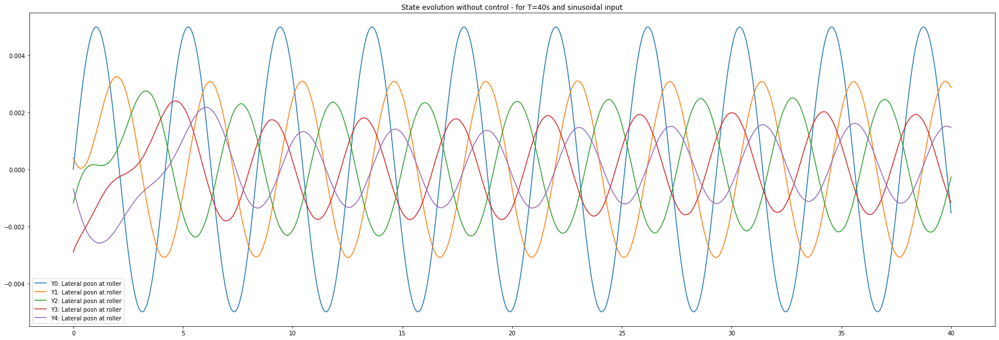

In [ ]:
plt.figure(figsize=(30,10))
plt.title("State evolution without control - for T=40s and sinusoidal input")

plt.plot(t_range, w1, label='Y0: Lateral posn at roller')
plt.plot(t_range, state_evolution[0,:4001], label='Y1: Lateral posn at roller')
plt.plot(t_range, state_evolution[2,:4001], label='Y2: Lateral posn at roller')
plt.plot(t_range, state_evolution[4,:4001], label='Y3: Lateral posn at roller')
plt.plot(t_range, state_evolution[6,:4001], label='Y4: Lateral posn at roller')

plt.legend() ; 

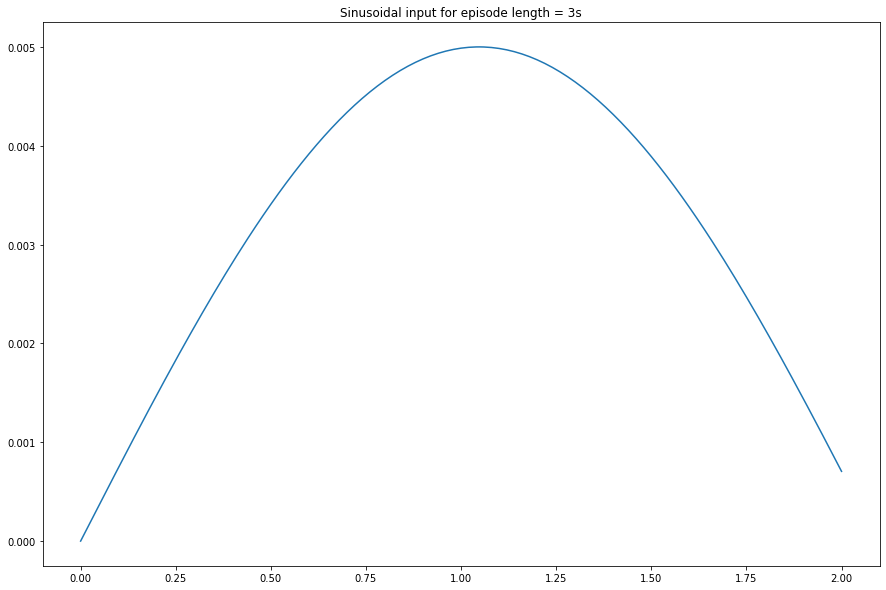

In [ ]:
plt.figure(figsize=(15,10))
plt.title("Sinusoidal input for episode length = 3s")

plt.plot(t_range[:201], w1[:201], label='Y0: Lateral posn at roller') ; 

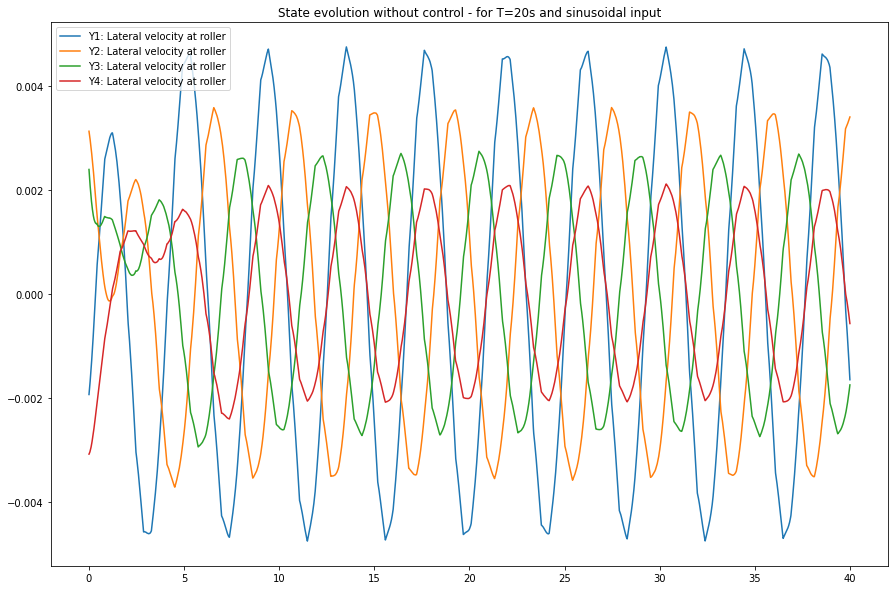

In [ ]:
plt.figure(figsize=(15,10))
plt.title("State evolution without control - for T=20s and sinusoidal input")

plt.plot(t_range, state_evolution[1,:4001], label='Y1: Lateral velocity at roller')
plt.plot(t_range, state_evolution[3,:4001], label='Y2: Lateral velocity at roller')
plt.plot(t_range, state_evolution[5,:4001], label='Y3: Lateral velocity at roller')
plt.plot(t_range, state_evolution[7,:4001], label='Y4: Lateral velocity at roller')

plt.legend() ;

## Simulation of system without ANY external input

Just randomly initialized state

In [ ]:
## Simulate system without any external input and plot state-evolution just to see 
## if it works

t_range = np.linspace(0,40,4001) 

w1 = 0*0.25*np.sin(t_range) ; 
init_rand_state = env.reset()
state_evolution = env.state ; 

for t_step in range(t_range.shape[0]):     
#for t_step in range(1):   
    t = t_range[t_step]
    #print("time = ", t)
    action = np.atleast_2d(np.array([0])).astype(np.float32) ; 
    state, obs , cost, _, _ = env.step(action=action, meas_dist=np.atleast_2d(np.array([w1[t_step] , 0])).T, t_step=t_step)
    #total_costs += cost * gamma**(t)

    state_evolution = np.concatenate((state_evolution, state), axis=1)

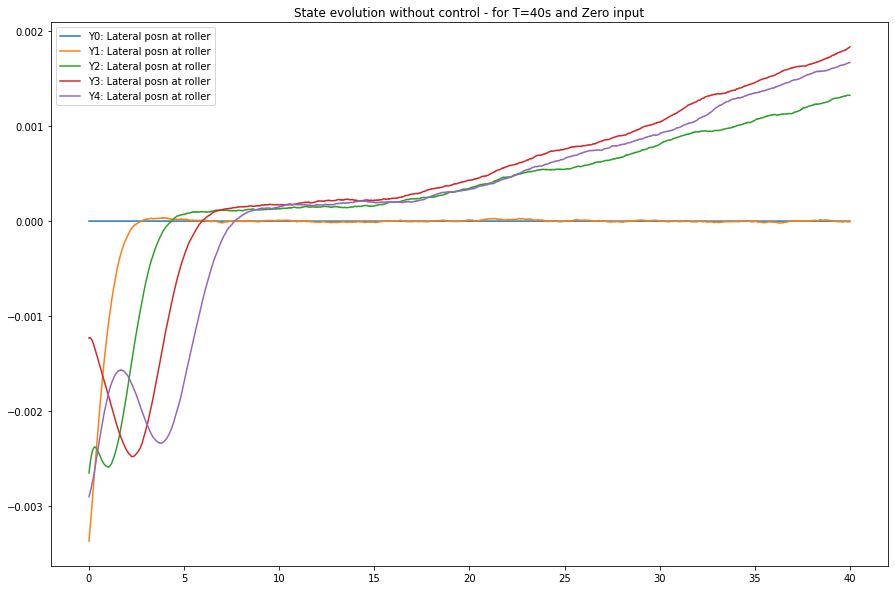

In [ ]:
plt.figure(figsize=(15,10))
plt.title("State evolution without control - for T=40s and Zero input")

plt.plot(t_range, w1, label='Y0: Lateral posn at roller')
plt.plot(t_range, state_evolution[0,:4001], label='Y1: Lateral posn at roller')
plt.plot(t_range, state_evolution[2,:4001], label='Y2: Lateral posn at roller')
plt.plot(t_range, state_evolution[4,:4001], label='Y3: Lateral posn at roller')
plt.plot(t_range, state_evolution[6,:4001], label='Y4: Lateral posn at roller')

plt.legend() ;

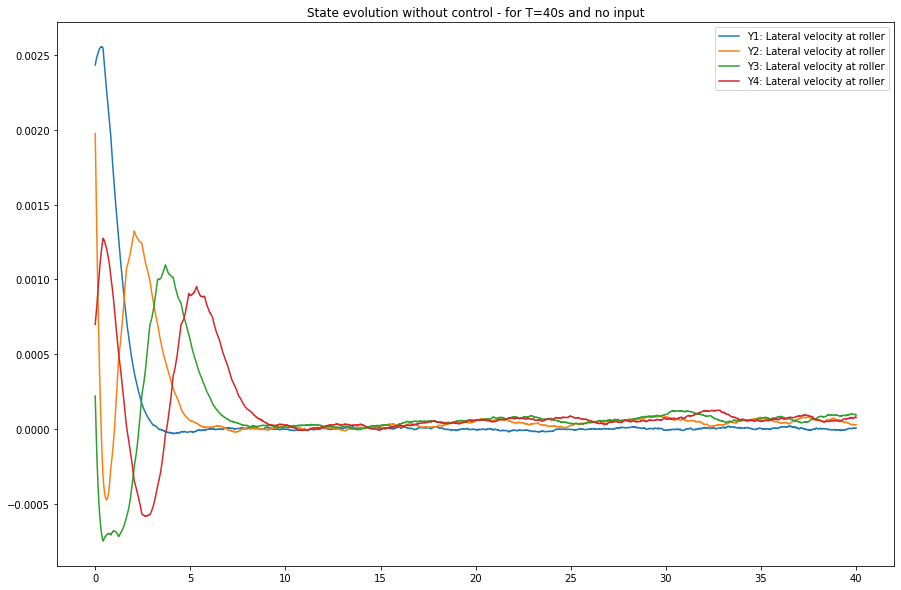

In [ ]:
plt.figure(figsize=(15,10))
plt.title("State evolution without control - for T=40s and no input")

plt.plot(t_range, state_evolution[1,:4001], label='Y1: Lateral velocity at roller')
plt.plot(t_range, state_evolution[3,:4001], label='Y2: Lateral velocity at roller')
plt.plot(t_range, state_evolution[5,:4001], label='Y3: Lateral velocity at roller')
plt.plot(t_range, state_evolution[7,:4001], label='Y4: Lateral velocity at roller')

plt.legend() ;

*2* things I need to do today are:- 

1) Code up ELQR solution assuming full-state information
2) Set up simple Kalman filtering for optimal state-estimation 

These will serve as the baselines for my work

What will be the RL strategies that I will use?? 

1) Memory-based control with RNNs --> This uses policy gradient methods!!

2) ALso try simple Q-learning as we have done in class!


In [ ]:
## Simulate system without any external input and plot state-evolution just to see 
## if it works

t_range = np.linspace(0,20,2001) 

#w1 = 0.02*0.25*np.sin(t_range) ; 

w1 = np.zeros(t_range.shape)
w1[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25

env.reset()
state_evolution = env.state ; 

for t_step in range(t_range.shape[0]):     
#for t_step in range(1):   
    t = t_range[t_step]
    #print("time = ", t)
    action = np.atleast_2d(np.array([0])).astype(np.float32) ; 
    state, obs , cost, _, _ = env.step(action=action, meas_dist=np.atleast_2d(np.array([w1[t_step] , 0])).T, t_step=t_step)
    #total_costs += cost * gamma**(t)

    state_evolution = np.concatenate((state_evolution, state), axis=1)

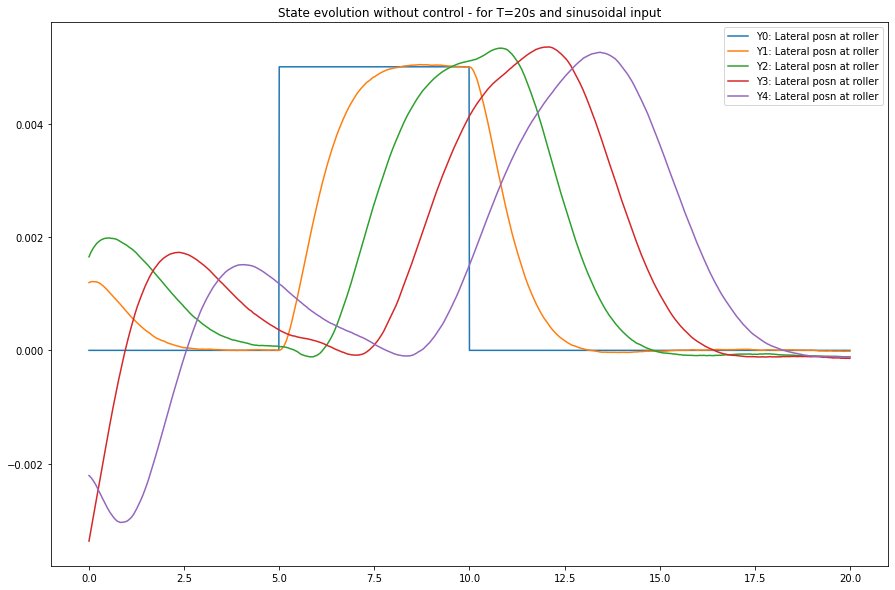

In [ ]:
plt.figure(figsize=(15,10))
plt.title("State evolution without control - for T=20s and sinusoidal input")

plt.plot(t_range, w1, label='Y0: Lateral posn at roller')
plt.plot(t_range, state_evolution[0,:2001], label='Y1: Lateral posn at roller')
plt.plot(t_range, state_evolution[2,:2001], label='Y2: Lateral posn at roller')
plt.plot(t_range, state_evolution[4,:2001], label='Y3: Lateral posn at roller')
plt.plot(t_range, state_evolution[6,:2001], label='Y4: Lateral posn at roller')

plt.legend() ; 

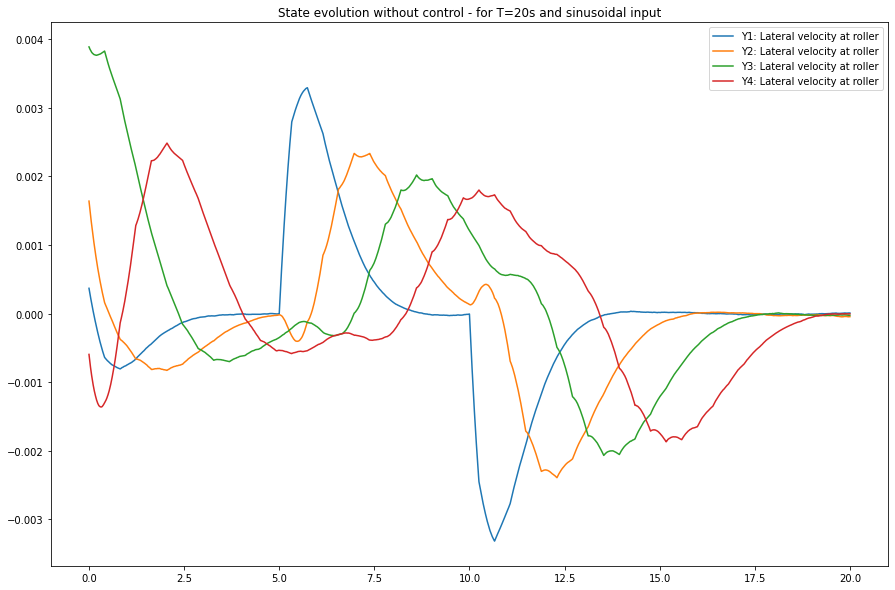

In [ ]:
plt.figure(figsize=(15,10))
plt.title("State evolution without control - for T=20s and sinusoidal input")

plt.plot(t_range, state_evolution[1,:2001], label='Y1: Lateral velocity at roller')
plt.plot(t_range, state_evolution[3,:2001], label='Y2: Lateral velocity at roller')
plt.plot(t_range, state_evolution[5,:2001], label='Y3: Lateral velocity at roller')
plt.plot(t_range, state_evolution[7,:2001], label='Y4: Lateral velocity at roller')

plt.legend() ;

## Simulation of system with square-wave input

In [ ]:
## Simulate system without any external input and plot state-evolution just to see 
## if it works

t_range = np.linspace(0,40,4001) 

#w1 = 0.02*0.25*np.sin(1.5*t_range) ; 
w1 = np.zeros(t_range.shape)
w1[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25


env.reset()
state_evolution = env.state ; 

for t_step in range(t_range.shape[0]):     
#for t_step in range(1):     
    t = t_range[t_step]
    #print("time = ", t)
    action = np.atleast_2d(np.array([0])).astype(np.float32) ; 
    #print(action)
    state, obs , cost, _, _ = env.step(action=action, meas_dist=np.atleast_2d(np.array([w1[t_step] , 0])).T, t_step=t_step)
    #total_costs += cost * gamma**(t)

    state_evolution = np.concatenate((state_evolution, state), axis=1)

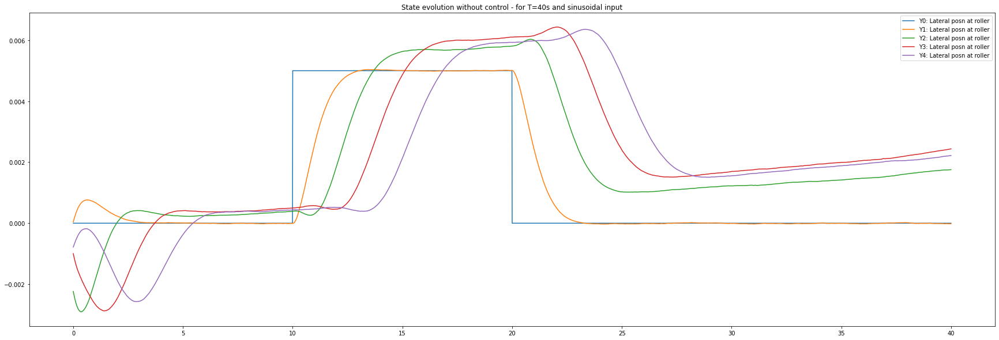

In [ ]:
plt.figure(figsize=(30,10))
plt.title("State evolution without control - for T=40s and sinusoidal input")

plt.plot(t_range, w1, label='Y0: Lateral posn at roller')
plt.plot(t_range, state_evolution[0,:4001], label='Y1: Lateral posn at roller')
plt.plot(t_range, state_evolution[2,:4001], label='Y2: Lateral posn at roller')
plt.plot(t_range, state_evolution[4,:4001], label='Y3: Lateral posn at roller')
plt.plot(t_range, state_evolution[6,:4001], label='Y4: Lateral posn at roller')

plt.legend() ; 

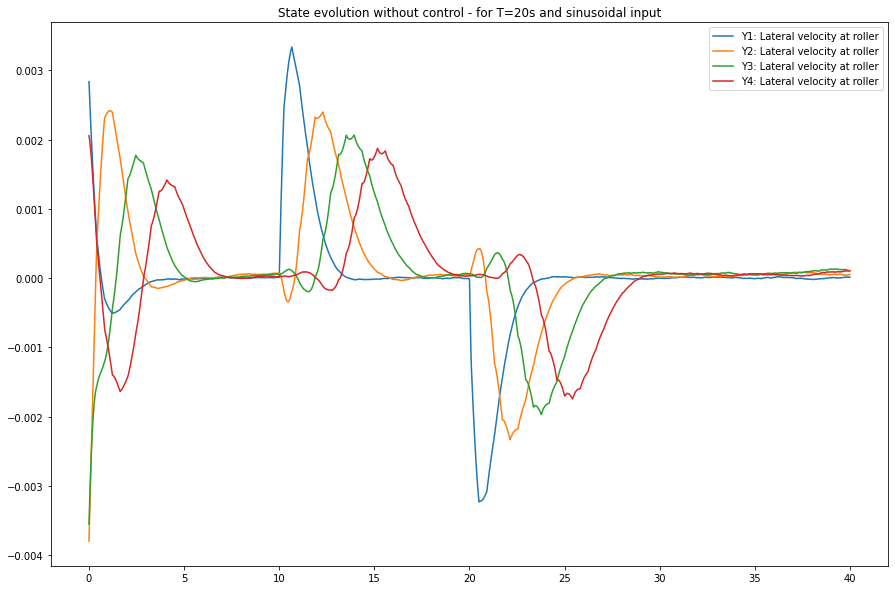

In [ ]:
plt.figure(figsize=(15,10))
plt.title("State evolution without control - for T=20s and sinusoidal input")

plt.plot(t_range, state_evolution[1,:4001], label='Y1: Lateral velocity at roller')
plt.plot(t_range, state_evolution[3,:4001], label='Y2: Lateral velocity at roller')
plt.plot(t_range, state_evolution[5,:4001], label='Y3: Lateral velocity at roller')
plt.plot(t_range, state_evolution[7,:4001], label='Y4: Lateral velocity at roller')

plt.legend() ;

## Extended LQR 

The regular LQR is developed for a state-space model of the form below where there is no external measured disturbance to the system

$X_{t+1} = AX_t + Bu_t$

However, the state-space form that I am working with for this problem is one for which there is also a measured disturbance coming into the system and is of the form:

$X_{t+1} = AX_t + Bu^{control}_t + Fu^{dist}_t$

So, the LQR fomulation needs to be slightly re-worked as in 

https://www.sciencedirect.com/science/article/pii/S000510981630406X


For this --> develop control strategy assuming constant speed and tension model! Using nominal values of speed and tensi on (8 and 87.5)

The simulation however is still with variable speed and tension


## ELQR function 

In [ ]:
## Implement the ELQR optimal control strategy

#Read in nominal matrix values

rp5_sys_disc = scipy.io.loadmat('data_folder/flat_web_ss_disc.mat')

A_nom = rp5_sys_disc['A']
B_nom = rp5_sys_disc['B'][:,:1]
F_nom = rp5_sys_disc['B'][:,1:]

env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=np.identity(10), R=np.identity(1))

def gen_ELQR_mats(A,B,F,env):

    '''
    This function computes the relevant gain matrix for the ELQR formulation 
    Input: A,B,F --> These are the nominal system matrix values assumed 
        env: The LQ environment for which we are trying to solve the problem --> giet Q,R and gamma through this 

    Output: K: Gain matrix such that we use -Kx 
          G: Additional gain matrix for the measured disturbances we use -G*meas_dist
          u_cont = -(Kx + G*meas_dist)
    '''

    A = A*np.sqrt(env.gamma)
    B = B
    F = F
    Q = env.Q
    R = env.R*(1/env.gamma)

    P = scipy.linalg.solve_discrete_are(a=A, b=B, q=Q, r=R)
    K = (np.linalg.inv((R + B.T@P@B)))@(B.T)@P@(A)

    S = np.linalg.inv(A@np.linalg.inv(P-Q)-np.linalg.inv(P))@F

    G = K@np.linalg.inv(A-np.linalg.inv(P)@(P-Q))@F

    return K, G

In [ ]:
K,G = gen_ELQR_mats(A=A_nom, B=B_nom, F=F_nom, env=env)

## Simulate ELQR - Sine wave input

In [ ]:
## Simulate system withELQR control
## if it works

Q = np.identity(10) ; 
Q[2,2] = 100 ; 
Q[4,4] = 1000

# Q[0,0] = 0 ; 
# Q[1,1] = 0 ; 
# Q[2,2] = 0 ; 
# Q[3,3] = 0 ; 
# Q[5,5] = 0 ; 
# Q[7,7] = 0 ; 
# Q[8,8] = 0 ; 
# Q[9,9] = 0 ; 

R = np.identity(1) ;


#env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1))
env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1), reset_type='random')
K,G = gen_ELQR_mats(A=A_nom, B=B_nom, F=F_nom, env=env)

#t_range = np.linspace(0,20,2001) 

t_range = np.linspace(0,40,4001) 

w1 = 0.02*0.25*np.sin(t_range) ; 
env.reset()
state_evolution = env.state ; 

actions_evol = [] ; 

ep_rewards = [] ;

for t_step in range(t_range.shape[0]):     
#for t_step in range(1):   
    t = t_range[t_step]
    #print("time = ", t)

    meas_dist = np.atleast_2d(np.array([w1[t_step] , 0])).T
    ut = -(K@state + G@meas_dist)

    action = np.atleast_2d(ut).astype(np.float32) ; 

    actions_evol.append(ut[0][0])
    ep_rewards.append((state.T@Q@state + ut.T@R@ut)[0][0])


    state, obs , cost, _, _ = env.step(action=action, meas_dist=np.atleast_2d(np.array([w1[t_step] , 0])).T, t_step=t_step)
    #total_costs += cost * gamma**(t)

    state_evolution = np.concatenate((state_evolution, state), axis=1)

NameError: ignored

Mean rewards =  0.001294850713302103


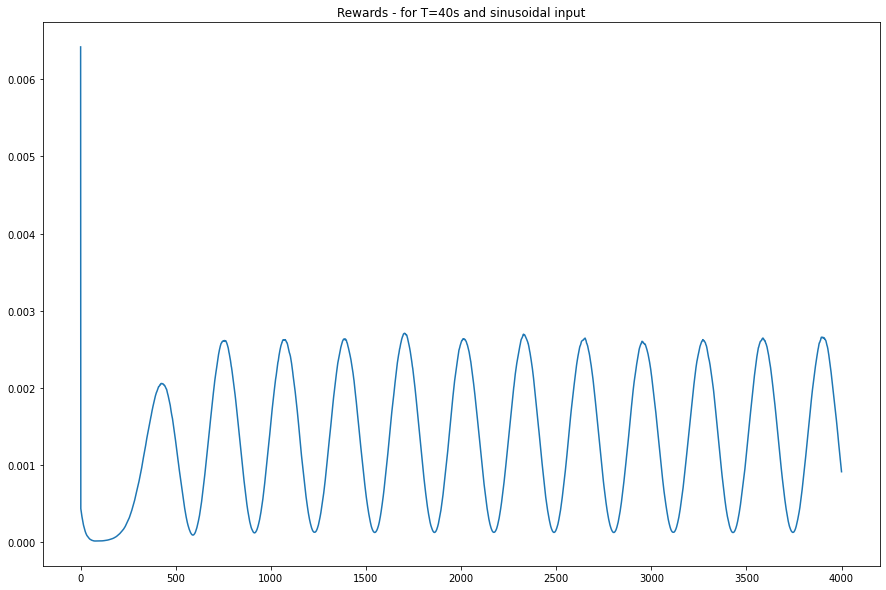

In [ ]:
plt.figure(figsize=(15,10))
plt.title("Rewards - for T=40s and sinusoidal input")
plt.plot(ep_rewards) ; 

print("Mean rewards = ", sum(ep_rewards)/len(ep_rewards)) ;

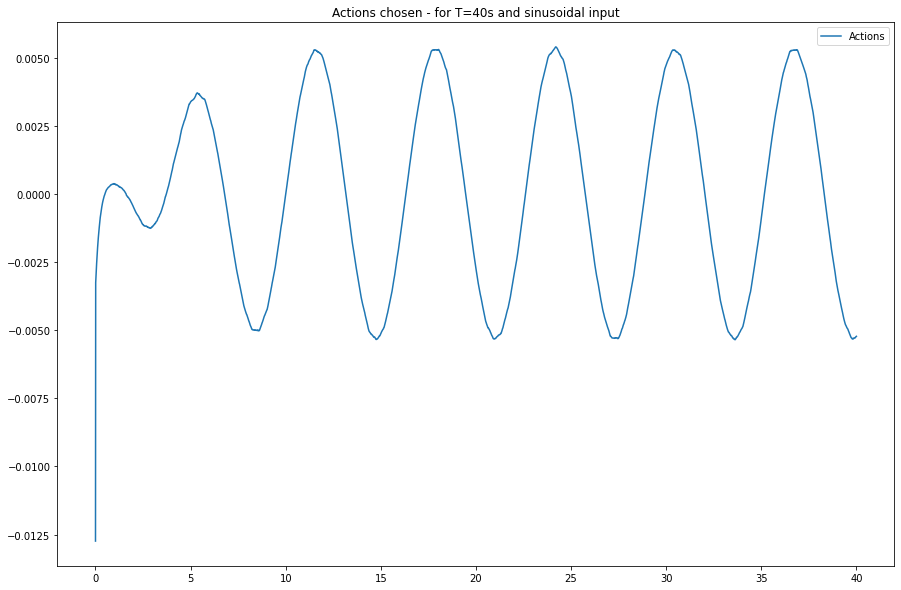

In [ ]:
plt.figure(figsize=(15,10))
plt.title("Actions chosen - for T=40s and sinusoidal input")
plt.plot(t_range, actions_evol, label='Actions')
#plt.plot(t_range[5:], w1[5:], label='Y0: Lateral posn at roller')
plt.legend() ;

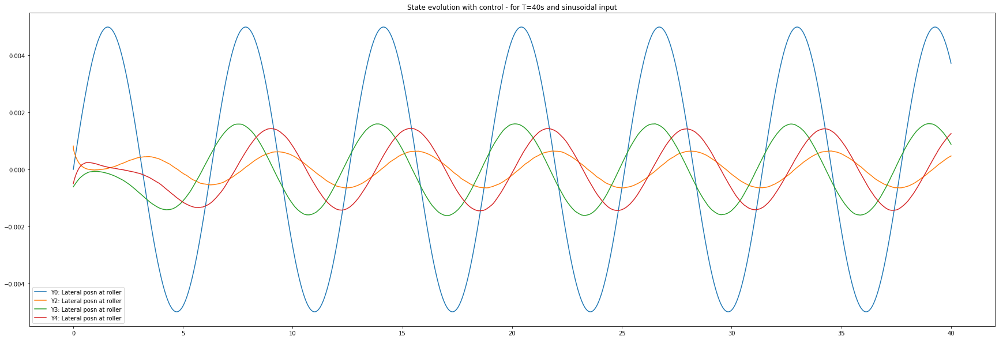

In [ ]:
plt.figure(figsize=(30,10))
plt.title("State evolution with control - for T=40s and sinusoidal input")

plt.plot(t_range, w1, label='Y0: Lateral posn at roller')
#plt.plot(t_range, state_evolution[0,:2001], label='Y1: Lateral posn at roller')
plt.plot(t_range, state_evolution[2,:4001], label='Y2: Lateral posn at roller')
plt.plot(t_range, state_evolution[4,:4001], label='Y3: Lateral posn at roller')
plt.plot(t_range, state_evolution[6,:4001], label='Y4: Lateral posn at roller')

plt.legend() ;

## ELQR - No input to the system

applied to when there is no external input to the system

In [ ]:
## Simulate system withELQR control
## if it works

Q = np.identity(10) ; 
Q[2,2] = 100 ; 
Q[4,4] = 1000

# Q[0,0] = 0 ; 
# Q[1,1] = 0 ; 
# Q[2,2] = 0 ; 
# Q[3,3] = 0 ; 
# Q[5,5] = 0 ; 
# Q[7,7] = 0 ; 
# Q[8,8] = 0 ; 
# Q[9,9] = 0 ; 

R = np.identity(1) ;


#env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1))
env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1), reset_type='random')
K,G = gen_ELQR_mats(A=A_nom, B=B_nom, F=F_nom, env=env)

#t_range = np.linspace(0,20,2001) 

t_range = np.linspace(0,40,4001) 

w1 = 0*0.25*np.sin(t_range) ; 
env.reset(init_rand_state)
state_evolution = env.state ; 

actions_evol = [] ; 

ep_rewards = [] ;

for t_step in range(t_range.shape[0]):     
#for t_step in range(1):   
    t = t_range[t_step]
    #print("time = ", t)


    

    meas_dist = np.atleast_2d(np.array([w1[t_step] , 0])).T
    ut = -(K@state + G@meas_dist)    

    action = np.atleast_2d(ut).astype(np.float32) ; 

    actions_evol.append(ut[0][0])
    ep_rewards.append((state.T@Q@state + ut.T@R@ut)[0][0])


    state, obs , cost, _, _ = env.step(action=action, meas_dist=np.atleast_2d(np.array([w1[t_step] , 0])).T, t_step=t_step)
    #total_costs += cost * gamma**(t)

    state_evolution = np.concatenate((state_evolution, state), axis=1)

Mean rewards =  4.523970063340953e-05


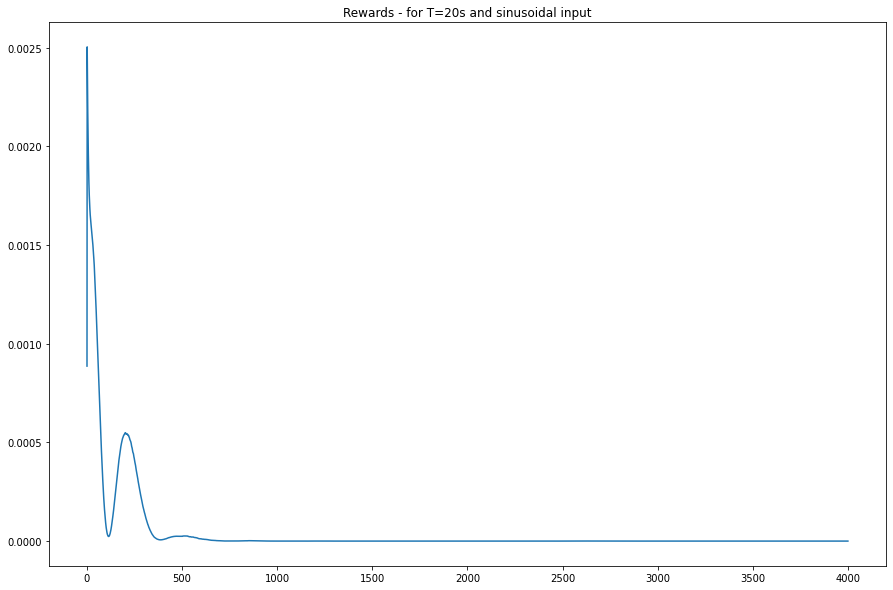

In [ ]:
plt.figure(figsize=(15,10))
plt.title("Rewards - for T=20s and sinusoidal input")
plt.plot(ep_rewards) ; 

print("Mean rewards = ", sum(ep_rewards)/len(ep_rewards)) ;

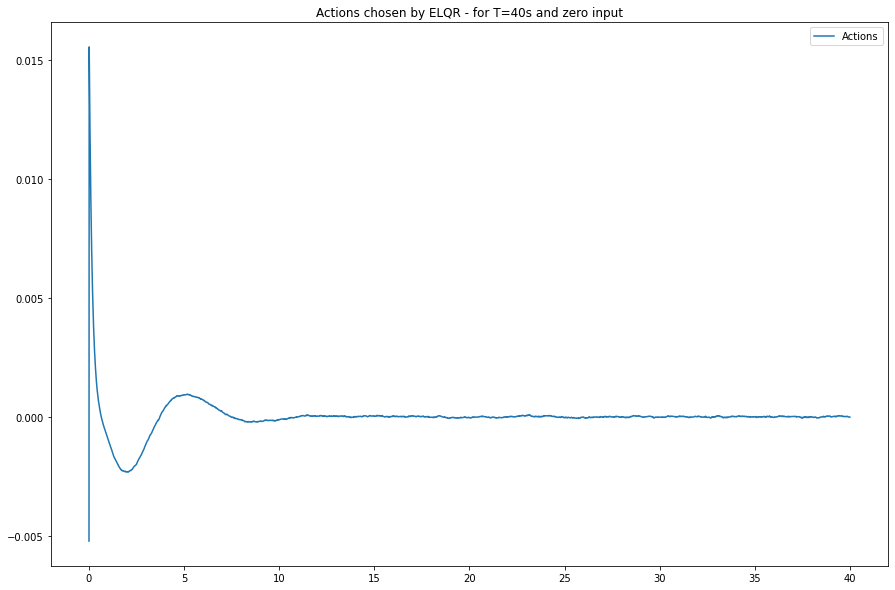

In [ ]:
plt.figure(figsize=(15,10))
plt.title("Actions chosen by ELQR - for T=40s and zero input")

plt.plot(t_range, actions_evol, label='Actions')
#plt.plot(t_range[5:], w1[5:], label='Y0: Lateral posn at roller')

plt.legend() ;

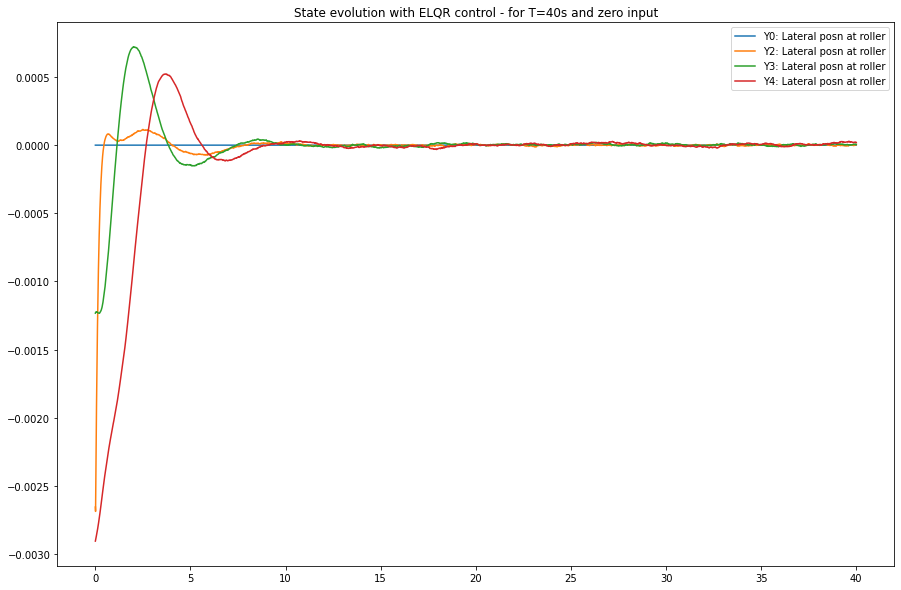

In [ ]:
plt.figure(figsize=(15,10))
plt.title("State evolution with ELQR control - for T=40s and zero input")

plt.plot(t_range, w1, label='Y0: Lateral posn at roller')
#plt.plot(t_range, state_evolution[0,:2001], label='Y1: Lateral posn at roller')
plt.plot(t_range, state_evolution[2,:4001], label='Y2: Lateral posn at roller')
plt.plot(t_range, state_evolution[4,:4001], label='Y3: Lateral posn at roller')
plt.plot(t_range, state_evolution[6,:4001], label='Y4: Lateral posn at roller')

plt.legend() ;

## Simulate ELQR - Square wave input

In [ ]:
## Simulate system withELQR control
## if it works

Q = np.identity(10) ; 
Q[2,2] = 100 ; 
Q[4,4] = 1000

# Q[0,0] = 0 ; 
# Q[1,1] = 0 ; 
# Q[2,2] = 0 ; 
# Q[3,3] = 0 ; 
# Q[5,5] = 0 ; 
# Q[7,7] = 0 ; 
# Q[8,8] = 0 ; 
# Q[9,9] = 0 ; 

R = np.identity(1) ;


env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1))
K,G = gen_ELQR_mats(A=A_nom, B=B_nom, F=F_nom, env=env)

#t_range = np.linspace(0,20,2001) 

t_range = np.linspace(0,40,4001) 

#w1 = 0.02*0.25*np.sin(t_range) ; 
w1 = np.zeros(t_range.shape)
w1[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25

env.reset()
state_evolution = env.state ; 

actions_evol = [] ; 

ep_rewards = [] ;

for t_step in range(t_range.shape[0]):     
#for t_step in range(1):   
    t = t_range[t_step]
    #print("time = ", t)

    meas_dist = np.atleast_2d(np.array([w1[t_step] , 0])).T
    ut = -(K@state + G@meas_dist)

    action = np.atleast_2d(ut).astype(np.float32) ; 

    actions_evol.append(ut[0][0])
    ep_rewards.append((state.T@Q@state + ut.T@R@ut)[0][0])


    state, obs , cost, _, _ = env.step(action=action, meas_dist=np.atleast_2d(np.array([w1[t_step] , 0])).T, t_step=t_step)
    #total_costs += cost * gamma**(t)

    state_evolution = np.concatenate((state_evolution, state), axis=1)

Mean rewards =  0.0006533067607115345


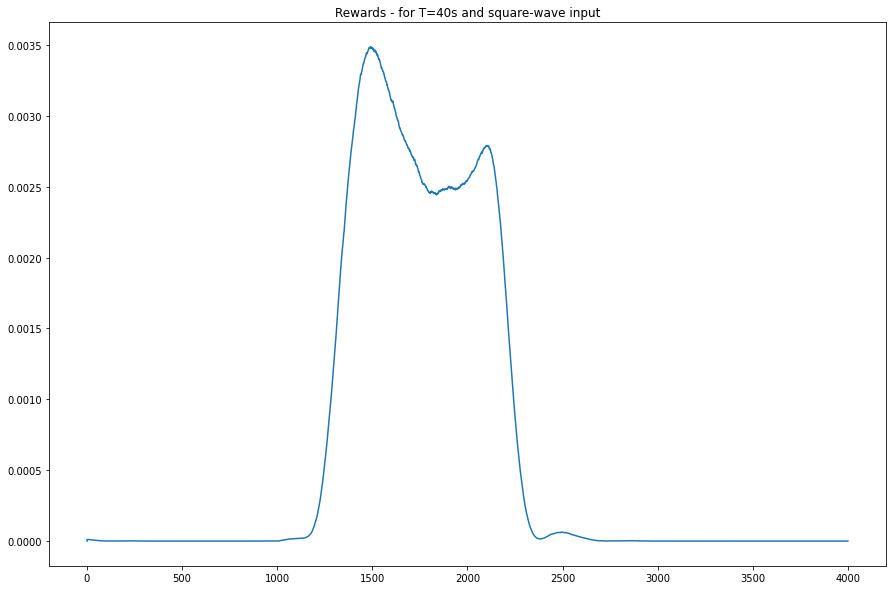

In [ ]:
plt.figure(figsize=(15,10))
plt.title("Rewards - for T=40s and square-wave input")
plt.plot(ep_rewards) ; 

print("Mean rewards = ", sum(ep_rewards)/len(ep_rewards)) ;

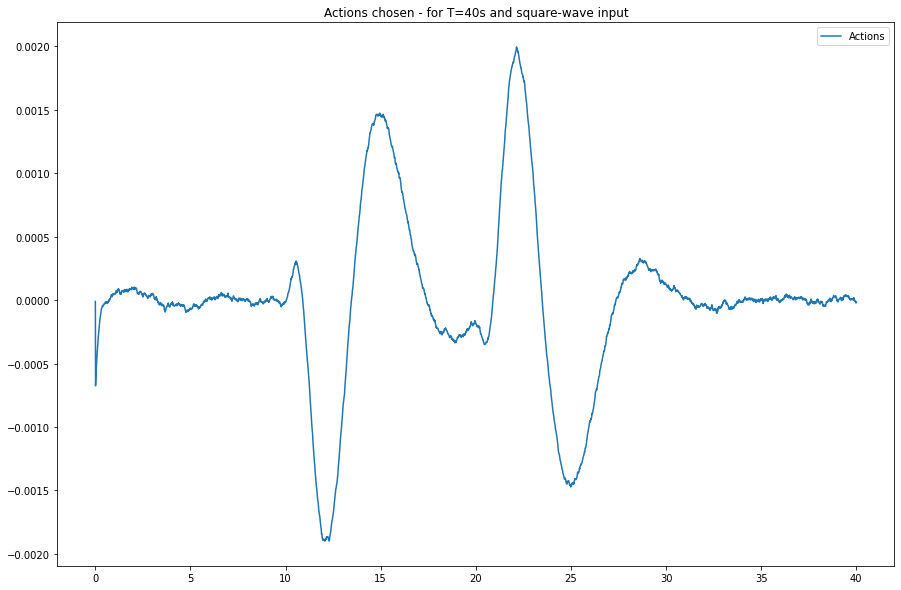

In [ ]:
plt.figure(figsize=(15,10))
plt.title("Actions chosen - for T=40s and square-wave input")

plt.plot(t_range, actions_evol, label='Actions')
#plt.plot(t_range[5:], w1[5:], label='Y0: Lateral posn at roller')

plt.legend() ;

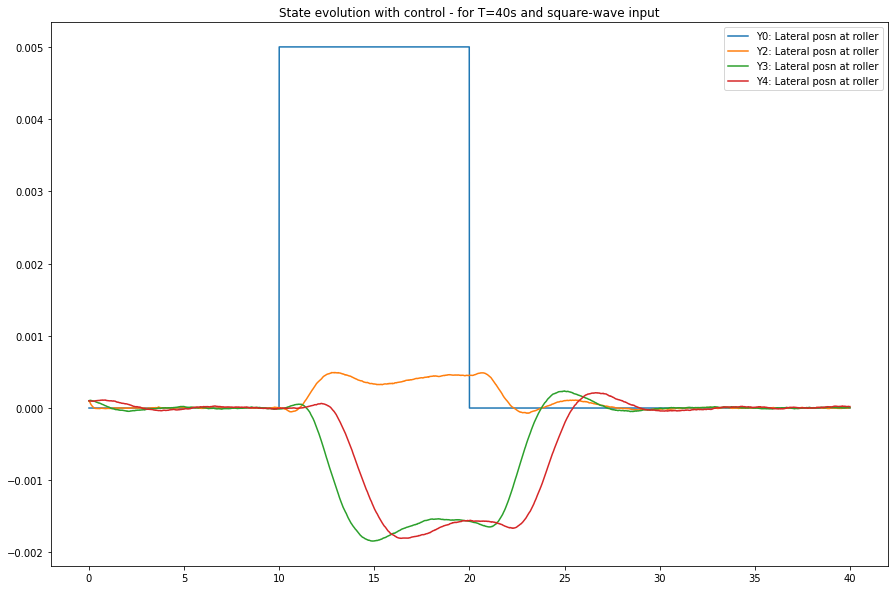

In [ ]:
plt.figure(figsize=(15,10))
plt.title("State evolution with control - for T=40s and square-wave input")

plt.plot(t_range, w1, label='Y0: Lateral posn at roller')
#plt.plot(t_range, state_evolution[0,:2001], label='Y1: Lateral posn at roller')
plt.plot(t_range, state_evolution[2,:4001], label='Y2: Lateral posn at roller')
plt.plot(t_range, state_evolution[4,:4001], label='Y3: Lateral posn at roller')
plt.plot(t_range, state_evolution[6,:4001], label='Y4: Lateral posn at roller')

plt.legend() ;

## Deep deterministic polcy gradients

Trying this with full-state information

In [ ]:
import math
import random

import gym
import numpy as np

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.distributions import Normal
from torch.distributions import Categorical
from collections import namedtuple

torch.manual_seed(0)

torch.set_default_dtype(torch.float64)

In [ ]:
#Normal(0,1).sample((1,))

## buffers.py

In [ ]:
def linear_weights_init(m):
    if isinstance(m, nn.Linear):
        stdv = 1. / math.sqrt(m.weight.size(1))
        m.weight.data.uniform_(-stdv, stdv)
        if m.bias is not None:
            m.bias.data.uniform_(-stdv, stdv)


def conv_weights_init(m):
    if isinstance(m, nn.Conv2d):
        torch.nn.init.xavier_uniform_(m.weight.data)
        if m.bias is not None:
            torch.nn.init.zeros_(m.bias)

In [ ]:
class ReplayBuffer:
    def __init__(self, capacity):
        self.capacity = capacity
        self.buffer = []
        self.position = 0

    def push(self, state, action, reward, next_state, done):
        if len(self.buffer) < self.capacity:
            self.buffer.append(None)
        self.buffer[self.position] = (state, action, reward, next_state, done)
        self.position = int((self.position + 1) % self.capacity)  # as a ring buffer

    def sample(self, batch_size):
        batch = random.sample(self.buffer, batch_size)
        state, action, reward, next_state, done = map(np.stack,
                                                      zip(*batch))  # stack for each element
        ''' 
        the * serves as unpack: sum(a,b) <=> batch=(a,b), sum(*batch) ;
        zip: a=[1,2], b=[2,3], zip(a,b) => [(1, 2), (2, 3)] ;
        the map serves as mapping the function on each list element: map(square, [2,3]) => [4,9] ;
        np.stack((1,2)) => array([1, 2])
        '''
        return state, action, reward, next_state, done

    def __len__(
            self):  # cannot work in multiprocessing case, len(replay_buffer) is not available in proxy of manager!
        return len(self.buffer)

    def get_length(self):
        return len(self.buffer)

class ReplayBufferPER:
    """ 
    Replay buffer with Prioritized Experience Replay (PER),
    TD error as sampling weights. This is a simple version without sumtree.
    Reference:
    https://github.com/Felhof/DiscreteSAC/blob/main/utilities/ReplayBuffer.py
    """
    def __init__(self, capacity):
        self.capacity = capacity
        self.buffer = []
        self.position = 0
        self.weights = np.zeros(int(capacity))
        self.max_weight = 10**-2
        self.delta = 10**-4

    def push(self, state, action, reward, next_state, done):
        if len(self.buffer) < self.capacity:
            self.buffer.append(None)
        self.buffer[self.position] = (state, action, reward, next_state, done)
        self.weights[self.position] = self.max_weight  # new sample has max weights

        self.position = int((self.position + 1) % self.capacity)  # as a ring buffer

    def sample(self, batch_size):
        set_weights = self.weights[:self.position] + self.delta
        probabilities = set_weights / sum(set_weights)
        self.indices = np.random.choice(range(self.position), batch_size, p=probabilities, replace=False)
        batch = np.array(self.buffer)[list(self.indices)]
        state, action, reward, next_state, done = map(np.stack,
                                                      zip(*batch))  # stack for each element
        ''' 
        the * serves as unpack: sum(a,b) <=> batch=(a,b), sum(*batch) ;
        zip: a=[1,2], b=[2,3], zip(a,b) => [(1, 2), (2, 3)] ;
        the map serves as mapping the function on each list element: map(square, [2,3]) => [4,9] ;
        np.stack((1,2)) => array([1, 2])
        '''
        return state, action, reward, next_state, done

    def update_weights(self, prediction_errors):
        max_error = max(prediction_errors)
        self.max_weight = max(self.max_weight, max_error)
        self.weights[self.indices] = prediction_errors

    def __len__(
            self):  # this is a stupid func! cannot work in multiprocessing case, len(replay_buffer) is not available in proxy of manager!
        return len(self.buffer)

    def get_length(self):
        return len(self.buffer)

class ReplayBufferLSTM:
    """ 
    Replay buffer for agent with LSTM network additionally using previous action, can be used 
    if the hidden states are not stored (arbitrary initialization of lstm for training).
    And each sample contains the whole episode instead of a single step.
    """
    def __init__(self, capacity):
        self.capacity = capacity
        self.buffer = []
        self.position = 0

    def push(self, state, action, last_action, reward, next_state, done):
        if len(self.buffer) < self.capacity:
            self.buffer.append(None)
        self.buffer[self.position] = (state, action, last_action, reward, next_state, done)
        self.position = int((self.position + 1) % self.capacity)  # as a ring buffer

    def sample(self, batch_size):
        batch = random.sample(self.buffer, batch_size)
        state, action, last_action, reward, next_state, done = map(np.stack,
                                                      zip(*batch))  # stack for each element
        ''' 
        the * serves as unpack: sum(a,b) <=> batch=(a,b), sum(*batch) ;
        zip: a=[1,2], b=[2,3], zip(a,b) => [(1, 2), (2, 3)] ;
        the map serves as mapping the function on each list element: map(square, [2,3]) => [4,9] ;
        np.stack((1,2)) => array([1, 2])
        '''
        return state, action, last_action, reward, next_state, done

    def __len__(
            self):  # cannot work in multiprocessing case, len(replay_buffer) is not available in proxy of manager!
        return len(self.buffer)

    def get_length(self):
        return len(self.buffer)

class ReplayBufferLSTM2:
    """ 
    Replay buffer for agent with LSTM network additionally storing previous action, 
    initial input hidden state and output hidden state of LSTM.
    And each sample contains the whole episode instead of a single step.
    'hidden_in' and 'hidden_out' are only the initial hidden state for each episode, for LSTM initialization.
    """
    def __init__(self, capacity):
        self.capacity = capacity
        self.buffer = []
        self.position = 0

    def push(self, hidden_in, hidden_out, state, action, last_action, reward, next_state, done):
        if len(self.buffer) < self.capacity:
            self.buffer.append(None)
        self.buffer[self.position] = (hidden_in, hidden_out, state, action, last_action, reward, next_state, done)
        self.position = int((self.position + 1) % self.capacity)  # as a ring buffer

    def sample(self, batch_size):
        s_lst, a_lst, la_lst, r_lst, ns_lst, hi_lst, ci_lst, ho_lst, co_lst, d_lst=[],[],[],[],[],[],[],[],[],[]
        batch = random.sample(self.buffer, batch_size)
        for sample in batch:
            (h_in, c_in), (h_out, c_out), state, action, last_action, reward, next_state, done = sample
            s_lst.append(state) 
            a_lst.append(action)
            la_lst.append(last_action)
            r_lst.append(reward)
            ns_lst.append(next_state)
            d_lst.append(done)
            hi_lst.append(h_in)  # h_in: (1, batch_size=1, hidden_size)
            ci_lst.append(c_in)
            ho_lst.append(h_out)
            co_lst.append(c_out)
        hi_lst = torch.cat(hi_lst, dim=-2).detach() # cat along the batch dim
        ho_lst = torch.cat(ho_lst, dim=-2).detach()
        ci_lst = torch.cat(ci_lst, dim=-2).detach()
        co_lst = torch.cat(co_lst, dim=-2).detach()

        hidden_in = (hi_lst, ci_lst)
        hidden_out = (ho_lst, co_lst)

        return hidden_in, hidden_out, s_lst, a_lst, la_lst, r_lst, ns_lst, d_lst

    def __len__(
            self):  # cannot work in multiprocessing case, len(replay_buffer) is not available in proxy of manager!
        return len(self.buffer)

    def get_length(self):
        return len(self.buffer)


class ReplayBufferGRU:
    """ 
    Replay buffer for agent with GRU network additionally storing previous action, 
    initial input hidden state and output hidden state of GRU.
    And each sample contains the whole episode instead of a single step.
    'hidden_in' and 'hidden_out' are only the initial hidden state for each episode, for GRU initialization.
    """
    def __init__(self, capacity):
        self.capacity = capacity
        self.buffer = []
        self.position = 0

    def push(self, hidden_in, hidden_out, state, action, last_action, reward, next_state, done):
        if len(self.buffer) < self.capacity:
            self.buffer.append(None)
        self.buffer[self.position] = (hidden_in, hidden_out, state, action, last_action, reward, next_state, done)
        self.position = int((self.position + 1) % self.capacity)  # as a ring buffer

    def sample(self, batch_size):
        s_lst, a_lst, la_lst, r_lst, ns_lst, hi_lst, ho_lst, d_lst=[],[],[],[],[],[],[],[]
        batch = random.sample(self.buffer, batch_size)
        for sample in batch:
            h_in, h_out, state, action, last_action, reward, next_state, done = sample
            s_lst.append(state) 
            a_lst.append(action)
            la_lst.append(last_action)
            r_lst.append(reward)
            ns_lst.append(next_state)
            d_lst.append(done)
            hi_lst.append(h_in)  # h_in: (1, batch_size=1, hidden_size)
            ho_lst.append(h_out)
        hi_lst = torch.cat(hi_lst, dim=-2).detach() # cat along the batch dim
        ho_lst = torch.cat(ho_lst, dim=-2).detach()

        return hi_lst, ho_lst, s_lst, a_lst, la_lst, r_lst, ns_lst, d_lst

    def __len__(
            self):  # cannot work in multiprocessing case, len(replay_buffer) is not available in proxy of manager!
        return len(self.buffer)

    def get_length(self):
        return len(self.buffer)

## Random processes

In [ ]:
import numpy as np 

# [reference] https://github.com/matthiasplappert/keras-rl/blob/master/rl/random.py

class RandomProcess(object):
    def reset_states(self):
        pass

class AnnealedGaussianProcess(RandomProcess):
    def __init__(self, mu, sigma, sigma_min, n_steps_annealing):
        self.mu = mu
        self.sigma = sigma
        self.n_steps = 0

        if sigma_min is not None:
            self.m = -float(sigma - sigma_min) / float(n_steps_annealing)
            self.c = sigma
            self.sigma_min = sigma_min
        else:
            self.m = 0.
            self.c = sigma
            self.sigma_min = sigma

    @property
    def current_sigma(self):
        sigma = max(self.sigma_min, self.m * float(self.n_steps) + self.c)
        return sigma


# Based on http://math.stackexchange.com/questions/1287634/implementing-ornstein-uhlenbeck-in-matlab
class OrnsteinUhlenbeckProcess(AnnealedGaussianProcess):
    def __init__(self, theta, mu=0., sigma=1., dt=1e-2, x0=None, size=1, sigma_min=None, n_steps_annealing=1000):
        super(OrnsteinUhlenbeckProcess, self).__init__(mu=mu, sigma=sigma, sigma_min=sigma_min, n_steps_annealing=n_steps_annealing)
        self.theta = theta
        self.mu = mu
        self.dt = dt
        self.x0 = x0
        self.size = size
        self.reset_states()

    def sample(self):
        x = self.x_prev + self.theta * (self.mu - self.x_prev) * self.dt + self.current_sigma * np.sqrt(self.dt) * np.random.normal(size=self.size)
        self.x_prev = x
        self.n_steps += 1
        return torch.from_numpy(x)

    def reset_states(self):
        self.x_prev = self.x0 if self.x0 is not None else np.zeros(self.size)

## policy network

This is a normal feedforward network and not Recurrent

In [ ]:
class PolicyNetworkBase(nn.Module):
    """ Base network class for policy function """
    def __init__(self, state_space, action_space, action_range):
        super(PolicyNetworkBase, self).__init__()
        self._state_space = state_space
        self._state_shape = state_space.shape
        if len(self._state_shape) == 1:
            self._state_dim = self._state_shape[0]
        else:  # high-dim state
            pass  
        self._action_space = action_space
        self._action_shape = action_space.shape
        if len(self._action_shape) < 1:  # Discrete space
            self._action_dim = action_space.n
        else:
            self._action_dim = self._action_shape[0]
        self.action_range = action_range

    def forward(self):
        pass
    
    def evaluate(self):
        pass 
    
    def get_action(self):
        pass

    def sample_action(self,):
        a=torch.FloatTensor(self._action_dim).uniform_(-1, 1)
        return self.action_range*a.numpy()

class DPG_PolicyNetwork(PolicyNetworkBase):
    """
    Deterministic policy gradient network
    """
    ## Changed action range
    def __init__(self, state_space, action_space, hidden_dim, action_range=1e-2, init_w=3e-3):
        super().__init__(state_space, action_space, action_range)
        
        #self.linear1 = nn.Linear(self._state_dim, hidden_dim)
        self.linear1 = nn.Linear(state_space.shape[0], hidden_dim)
        self.linear2 = nn.Linear(hidden_dim, hidden_dim)
        self.linear3 = nn.Linear(hidden_dim, action_space.shape[0]) # output dim = dim of action

        # weights initialization
        self.linear3.weight.data.uniform_(-init_w, init_w)
        self.linear3.bias.data.uniform_(-init_w, init_w)

        self.random_proc = OrnsteinUhlenbeckProcess(theta=0.15, mu=0., sigma=0.2, dt=1e-2, x0=None, size=1, sigma_min=None, n_steps_annealing=1000)
    

    def forward(self, state):
        activation=F.relu
        x = activation(self.linear1(state)) 
        x = activation(self.linear2(x))
        x = F.tanh(self.linear3(x)).clone() # need clone to prevent in-place operation (which cause gradients not be drived)
        # x = self.linear3(x) # for simplicity, no restriction on action range

        return x

    def evaluate(self, state, noise_scale=0.0):
        '''
        evaluate action within GPU graph, for gradients flowing through it, noise_scale controllable
        '''
        normal = Normal(0, 1)
        #action = self.forward(state.to(torch.float64))

        action = self.forward(100*state.to(torch.float64)) ## Scale the magnitude of the input state

        #noise = noise_scale * normal.sample(action.shape).cuda()
        #noise = noise_scale * normal.sample(action.shape).to(device)
        noise = noise_scale * self.random_proc.sample().to(device)
        action = self.action_range*action+noise
        return action

    ##Changed default noise scale
    def get_action(self, state, noise_scale=4e-4):
        '''
        select action for sampling, no gradients flow, noisy action, return .cpu
        '''
        #state = torch.FloatTensor(state).unsqueeze(0).cuda() # state dim: (N, dim of state)
        state = torch.FloatTensor(state).unsqueeze(0).to(device) # state dim: (N, dim of state)
        normal = Normal(0, 1)
        
        
        # action = self.forward(state.to(torch.float64))

        action = self.forward(100*state.to(torch.float64))

        # noise = noise_scale * normal.sample(action.shape).cuda()
        #noise = noise_scale * normal.sample(action.shape).to(device)
        noise = noise_scale * self.random_proc.sample().to(device)
        action=self.action_range*action + noise
        return action.detach().cpu().numpy()[0]

    def sample_action(self):
        normal = Normal(0, 1)
        random_action=self.action_range*normal.sample( (self._action_dim,) )

        return random_action.cpu().numpy()

## Value networks 

Normal feedforward fully connected neural network -- not recurrent

In [ ]:
class ValueNetworkBase(nn.Module):
    """ Base network class for value function approximation """
    def __init__(self, state_space, activation):
        super(ValueNetworkBase, self).__init__()
        self._state_space = state_space
        self._state_shape = state_space.shape
        if len(self._state_shape) == 1:
            self._state_dim = self._state_shape[0]
        else:  # high-dim state
            pass  

        self.activation = activation

    def forward(self):
        pass

class QNetworkBase(ValueNetworkBase):
    def __init__(self, state_space, action_space, activation ):
        super().__init__( state_space, activation)
        self._action_space = action_space
        self._action_shape = action_space.shape
        self._action_dim = self._action_shape[0]

class QNetwork(QNetworkBase):
    def __init__(self, state_space, action_space, hidden_dim, activation=F.relu, output_activation=None, init_w = 3e-3):
        super().__init__(state_space, action_space, activation)

        self.linear1 = nn.Linear(state_space.shape[0]+action_space.shape[0], hidden_dim)
        self.linear2 = nn.Linear(hidden_dim, hidden_dim)
        self.linear3 = nn.Linear(hidden_dim, hidden_dim)
        self.linear4 = nn.Linear(hidden_dim, 1)
        # weights initialization
        #self.linear4.apply(linear_weights_init)

        # weights initialization ## Implentation changes
        self.linear4.weight.data.uniform_(-init_w, init_w)
        self.linear4.bias.data.uniform_(-init_w, init_w)        
        
    def forward(self, state, action):
        x = torch.cat([state, action], 1) # the dim 0 is number of samples
        x = self.activation(self.linear1(x))
        x = self.activation(self.linear2(x))
        #x = self.activation(self.linear3(x))
        x = self.linear4(x)
        return x

class QNetwork_mod(QNetworkBase):
    def __init__(self, state_space, action_space, hidden_dim, activation=F.relu, output_activation=None, init_w = 3e-3):
        super().__init__(state_space, action_space, activation)

        self.linear1 = nn.Linear(state_space.shape[0], hidden_dim)
        self.linear2 = nn.Linear(hidden_dim, hidden_dim)
        self.linear3 = nn.Linear(hidden_dim+action_space.shape[0], hidden_dim)
        self.linear4 = nn.Linear(hidden_dim, 1)
        # weights initialization
        #self.linear4.apply(linear_weights_init)

        # weights initialization ## Implentation changes
        self.linear4.weight.data.uniform_(-init_w, init_w)
        self.linear4.bias.data.uniform_(-init_w, init_w)        
        
    def forward(self, state, action):
        #x = torch.cat([state, action], 1) # the dim 0 is number of samples
        #x = state.to(torch.float64)

        x = 100*state.to(torch.float64) ## Scale the state magnitude
        x = self.activation(self.linear1(x))
        x = self.activation(self.linear2(x))
        x = torch.cat([x.clone(), 100*action.to(torch.float64)], 1) # the dim 0 is number of samples # Scale the input action size as well
        x = self.activation(self.linear3(x))
        x = self.linear4(x)
        return x        

## Device specifications

In [ ]:
GPU = True
device_idx = 0
if GPU:
    device = torch.device("cuda:" + str(device_idx) if torch.cuda.is_available() else "cpu")
else:
    device = torch.device("cpu")
print(device)

cuda:0


## Define the DDPG class 

With modifications to integrate my environment

In [ ]:
class DDPG():
    def __init__(self, replay_buffer, state_space, action_space, hidden_dim):
        self.replay_buffer = replay_buffer
        self.qnet = QNetwork(state_space, action_space, hidden_dim).to(device)
        self.target_qnet = QNetwork(state_space, action_space, hidden_dim).to(device)
        self.policy_net = DPG_PolicyNetwork(state_space, action_space, hidden_dim).to(device)
        self.target_policy_net = DPG_PolicyNetwork(state_space, action_space, hidden_dim).to(device)

        print('Q network: ', self.qnet)
        print('Policy network: ', self.policy_net)

        for target_param, param in zip(self.target_qnet.parameters(), self.qnet.parameters()):
            target_param.data.copy_(param.data)
        self.q_criterion = nn.MSELoss()
        #q_lr=8e-4
        q_lr=1e-3
        #policy_lr = 8e-4
        policy_lr = 1e-4
        self.update_cnt=0

        self.q_optimizer = optim.Adam(self.qnet.parameters(), lr=q_lr)
        self.policy_optimizer = optim.Adam(self.policy_net.parameters(), lr=policy_lr)
    
    def target_soft_update(self, net, target_net, soft_tau):
    # Soft update the target net
        for target_param, param in zip(target_net.parameters(), net.parameters()):
            target_param.data.copy_(  # copy data value into target parameters
                target_param.data * (1.0 - soft_tau) + param.data * soft_tau
            )
        return target_net

    def update(self, batch_size, reward_scale=10.0, gamma=0.99, soft_tau=1e-3, policy_up_itr=10, target_update_delay=3, warmup=True):
        self.update_cnt+=1
        state, action, reward, next_state, done = self.replay_buffer.sample(batch_size)
        # print('sample:', state, action,  reward, done)

        state      = torch.FloatTensor(state).to(device)
        next_state = torch.FloatTensor(next_state).to(device)
        action     = torch.FloatTensor(action).to(device)
        reward     = torch.FloatTensor(reward).unsqueeze(1).to(device)[:,:,0,0] 

        #print("Checking shape of sampled reward", reward.shape)

        done = torch.FloatTensor(np.float32(done)).unsqueeze(1).to(device)

        predict_q = self.qnet(state, action) # for q 
        new_next_action = self.target_policy_net.evaluate(next_state)  # for q
        new_action = self.policy_net.evaluate(state) # for policy
        predict_new_q = self.qnet(state, new_action) # for policy
        target_q = reward+(1-done)*gamma*self.target_qnet(next_state, new_next_action)  # for q

        #print("Checking shape of target qnet op", self.target_qnet(next_state, new_next_action).shape)
        # reward = reward_scale * (reward - reward.mean(dim=0)) /reward.std(dim=0) # normalize with batch mean and std

        # train policy_net
        policy_loss = -torch.mean(predict_new_q)
        self.policy_optimizer.zero_grad()
        policy_loss.backward()
        self.policy_optimizer.step()

        # train qnet
        q_loss = self.q_criterion(predict_q, target_q.detach())
        self.q_optimizer.zero_grad()
        q_loss.backward()
        self.q_optimizer.step()        

            
        # update the target_qnet
        if self.update_cnt%target_update_delay==0:
            self.target_qnet=self.target_soft_update(self.qnet, self.target_qnet, soft_tau)
            self.target_policy_net=self.target_soft_update(self.policy_net, self.target_policy_net, soft_tau)

        return q_loss.detach().cpu().numpy(), policy_loss.detach().cpu().numpy()

    def save_model(self, path):
        torch.save(self.qnet.state_dict(), path+'_q')
        torch.save(self.target_qnet.state_dict(), path+'_target_q')
        torch.save(self.policy_net.state_dict(), path+'_policy')

    def load_model(self, path):
        self.qnet.load_state_dict(torch.load(path+'_q'))
        self.target_qnet.load_state_dict(torch.load(path+'_target_q'))
        self.policy_net.load_state_dict(torch.load(path+'_policy'))
        self.qnet.eval()
        self.target_qnet.eval()
        self.policy_net.eval()

def plot(rewards):
    plt.figure(figsize=(20,5))
    plt.plot(rewards)
    #plt.ylim([-0.009, 0.009])
    plt.savefig('ddpg.png')
    plt.show()
    #plt.clf()


class DDPG_mod():
    def __init__(self, replay_buffer, state_space, action_space, hidden_dim):
        self.replay_buffer = replay_buffer
        self.qnet = QNetwork_mod(state_space, action_space, hidden_dim).to(device)
        self.target_qnet = QNetwork_mod(state_space, action_space, hidden_dim).to(device)
        self.policy_net = DPG_PolicyNetwork(state_space, action_space, hidden_dim).to(device)
        self.target_policy_net = DPG_PolicyNetwork(state_space, action_space, hidden_dim).to(device)

        print('Q network: ', self.qnet)
        print('Policy network: ', self.policy_net)

        for target_param, param in zip(self.target_qnet.parameters(), self.qnet.parameters()):
            target_param.data.copy_(param.data)
        self.q_criterion = nn.MSELoss()
        #q_lr=8e-4
        #q_lr=1e-3
        q_lr=2e-3
        #policy_lr = 8e-4
        #policy_lr = 1e-4
        policy_lr = 2e-4
        self.update_cnt=0

        self.q_optimizer = optim.Adam(self.qnet.parameters(), lr=q_lr)
        self.policy_optimizer = optim.Adam(self.policy_net.parameters(), lr=policy_lr)
    
    def target_soft_update(self, net, target_net, soft_tau):
    # Soft update the target net
        for target_param, param in zip(target_net.parameters(), net.parameters()):
            target_param.data.copy_(  # copy data value into target parameters
                target_param.data * (1.0 - soft_tau) + param.data * soft_tau
            )
        return target_net

    def update(self, batch_size, reward_scale=10.0, gamma=0.99, soft_tau=1e-2, policy_up_itr=10, target_update_delay=1, warmup=True):
        self.update_cnt+=1
        state, action, reward, next_state, done = self.replay_buffer.sample(batch_size)
        # print('sample:', state, action,  reward, done)

        state      = torch.FloatTensor(state).to(device)
        next_state = torch.FloatTensor(next_state).to(device)
        action     = torch.FloatTensor(action).to(device)
        reward     = torch.FloatTensor(reward).unsqueeze(1).to(device)[:,:,0,0] 

        # print("State sampled = ", state[0,:])
        # print("Next state sampled = ", next_state[0,:])
        # print("Action sampled = ", action[0,:])
        # print("Reward sampled = ",reward[0,:])        

        #print("Checking shape of sampled reward", reward.shape)

        done = torch.FloatTensor(np.float32(done)).unsqueeze(1).to(device)

        predict_q = self.qnet(state, action) # for q 
        new_next_action = self.target_policy_net.evaluate(next_state)  # for q
        new_action = self.policy_net.evaluate(state) # for policy
        predict_new_q = self.qnet(state, new_action) # for policy
        target_q = reward+(1-done)*gamma*self.target_qnet(next_state, new_next_action)  # for q

        #print("Checking shape of target qnet op", self.target_qnet(next_state, new_next_action).shape)
        # reward = reward_scale * (reward - reward.mean(dim=0)) /reward.std(dim=0) # normalize with batch mean and std

        # train policy_net
        policy_loss = -torch.mean(predict_new_q)
        self.policy_optimizer.zero_grad()
        policy_loss.backward()
        self.policy_optimizer.step()

        # train qnet
        q_loss = self.q_criterion(predict_q, target_q.detach())
        self.q_optimizer.zero_grad()
        q_loss.backward()
        self.q_optimizer.step()        

            
        # update the target_qnet
        if self.update_cnt%target_update_delay==0:
            self.target_qnet=self.target_soft_update(self.qnet, self.target_qnet, soft_tau)
            self.target_policy_net=self.target_soft_update(self.policy_net, self.target_policy_net, soft_tau)

        return q_loss.detach().cpu().numpy(), policy_loss.detach().cpu().numpy()

    def save_model(self, path):
        torch.save(self.qnet.state_dict(), path+'_q')
        torch.save(self.target_qnet.state_dict(), path+'_target_q')
        torch.save(self.policy_net.state_dict(), path+'_policy')

    def load_model(self, path):
        self.qnet.load_state_dict(torch.load(path+'_q'))
        self.target_qnet.load_state_dict(torch.load(path+'_target_q'))
        self.policy_net.load_state_dict(torch.load(path+'_policy'))
        self.qnet.eval()
        self.target_qnet.eval()
        self.policy_net.eval()    

## Training loop

For sinusoidal variations - sin(1.5*t_range input)

In [ ]:
Q = np.identity(10) ; 
Q[2,2] = 100 ; 
Q[4,4] = 1000

#env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1))

env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1), reset_type='random')

## Set up the action and observation spaces for the RDPG class

action_space = env.action_space
state_space  = env.full_observation_space # Full observation space is the observation space dim + 2 (for the input external disturbance measurement)

hidden_dim = 128
explore_steps = 2000

  # for random exploration
batch_size = 64  # each sample in batch is an episode for lstm policy (normally it's timestep)

replay_buffer_size=1e6
replay_buffer = ReplayBuffer(replay_buffer_size)
model_path='./model/ddpg_rand_init_sin_2_0x'
torch.autograd.set_detect_anomaly(True)
#alg = DDPG(replay_buffer, state_space, action_space, hidden_dim)

alg = DDPG_mod(replay_buffer, state_space, action_space, hidden_dim)

Q network:  QNetwork_mod(
  (linear1): Linear(in_features=12, out_features=128, bias=True)
  (linear2): Linear(in_features=128, out_features=128, bias=True)
  (linear3): Linear(in_features=129, out_features=128, bias=True)
  (linear4): Linear(in_features=128, out_features=1, bias=True)
)
Policy network:  DPG_PolicyNetwork(
  (linear1): Linear(in_features=12, out_features=128, bias=True)
  (linear2): Linear(in_features=128, out_features=128, bias=True)
  (linear3): Linear(in_features=128, out_features=1, bias=True)
)


In [ ]:
# hyper-parameters
max_episodes  = 1000
max_steps   = 101
frame_idx   = 0
rewards=[]

#t_range = np.linspace(0,(max_steps-1)/100,max_steps) 

## Define 2 kinds of external distrubances to train on 
## Sine wave disturbance
#w_sin = 0.02*0.25*np.sin(1.5*t_range) 

## Square wave disturbance
# w_step = np.zeros(t_range.shape)
# w_step[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25


for i_episode in range (max_episodes):

    max_steps = max_steps + 100*(i_episode//100)
    
    t_range = np.linspace(0,(max_steps-1)/100,max_steps) 
    w_sin = 0.02*0.25*np.sin(2*t_range) 

    ## Reset states of exploration noise
    alg.policy_net.random_proc.reset_states()
    alg.target_policy_net.random_proc.reset_states()
    
    q_loss_list=[]
    policy_loss_list=[]
    #state = env.reset()
    state = np.concatenate((env.C@(env.reset()), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]   
    # plt.figure()
    # plt.plot(state)
    # plt.title("States initialised for this episode")
    episode_reward = 0
    actions_evol = []  

    ## In alternate episodes give +sin and -sin inputs
    if (i_episode%2 == 0):
        w = w_sin
    else:
        #w = w_step
        w = -w_sin   
    
    ## Reduce noise scale as training progresses
    scl = i_episode//2 ; 
    noise_scale = 1e-2
    #noise_scale = 0

    if i_episode > 10 :
      noise_scale = 1e-2/(1+0.1*scl)

    print("Exploration noise variance for this episode =", noise_scale)

    for step in tqdm(range(max_steps)):
        #if frame_idx > explore_steps:
            #action = alg.policy_net.get_action(state)
        action = alg.policy_net.get_action(state, noise_scale=noise_scale)
        #else:
            #action = alg.policy_net.sample_action()

        #action = action/400

        actions_evol.append(action[0])

        #print("Current action chosen", action)
        #next_state, reward, done, _ = env.step(action)
        
        #print("Shape of current state", state.shape)

        true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
        next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
        reward = -cost      
        
        #print("Shape of next state", next_state.shape)

        replay_buffer.push(state, action, reward, next_state, done)
        
        state = next_state
        episode_reward += reward
        frame_idx += 1
        
        #if len(replay_buffer) > batch_size:
        if frame_idx > explore_steps:
            #print("Startig to update now")
            q_loss, policy_loss = alg.update(batch_size)
            q_loss_list.append(q_loss)
            policy_loss_list.append(policy_loss)
        
        if done:
            break
    
    plot(actions_evol)

    if i_episode % 10 == 0:
        #plot(rewards)
        plt.figure(figsize=(15,10))
        plt.plot(rewards)
        plt.title("Episodic rewards during training")
        alg.save_model(model_path)

        #######################################################
        ## Evaluate model at every 10 steps 
        test_episodes = 1
        max_steps_test=4001
        #alg.load_model(model_path)
        t_range = np.linspace(0,(max_steps_test-1)/100,max_steps_test)
        w_sin = 0.02*0.25*np.sin(1.5*t_range)
        #w = w_step
        w = w_sin

        for test_episode in range (test_episodes):
            q_loss_list=[]
            policy_loss_list=[]
            #state = env.reset()
            state = np.concatenate((env.C@(env.reset()), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]            
            init_state_test = state
            states_evolution = state[:,None]
            episode_reward = 0

            for step in tqdm(range(max_steps_test)):
                action = alg.policy_net.get_action(state, noise_scale=0.0)  # no noise for testing
                action = action/400
                # next_state, reward, done, _ = env.step(action)
                true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
                next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
                reward = -cost  
                
                state = next_state

                states_evolution = np.concatenate((states_evolution, state[:,None]), axis=1)

                episode_reward += reward                              
                if done:
                    break

            plt.figure(figsize=(15,10))
            plt.title("State evolution with current policy - for T=40s and sinusoidal input")

            plt.plot(t_range, w, label='Y0: Lateral posn at roller')
            plt.plot(t_range, states_evolution[2,:4001], label='Y2: Lateral posn at roller')
            plt.plot(t_range, states_evolution[4,:4001], label='Y3: Lateral posn at roller')
            plt.plot(t_range, states_evolution[6,:4001], label='Y4: Lateral posn at roller')

            plt.legend() ;                  
        ######################################################################################################

    print('Eps: ', i_episode, '| Reward: ', episode_reward[0][0]/max_steps, '| Loss: ', np.average(q_loss_list), np.average(policy_loss_list))
    
    # if ((i_episode>10) and episode_reward[0][0]/max_steps > -(0.5)*0.001252983872292463):
    #   plot(rewards)
    #   alg.save_model(model_path)
    #   break
    #rewards.append(episode_reward[0][0])
    rewards.append(episode_reward[0][0]/max_steps)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
states_evolution.shape

(12, 2)

In [ ]:
test_episodes = 1
max_steps=4001
#alg.load_model(model_path)
t_range = np.linspace(0,(max_steps-1)/100,max_steps)
w_sin = 0.02*0.25*np.sin(2*t_range)

## Square wave disturbance
w_step = np.zeros(t_range.shape)
w_step[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25

#w = w_step

w = w_sin

for test_episode in range (test_episodes):
    q_loss_list=[]
    policy_loss_list=[]
    #state = env.reset()
    state = np.concatenate((env.C@(env.reset()), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]
    
    init_state_test = state

    states_evolution = state[:,None]

    episode_reward = 0

    for step in tqdm(range(max_steps)):
        action = alg.policy_net.get_action(state, noise_scale=0.0)  # no noise for testing

        action = action/400

        # next_state, reward, done, _ = env.step(action)

        true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
        next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
        reward = -cost  
        
        state = next_state

        states_evolution = np.concatenate((states_evolution, state[:,None]), axis=1)

        episode_reward += reward
        
        
        if done:
            break
#rewards

  0%|          | 0/4001 [00:00<?, ?it/s]/usr/local/lib/python3.8/dist-packages/torch/nn/functional.py:1956: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
100%|██████████| 4001/4001 [00:39<00:00, 100.96it/s]


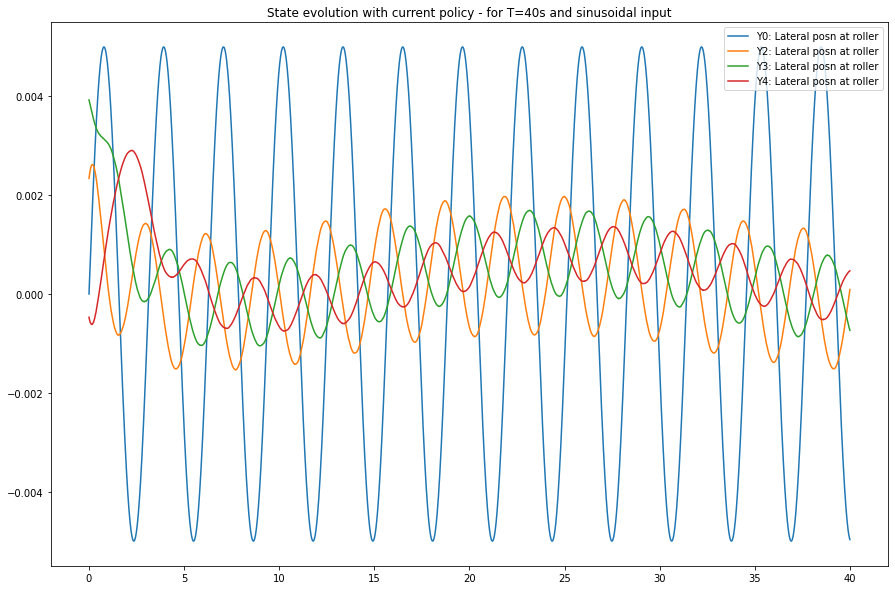

In [ ]:
plt.figure(figsize=(15,10))
plt.title("State evolution with current policy - for T=40s and sinusoidal input")

plt.plot(t_range, w, label='Y0: Lateral posn at roller')
plt.plot(t_range, states_evolution[2,:4001], label='Y2: Lateral posn at roller')
plt.plot(t_range, states_evolution[4,:4001], label='Y3: Lateral posn at roller')
plt.plot(t_range, states_evolution[6,:4001], label='Y4: Lateral posn at roller')

plt.legend() ;

In [ ]:
for params in alg.policy_net.parameters():
  print((params.data.dtype))

torch.float64
torch.float64
torch.float64
torch.float64
torch.float64
torch.float64


## Training loop

For square variations - square wave input

In [ ]:
Q = np.identity(10) ; 
Q[2,2] = 100 ; 
Q[4,4] = 1000

#env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1))

env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1), reset_type='random')

## Set up the action and observation spaces for the RDPG class

action_space = env.action_space
state_space  = env.full_observation_space # Full observation space is the observation space dim + 2 (for the input external disturbance measurement)

hidden_dim = 128
explore_steps = 2000

  # for random exploration
batch_size = 64  # each sample in batch is an episode for lstm policy (normally it's timestep)

replay_buffer_size=1e6
replay_buffer = ReplayBuffer(replay_buffer_size)
model_path='./model/ddpg_rand_init_step'
torch.autograd.set_detect_anomaly(True)
#alg = DDPG(replay_buffer, state_space, action_space, hidden_dim)

alg = DDPG_mod(replay_buffer, state_space, action_space, hidden_dim)

Q network:  QNetwork_mod(
  (linear1): Linear(in_features=12, out_features=128, bias=True)
  (linear2): Linear(in_features=128, out_features=128, bias=True)
  (linear3): Linear(in_features=129, out_features=128, bias=True)
  (linear4): Linear(in_features=128, out_features=1, bias=True)
)
Policy network:  DPG_PolicyNetwork(
  (linear1): Linear(in_features=12, out_features=128, bias=True)
  (linear2): Linear(in_features=128, out_features=128, bias=True)
  (linear3): Linear(in_features=128, out_features=1, bias=True)
)


In [ ]:
# hyper-parameters
max_episodes  = 100
max_steps   = 101
frame_idx   = 0
rewards=[]

t_range = np.linspace(0,(max_steps-1)/100,max_steps) 

## Define 2 kinds of external distrubances to train on 
## Sine wave disturbance
#w_sin = 0.02*0.25*np.sin(1.5*t_range) 

# ## Square wave disturbance
# w_step = np.zeros(t_range.shape)
# w_step[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25


for i_episode in range (max_episodes):

    #max_steps = max_steps + 100*(i_episode//100)
    
    t_range = np.linspace(0,(max_steps-1)/100,max_steps) 
    ## Square wave disturbance
    w_step = np.zeros(t_range.shape)
    w_step[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25

    ## Reset states of exploration noise
    alg.policy_net.random_proc.reset_states()
    alg.target_policy_net.random_proc.reset_states()
    
    q_loss_list=[]
    policy_loss_list=[]
    #state = env.reset()
    state = np.concatenate((env.C@(env.reset()), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]   
    # plt.figure()
    # plt.plot(state)
    # plt.title("States initialised for this episode")
    episode_reward = 0
    actions_evol = []  

    ## In alternate episodes give +sin and -sin inputs
    if (i_episode%2 == 0):
        w = w_step
    else:
        #w = w_step
        w = -w_step  
    
    ## Reduce noise scale as training progresses
    scl = i_episode//2 ; 
    noise_scale = 1e-2
    #noise_scale = 0

    if i_episode > 10 :
      noise_scale = 1e-2/(1+0.1*scl)

    print("Exploration noise variance for this episode =", noise_scale)

    for step in tqdm(range(max_steps)):
        #if frame_idx > explore_steps:
            #action = alg.policy_net.get_action(state)
        action = alg.policy_net.get_action(state, noise_scale=noise_scale)
        #else:
            #action = alg.policy_net.sample_action()

        #action = action/400

        actions_evol.append(action[0])

        #print("Current action chosen", action)
        #next_state, reward, done, _ = env.step(action)
        
        #print("Shape of current state", state.shape)

        true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
        next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
        reward = -cost      
        
        #print("Shape of next state", next_state.shape)

        replay_buffer.push(state, action, reward, next_state, done)
        
        state = next_state
        episode_reward += reward
        frame_idx += 1
        
        #if len(replay_buffer) > batch_size:
        if frame_idx > explore_steps:
            #print("Startig to update now")
            q_loss, policy_loss = alg.update(batch_size)
            q_loss_list.append(q_loss)
            policy_loss_list.append(policy_loss)
        
        if done:
            break
    
    plot(actions_evol)

    if i_episode % 10 == 0:
        #plot(rewards)
        plt.figure(figsize=(15,10))
        plt.plot(rewards)
        plt.title("Episodic rewards during training")
        alg.save_model(model_path)

        #######################################################
        ## Evaluate model at every 10 steps 
        test_episodes = 1
        max_steps_test=4001
        #alg.load_model(model_path)
        t_range = np.linspace(0,(max_steps_test-1)/100,max_steps_test)
        #w_sin = 0.02*0.25*np.sin(1.5*t_range)
        #w = w_step
        ## Square wave disturbance
        w_step = np.zeros(t_range.shape)
        w_step[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25

        w = w_step

        for test_episode in range (test_episodes):
            q_loss_list=[]
            policy_loss_list=[]
            #state = env.reset()
            state = np.concatenate((env.C@(env.reset()), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]            
            init_state_test = state
            states_evolution = state[:,None]
            episode_reward = 0

            for step in tqdm(range(max_steps_test)):
                action = alg.policy_net.get_action(state, noise_scale=0.0)  # no noise for testing
                action = action/400
                # next_state, reward, done, _ = env.step(action)
                true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
                next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
                reward = -cost  
                
                state = next_state

                states_evolution = np.concatenate((states_evolution, state[:,None]), axis=1)

                episode_reward += reward                              
                if done:
                    break

            plt.figure(figsize=(15,10))
            plt.title("State evolution with current policy - for T=40s and sinusoidal input")

            plt.plot(t_range, w, label='Y0: Lateral posn at roller')
            plt.plot(t_range, states_evolution[2,:4001], label='Y2: Lateral posn at roller')
            plt.plot(t_range, states_evolution[4,:4001], label='Y3: Lateral posn at roller')
            plt.plot(t_range, states_evolution[6,:4001], label='Y4: Lateral posn at roller')

            plt.legend() ;                  
        ######################################################################################################

    print('Eps: ', i_episode, '| Reward: ', episode_reward[0][0]/max_steps, '| Loss: ', np.average(q_loss_list), np.average(policy_loss_list))
    
    # if ((i_episode>10) and episode_reward[0][0]/max_steps > -(0.5)*0.001252983872292463):
    #   plot(rewards)
    #   alg.save_model(model_path)
    #   break
    #rewards.append(episode_reward[0][0])
    rewards.append(episode_reward[0][0]/max_steps)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
states_evolution.shape

(12, 2)

In [ ]:
test_episodes = 1
max_steps=1001
#alg.load_model(model_path)
t_range = np.linspace(0,(max_steps-1)/100,max_steps)
w_sin = 0.02*0.25*np.sin(2*t_range)

## Square wave disturbance
w_step = np.zeros(t_range.shape)
#w_step[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25
w_step[100:150] = 0.02*0.25

#w = w_step

w = w_step

for test_episode in range (test_episodes):
    q_loss_list=[]
    policy_loss_list=[]
    #state = env.reset()
    state = np.concatenate((env.C@(env.reset()), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]
    
    init_state_test = state

    states_evolution = state[:,None]

    episode_reward = 0

    for step in tqdm(range(max_steps)):
        action = alg.policy_net.get_action(state, noise_scale=0.0)  # no noise for testing

        #action = action/400

        # next_state, reward, done, _ = env.step(action)

        true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
        next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
        reward = -cost  
        
        state = next_state

        states_evolution = np.concatenate((states_evolution, state[:,None]), axis=1)

        episode_reward += reward
        
        
        if done:
            break
#rewards

  0%|          | 0/1001 [00:00<?, ?it/s]/usr/local/lib/python3.8/dist-packages/torch/nn/functional.py:1956: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
100%|██████████| 1001/1001 [00:14<00:00, 71.12it/s]


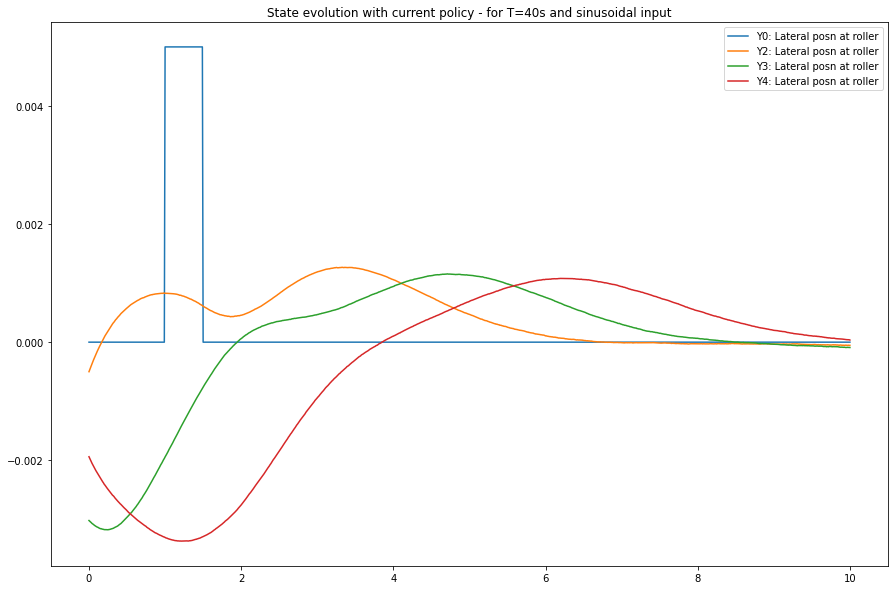

In [ ]:
plt.figure(figsize=(15,10))
plt.title("State evolution with current policy - for T=40s and sinusoidal input")

plt.plot(t_range, w, label='Y0: Lateral posn at roller')
plt.plot(t_range, states_evolution[2,:1001], label='Y2: Lateral posn at roller')
plt.plot(t_range, states_evolution[4,:1001], label='Y3: Lateral posn at roller')
plt.plot(t_range, states_evolution[6,:1001], label='Y4: Lateral posn at roller')

plt.legend() ;

I am adding some details from the paper for tghe training of the network --> I will mark these points in the code as #Implementation_Adds

1. Changed learning rates
2. L2 weight decay for Q
3. Check initialization of weights
4. Mini-batch size = 64
5. Ornstein Uhlenbeck process for exploration noise??

## Training loop

For No input

In [ ]:
Q = np.identity(10) ; 
Q[2,2] = 100 ; 
Q[4,4] = 1000

#env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1))

env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1), reset_type='random')

## Set up the action and observation spaces for the RDPG class

action_space = env.action_space
state_space  = env.full_observation_space # Full observation space is the observation space dim + 2 (for the input external disturbance measurement)

hidden_dim = 128
explore_steps = 2000

  # for random exploration
batch_size = 64  # each sample in batch is an episode for lstm policy (normally it's timestep)

replay_buffer_size=1e6
replay_buffer = ReplayBuffer(replay_buffer_size)
model_path='./model/ddpg_rand_init_no_ip'
torch.autograd.set_detect_anomaly(True)
#alg = DDPG(replay_buffer, state_space, action_space, hidden_dim)

alg = DDPG_mod(replay_buffer, state_space, action_space, hidden_dim)

Q network:  QNetwork_mod(
  (linear1): Linear(in_features=12, out_features=128, bias=True)
  (linear2): Linear(in_features=128, out_features=128, bias=True)
  (linear3): Linear(in_features=129, out_features=128, bias=True)
  (linear4): Linear(in_features=128, out_features=1, bias=True)
)
Policy network:  DPG_PolicyNetwork(
  (linear1): Linear(in_features=12, out_features=128, bias=True)
  (linear2): Linear(in_features=128, out_features=128, bias=True)
  (linear3): Linear(in_features=128, out_features=1, bias=True)
)


In [ ]:
# hyper-parameters
max_episodes  = 100
max_steps   = 101
frame_idx   = 0
rewards=[]

t_range = np.linspace(0,(max_steps-1)/100,max_steps) 

## Define 2 kinds of external distrubances to train on 
## Sine wave disturbance
#w_sin = 0.02*0.25*np.sin(1.5*t_range) 

# ## Square wave disturbance
# w_step = np.zeros(t_range.shape)
# w_step[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25


for i_episode in range (max_episodes):

    #max_steps = max_steps + 100*(i_episode//100)
    
    t_range = np.linspace(0,(max_steps-1)/100,max_steps) 
    ## No input disturbance
    w_step = np.zeros(t_range.shape)
    #w_step[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25

    ## Reset states of exploration noise
    alg.policy_net.random_proc.reset_states()
    alg.target_policy_net.random_proc.reset_states()
    
    q_loss_list=[]
    policy_loss_list=[]
    #state = env.reset()
    state = np.concatenate((env.C@(env.reset()), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]   
    # plt.figure()
    # plt.plot(state)
    # plt.title("States initialised for this episode")
    episode_reward = 0
    actions_evol = []  

    ## In alternate episodes give +sin and -sin inputs
    if (i_episode%2 == 0):
        w = w_step
    else:
        #w = w_step
        w = -w_step  
    
    ## Reduce noise scale as training progresses
    scl = i_episode//2 ; 
    noise_scale = 1e-2
    #noise_scale = 0

    if i_episode > 10 :
      noise_scale = 1e-2/(1+0.1*scl)

    print("Exploration noise variance for this episode =", noise_scale)

    for step in tqdm(range(max_steps)):
        #if frame_idx > explore_steps:
            #action = alg.policy_net.get_action(state)
        action = alg.policy_net.get_action(state, noise_scale=noise_scale)
        #else:
            #action = alg.policy_net.sample_action()

        #action = action/400

        actions_evol.append(action[0])

        #print("Current action chosen", action)
        #next_state, reward, done, _ = env.step(action)
        
        #print("Shape of current state", state.shape)

        true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
        next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
        reward = -cost      
        
        #print("Shape of next state", next_state.shape)

        replay_buffer.push(state, action, reward, next_state, done)
        
        state = next_state
        episode_reward += reward
        frame_idx += 1
        
        #if len(replay_buffer) > batch_size:
        if frame_idx > explore_steps:
            #print("Startig to update now")
            q_loss, policy_loss = alg.update(batch_size)
            q_loss_list.append(q_loss)
            policy_loss_list.append(policy_loss)
        
        if done:
            break
    
    plot(actions_evol)

    if i_episode % 10 == 0:
        #plot(rewards)
        plt.figure(figsize=(15,10))
        plt.plot(rewards)
        plt.title("Episodic rewards during training")
        alg.save_model(model_path)

        #######################################################
        ## Evaluate model at every 10 steps 
        test_episodes = 1
        max_steps_test=4001
        #alg.load_model(model_path)
        t_range = np.linspace(0,(max_steps_test-1)/100,max_steps_test)
        #w_sin = 0.02*0.25*np.sin(1.5*t_range)
        #w = w_step
        ## Square wave disturbance
        w_step = np.zeros(t_range.shape)
        w_step[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25

        w = w_step

        for test_episode in range (test_episodes):
            q_loss_list=[]
            policy_loss_list=[]
            #state = env.reset()
            state = np.concatenate((env.C@(env.reset()), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]            
            init_state_test = state
            states_evolution = state[:,None]
            episode_reward = 0

            for step in tqdm(range(max_steps_test)):
                action = alg.policy_net.get_action(state, noise_scale=0.0)  # no noise for testing
                action = action/400
                # next_state, reward, done, _ = env.step(action)
                true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
                next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
                reward = -cost  
                
                state = next_state

                states_evolution = np.concatenate((states_evolution, state[:,None]), axis=1)

                episode_reward += reward                              
                if done:
                    break

            plt.figure(figsize=(15,10))
            plt.title("State evolution with current policy - for T=40s and sinusoidal input")

            plt.plot(t_range, w, label='Y0: Lateral posn at roller')
            plt.plot(t_range, states_evolution[2,:4001], label='Y2: Lateral posn at roller')
            plt.plot(t_range, states_evolution[4,:4001], label='Y3: Lateral posn at roller')
            plt.plot(t_range, states_evolution[6,:4001], label='Y4: Lateral posn at roller')

            plt.legend() ;                  
        ######################################################################################################

    print('Eps: ', i_episode, '| Reward: ', episode_reward[0][0]/max_steps, '| Loss: ', np.average(q_loss_list), np.average(policy_loss_list))
    
    # if ((i_episode>10) and episode_reward[0][0]/max_steps > -(0.5)*0.001252983872292463):
    #   plot(rewards)
    #   alg.save_model(model_path)
    #   break
    #rewards.append(episode_reward[0][0])
    rewards.append(episode_reward[0][0]/max_steps)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
test_episodes = 1
max_steps=4001
#alg.load_model(model_path)
t_range = np.linspace(0,(max_steps-1)/100,max_steps)
w_sin = 0.02*0.25*np.sin(2*t_range)

## Square wave disturbance
w_step = np.zeros(t_range.shape)
#w_step[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25
#w_step[100:150] = 0.02*0.25

#w = w_step

w = w_step

for test_episode in range (test_episodes):
    q_loss_list=[]
    policy_loss_list=[]
    #state = env.reset()
    state = np.concatenate((env.C@(env.reset()), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]
    
    init_state_test = state

    states_evolution = state[:,None]

    episode_reward = 0

    for step in tqdm(range(max_steps)):
        action = alg.policy_net.get_action(state, noise_scale=0.0)  # no noise for testing

        action = action/400

        # next_state, reward, done, _ = env.step(action)

        true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
        next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
        reward = -cost  
        
        state = next_state

        states_evolution = np.concatenate((states_evolution, state[:,None]), axis=1)

        episode_reward += reward
        
        
        if done:
            break
#rewards

  0%|          | 0/4001 [00:00<?, ?it/s]/usr/local/lib/python3.8/dist-packages/torch/nn/functional.py:1956: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
100%|██████████| 4001/4001 [00:58<00:00, 68.64it/s]


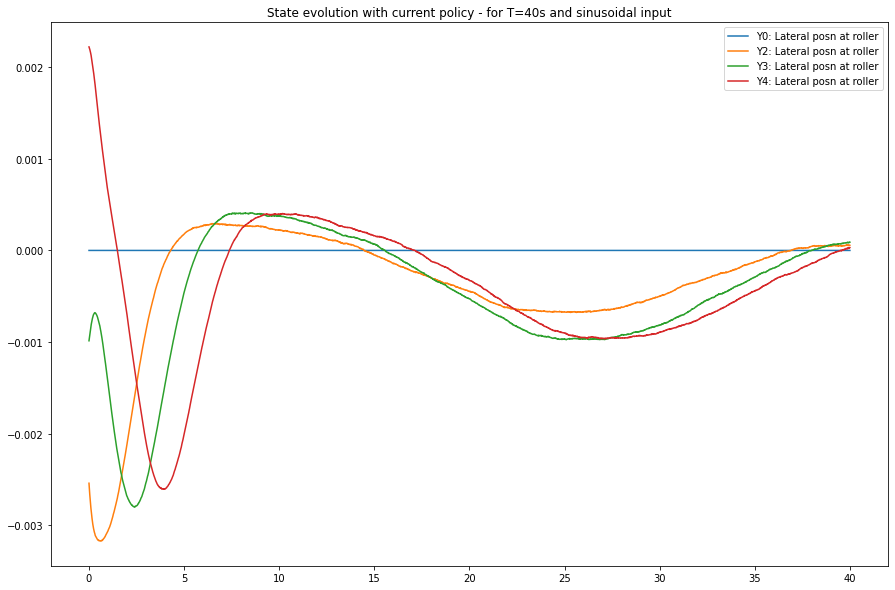

In [ ]:
plt.figure(figsize=(15,10))
plt.title("State evolution with current policy - for T=40s and sinusoidal input")

plt.plot(t_range, w, label='Y0: Lateral posn at roller')
plt.plot(t_range, states_evolution[2,:4001], label='Y2: Lateral posn at roller')
plt.plot(t_range, states_evolution[4,:4001], label='Y3: Lateral posn at roller')
plt.plot(t_range, states_evolution[6,:4001], label='Y4: Lateral posn at roller')

plt.legend() ;

500

## Training loop

For No input

In [ ]:
Q = np.identity(10) ; 
Q[2,2] = 100 ; 
Q[4,4] = 1000

#env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1))

env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1), reset_type='random')

## Set up the action and observation spaces for the RDPG class

action_space = env.action_space
state_space  = env.full_observation_space # FUll observation space is the observation space dim + 2 (for the input external disturbance measurement)

hidden_dim = 128
explore_steps = 200


  # for random exploration
batch_size = 64  # each sample in batch is an episode for lstm policy (normally it's timestep)

replay_buffer_size=1e6
replay_buffer = ReplayBuffer(replay_buffer_size)
model_path='./model/ddpg_rand_init2_no_ip'
torch.autograd.set_detect_anomaly(True)
#alg = DDPG(replay_buffer, state_space, action_space, hidden_dim)

alg = DDPG_mod(replay_buffer, state_space, action_space, hidden_dim)

Q network:  QNetwork_mod(
  (linear1): Linear(in_features=12, out_features=128, bias=True)
  (linear2): Linear(in_features=128, out_features=128, bias=True)
  (linear3): Linear(in_features=129, out_features=128, bias=True)
  (linear4): Linear(in_features=128, out_features=1, bias=True)
)
Policy network:  DPG_PolicyNetwork(
  (linear1): Linear(in_features=12, out_features=128, bias=True)
  (linear2): Linear(in_features=128, out_features=128, bias=True)
  (linear3): Linear(in_features=128, out_features=1, bias=True)
)


Exploration noise variance for this episode = 0.02


100%|██████████| 101/101 [00:01<00:00, 82.34it/s]


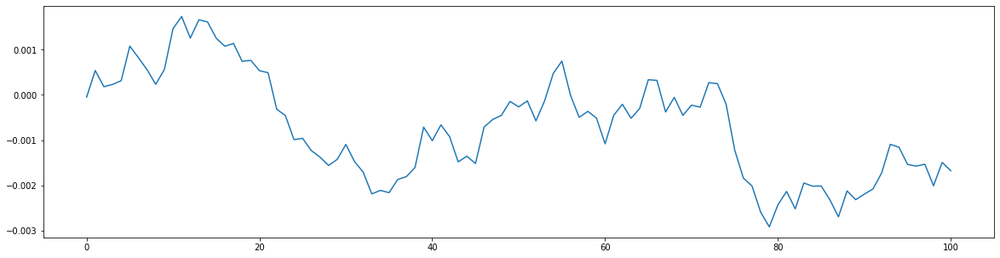

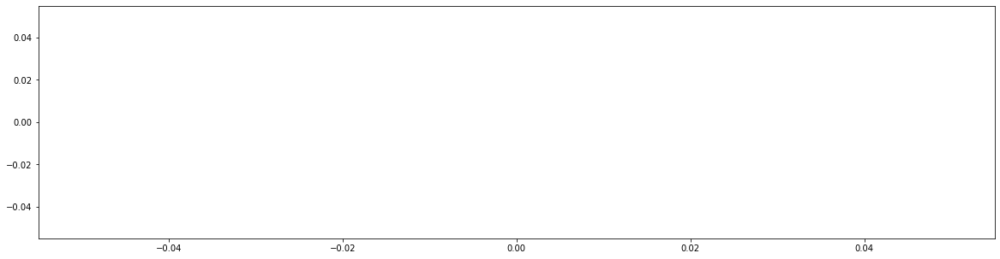

Eps:  0 | Reward:  -0.00039793570386076983 | Loss:  nan nan
Exploration noise variance for this episode = 0.013333333333333334


100%|██████████| 101/101 [00:01<00:00, 54.07it/s]


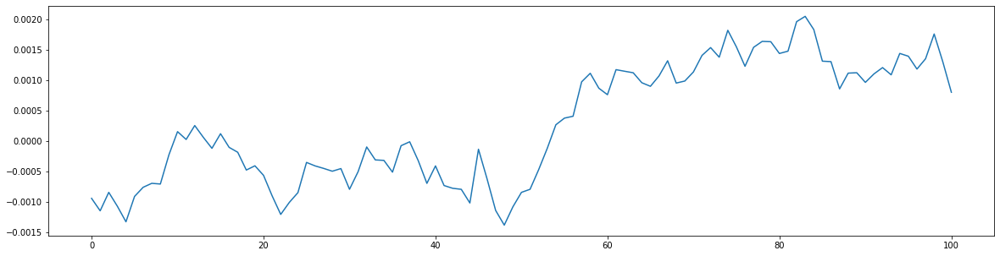

Eps:  1 | Reward:  -0.00041746871724067304 | Loss:  3.041579890694523e-05 0.004208885851979716
Exploration noise variance for this episode = 0.01


100%|██████████| 101/101 [00:08<00:00, 12.49it/s]


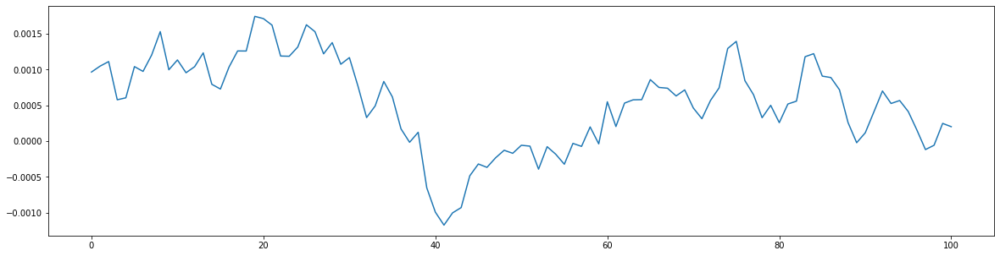

Eps:  2 | Reward:  -0.00019667036357754093 | Loss:  7.033354250558535e-07 0.0006640029150000495
Exploration noise variance for this episode = 0.008


100%|██████████| 101/101 [00:08<00:00, 12.38it/s]


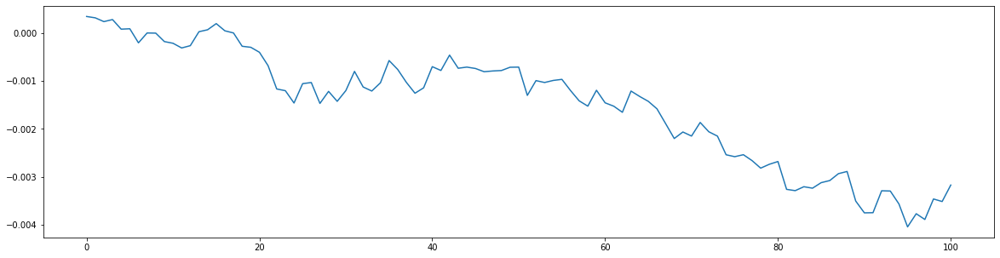

Eps:  3 | Reward:  -0.0005624027151775325 | Loss:  7.076438017123716e-09 0.0010858254605592636
Exploration noise variance for this episode = 0.006666666666666667


100%|██████████| 101/101 [00:08<00:00, 12.41it/s]


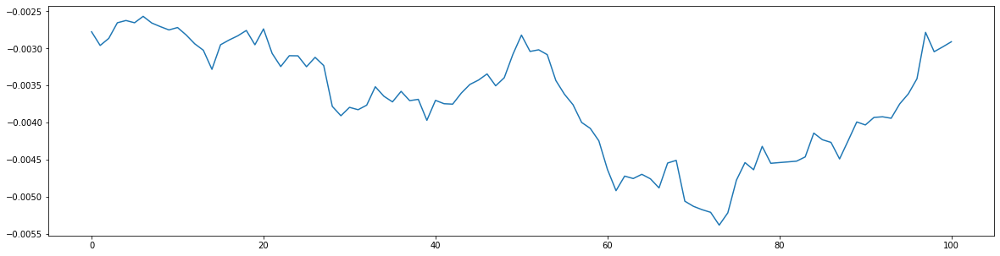

Eps:  4 | Reward:  -0.0018290174847383582 | Loss:  1.3944455482140277e-08 0.0015120888115827738
Exploration noise variance for this episode = 0.005714285714285714


100%|██████████| 101/101 [00:08<00:00, 12.55it/s]


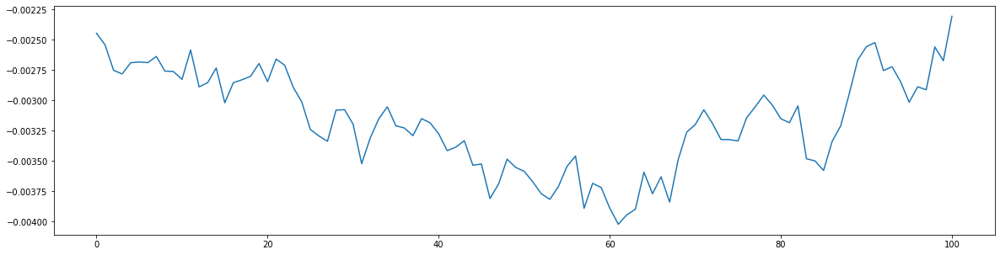

Eps:  5 | Reward:  -0.0016374489769786491 | Loss:  2.486530211335538e-08 0.0024659237514653375
Exploration noise variance for this episode = 0


100%|██████████| 101/101 [00:08<00:00, 12.01it/s]


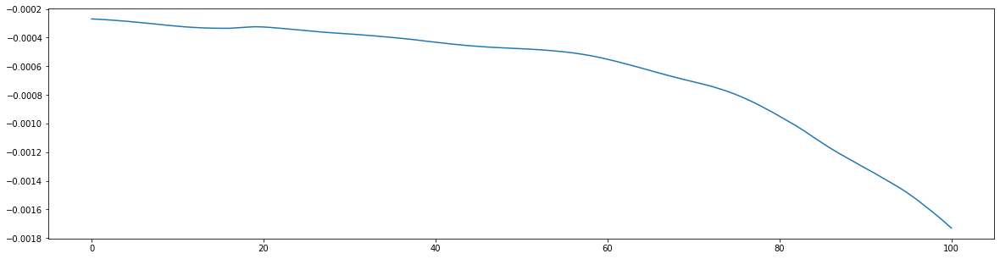

Eps:  6 | Reward:  -0.0004467938243911643 | Loss:  1.6380016532569388e-08 0.003461488239747317
Exploration noise variance for this episode = 0


100%|██████████| 101/101 [00:08<00:00, 12.34it/s]


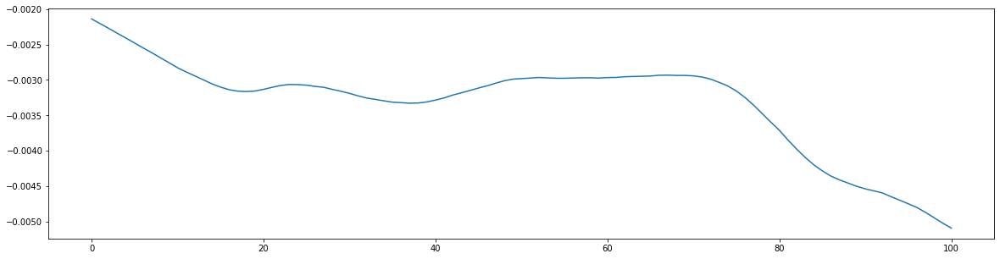

Eps:  7 | Reward:  -0.0015709364171255218 | Loss:  3.804735499559025e-08 0.004188933410734139
Exploration noise variance for this episode = 0


100%|██████████| 101/101 [00:07<00:00, 12.68it/s]


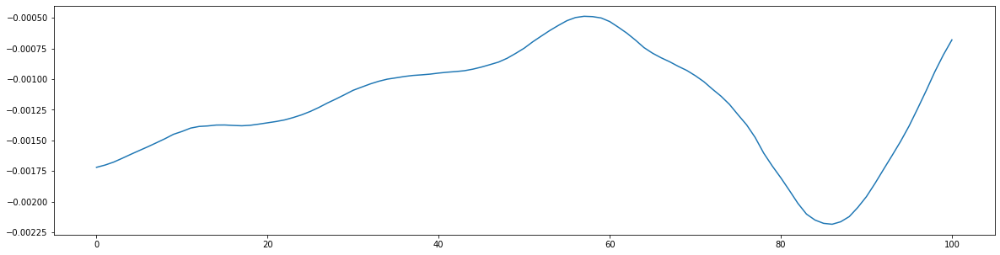

Eps:  8 | Reward:  -0.0007228779322487751 | Loss:  5.109809096914314e-08 0.005200376449694631
Exploration noise variance for this episode = 0


100%|██████████| 101/101 [00:07<00:00, 12.72it/s]


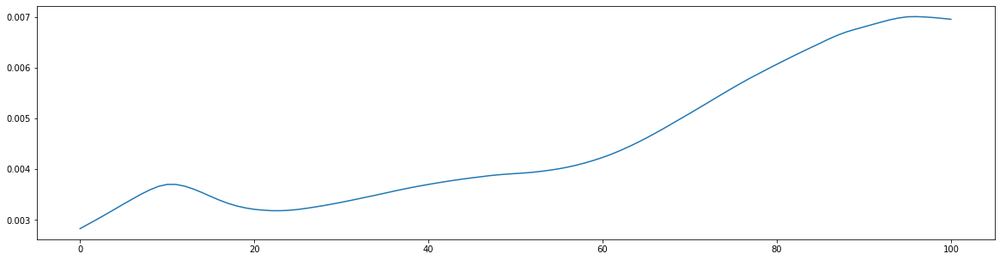

Eps:  9 | Reward:  -0.00033443334281777897 | Loss:  4.364386943071151e-08 0.005759892507601625
Exploration noise variance for this episode = 0


100%|██████████| 101/101 [00:08<00:00, 12.53it/s]


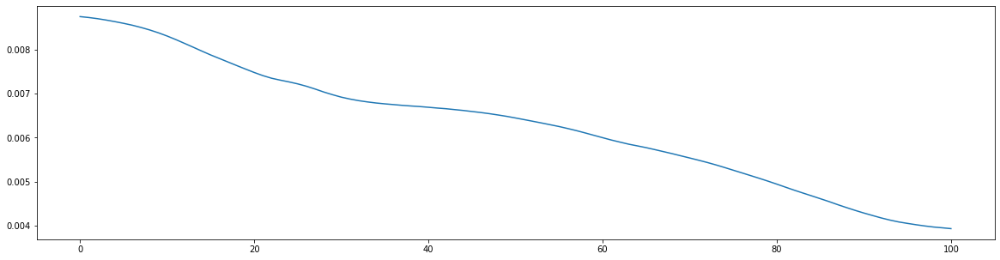

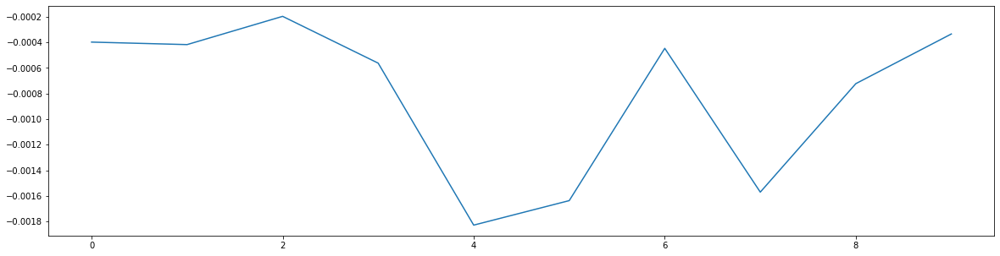

Eps:  10 | Reward:  -0.0016249759010933023 | Loss:  3.5341943335948134e-08 0.0061673251312442685
Exploration noise variance for this episode = 0


100%|██████████| 101/101 [00:07<00:00, 12.83it/s]


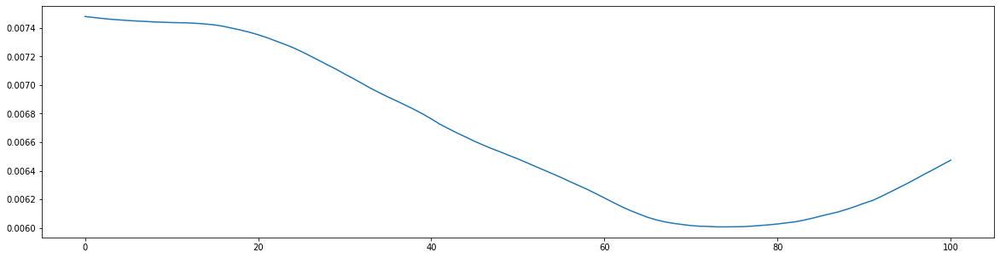

Eps:  11 | Reward:  -0.0015518733235344853 | Loss:  1.0064557672017605e-07 0.006574295828804523
Exploration noise variance for this episode = 0


100%|██████████| 101/101 [00:08<00:00, 12.48it/s]


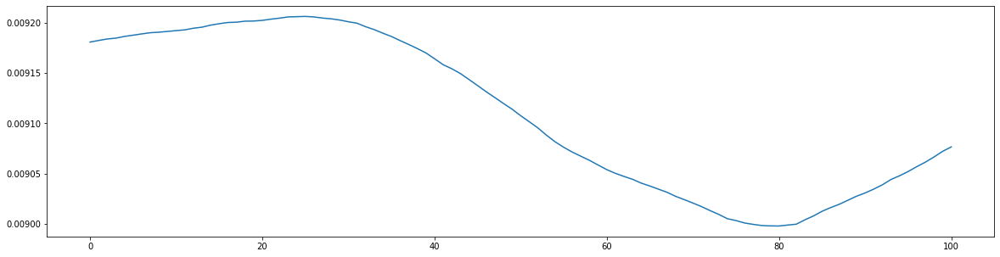

Eps:  12 | Reward:  -0.00313614672459605 | Loss:  1.587962953722184e-07 0.007022624833168332
Exploration noise variance for this episode = 0


100%|██████████| 101/101 [00:08<00:00, 12.52it/s]


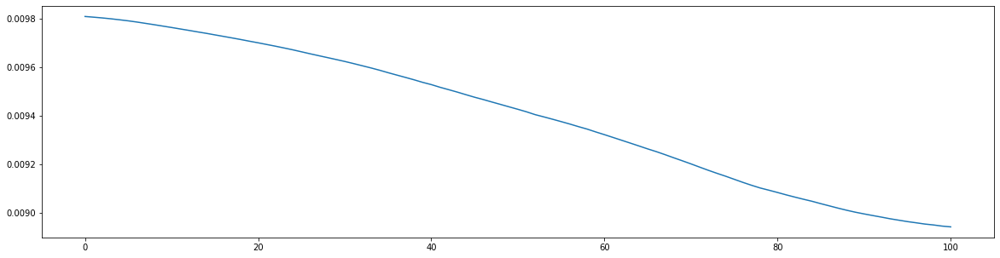

Eps:  13 | Reward:  -0.0035007737159608717 | Loss:  2.5831699350395633e-07 0.008545550097650428
Exploration noise variance for this episode = 0


100%|██████████| 101/101 [00:08<00:00, 12.54it/s]


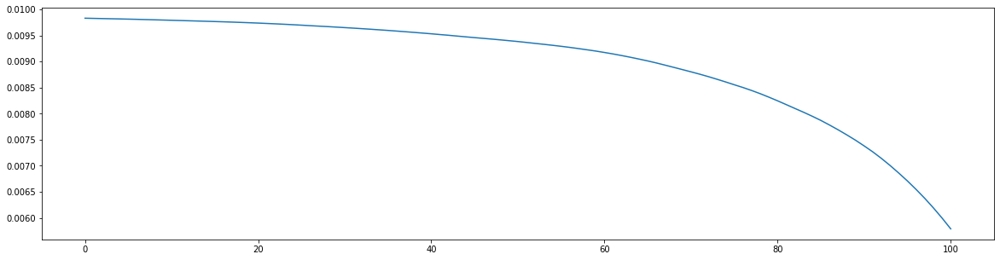

Eps:  14 | Reward:  -0.0033962809595657526 | Loss:  1.7434238311848278e-07 0.009880025590696232
Exploration noise variance for this episode = 0


100%|██████████| 101/101 [00:08<00:00, 12.61it/s]


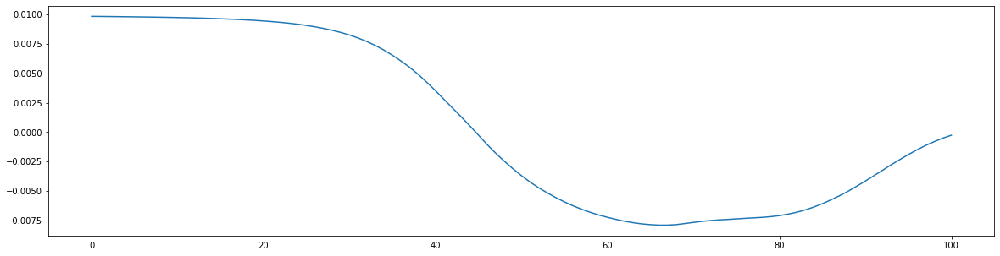

Eps:  15 | Reward:  -0.0006858082083809859 | Loss:  1.9365600855395497e-07 0.011668422820837188
Exploration noise variance for this episode = 0


100%|██████████| 101/101 [00:08<00:00, 12.36it/s]


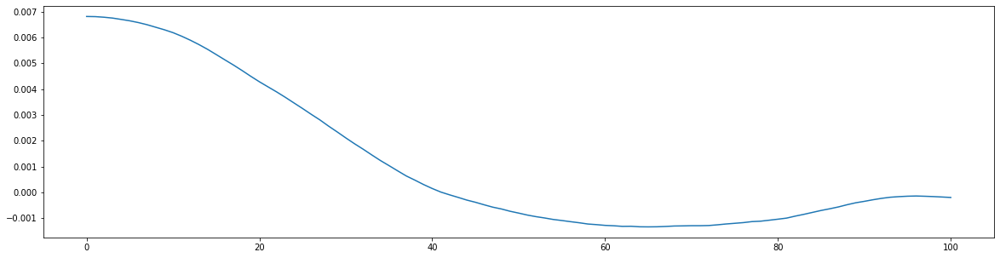

Eps:  16 | Reward:  -0.00011848633372674049 | Loss:  6.797522854910053e-08 0.011998899989970323
Exploration noise variance for this episode = 0


100%|██████████| 101/101 [00:08<00:00, 12.57it/s]


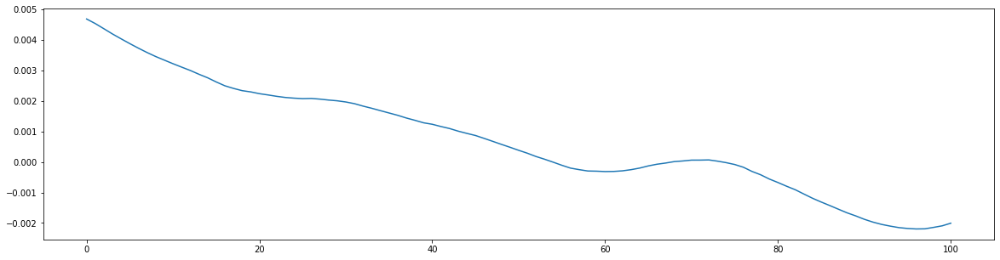

Eps:  17 | Reward:  -8.337379425140255e-05 | Loss:  4.221667105018003e-07 0.01229571323279732
Exploration noise variance for this episode = 0


100%|██████████| 101/101 [00:08<00:00, 12.47it/s]


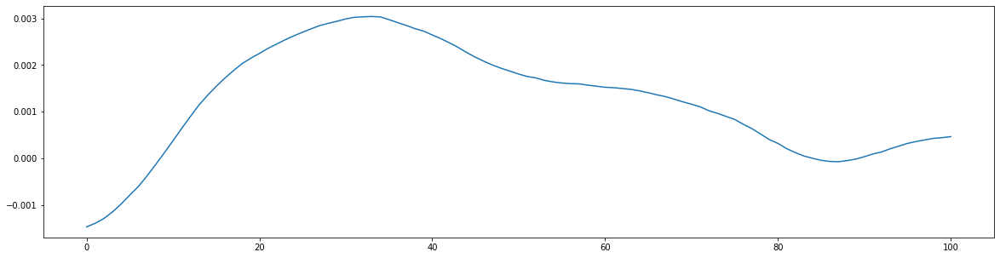

Eps:  18 | Reward:  -0.00014335137127058915 | Loss:  1.8179786945536155e-07 0.012845855615051685
Exploration noise variance for this episode = 0


100%|██████████| 101/101 [00:07<00:00, 12.68it/s]


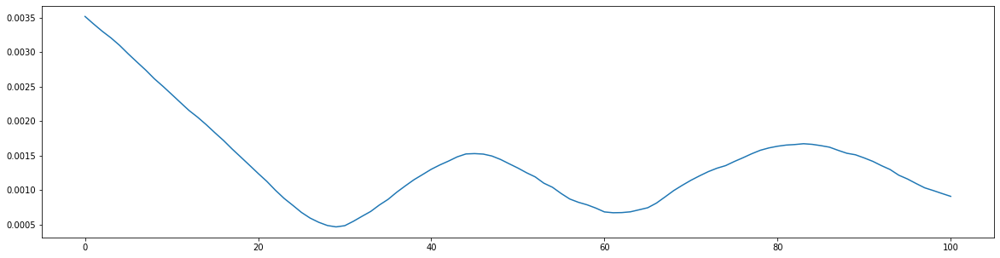

Eps:  19 | Reward:  -0.00010458565698825434 | Loss:  2.2045312463427174e-07 0.013746023100535833
Exploration noise variance for this episode = 0


100%|██████████| 101/101 [00:08<00:00, 12.61it/s]


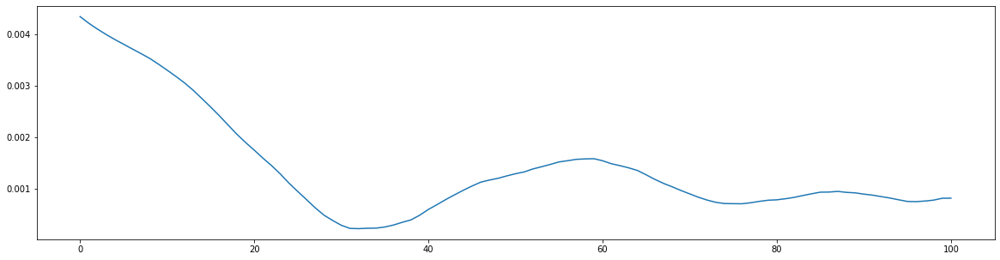

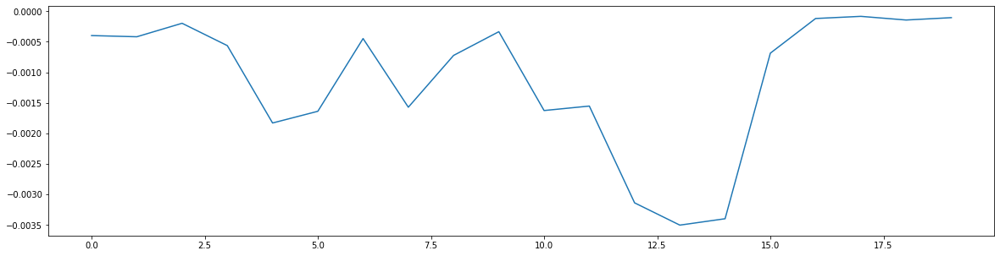

Eps:  20 | Reward:  -8.923014300394484e-05 | Loss:  5.46236198616781e-08 0.014394443822888308
Exploration noise variance for this episode = 0


100%|██████████| 101/101 [00:08<00:00, 12.59it/s]


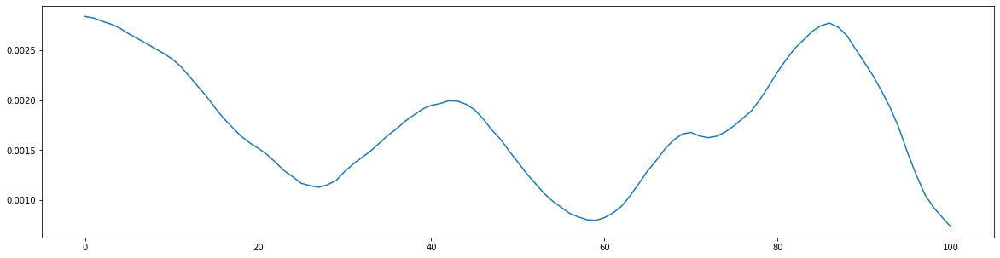

Eps:  21 | Reward:  -0.00010009495597047603 | Loss:  1.5543476118236583e-06 0.01449994229744166
Exploration noise variance for this episode = 0


100%|██████████| 101/101 [00:08<00:00, 12.32it/s]


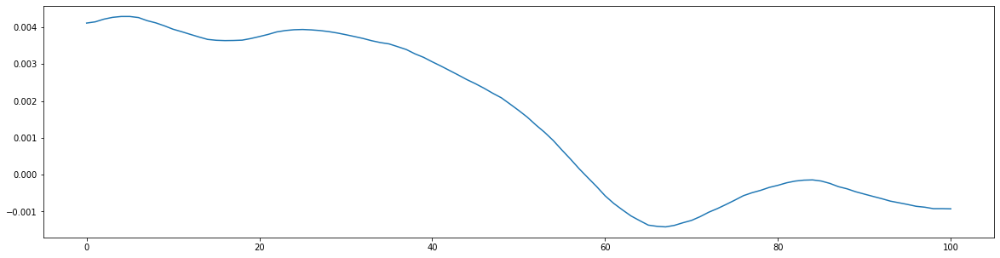

Eps:  22 | Reward:  -0.000116934707630416 | Loss:  5.104965275513065e-07 0.015327938925602792
Exploration noise variance for this episode = 0


100%|██████████| 101/101 [00:08<00:00, 12.59it/s]


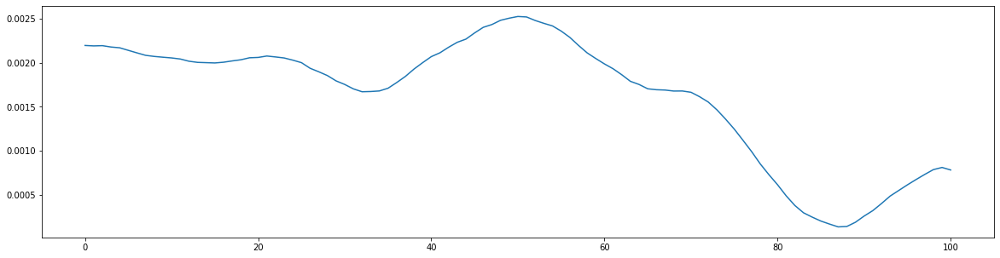

Eps:  23 | Reward:  -9.914054605919934e-05 | Loss:  4.0957538647161164e-08 0.015183380146687712
Exploration noise variance for this episode = 0


100%|██████████| 101/101 [00:08<00:00, 12.57it/s]


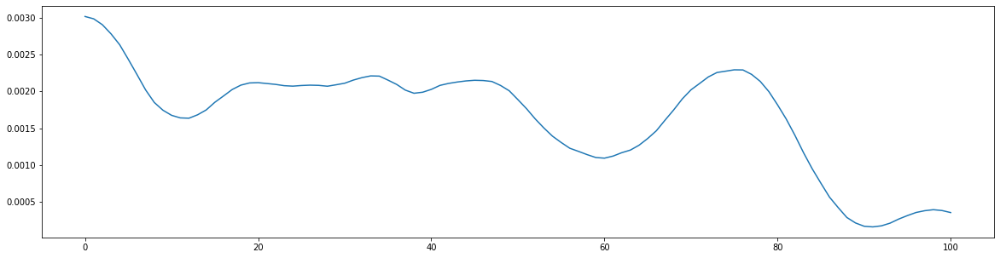

Eps:  24 | Reward:  -9.773849829122778e-05 | Loss:  7.723008483472973e-08 0.015343041578686437
Exploration noise variance for this episode = 0


100%|██████████| 101/101 [00:08<00:00, 12.61it/s]


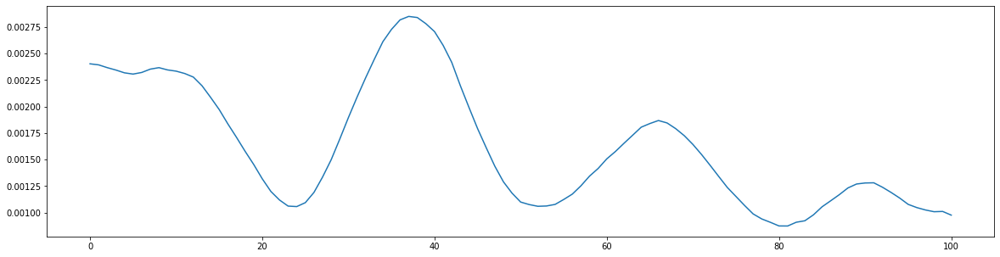

Eps:  25 | Reward:  -9.949896570920823e-05 | Loss:  7.495938928184296e-08 0.017049876168352025
Exploration noise variance for this episode = 0


 23%|██▎       | 23/101 [00:01<00:06, 12.30it/s]


KeyboardInterrupt: ignored

In [ ]:
# hyper-parameters
max_episodes  = 1000
max_steps   = 101
frame_idx   = 0
rewards=[]

t_range = np.linspace(0,(max_steps-1)/100,max_steps) 

## Define 2 kinds of external distrubances to train on 
## Sine wave disturbance
w_sin = 0*0.25*np.sin(2*t_range) 

## Square wave disturbance
w_step = np.zeros(t_range.shape)
w_step[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25



for i_episode in range (max_episodes):
    q_loss_list=[]
    policy_loss_list=[]
    #state = env.reset()
    np.concatenate((env.C@(env.reset()), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]   
    episode_reward = 0

    state = np.concatenate((env.C@(env.reset(init_rand_state)), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]
    states_evolution = state[:,None]

    actions_evol = [] ; 


    if (i_episode%2 == 0):
        w = w_sin
    else:
        #w = w_step
        w = w_sin   
    
    ## Reduce noise scale as training progresses

    scl = i_episode ; 
    noise_scale = 2e-2/(1+0.5*scl)

    if (i_episode > 5):
      noise_scale = 0

    #noise_scale = 0

    print("Exploration noise variance for this episode =", noise_scale)

    for step in tqdm(range(max_steps)):
        #if frame_idx > explore_steps:
            #action = alg.policy_net.get_action(state)
        action = alg.policy_net.get_action(state, noise_scale=noise_scale)
        #else:
         #   action = alg.policy_net.sample_action()

        #action = action/400

        actions_evol.append(action[0])

        #print("Current action chosen", action)
        #next_state, reward, done, _ = env.step(action)
        
        #print("Shape of current state", state.shape)

        true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
        next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
        reward = -cost      
        
        #print("Shape of next state", next_state.shape)

        replay_buffer.push(state, action, reward, next_state, done)
        
        state = next_state

        states_evolution = np.concatenate((states_evolution, state[:,None]), axis=1)

        episode_reward += reward
        frame_idx += 1
        
        #if len(replay_buffer) > batch_size:
        if frame_idx > explore_steps:
            q_loss, policy_loss = alg.update(batch_size)
            q_loss_list.append(q_loss)
            policy_loss_list.append(policy_loss)
        
        if done:
            break
    
    plot(actions_evol)
    #plot(states_evolution[2,:])
    #plot(states_evolution[4,:])
    #plot(states_evolution[6,:])

    if i_episode % 10 == 0:
        plot(rewards)
        alg.save_model(model_path)
    print('Eps: ', i_episode, '| Reward: ', episode_reward[0][0]/max_steps, '| Loss: ', np.average(q_loss_list), np.average(policy_loss_list))
    
    # if ((i_episode>10) and episode_reward[0][0]/max_steps > -(0.5)*0.001252983872292463):
    #   plot(rewards)
    #   alg.save_model(model_path)
      # break
    #rewards.append(episode_reward[0][0])
    rewards.append(episode_reward[0][0]/max_steps)

In [ ]:
test_episodes = 1
max_steps=2001
#alg.load_model(model_path)
t_range = np.linspace(0,(max_steps-1)/100,max_steps)
w_sin = 0*0.25*np.sin(5*t_range)

## Square wave disturbance
w_step = np.zeros(t_range.shape)
w_step[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25

#w = w_step

w = 0*w_step

for i_episode in range (test_episodes):
    q_loss_list=[]
    policy_loss_list=[]
    #state = env.reset()
    state = np.concatenate((env.C@(env.reset(init_rand_state)), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]

    states_evolution = state[:,None]

    episode_reward = 0

    for step in tqdm(range(max_steps)):
        action = alg.policy_net.get_action(state, noise_scale=0.0)  # no noise for testing

        action = action/400

        # next_state, reward, done, _ = env.step(action)

        true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
        next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
        reward = -cost  
        
        state = next_state

        states_evolution = np.concatenate((states_evolution, state[:,None]), axis=1)

        episode_reward += reward
        
        
        if done:
            break
#rewards

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.8/dist-packages/torch/nn/functional.py:1956: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
100%|██████████| 2001/2001 [00:16<00:00, 117.86it/s]


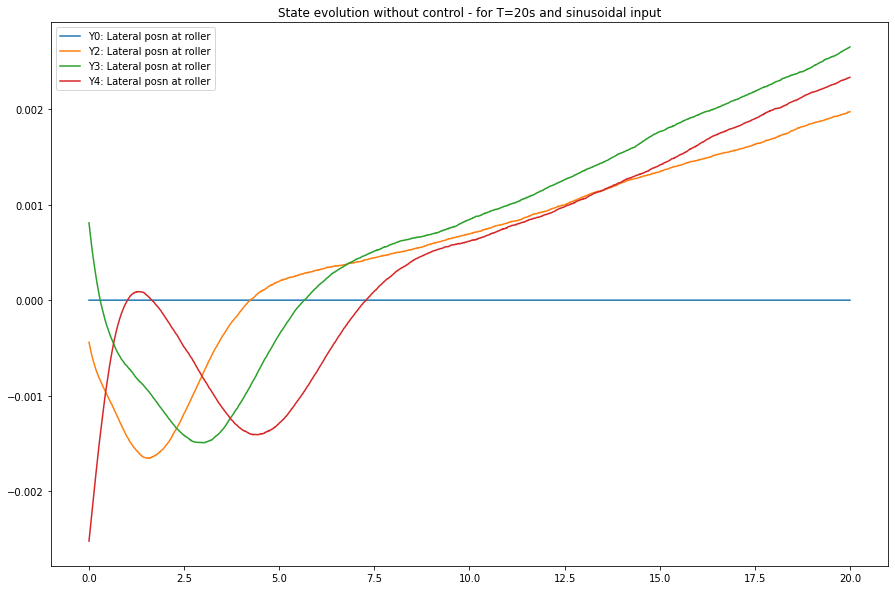

In [ ]:
plt.figure(figsize=(15,10))
plt.title("State evolution without control - for T=20s and sinusoidal input")

plt.plot(t_range, w, label='Y0: Lateral posn at roller')
#plt.plot(t_range, state_evolution[0,:2001], label='Y1: Lateral posn at roller')
# plt.plot(t_range, states_evolution[2,:1001], label='Y2: Lateral posn at roller')
# plt.plot(t_range, states_evolution[4,:1001], label='Y3: Lateral posn at roller')
# plt.plot(t_range, states_evolution[6,:1001], label='Y4: Lateral posn at roller')


plt.plot(t_range, states_evolution[2,:2001], label='Y2: Lateral posn at roller')
plt.plot(t_range, states_evolution[4,:2001], label='Y3: Lateral posn at roller')
plt.plot(t_range, states_evolution[6,:2001], label='Y4: Lateral posn at roller')

plt.legend() ;

## SANITY CHECK

Trying to learn policy in a supervised manner

In [ ]:
state_evolution.shape

(10, 4002)

In [ ]:
np.array(actions_evol).shape

(4001,)

In [ ]:
w1.shape

(4001,)

In [ ]:
X = np.concatenate((state_evolution[:,:4001], w1[None,:]), axis=0)
X = np.concatenate((X,np.zeros((1,4001)) ), axis=0)

In [ ]:
X.shape

(12, 4001)

In [ ]:
Y = w1[None,:]

In [ ]:
Y.shape

(1, 4001)

In [ ]:
myNet = DPG_PolicyNetwork(state_space,action_space,128)

In [ ]:
myNet = myNet.to(device)

In [ ]:
X_train = X[:,:3000]
Y_train = Y[:,:3000]

train_data = np.concatenate((X_train,Y_train), axis=0)
print(train_data.shape)

X_test = X[:,3000:]
Y_test = Y[:,3000:]

test_data = np.concatenate((X_test,Y_test), axis=0)

(13, 3000)


In [ ]:
batch_size = 100
n_iters = 10000

In [ ]:
train_loader = torch.utils.data.DataLoader(dataset=train_data.T, 
                                           batch_size=batch_size, 
                                           shuffle=True)

test_loader = torch.utils.data.DataLoader(dataset=test_data.T, 
                                          batch_size=batch_size, 
                                          shuffle=False)

In [ ]:
criterion = torch.nn.MSELoss()

In [ ]:
learning_rate = 1e-3
optimizer = torch.optim.SGD(myNet.parameters(), lr=learning_rate)  

In [ ]:
num_epochs = 100

iter = 0
for epoch in range(num_epochs):
    print("Running epoch = ", epoch)
    for (i, batch) in enumerate(train_loader):
        # Load images with gradient accumulation capabilities
        #images = images.view(-1, 28*28).requires_grad_()

        X_in = torch.tensor(batch[:,:12]).to(device)
        Y_out = torch.tensor(batch[:,12:]).to(device)

        # Clear gradients w.r.t. parameters
        optimizer.zero_grad()

        # Forward pass to get output/logits
        outputs = myNet(X_in)

        # Calculate Loss: softmax --> cross entropy loss
        loss = criterion(outputs, Y_out).to(device)

        # Getting gradients w.r.t. parameters
        loss.backward()

        # Updating parameters
        optimizer.step()

        iter += 1

        print("Current loss = ", loss)

        if iter % 500 == 0:
            # Calculate Accuracy         
            correct = 0
            total = 0
            # Iterate through test dataset
            for i, test_batch in test_loader:
                # Load images with gradient accumulation capabilities
                #images = images.view(-1, 28*28).requires_grad_()

                X_in_test = torch.tensor(test_batch[:,:12]).to(device)
                Y_out_test = torch.tensor(test_batch[:,12:]).to(device)                

                # Forward pass only to get logits/output
                outputs = myNet(X_in_test)                

            # Print Loss
            print('Iteration: {}. Loss: {}. Accuracy: {}'.format(iter, loss.item(), accuracy))

Running epoch =  0


<ipython-input-195-22e7fb5a4ff1>:10: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  X_in = torch.tensor(batch[:,:12]).to(device)
<ipython-input-195-22e7fb5a4ff1>:11: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  Y_out = torch.tensor(batch[:,12:]).to(device)


RuntimeError: ignored

In [ ]:
dtype(X_in)

TypeError: ignored

## Evaluation of trained models

Sample 10 different initial states

In [ ]:
env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=np.identity(10), R=np.identity(1), reset_type='random')

In [ ]:
init_states = env.reset()

for i in range(19):
  init_states = np.concatenate((init_states, env.reset()), axis=1)
print(init_states.shape)

(10, 20)


## sin(t_range)

In [ ]:
## Simulate system without any external input and plot state-evolution just to see 
## if it works

t_range = np.linspace(0,20,2001) 

## CHANGE HERE
w1 = 0.02*0.25*np.sin(t_range) ; 

all_init_state_evols = {}

for init_num in range(20):  
  env.reset(init_states[:,init_num][:,None])
  state_evolution = env.state ; 

  for t_step in range(t_range.shape[0]):     
  #for t_step in range(1):     
      t = t_range[t_step]
      #print("time = ", t)
      action = np.atleast_2d(np.array([0])).astype(np.float32) ; 
      #print(action)
      state, obs , cost, _, _ = env.step(action=action, meas_dist=np.atleast_2d(np.array([w1[t_step] , 0])).T, t_step=t_step)
      #total_costs += cost * gamma**(t)

      state_evolution = np.concatenate((state_evolution, state), axis=1)    
  all_init_state_evols[init_num] = state_evolution  

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution without control - for T=20s and sinusoidal input and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w1, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
  for init_num in range(20):
    plt.figure(figsize=(30,10))
    prtstr = "State evolution without control - for T=20s and sinusoidal input and initialization " + str(init_num)
    plt.title(prtstr)

    plt.plot(t_range, all_init_state_evols[init_num][1,:2001], label='Y1: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][3,:2001], label='Y2: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][5,:2001], label='Y3: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][7,:2001], label='Y4: Lateral velocity at roller')

    plt.legend() ;

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
env

## sin(1.5*t_range)

In [ ]:
## Simulate system without any external input and plot state-evolution just to see 
## if it works

t_range = np.linspace(0,20,2001) 

## CHANGE HERE
w1 = 0.02*0.25*np.sin(1.5*t_range) ; 

all_init_state_evols = {}

for init_num in range(20):  
  env.reset(init_states[:,init_num][:,None])
  state_evolution = env.state ; 

  for t_step in range(t_range.shape[0]):     
  #for t_step in range(1):     
      t = t_range[t_step]
      #print("time = ", t)
      action = np.atleast_2d(np.array([0])).astype(np.float32) ; 
      #print(action)
      state, obs , cost, _, _ = env.step(action=action, meas_dist=np.atleast_2d(np.array([w1[t_step] , 0])).T, t_step=t_step)
      #total_costs += cost * gamma**(t)

      state_evolution = np.concatenate((state_evolution, state), axis=1)    
  all_init_state_evols[init_num] = state_evolution  

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution without control - for T=20s and sinusoidal input and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w1, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
  for init_num in range(20):
    plt.figure(figsize=(30,10))
    prtstr = "State evolution without control - for T=20s and sinusoidal input and initialization " + str(init_num)
    plt.title(prtstr)

    plt.plot(t_range, all_init_state_evols[init_num][1,:2001], label='Y1: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][3,:2001], label='Y2: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][5,:2001], label='Y3: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][7,:2001], label='Y4: Lateral velocity at roller')

    plt.legend() ;

Output hidden; open in https://colab.research.google.com to view.

## sin(2*t_range)

In [ ]:
## Simulate system without any external input and plot state-evolution just to see 
## if it works

t_range = np.linspace(0,20,2001) 

## CHANGE HERE
w1 = 0.02*0.25*np.sin(2*t_range) ; 

all_init_state_evols = {}

for init_num in range(20):  
  env.reset(init_states[:,init_num][:,None])
  state_evolution = env.state ; 

  for t_step in range(t_range.shape[0]):     
  #for t_step in range(1):     
      t = t_range[t_step]
      #print("time = ", t)
      action = np.atleast_2d(np.array([0])).astype(np.float32) ; 
      #print(action)
      state, obs , cost, _, _ = env.step(action=action, meas_dist=np.atleast_2d(np.array([w1[t_step] , 0])).T, t_step=t_step)
      #total_costs += cost * gamma**(t)

      state_evolution = np.concatenate((state_evolution, state), axis=1)    
  all_init_state_evols[init_num] = state_evolution  

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution without control - for T=20s and sinusoidal input and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w1, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
  for init_num in range(20):
    plt.figure(figsize=(30,10))
    prtstr = "State evolution without control - for T=20s and sinusoidal input and initialization " + str(init_num)
    plt.title(prtstr)

    plt.plot(t_range, all_init_state_evols[init_num][1,:2001], label='Y1: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][3,:2001], label='Y2: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][5,:2001], label='Y3: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][7,:2001], label='Y4: Lateral velocity at roller')

    plt.legend() ;

Output hidden; open in https://colab.research.google.com to view.

## Sin(2,5*t_range)

In [ ]:
## Simulate system without any external input and plot state-evolution just to see 
## if it works

t_range = np.linspace(0,20,2001) 

## CHANGE HERE
w1 = 0.02*0.25*np.sin(2.5*t_range) ; 

all_init_state_evols = {}

for init_num in range(20):  
  env.reset(init_states[:,init_num][:,None])
  state_evolution = env.state ; 

  for t_step in range(t_range.shape[0]):     
  #for t_step in range(1):     
      t = t_range[t_step]
      #print("time = ", t)
      action = np.atleast_2d(np.array([0])).astype(np.float32) ; 
      #print(action)
      state, obs , cost, _, _ = env.step(action=action, meas_dist=np.atleast_2d(np.array([w1[t_step] , 0])).T, t_step=t_step)
      #total_costs += cost * gamma**(t)

      state_evolution = np.concatenate((state_evolution, state), axis=1)    
  all_init_state_evols[init_num] = state_evolution  

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution without control - for T=20s and sinusoidal input and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w1, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
  for init_num in range(20):
    plt.figure(figsize=(30,10))
    prtstr = "State evolution without control - for T=20s and sinusoidal input and initialization " + str(init_num)
    plt.title(prtstr)

    plt.plot(t_range, all_init_state_evols[init_num][1,:2001], label='Y1: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][3,:2001], label='Y2: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][5,:2001], label='Y3: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][7,:2001], label='Y4: Lateral velocity at roller')

    plt.legend() ;

Output hidden; open in https://colab.research.google.com to view.

## sin(3t) 

In [ ]:
## Simulate system without any external input and plot state-evolution just to see 
## if it works

t_range = np.linspace(0,20,2001) 

## CHANGE HERE
w1 = 0.02*0.25*np.sin(3*t_range) ; 

all_init_state_evols = {}

for init_num in range(20):  
  env.reset(init_states[:,init_num][:,None])
  state_evolution = env.state ; 

  for t_step in range(t_range.shape[0]):     
  #for t_step in range(1):     
      t = t_range[t_step]
      #print("time = ", t)
      action = np.atleast_2d(np.array([0])).astype(np.float32) ; 
      #print(action)
      state, obs , cost, _, _ = env.step(action=action, meas_dist=np.atleast_2d(np.array([w1[t_step] , 0])).T, t_step=t_step)
      #total_costs += cost * gamma**(t)

      state_evolution = np.concatenate((state_evolution, state), axis=1)    
  all_init_state_evols[init_num] = state_evolution  

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution without control - for T=20s and sinusoidal input and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w1, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
  for init_num in range(20):
    plt.figure(figsize=(30,10))
    prtstr = "State evolution without control - for T=20s and sinusoidal input and initialization " + str(init_num)
    plt.title(prtstr)

    plt.plot(t_range, all_init_state_evols[init_num][1,:2001], label='Y1: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][3,:2001], label='Y2: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][5,:2001], label='Y3: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][7,:2001], label='Y4: Lateral velocity at roller')

    plt.legend() ;

Output hidden; open in https://colab.research.google.com to view.

## sin(t) control with ELQR

In [ ]:
## Simulate system withELQR control
## if it works

Q = np.identity(10) ; 
Q[2,2] = 100 ; 
Q[4,4] = 1000

# Q[0,0] = 0 ; 
# Q[1,1] = 0 ; 
# Q[2,2] = 0 ; 
# Q[3,3] = 0 ; 
# Q[5,5] = 0 ; 
# Q[7,7] = 0 ; 
# Q[8,8] = 0 ; 
# Q[9,9] = 0 ; 

R = np.identity(1) ;


#env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1))
env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1), reset_type='random')
K,G = gen_ELQR_mats(A=A_nom, B=B_nom, F=F_nom, env=env)

#t_range = np.linspace(0,20,2001) 

t_range = np.linspace(0,20,2001) 

w1 = 0.02*0.25*np.sin(t_range) ; 

all_init_state_evols = {}
all_init_state_ep_rewards = {}

for init_num in range(20): 
  env.reset(init_states[:,init_num][:,None])
  state_evolution = env.state ; 

  #actions_evol = [] ; 

  ep_rewards = [] ;

  for t_step in range(t_range.shape[0]):     
  #for t_step in range(1):   
      t = t_range[t_step]
      #print("time = ", t)

      meas_dist = np.atleast_2d(np.array([w1[t_step] , 0])).T
      ut = -(K@state + G@meas_dist)

      action = np.atleast_2d(ut).astype(np.float32) ; 

      actions_evol.append(ut[0][0])
      ep_rewards.append((state.T@Q@state + ut.T@R@ut)[0][0])


      state, obs , cost, _, _ = env.step(action=action, meas_dist=np.atleast_2d(np.array([w1[t_step] , 0])).T, t_step=t_step)
      #total_costs += cost * gamma**(t)

      state_evolution = np.concatenate((state_evolution, state), axis=1)
  all_init_state_evols[init_num] = state_evolution 
  all_init_state_ep_rewards[init_num] = ep_rewards

Mean Cost =  0.0011624132206355074
Mean Cost =  0.0012744864181295657
Mean Cost =  0.0018095013065968016
Mean Cost =  0.0011648999992311285
Mean Cost =  0.0012268182720010204
Mean Cost =  0.0012761326569821017
Mean Cost =  0.0014579288662444235
Mean Cost =  0.0015381202902953262
Mean Cost =  0.0013068147999105518
Mean Cost =  0.0014749340384109762
Mean Cost =  0.0011685674796858862
Mean Cost =  0.0014403299230660632
Mean Cost =  0.001163663992514292
Mean Cost =  0.0011947041621070882
Mean Cost =  0.001484105427152522
Mean Cost =  0.001167120872500336
Mean Cost =  0.0014898255604911693
Mean Cost =  0.0014367887951165829
Mean Cost =  0.0014015599035802897
Mean Cost =  0.0013679562193071244
Average cost over all runs =  0.001350333610197938


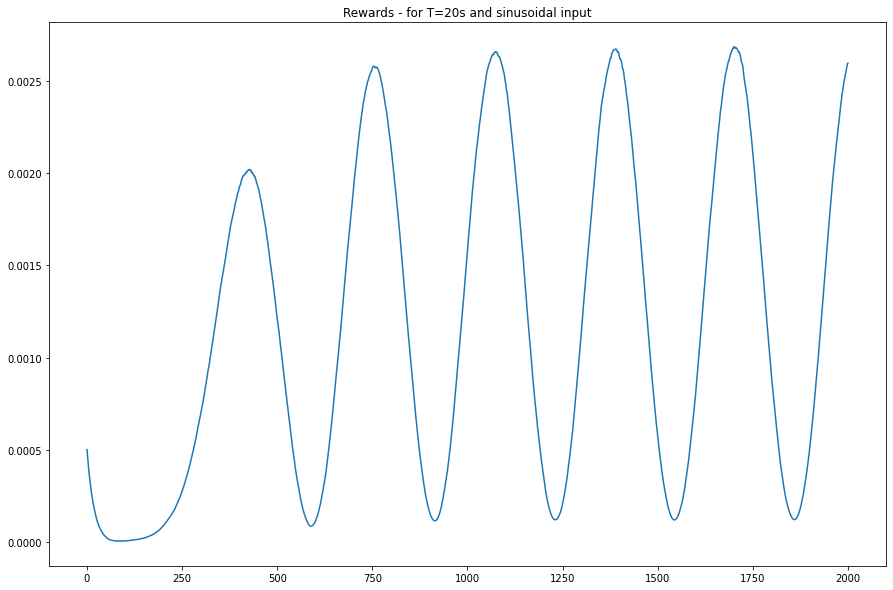

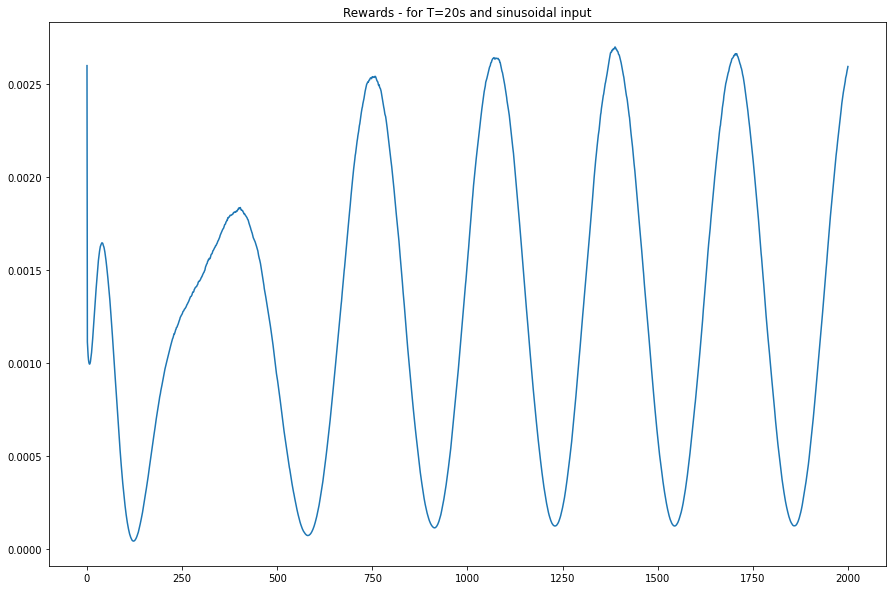

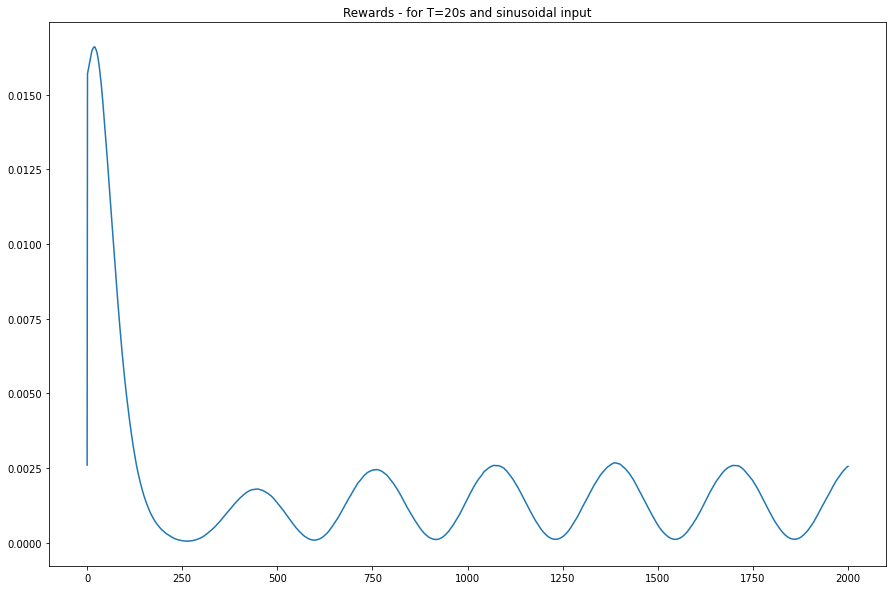

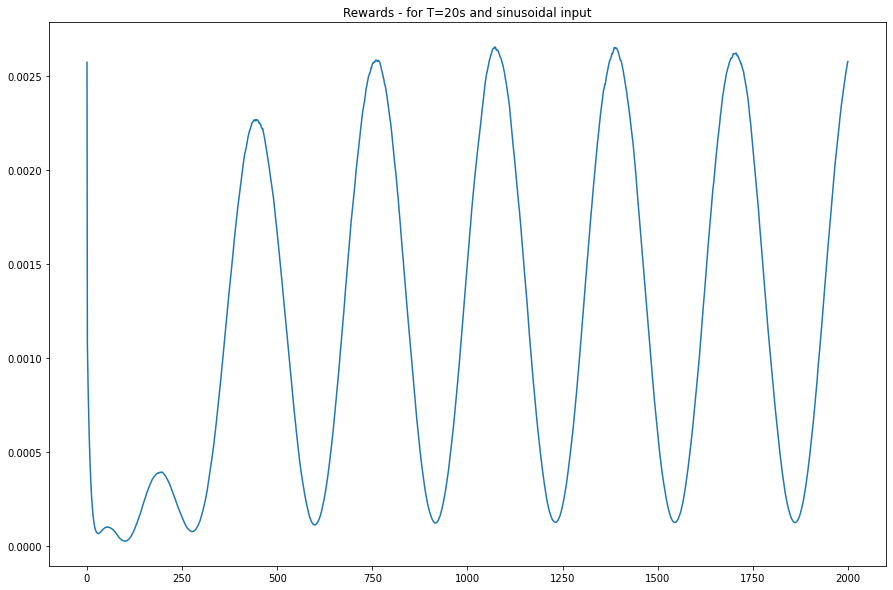

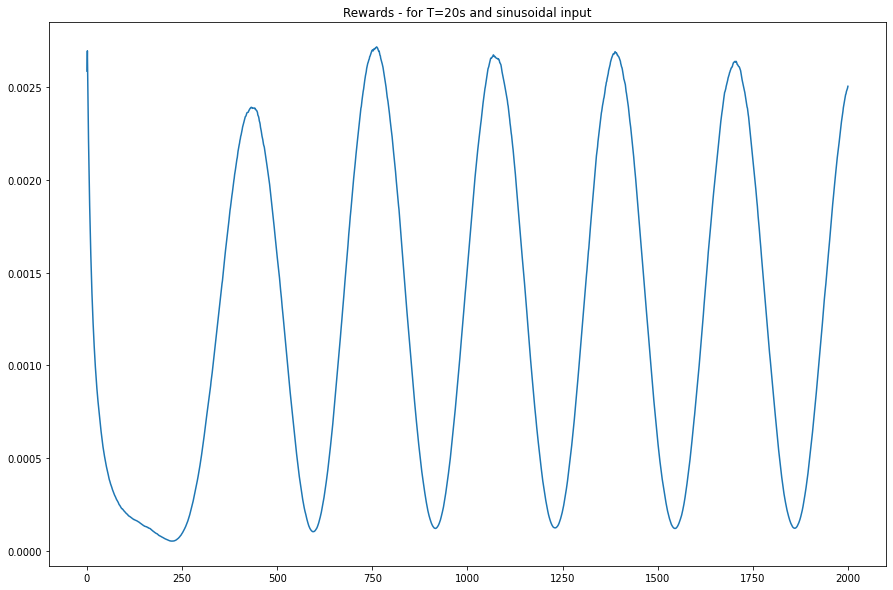

...

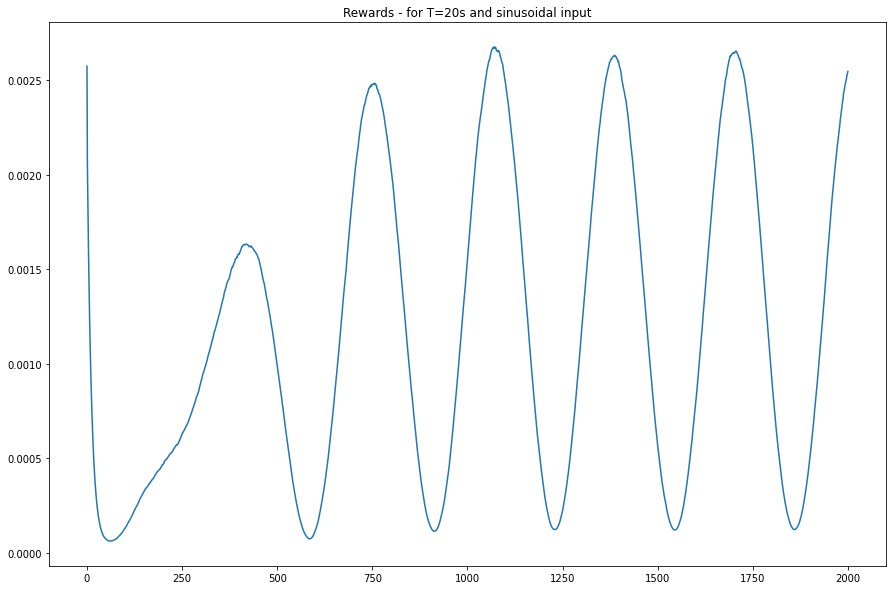

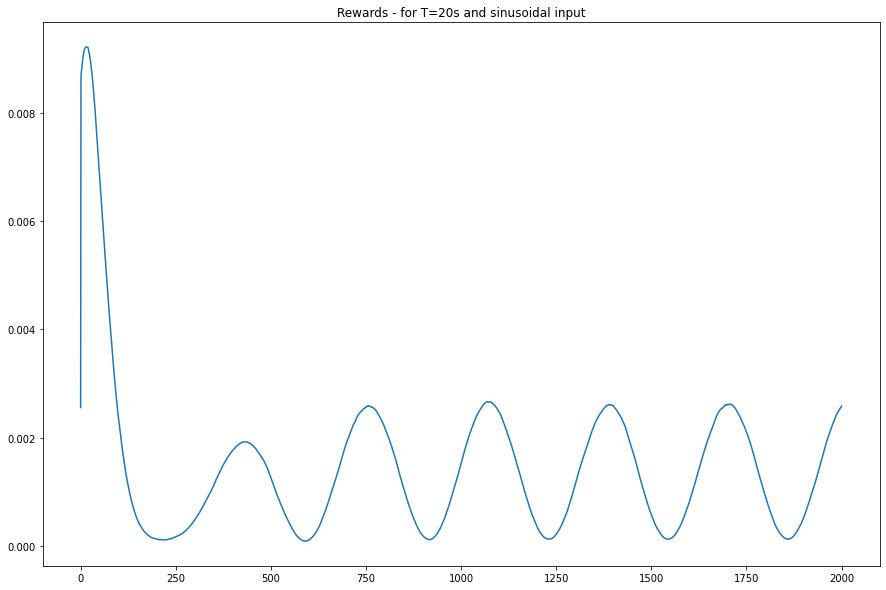

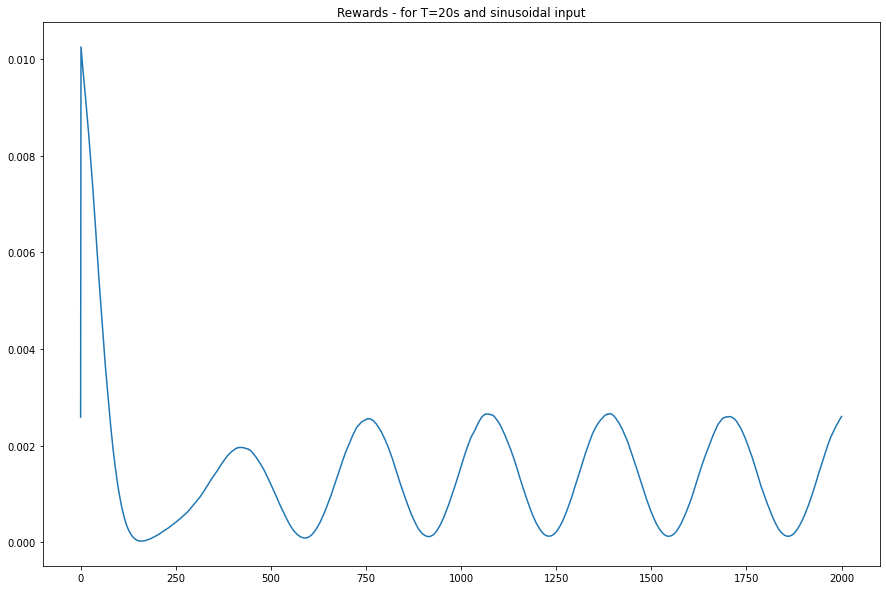

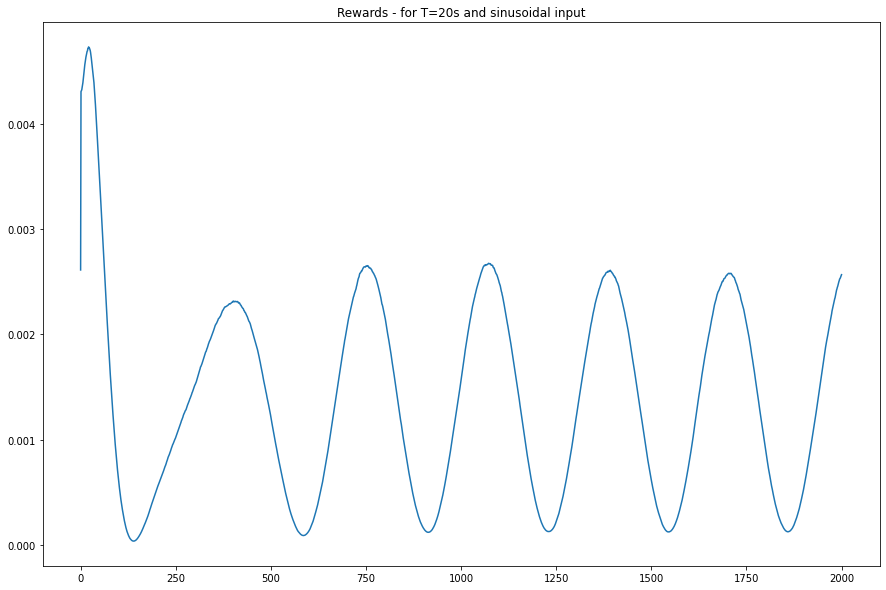

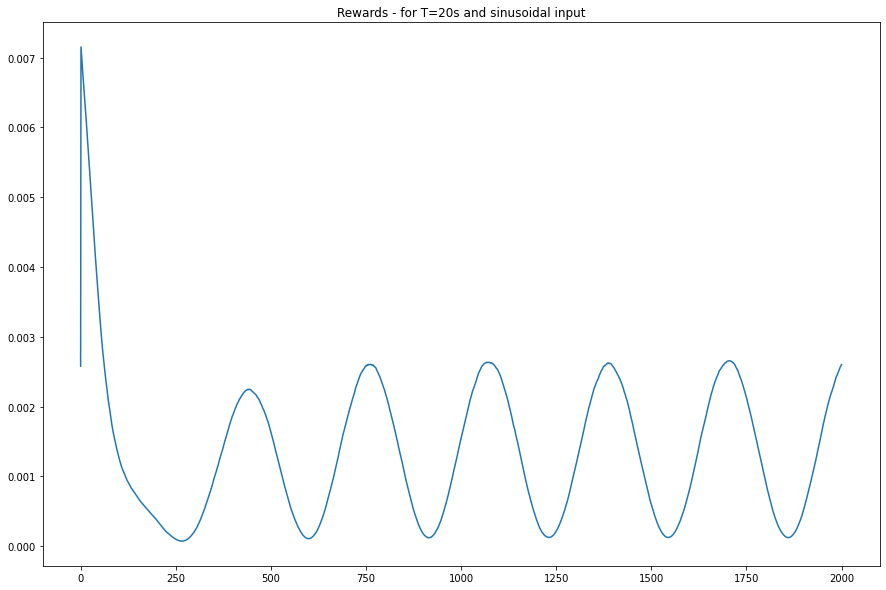

In [ ]:
total_reward = 0

for init_num in range(20): 
  plt.figure(figsize=(15,10))
  plt.title("Rewards - for T=20s and sinusoidal input")
  plt.plot( all_init_state_ep_rewards[init_num]) ; 
  print("Mean Cost = ", sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])) ;
  total_reward += sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])

print("Average cost over all runs = ", total_reward/20)

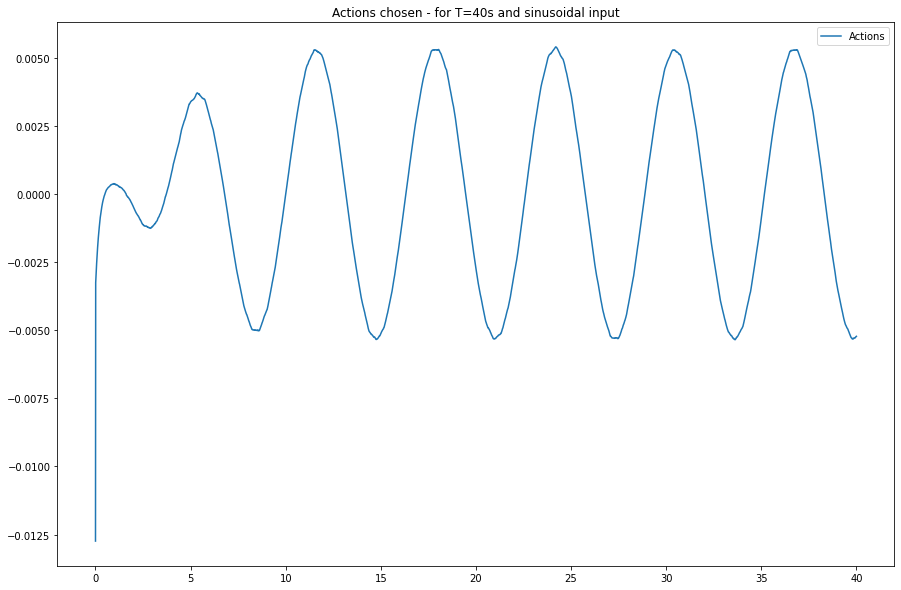

In [ ]:
plt.figure(figsize=(15,10))
plt.title("Actions chosen - for T=40s and sinusoidal input")
plt.plot(t_range, actions_evol, label='Actions')
#plt.plot(t_range[5:], w1[5:], label='Y0: Lateral posn at roller')
plt.legend() ;

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution with ELQR control - for T=20s and sinusoidal input and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w1, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

Output hidden; open in https://colab.research.google.com to view.

## ELQR for sin(2t)

In [ ]:
## Simulate system withELQR control
## if it works

Q = np.identity(10) ; 
Q[2,2] = 100 ; 
Q[4,4] = 1000

# Q[0,0] = 0 ; 
# Q[1,1] = 0 ; 
# Q[2,2] = 0 ; 
# Q[3,3] = 0 ; 
# Q[5,5] = 0 ; 
# Q[7,7] = 0 ; 
# Q[8,8] = 0 ; 
# Q[9,9] = 0 ; 

R = np.identity(1) ;


#env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1))
env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1), reset_type='random')
K,G = gen_ELQR_mats(A=A_nom, B=B_nom, F=F_nom, env=env)

#t_range = np.linspace(0,20,2001) 

t_range = np.linspace(0,20,2001) 

w1 = 0.02*0.25*np.sin(2*t_range) ; 

all_init_state_evols = {}
all_init_state_ep_rewards = {}

for init_num in range(20): 
  env.reset(init_states[:,init_num][:,None])
  state_evolution = env.state ; 

  #actions_evol = [] ; 

  ep_rewards = [] ;

  for t_step in range(t_range.shape[0]):     
  #for t_step in range(1):   
      t = t_range[t_step]
      #print("time = ", t)

      meas_dist = np.atleast_2d(np.array([w1[t_step] , 0])).T
      ut = -(K@state + G@meas_dist)

      action = np.atleast_2d(ut).astype(np.float32) ; 

      actions_evol.append(ut[0][0])
      ep_rewards.append((state.T@Q@state + ut.T@R@ut)[0][0])


      state, obs , cost, _, _ = env.step(action=action, meas_dist=np.atleast_2d(np.array([w1[t_step] , 0])).T, t_step=t_step)
      #total_costs += cost * gamma**(t)

      state_evolution = np.concatenate((state_evolution, state), axis=1)
  all_init_state_evols[init_num] = state_evolution 
  all_init_state_ep_rewards[init_num] = ep_rewards

Mean Cost =  0.00017079745874288869
Mean Cost =  0.0003200886398892248
Mean Cost =  0.0008372863820755671
Mean Cost =  0.0001355118904129215
Mean Cost =  0.00018526857019585325
Mean Cost =  0.00028496700398853336
Mean Cost =  0.0004672847704592073
Mean Cost =  0.0005278488227531516
Mean Cost =  0.0003173932206974816
Mean Cost =  0.0004819240002675716
Mean Cost =  0.0001377234348116127
Mean Cost =  0.00041356142958182314
Mean Cost =  0.00018730398863195754
Mean Cost =  0.00018885644852367238
Mean Cost =  0.0005180827211023351
Mean Cost =  0.00021933139199152964
Mean Cost =  0.0005026924039954288
Mean Cost =  0.00045307622265154733
Mean Cost =  0.00040318538749220523
Mean Cost =  0.00034274629663777804
Average cost over all runs =  0.00035474652424511457


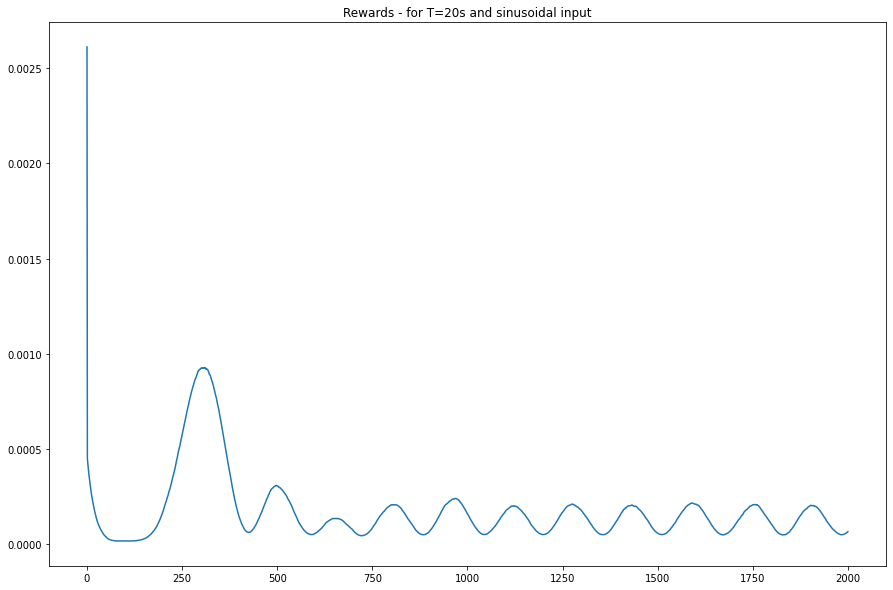

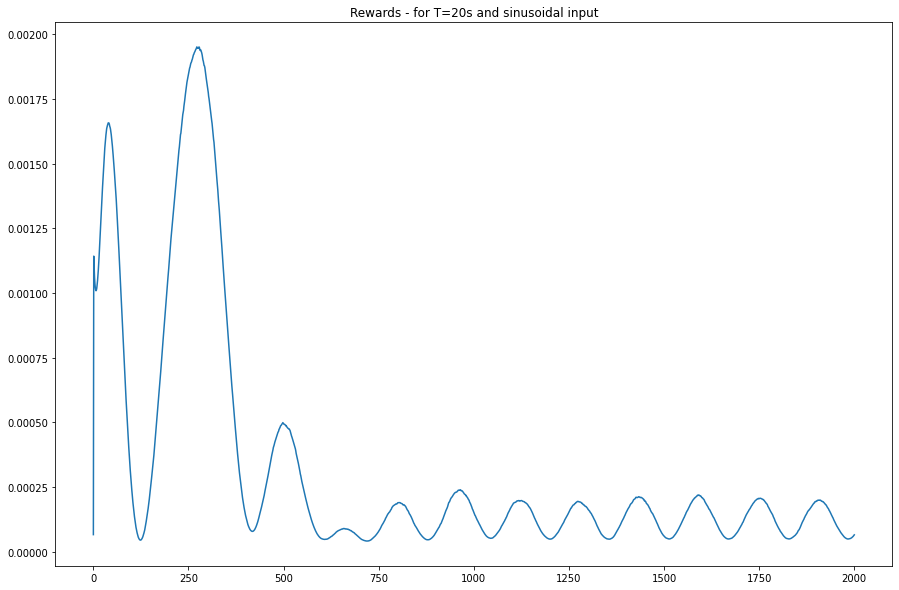

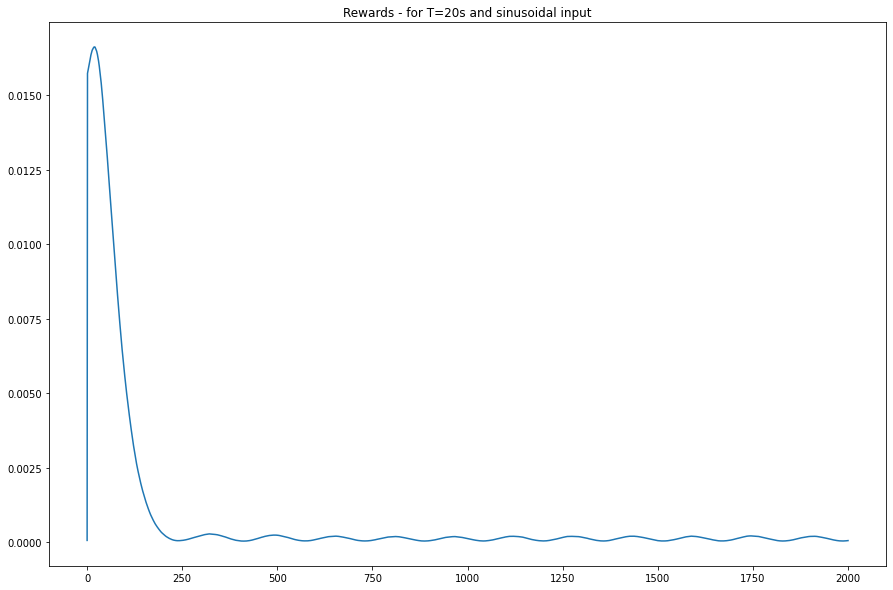

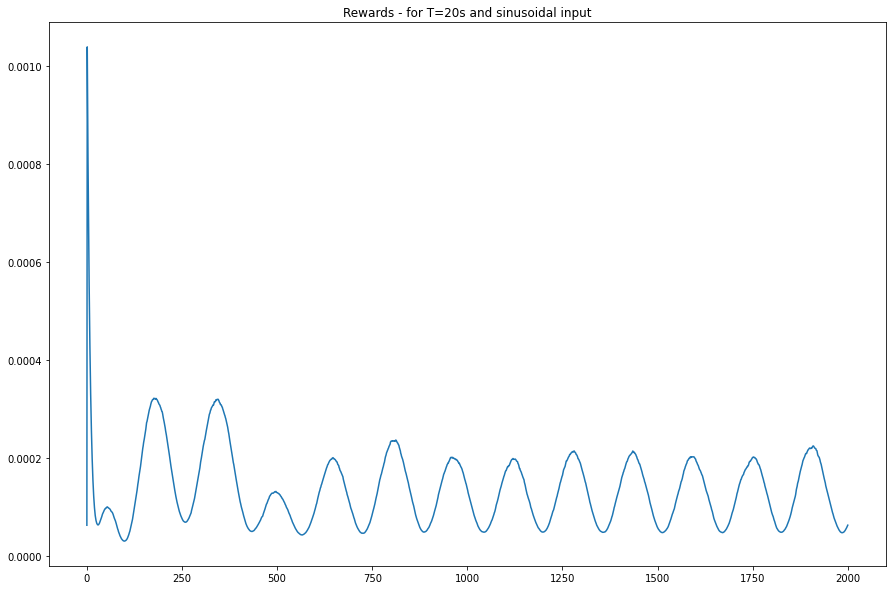

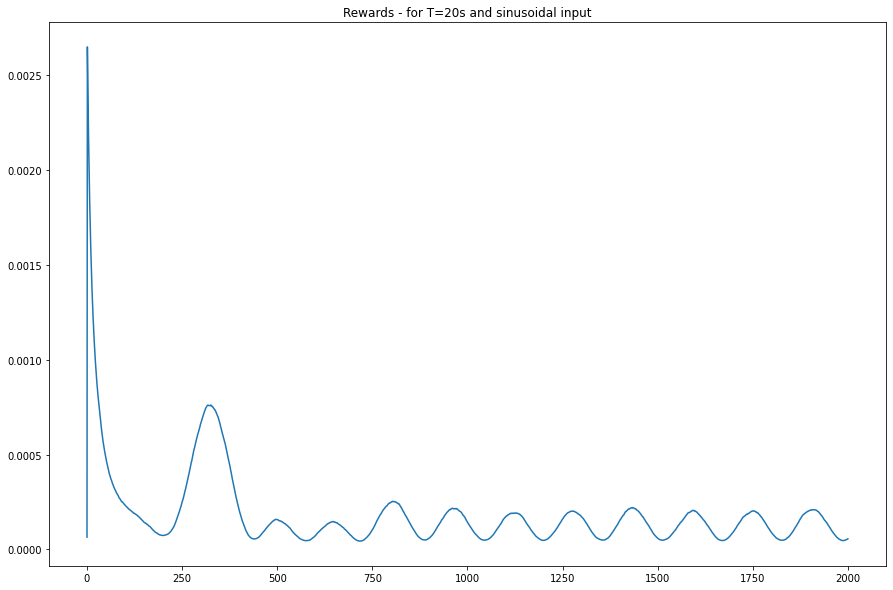

...

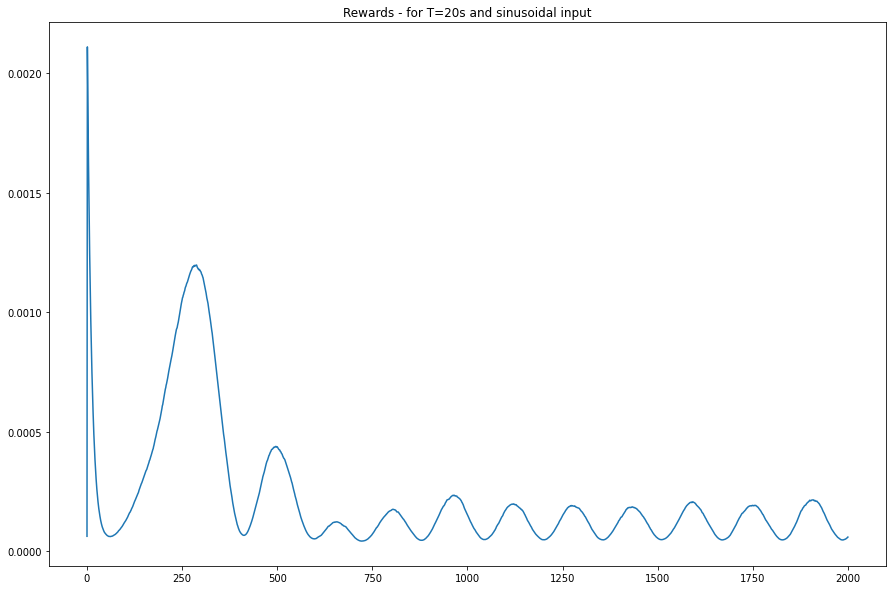

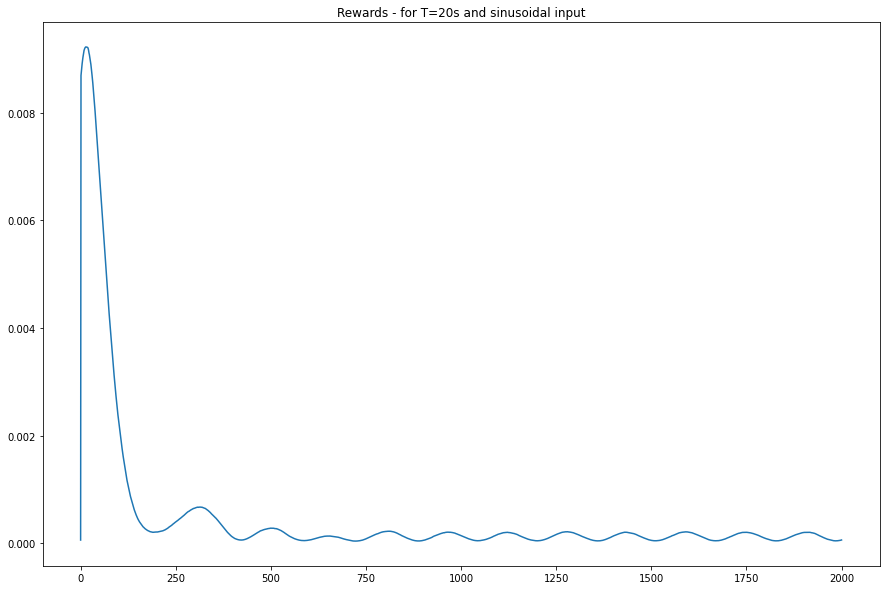

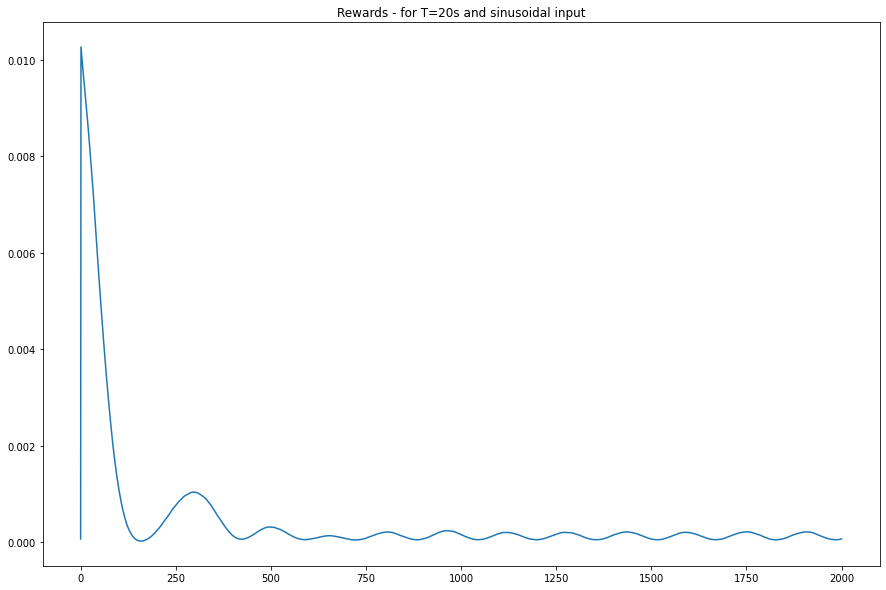

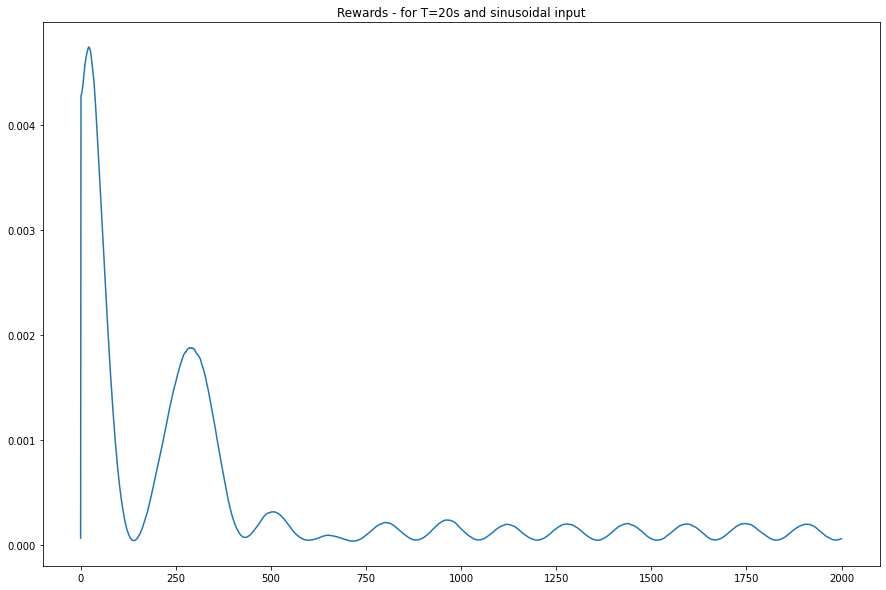

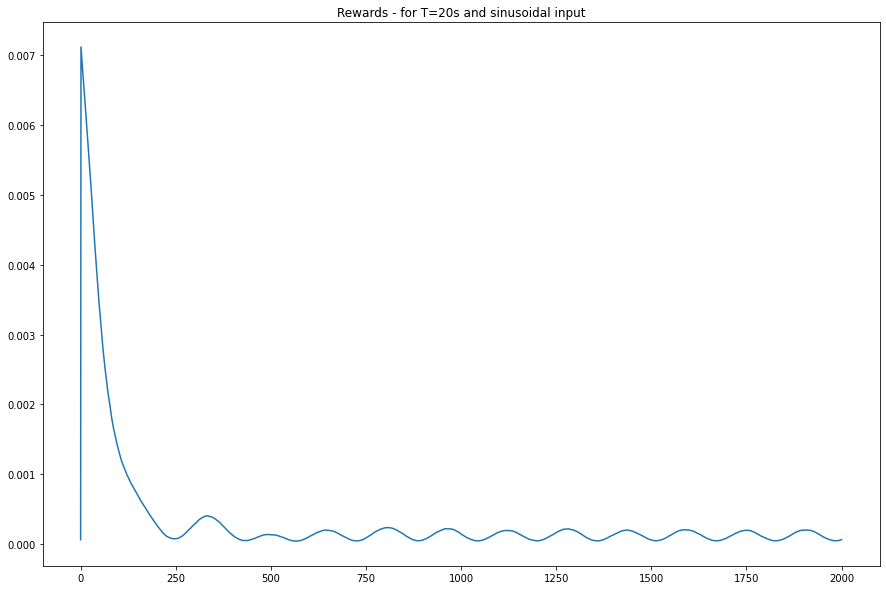

In [ ]:
total_reward = 0

for init_num in range(20): 
  plt.figure(figsize=(15,10))
  plt.title("Rewards - for T=20s and sinusoidal input")
  plt.plot( all_init_state_ep_rewards[init_num]) ; 
  print("Mean Cost = ", sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])) ;
  total_reward += sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])

print("Average cost over all runs = ", total_reward/20)

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution with ELQR control - for T=20s and sinusoidal input and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w1, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

Output hidden; open in https://colab.research.google.com to view.

## sin(1.5t) with ELQR control

In [ ]:
## Simulate system withELQR control
## if it works

Q = np.identity(10) ; 
Q[2,2] = 100 ; 
Q[4,4] = 1000

# Q[0,0] = 0 ; 
# Q[1,1] = 0 ; 
# Q[2,2] = 0 ; 
# Q[3,3] = 0 ; 
# Q[5,5] = 0 ; 
# Q[7,7] = 0 ; 
# Q[8,8] = 0 ; 
# Q[9,9] = 0 ; 

R = np.identity(1) ;


#env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1))
env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1), reset_type='random')
K,G = gen_ELQR_mats(A=A_nom, B=B_nom, F=F_nom, env=env)

#t_range = np.linspace(0,20,2001) 

t_range = np.linspace(0,20,2001) 

w1 = 0.02*0.25*np.sin(1.5*t_range) ; 

all_init_state_evols = {}
all_init_state_ep_rewards = {}

for init_num in range(20): 
  env.reset(init_states[:,init_num][:,None])
  state_evolution = env.state ; 

  #actions_evol = [] ; 

  ep_rewards = [] ;

  for t_step in range(t_range.shape[0]):     
  #for t_step in range(1):   
      t = t_range[t_step]
      #print("time = ", t)

      meas_dist = np.atleast_2d(np.array([w1[t_step] , 0])).T
      ut = -(K@state + G@meas_dist)

      action = np.atleast_2d(ut).astype(np.float32) ; 

      actions_evol.append(ut[0][0])
      ep_rewards.append((state.T@Q@state + ut.T@R@ut)[0][0])


      state, obs , cost, _, _ = env.step(action=action, meas_dist=np.atleast_2d(np.array([w1[t_step] , 0])).T, t_step=t_step)
      #total_costs += cost * gamma**(t)

      state_evolution = np.concatenate((state_evolution, state), axis=1)
  all_init_state_evols[init_num] = state_evolution 
  all_init_state_ep_rewards[init_num] = ep_rewards

Mean Cost =  0.00044097549699958013
Mean Cost =  0.000597736551276852
Mean Cost =  0.0010902944069820831
Mean Cost =  0.0003951020075894531
Mean Cost =  0.00045562386424230326
Mean Cost =  0.0005464295784780726
Mean Cost =  0.0007234991172338714
Mean Cost =  0.0007993685807023041
Mean Cost =  0.0005650003323816826
Mean Cost =  0.00076658095511506
Mean Cost =  0.00040384148660664294
Mean Cost =  0.0006940231480931529
Mean Cost =  0.0004422318879573588
Mean Cost =  0.0004505195662342125
Mean Cost =  0.0007835541582943083
Mean Cost =  0.0004846113987098806
Mean Cost =  0.0007678381530241353
Mean Cost =  0.0007213332782555314
Mean Cost =  0.0006867592033974558
Mean Cost =  0.0005995219280408555
Average cost over all runs =  0.0006207422549807396


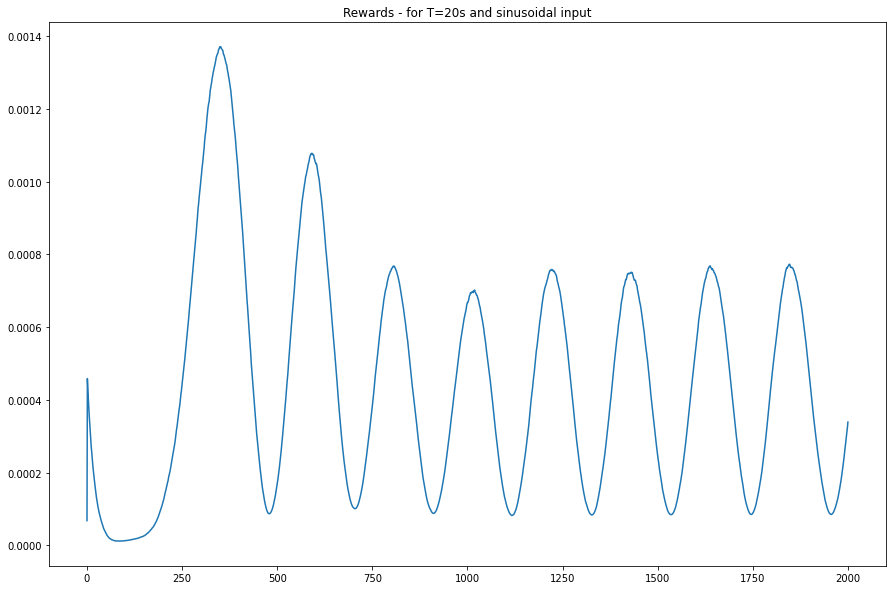

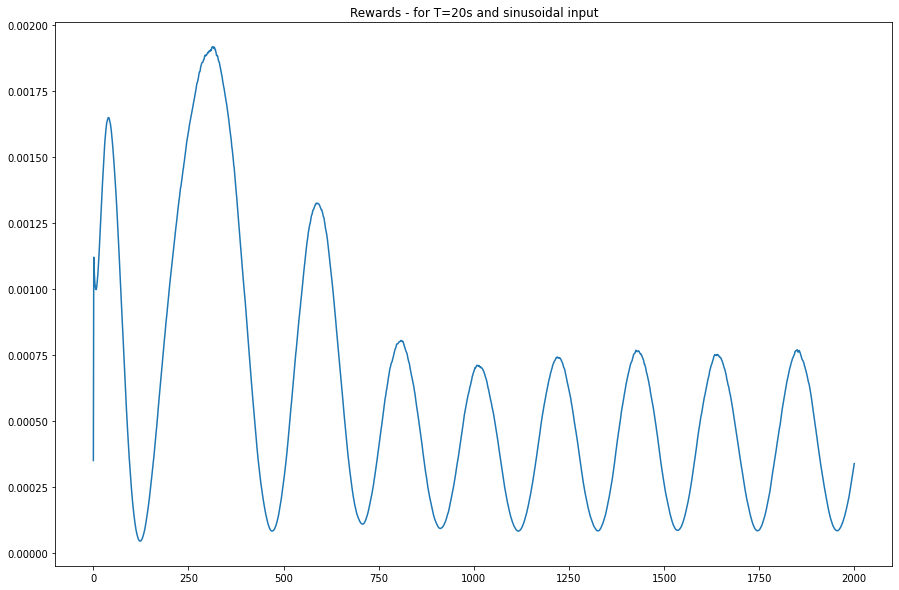

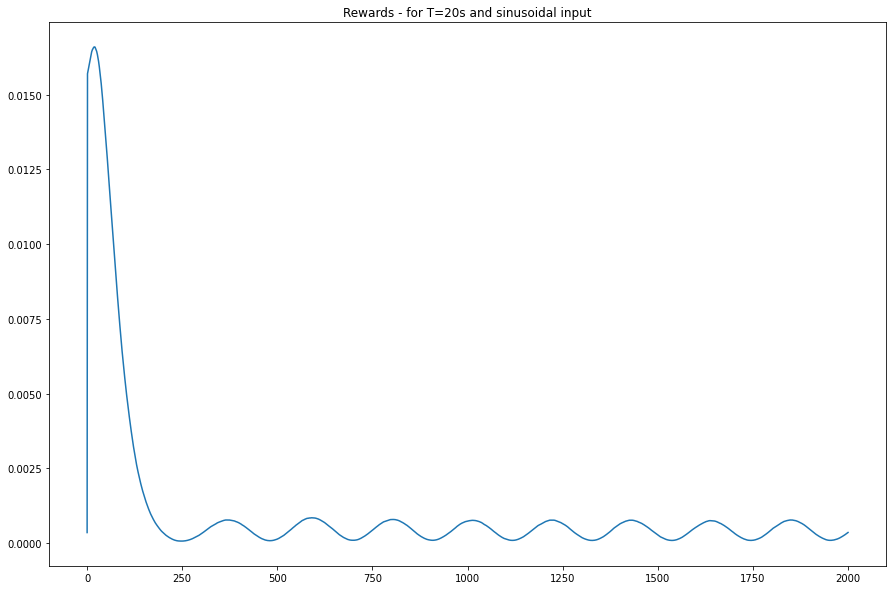

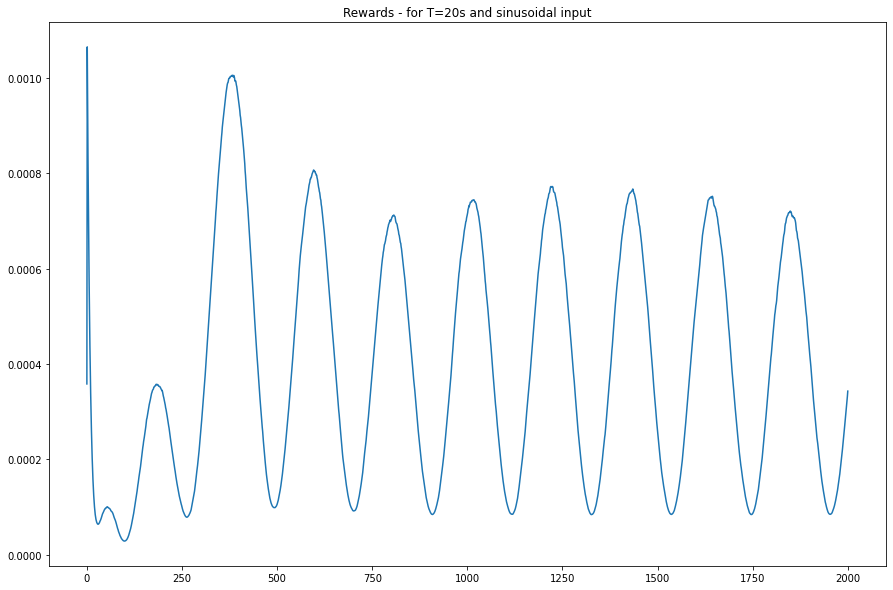

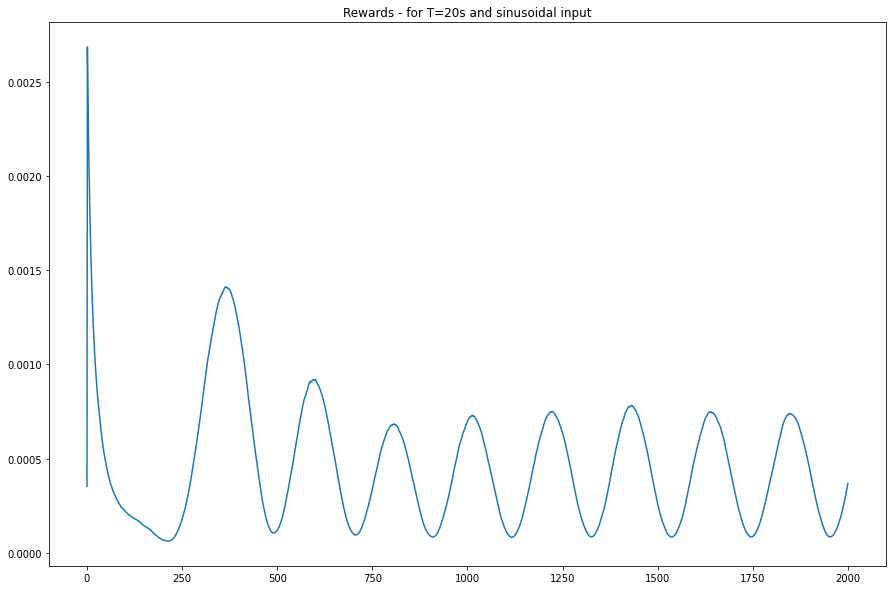

...

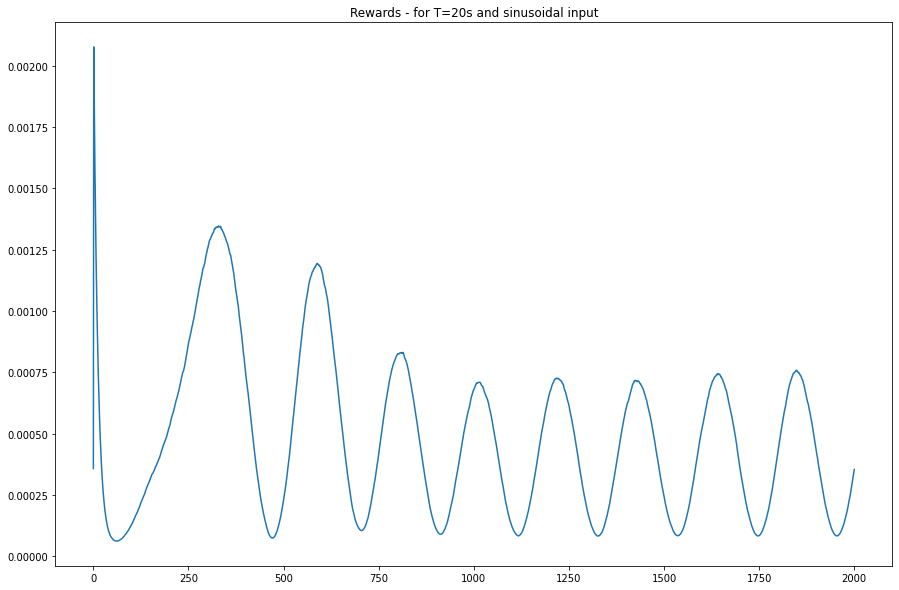

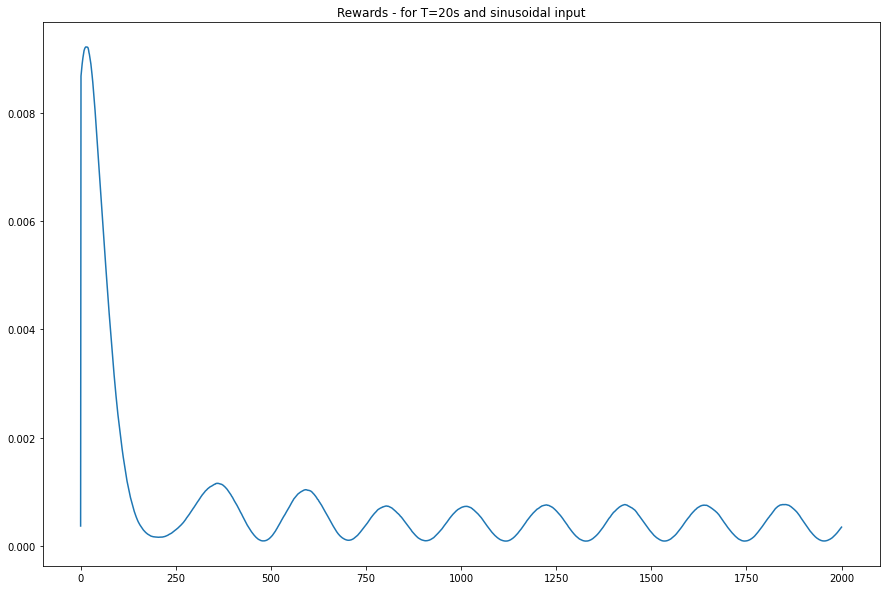

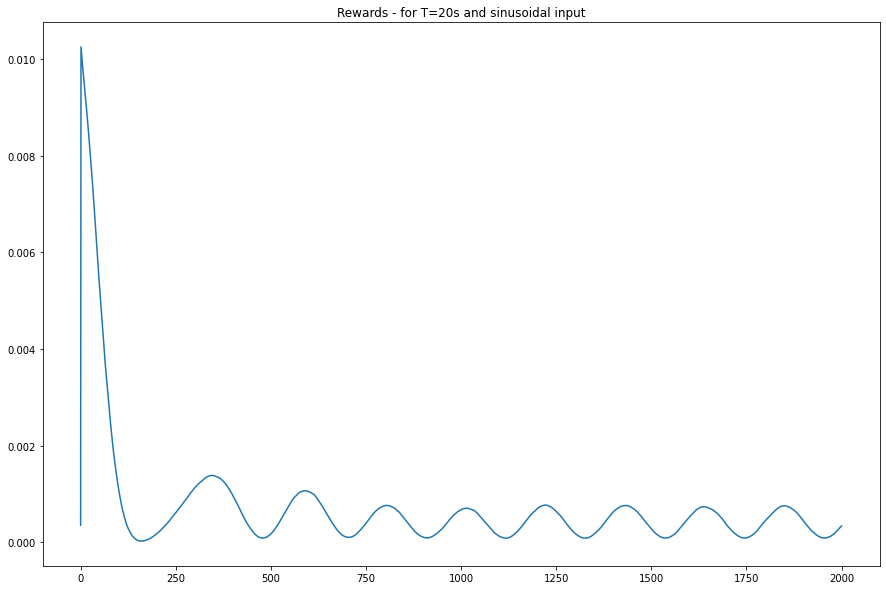

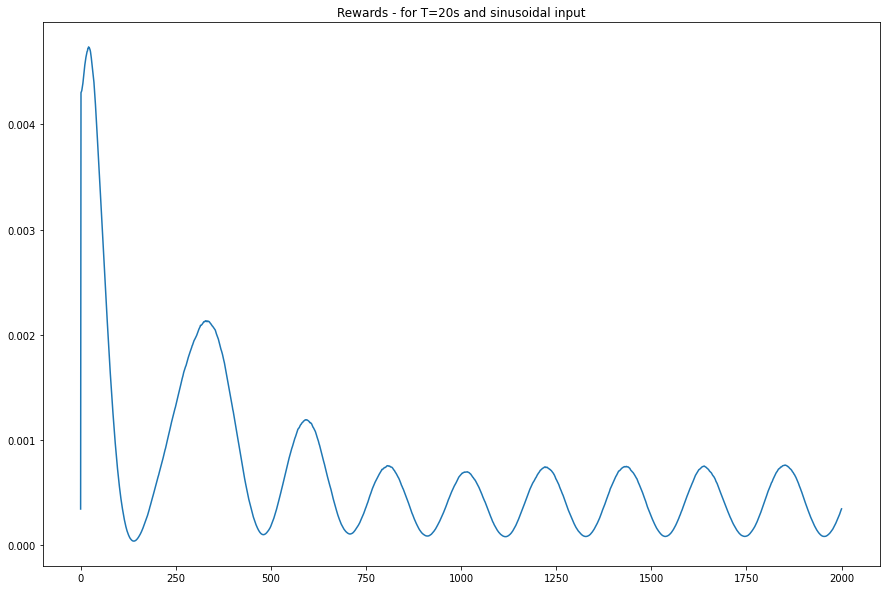

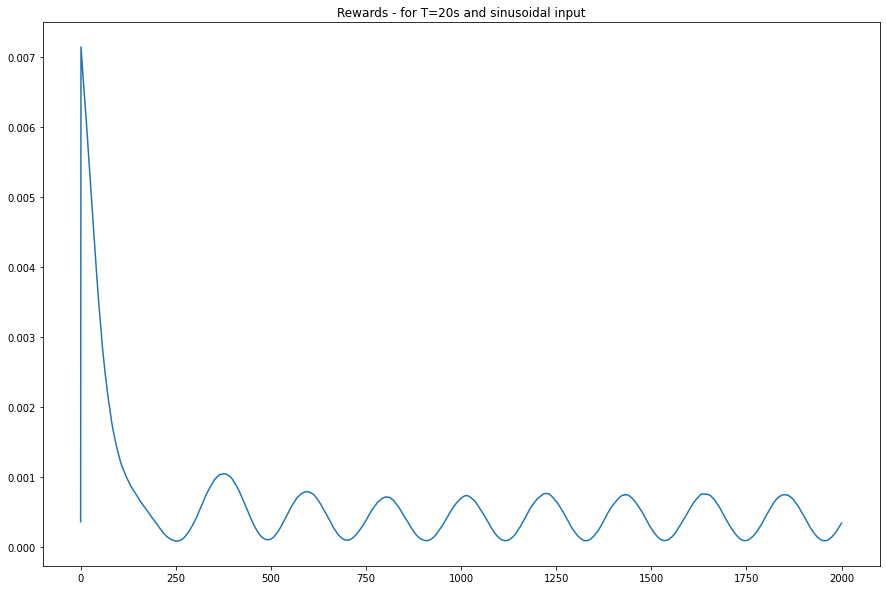

In [ ]:
total_reward = 0

for init_num in range(20): 
  plt.figure(figsize=(15,10))
  plt.title("Rewards - for T=20s and sinusoidal input")
  plt.plot( all_init_state_ep_rewards[init_num]) ; 
  print("Mean Cost = ", sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])) ;
  total_reward += sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])

print("Average cost over all runs = ", total_reward/20)

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution with ELQR control - for T=20s and sinusoidal input and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w1, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

Output hidden; open in https://colab.research.google.com to view.

## sin(t) with DDPG - sin

In [ ]:
model_path = './model/ddpg_rand_init_sin_2_0x'

test_episodes = 1
max_steps=2001
alg.load_model(model_path)
t_range = np.linspace(0,(max_steps-1)/100,max_steps)
w_sin = 0.02*0.25*np.sin(t_range)

## Square wave disturbance
# w_step = np.zeros(t_range.shape)
# w_step[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25

#w = w_step

w = w_sin

all_init_state_evols = {}
all_init_state_ep_rewards = {}

for init_num in range (20):
    print("Currently working on init num = ", init_num)
    q_loss_list=[]
    policy_loss_list=[]
    ep_rewards = [] ;
    #state = env.reset()
    state = np.concatenate((env.C@(env.reset(init_states[:,init_num][:,None])), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]        

    states_evolution = state[:,None]

    episode_reward = 0

    for step in tqdm(range(max_steps)):
        action = alg.policy_net.get_action(state, noise_scale=0.0)  # no noise for testing

        # action = action/400

        # next_state, reward, done, _ = env.step(action)

        true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
        next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
        reward = -cost  

        ep_rewards.append(cost)
        
        state = next_state

        states_evolution = np.concatenate((states_evolution, state[:,None]), axis=1)

        episode_reward += reward

    all_init_state_evols[init_num] = states_evolution 
    all_init_state_ep_rewards[init_num] = ep_rewards    
        
        # if done:
        #     break
#rewards

Currently working on init num =  0


  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.8/dist-packages/torch/nn/functional.py:1956: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
100%|██████████| 2001/2001 [00:19<00:00, 100.25it/s]


Currently working on init num =  1


100%|██████████| 2001/2001 [00:20<00:00, 98.35it/s] 


Currently working on init num =  2


100%|██████████| 2001/2001 [00:14<00:00, 136.12it/s]


Currently working on init num =  3


100%|██████████| 2001/2001 [00:14<00:00, 136.60it/s]


Currently working on init num =  4


100%|██████████| 2001/2001 [00:14<00:00, 137.37it/s]


Currently working on init num =  5


100%|██████████| 2001/2001 [00:14<00:00, 136.10it/s]


Currently working on init num =  6


100%|██████████| 2001/2001 [00:14<00:00, 134.85it/s]


Currently working on init num =  7


100%|██████████| 2001/2001 [00:14<00:00, 136.31it/s]


Currently working on init num =  8


100%|██████████| 2001/2001 [00:14<00:00, 137.86it/s]


Currently working on init num =  9


100%|██████████| 2001/2001 [00:14<00:00, 138.14it/s]


Currently working on init num =  10


100%|██████████| 2001/2001 [00:14<00:00, 136.38it/s]


Currently working on init num =  11


100%|██████████| 2001/2001 [00:14<00:00, 136.82it/s]


Currently working on init num =  12


100%|██████████| 2001/2001 [00:14<00:00, 137.25it/s]


Currently working on init num =  13


100%|██████████| 2001/2001 [00:14<00:00, 137.65it/s]


Currently working on init num =  14


100%|██████████| 2001/2001 [00:14<00:00, 134.29it/s]


Currently working on init num =  15


100%|██████████| 2001/2001 [00:14<00:00, 136.85it/s]


Currently working on init num =  16


100%|██████████| 2001/2001 [00:14<00:00, 138.38it/s]


Currently working on init num =  17


100%|██████████| 2001/2001 [00:14<00:00, 136.60it/s]


Currently working on init num =  18


100%|██████████| 2001/2001 [00:14<00:00, 139.06it/s]


Currently working on init num =  19


100%|██████████| 2001/2001 [00:14<00:00, 135.80it/s]


Mean Cost =  [[0.00072902]]
Mean Cost =  [[0.00076035]]
Mean Cost =  [[0.0015352]]
Mean Cost =  [[0.00074576]]
Mean Cost =  [[0.00084697]]
Mean Cost =  [[0.00085109]]
Mean Cost =  [[0.0010721]]
Mean Cost =  [[0.0010362]]
Mean Cost =  [[0.00096801]]
Mean Cost =  [[0.00086291]]
Mean Cost =  [[0.00075533]]
Mean Cost =  [[0.00092933]]
Mean Cost =  [[0.00076875]]
Mean Cost =  [[0.0007889]]
Mean Cost =  [[0.00104136]]
Mean Cost =  [[0.00071247]]
Mean Cost =  [[0.00098715]]
Mean Cost =  [[0.00098368]]
Mean Cost =  [[0.00085886]]
Mean Cost =  [[0.00093565]]
Average cost over all runs =  [[0.00090845]]


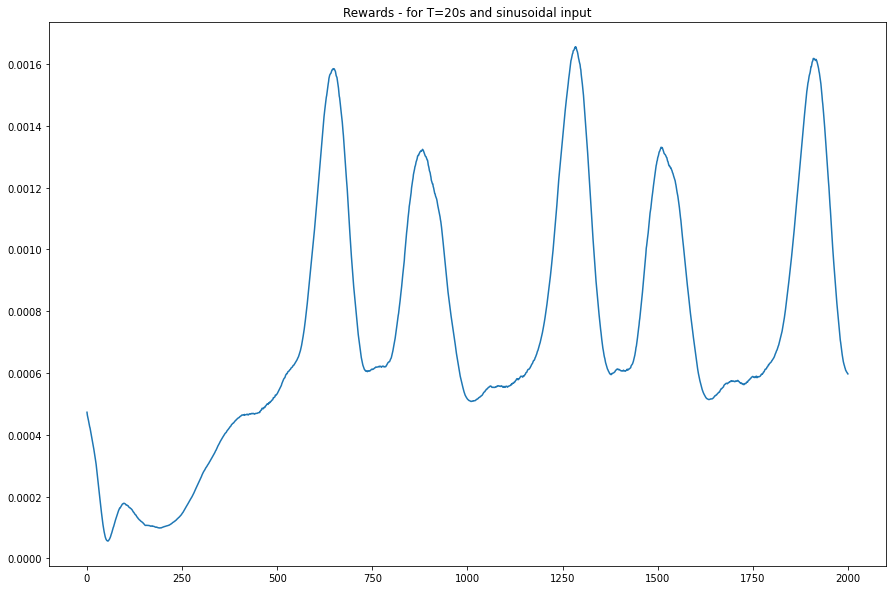

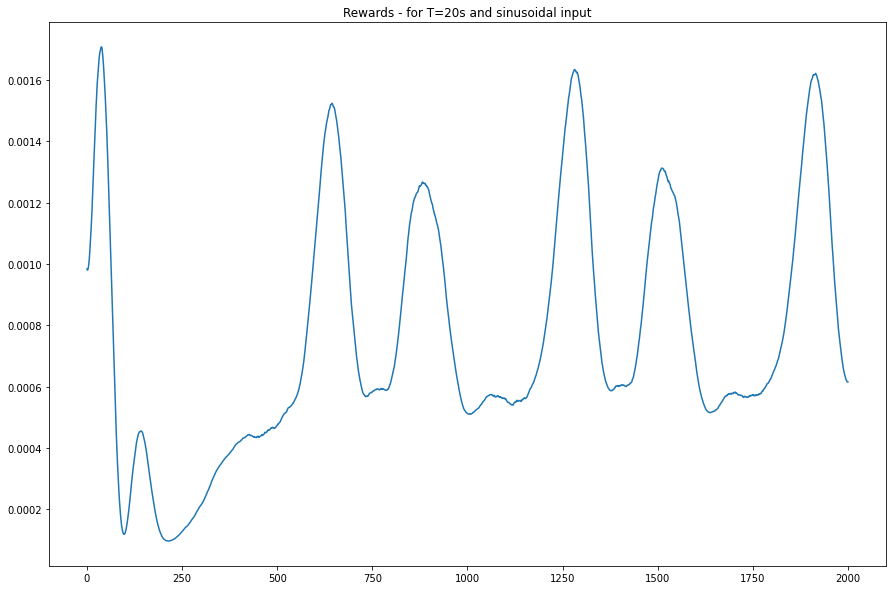

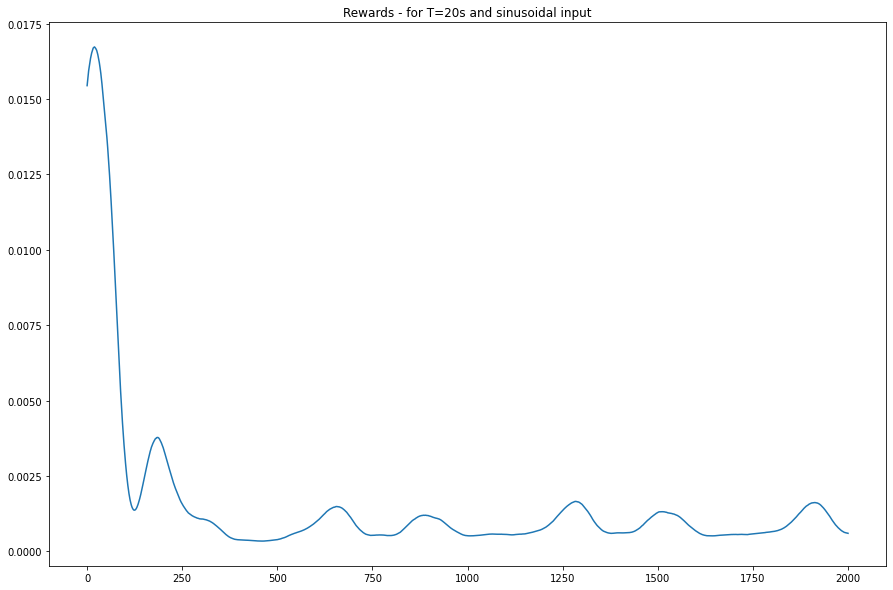

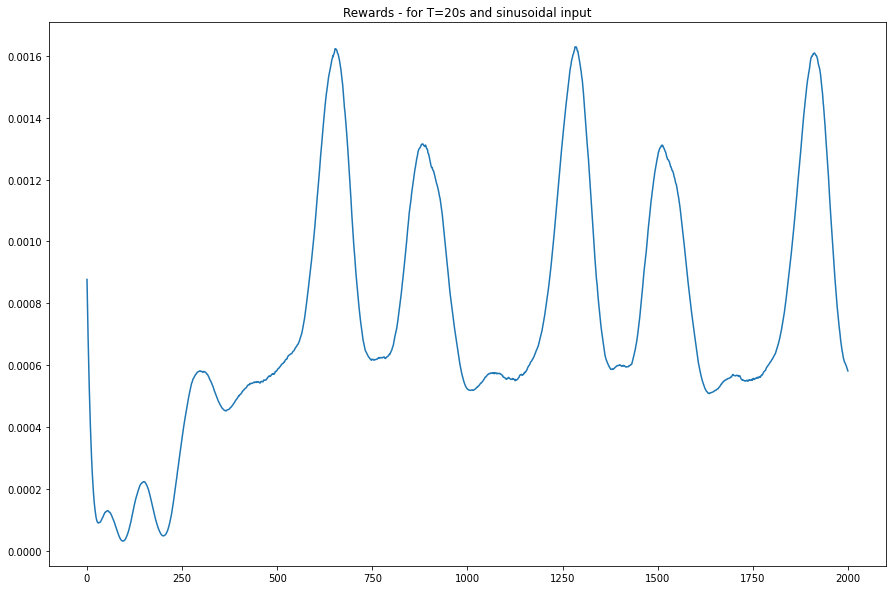

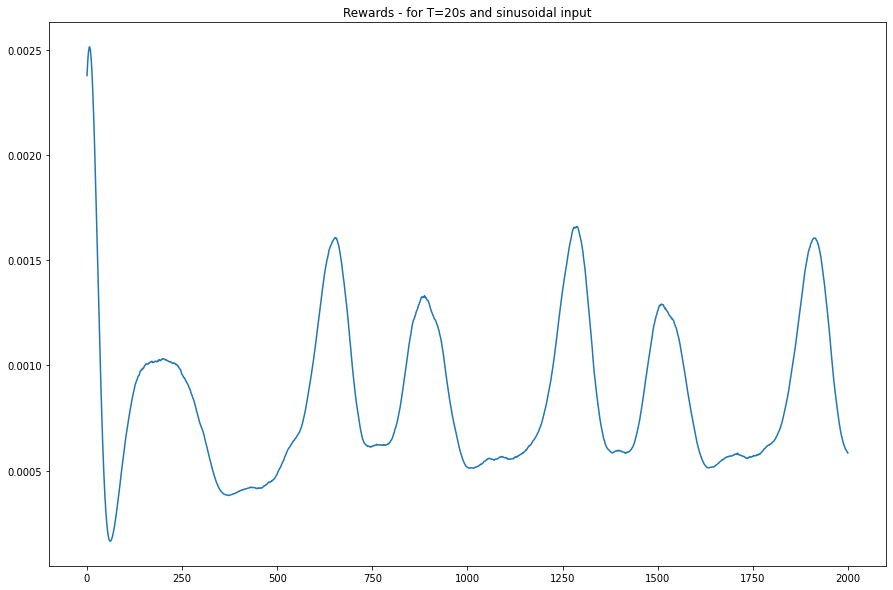

...

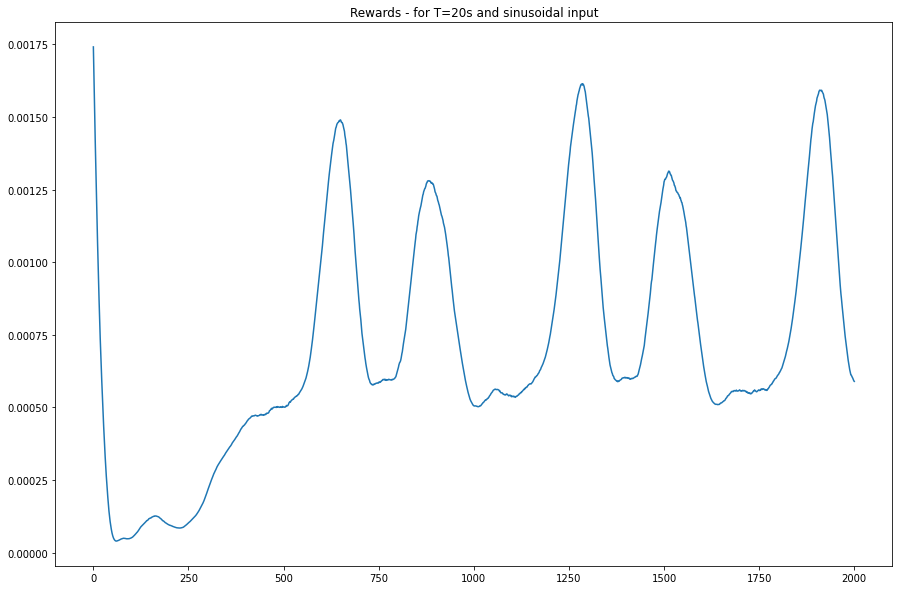

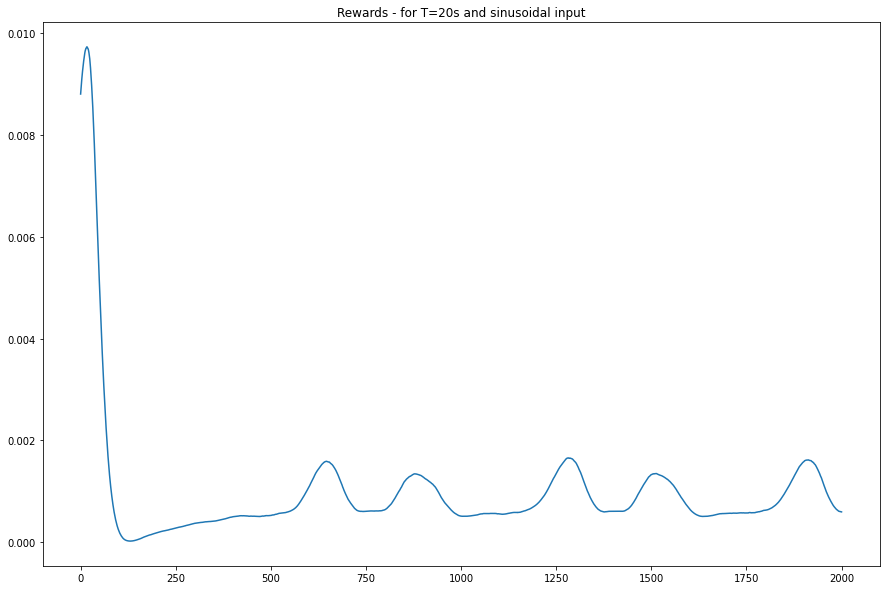

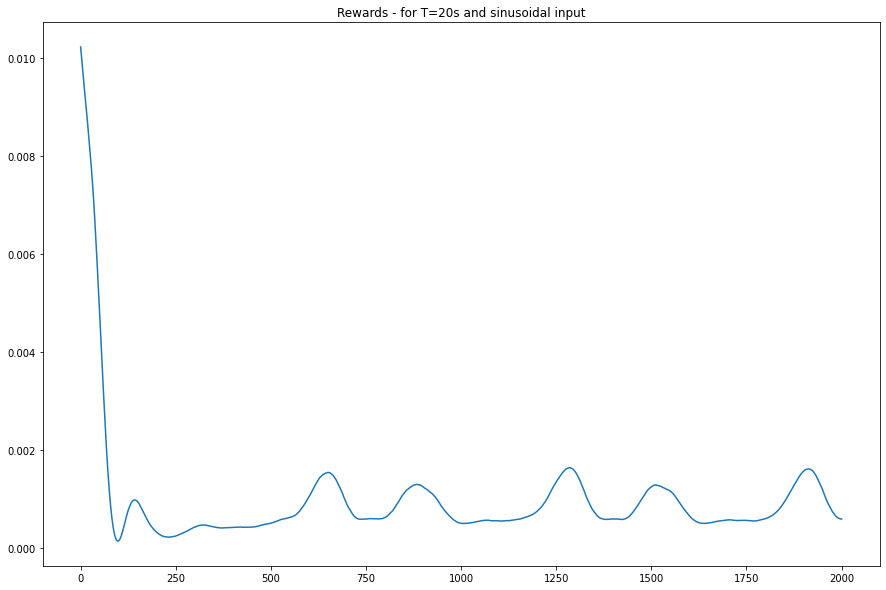

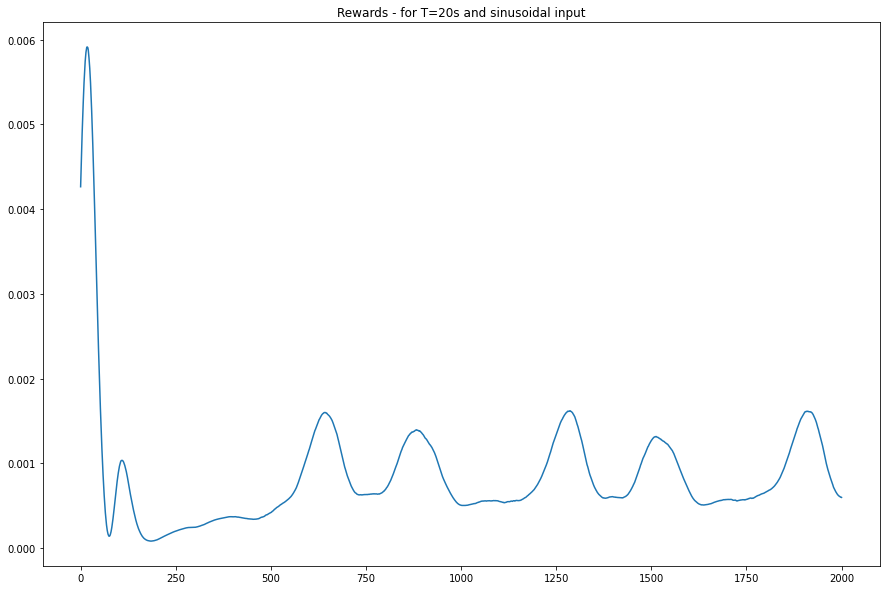

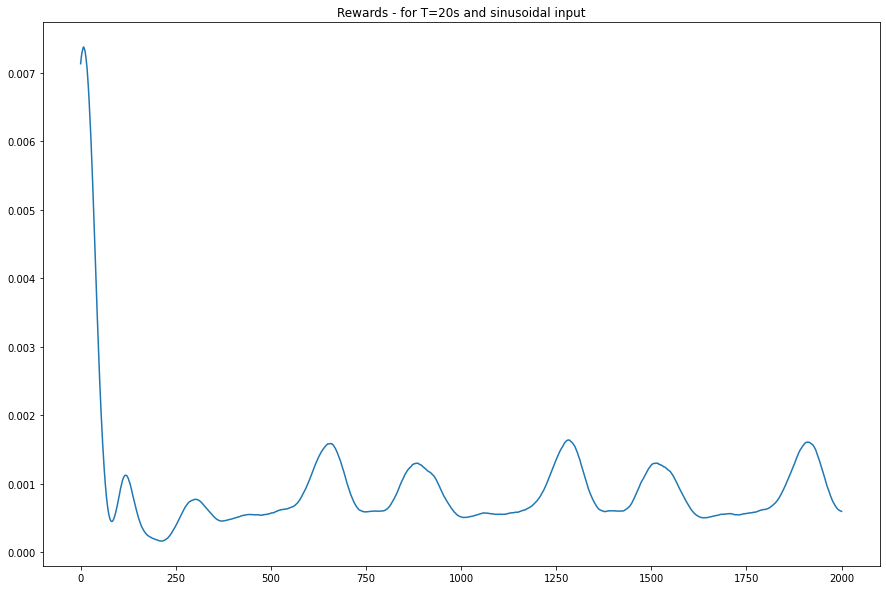

In [ ]:
total_reward = 0

for init_num in range(20): 
  plt.figure(figsize=(15,10))
  plt.title("Rewards - for T=20s and sinusoidal input")
  plt.plot(np.array(all_init_state_ep_rewards[init_num])[:,0,0]) ; 
  print("Mean Cost = ", sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])) ;
  total_reward += sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])

print("Average cost over all runs = ", total_reward/20)

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution with DDPG control - for T=20s and sinusoidal input and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

Output hidden; open in https://colab.research.google.com to view.

## sin(t) with DDPG - step

In [ ]:
model_path = './model/ddpg_rand_init_step'

test_episodes = 1
max_steps=2001
alg.load_model(model_path)
t_range = np.linspace(0,(max_steps-1)/100,max_steps)
w_sin = 0.02*0.25*np.sin(t_range)

## Square wave disturbance
# w_step = np.zeros(t_range.shape)
# w_step[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25

#w = w_step

w = w_sin

all_init_state_evols = {}
all_init_state_ep_rewards = {}

for init_num in range (20):
    print("Currently working on init num = ", init_num)
    q_loss_list=[]
    policy_loss_list=[]
    ep_rewards = [] ;
    #state = env.reset()
    state = np.concatenate((env.C@(env.reset(init_states[:,init_num][:,None])), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]        

    states_evolution = state[:,None]

    episode_reward = 0

    for step in tqdm(range(max_steps)):
        action = alg.policy_net.get_action(state, noise_scale=0.0)  # no noise for testing

        # action = action/400

        # next_state, reward, done, _ = env.step(action)

        true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
        next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
        reward = -cost  

        ep_rewards.append(cost)
        
        state = next_state

        states_evolution = np.concatenate((states_evolution, state[:,None]), axis=1)

        episode_reward += reward

    all_init_state_evols[init_num] = states_evolution 
    all_init_state_ep_rewards[init_num] = ep_rewards    
        
        # if done:
        #     break
#rewards

Currently working on init num =  0


  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.8/dist-packages/torch/nn/functional.py:1956: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
100%|██████████| 2001/2001 [00:17<00:00, 114.88it/s]


Currently working on init num =  1


100%|██████████| 2001/2001 [00:16<00:00, 118.14it/s]


Currently working on init num =  2


100%|██████████| 2001/2001 [00:16<00:00, 121.07it/s]


Currently working on init num =  3


100%|██████████| 2001/2001 [00:15<00:00, 132.62it/s]


Currently working on init num =  4


100%|██████████| 2001/2001 [00:14<00:00, 134.46it/s]


Currently working on init num =  5


100%|██████████| 2001/2001 [00:14<00:00, 136.80it/s]


Currently working on init num =  6


100%|██████████| 2001/2001 [00:14<00:00, 133.87it/s]


Currently working on init num =  7


100%|██████████| 2001/2001 [00:15<00:00, 132.57it/s]


Currently working on init num =  8


100%|██████████| 2001/2001 [00:14<00:00, 135.68it/s]


Currently working on init num =  9


100%|██████████| 2001/2001 [00:14<00:00, 136.18it/s]


Currently working on init num =  10


100%|██████████| 2001/2001 [00:14<00:00, 134.64it/s]


Currently working on init num =  11


100%|██████████| 2001/2001 [00:14<00:00, 135.84it/s]


Currently working on init num =  12


100%|██████████| 2001/2001 [00:14<00:00, 137.02it/s]


Currently working on init num =  13


100%|██████████| 2001/2001 [00:14<00:00, 136.96it/s]


Currently working on init num =  14


100%|██████████| 2001/2001 [00:14<00:00, 136.69it/s]


Currently working on init num =  15


100%|██████████| 2001/2001 [00:14<00:00, 136.51it/s]


Currently working on init num =  16


100%|██████████| 2001/2001 [00:14<00:00, 136.86it/s]


Currently working on init num =  17


100%|██████████| 2001/2001 [00:14<00:00, 137.65it/s]


Currently working on init num =  18


100%|██████████| 2001/2001 [00:14<00:00, 135.87it/s]


Currently working on init num =  19


100%|██████████| 2001/2001 [00:14<00:00, 136.51it/s]


Mean Cost =  [[0.00140811]]
Mean Cost =  [[0.00144742]]
Mean Cost =  [[0.00209467]]
Mean Cost =  [[0.00146668]]
Mean Cost =  [[0.00146107]]
Mean Cost =  [[0.00152067]]
Mean Cost =  [[0.00169937]]
Mean Cost =  [[0.00161734]]
Mean Cost =  [[0.00159003]]
Mean Cost =  [[0.00149802]]
Mean Cost =  [[0.00147647]]
Mean Cost =  [[0.0015404]]
Mean Cost =  [[0.00143109]]
Mean Cost =  [[0.00144516]]
Mean Cost =  [[0.00171332]]
Mean Cost =  [[0.0014087]]
Mean Cost =  [[0.00157887]]
Mean Cost =  [[0.0016017]]
Mean Cost =  [[0.00146848]]
Mean Cost =  [[0.00157916]]
Average cost over all runs =  [[0.00155234]]


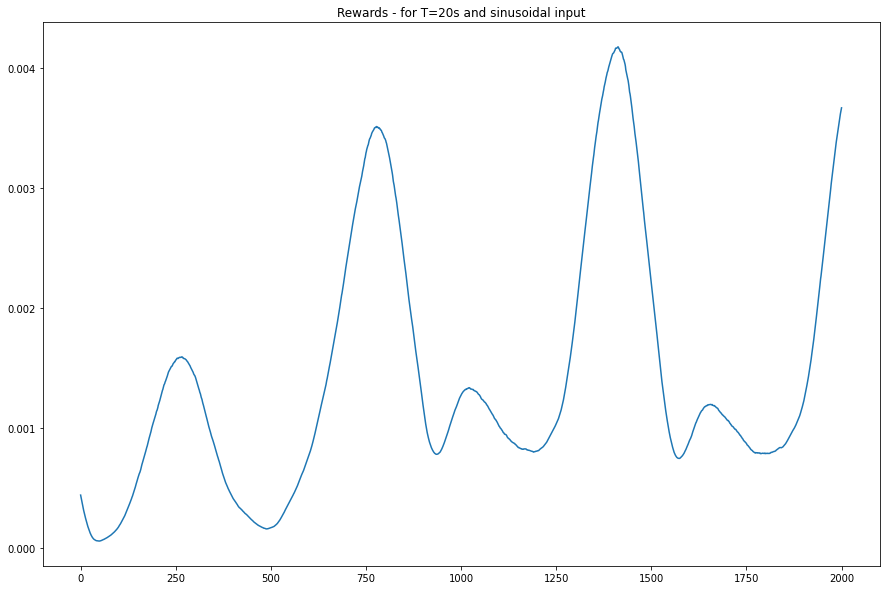

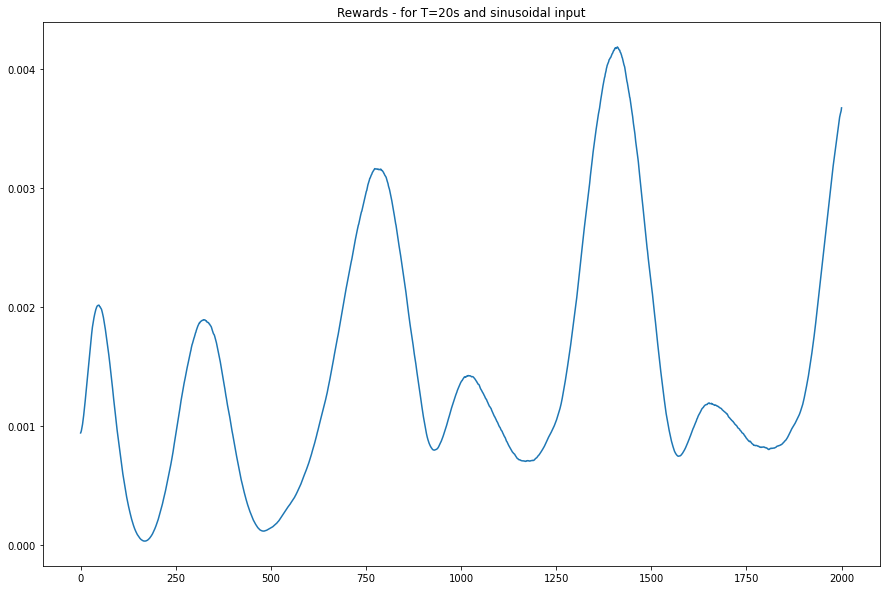

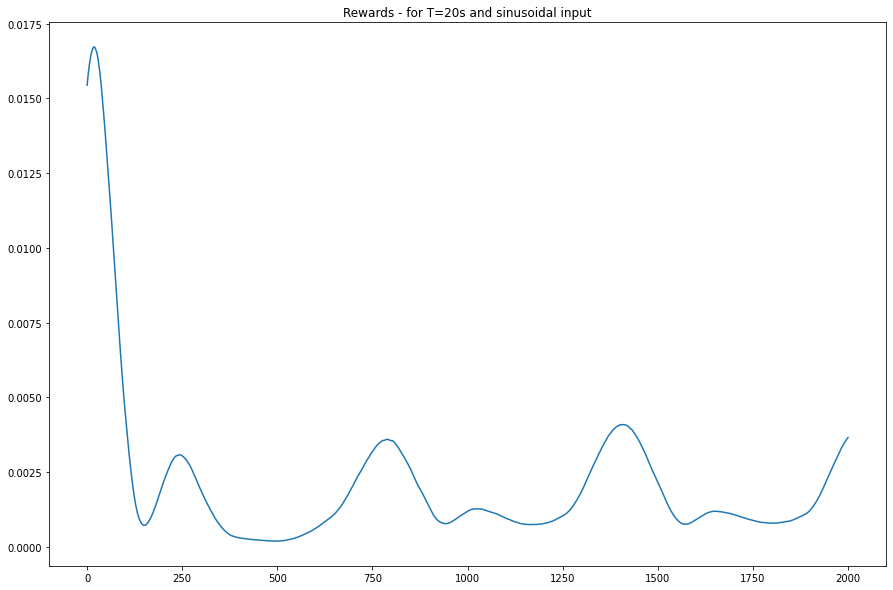

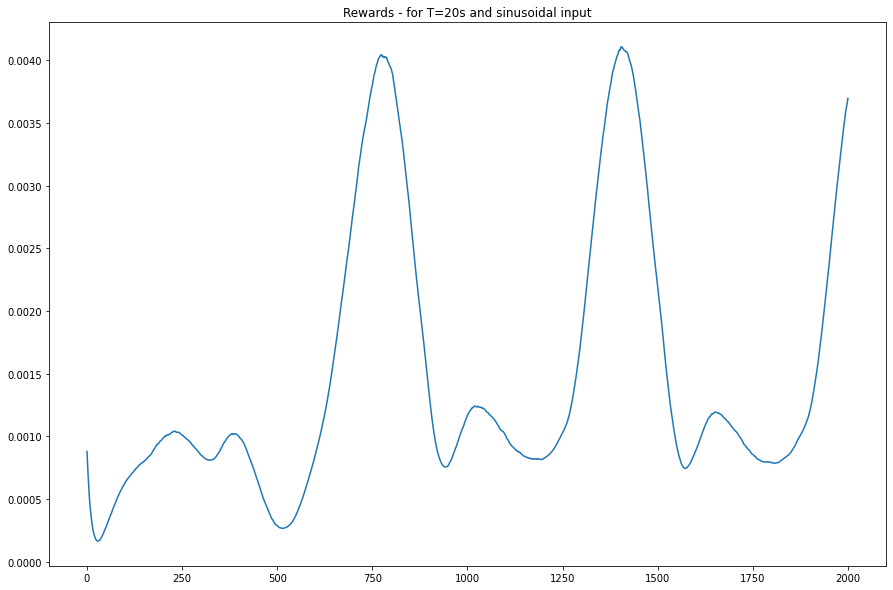

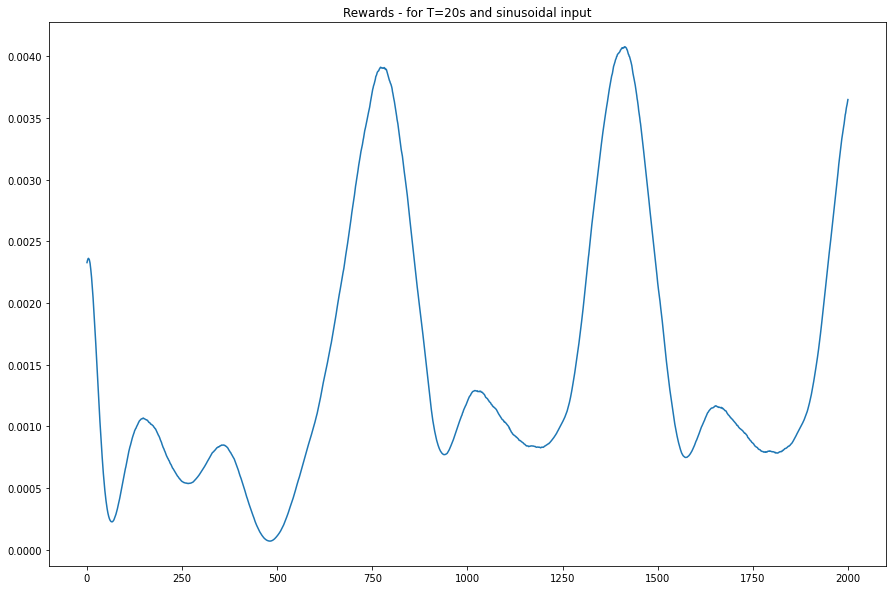

...

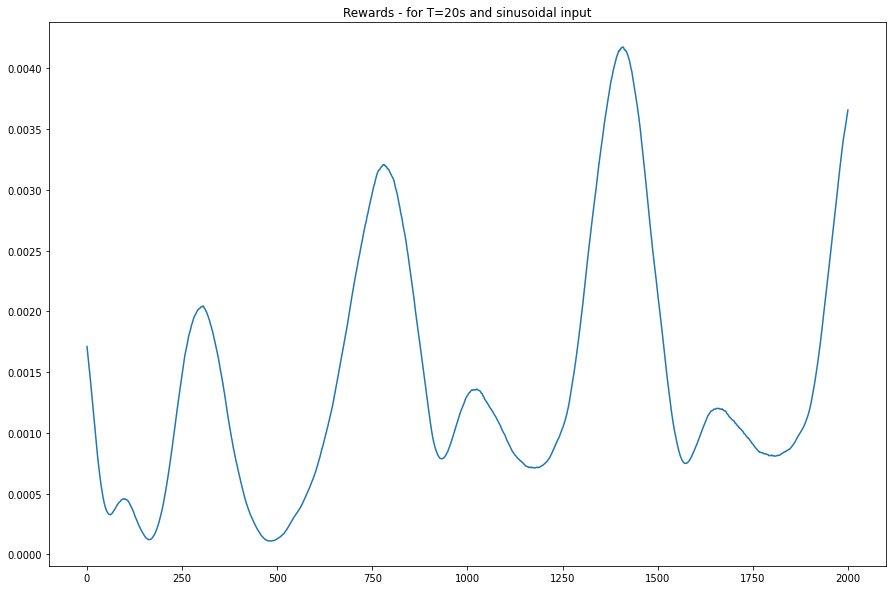

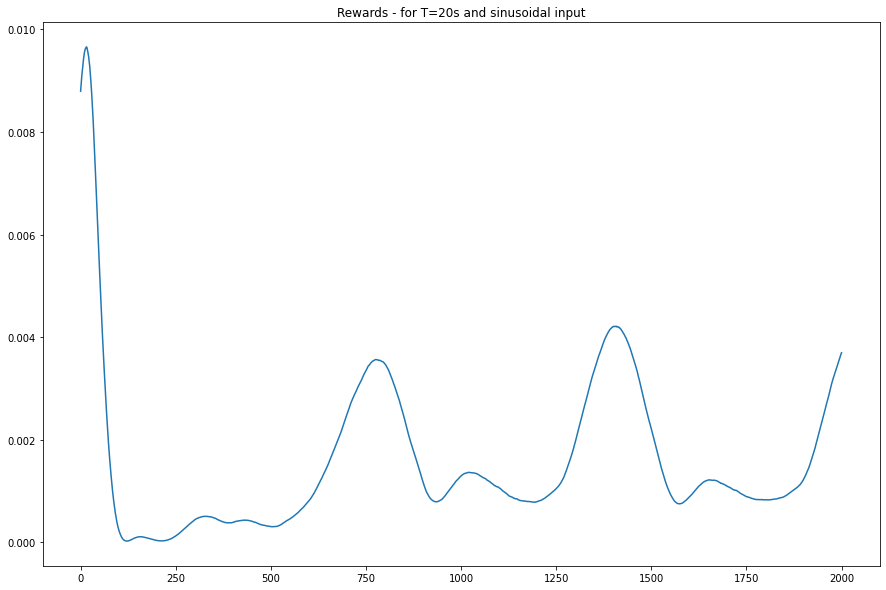

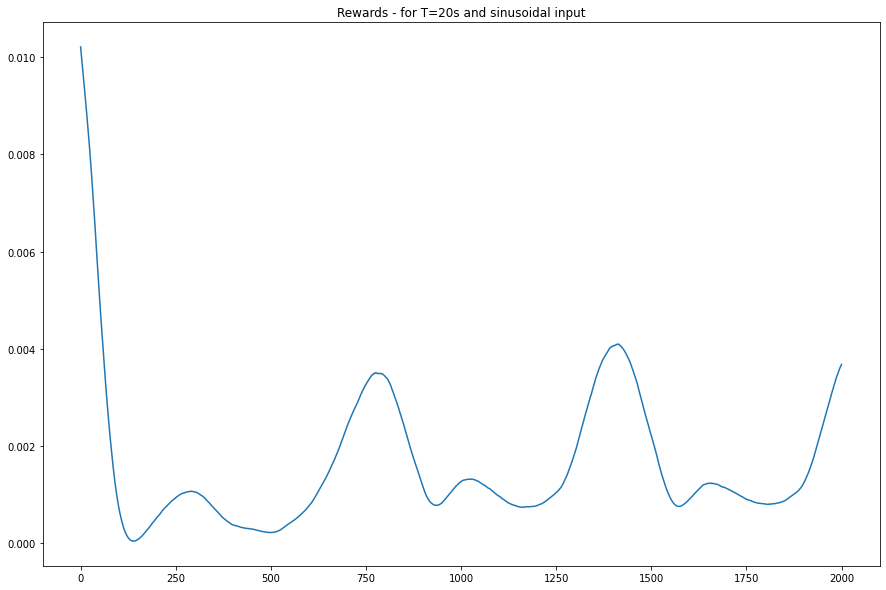

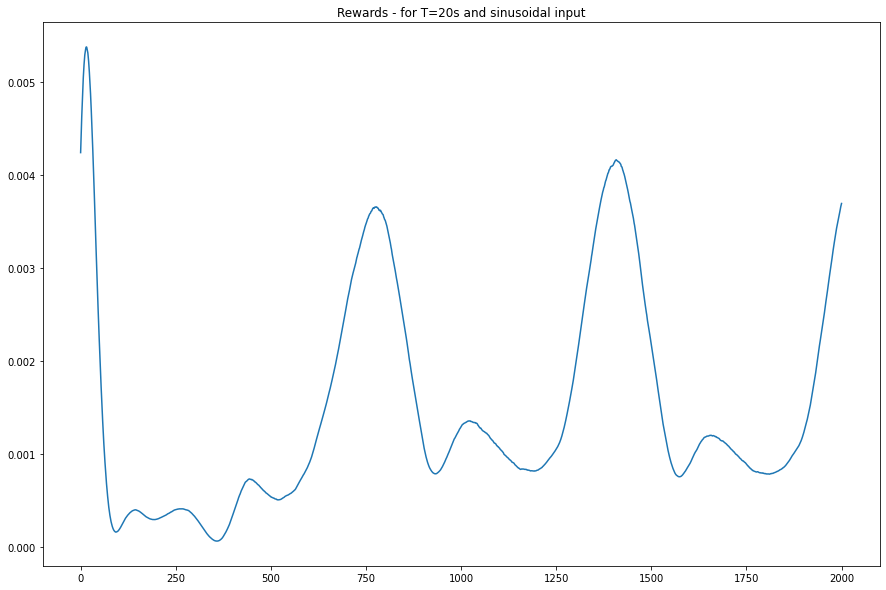

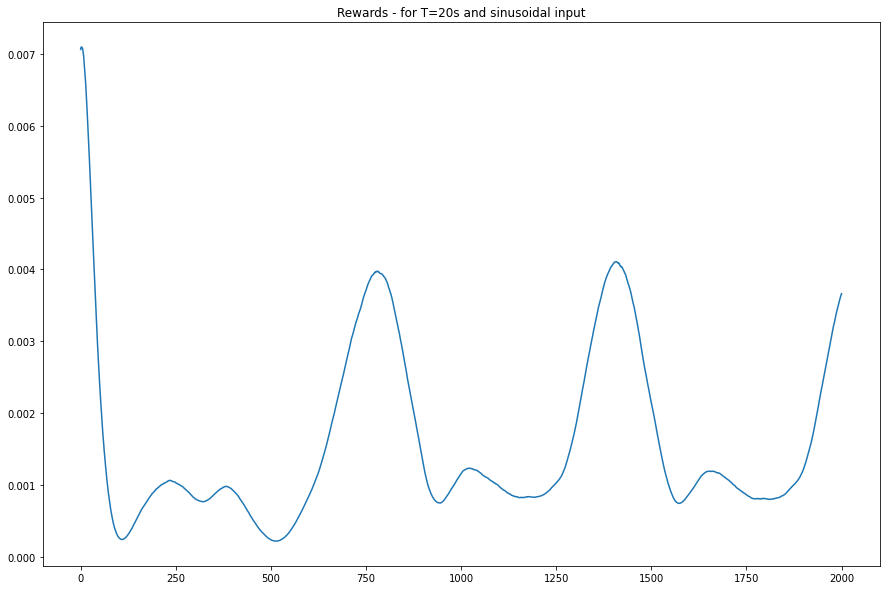

In [ ]:
total_reward = 0

for init_num in range(20): 
  plt.figure(figsize=(15,10))
  plt.title("Rewards - for T=20s and sinusoidal input")
  plt.plot(np.array(all_init_state_ep_rewards[init_num])[:,0,0]) ; 
  print("Mean Cost = ", sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])) ;
  total_reward += sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])

print("Average cost over all runs = ", total_reward/20)

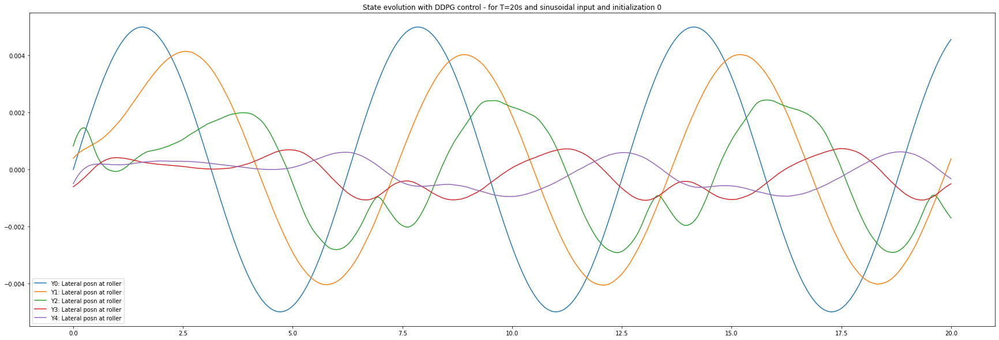

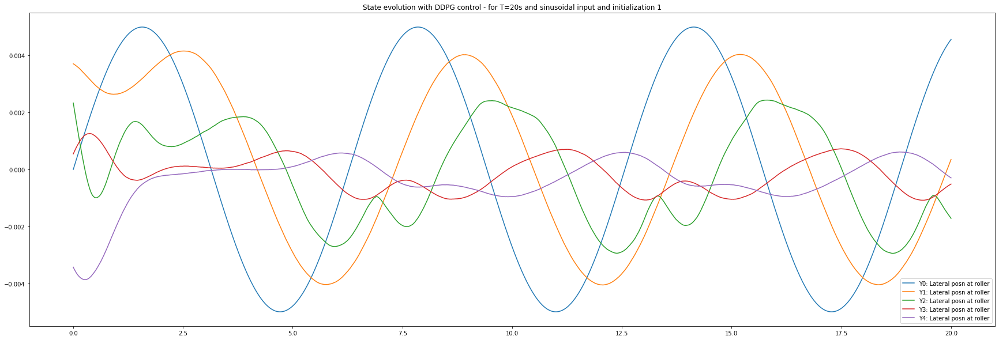

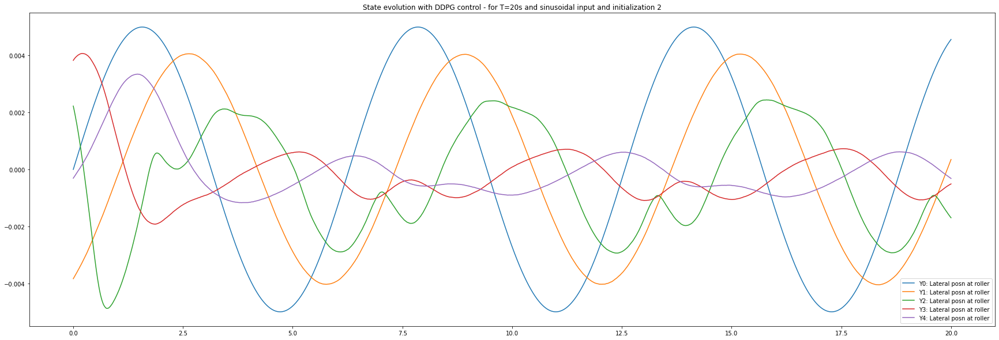

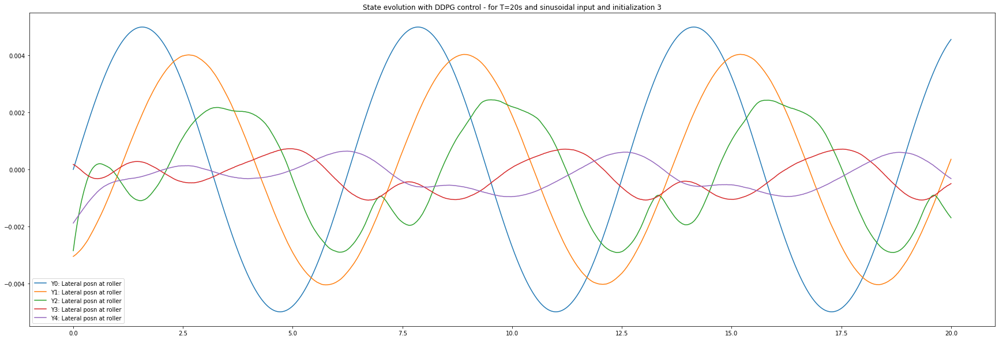

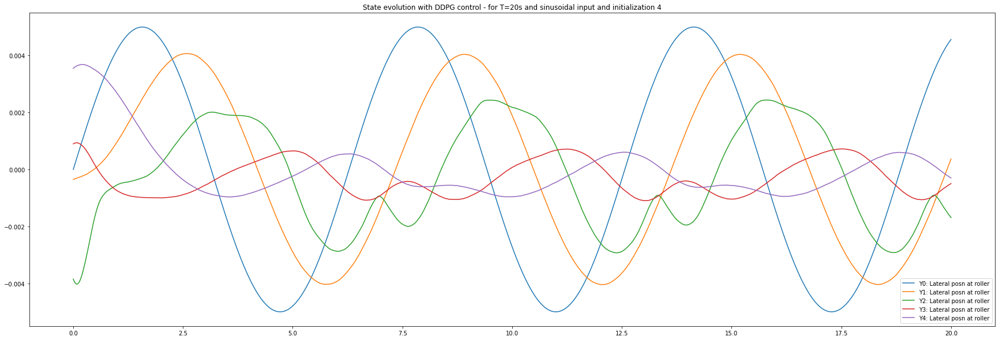

...

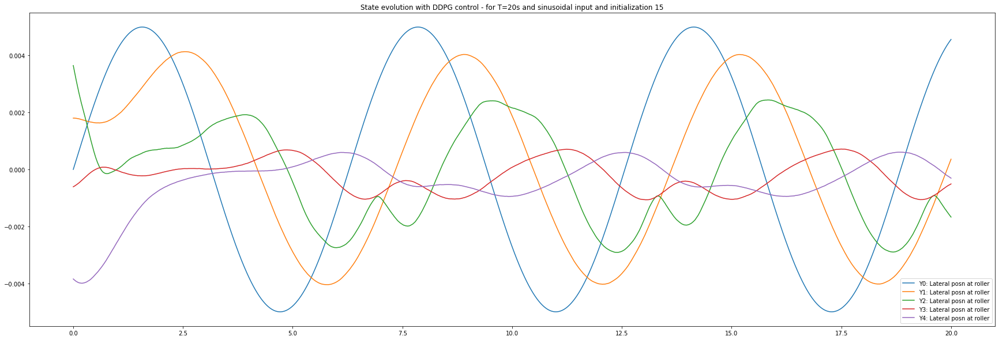

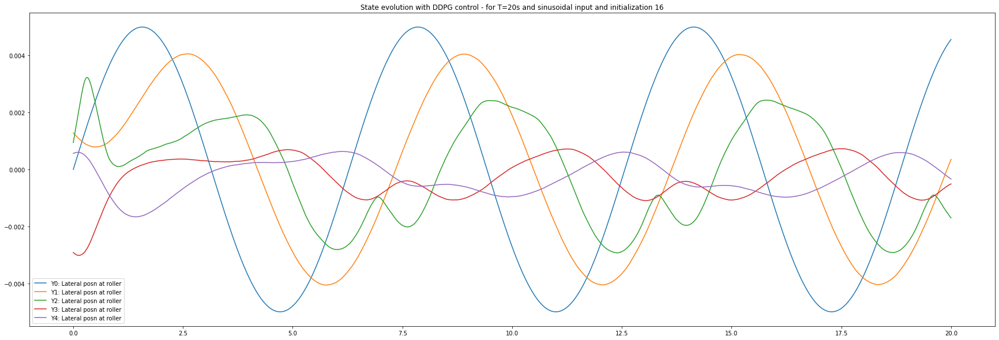

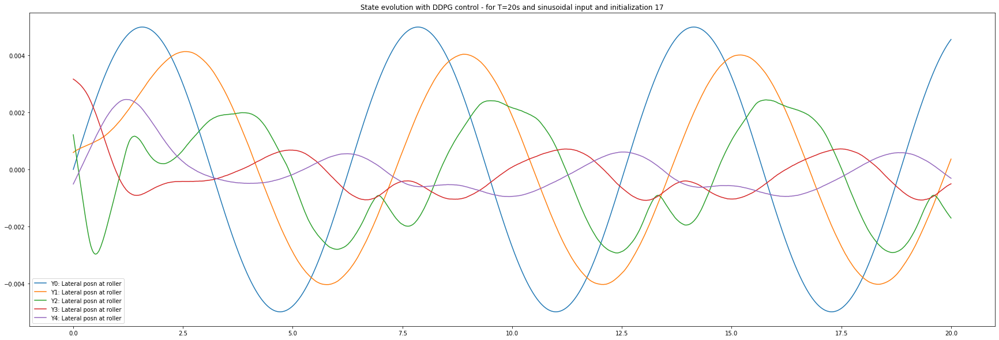

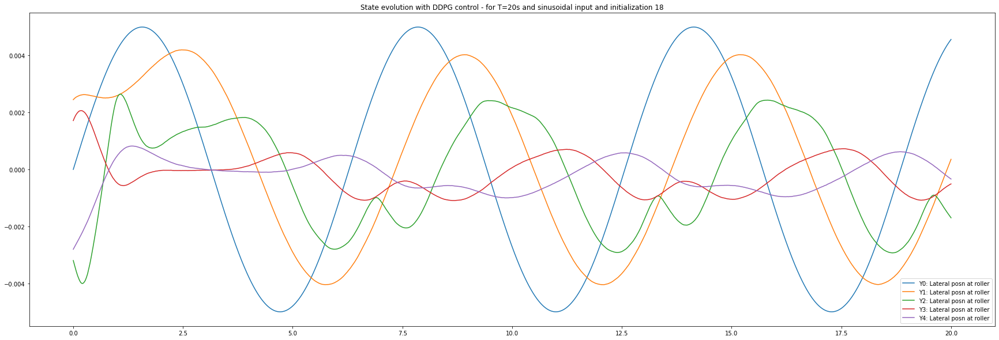

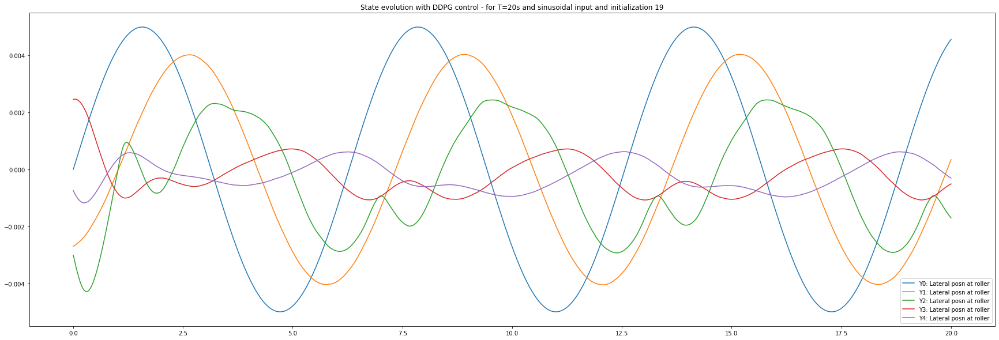

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution with DDPG control - for T=20s and sinusoidal input and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

## sin(1.5*t) with DDPG

In [ ]:
model_path = './model/ddpg_rand_init_sin_2_0x'

test_episodes = 1
max_steps=2001
alg.load_model(model_path)
t_range = np.linspace(0,(max_steps-1)/100,max_steps)
w_sin = 0.02*0.25*np.sin(1.5*t_range)

## Square wave disturbance
# w_step = np.zeros(t_range.shape)
# w_step[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25

#w = w_step

w = w_sin

all_init_state_evols = {}
all_init_state_ep_rewards = {}

for init_num in range (20):
    print("Currently working on init num = ", init_num)
    q_loss_list=[]
    policy_loss_list=[]
    ep_rewards = [] ;
    #state = env.reset()
    state = np.concatenate((env.C@(env.reset(init_states[:,init_num][:,None])), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]        

    states_evolution = state[:,None]

    episode_reward = 0

    for step in tqdm(range(max_steps)):
        action = alg.policy_net.get_action(state, noise_scale=0.0)  # no noise for testing

        # action = action/400

        # next_state, reward, done, _ = env.step(action)

        true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
        next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
        reward = -cost  

        ep_rewards.append(cost)
        
        state = next_state

        states_evolution = np.concatenate((states_evolution, state[:,None]), axis=1)

        episode_reward += reward

    all_init_state_evols[init_num] = states_evolution 
    all_init_state_ep_rewards[init_num] = ep_rewards    
        
        # if done:
        #     break
#rewards

Currently working on init num =  0


  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.8/dist-packages/torch/nn/functional.py:1956: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
100%|██████████| 2001/2001 [00:17<00:00, 115.03it/s]


Currently working on init num =  1


100%|██████████| 2001/2001 [00:17<00:00, 111.53it/s]


Currently working on init num =  2


100%|██████████| 2001/2001 [00:14<00:00, 137.85it/s]


Currently working on init num =  3


100%|██████████| 2001/2001 [00:14<00:00, 137.04it/s]


Currently working on init num =  4


100%|██████████| 2001/2001 [00:14<00:00, 135.47it/s]


Currently working on init num =  5


100%|██████████| 2001/2001 [00:14<00:00, 137.26it/s]


Currently working on init num =  6


100%|██████████| 2001/2001 [00:14<00:00, 137.95it/s]


Currently working on init num =  7


100%|██████████| 2001/2001 [00:14<00:00, 136.76it/s]


Currently working on init num =  8


100%|██████████| 2001/2001 [00:14<00:00, 137.73it/s]


Currently working on init num =  9


100%|██████████| 2001/2001 [00:14<00:00, 136.27it/s]


Currently working on init num =  10


100%|██████████| 2001/2001 [00:14<00:00, 133.67it/s]


Currently working on init num =  11


100%|██████████| 2001/2001 [00:14<00:00, 138.02it/s]


Currently working on init num =  12


100%|██████████| 2001/2001 [00:14<00:00, 137.29it/s]


Currently working on init num =  13


100%|██████████| 2001/2001 [00:14<00:00, 137.73it/s]


Currently working on init num =  14


100%|██████████| 2001/2001 [00:14<00:00, 136.37it/s]


Currently working on init num =  15


100%|██████████| 2001/2001 [00:14<00:00, 135.45it/s]


Currently working on init num =  16


100%|██████████| 2001/2001 [00:14<00:00, 137.92it/s]


Currently working on init num =  17


100%|██████████| 2001/2001 [00:14<00:00, 139.62it/s]


Currently working on init num =  18


100%|██████████| 2001/2001 [00:14<00:00, 137.46it/s]


Currently working on init num =  19


100%|██████████| 2001/2001 [00:14<00:00, 137.87it/s]


Mean Cost =  [[0.00027019]]
Mean Cost =  [[0.00031595]]
Mean Cost =  [[0.00101622]]
Mean Cost =  [[0.0002508]]
Mean Cost =  [[0.0003554]]
Mean Cost =  [[0.00034217]]
Mean Cost =  [[0.00056355]]
Mean Cost =  [[0.00057676]]
Mean Cost =  [[0.00045403]]
Mean Cost =  [[0.00043507]]
Mean Cost =  [[0.00026188]]
Mean Cost =  [[0.00049281]]
Mean Cost =  [[0.00028366]]
Mean Cost =  [[0.0003054]]
Mean Cost =  [[0.00057505]]
Mean Cost =  [[0.00027066]]
Mean Cost =  [[0.00051785]]
Mean Cost =  [[0.00051189]]
Mean Cost =  [[0.0004211]]
Mean Cost =  [[0.00041972]]
Average cost over all runs =  [[0.00043201]]


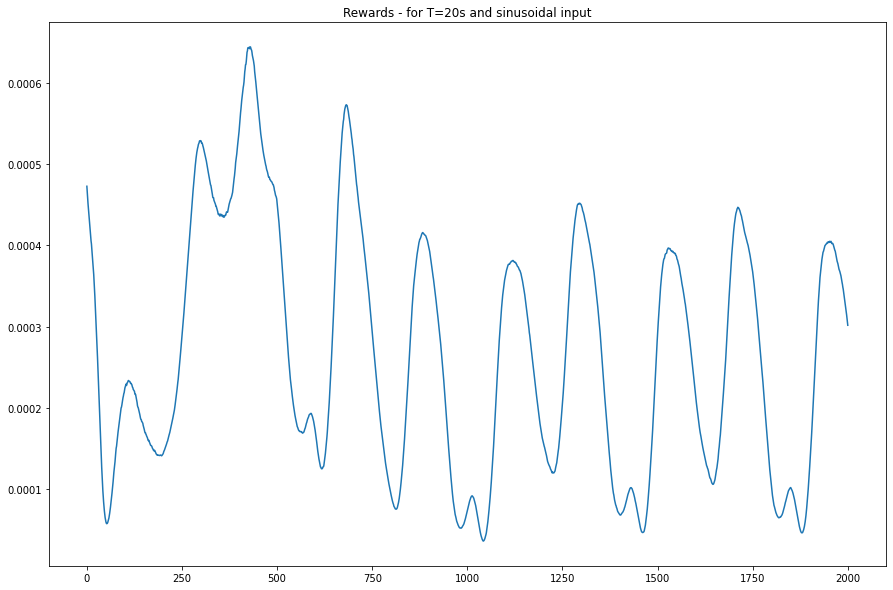

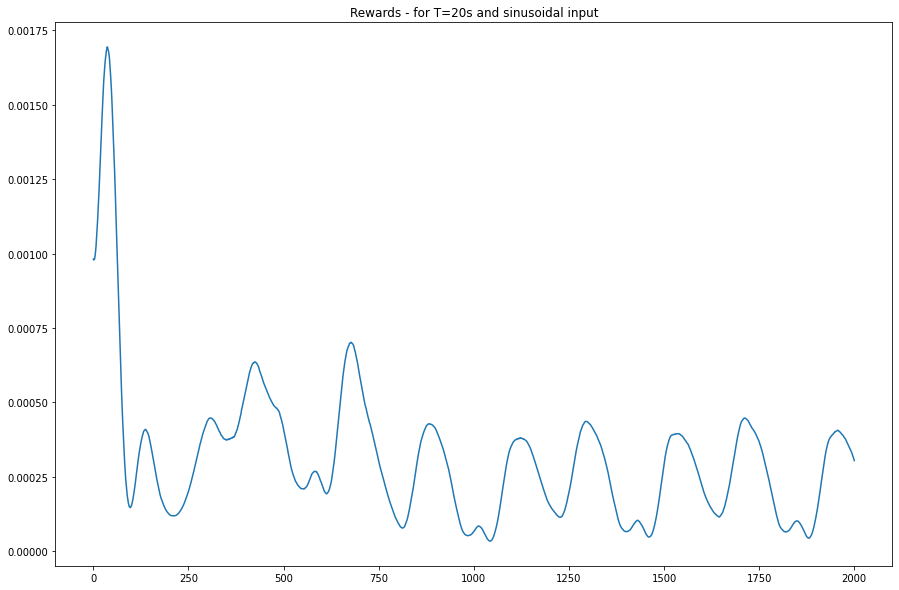

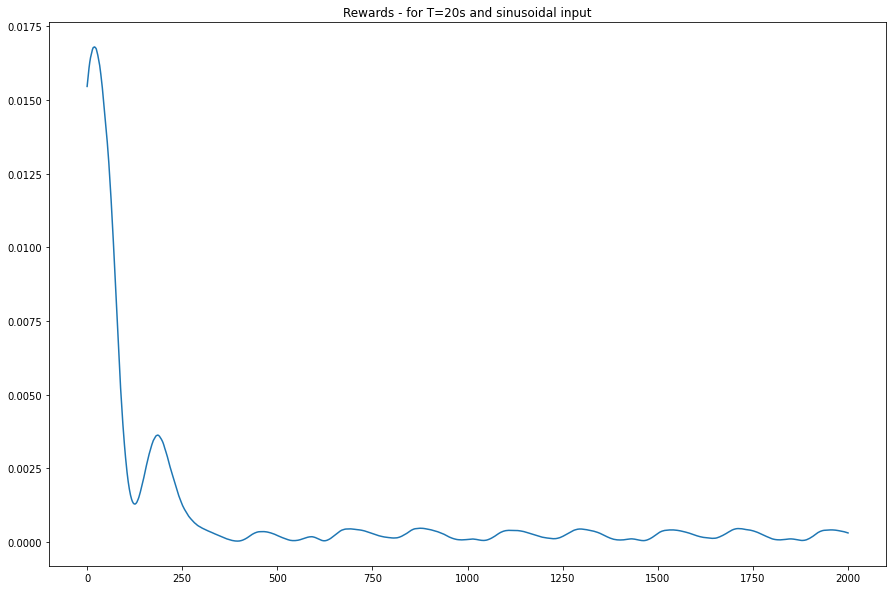

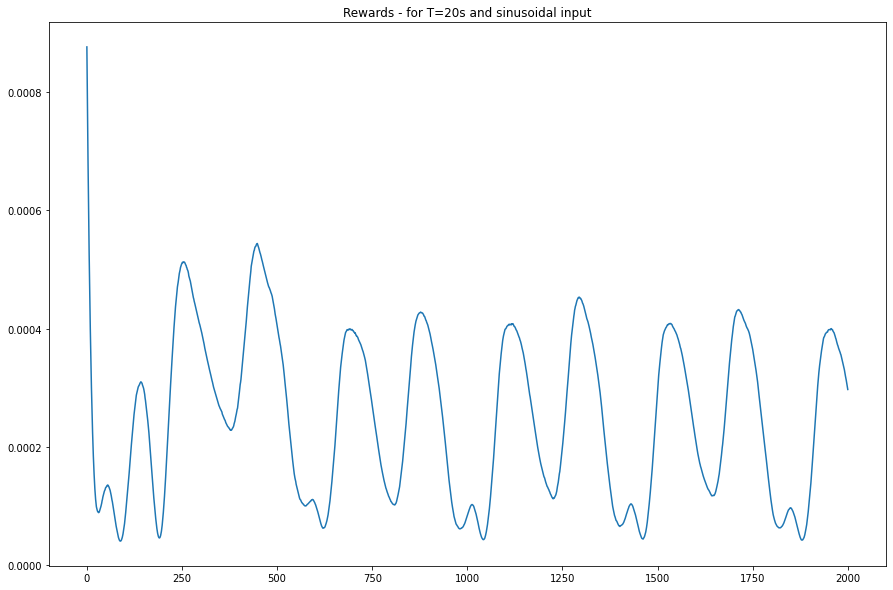

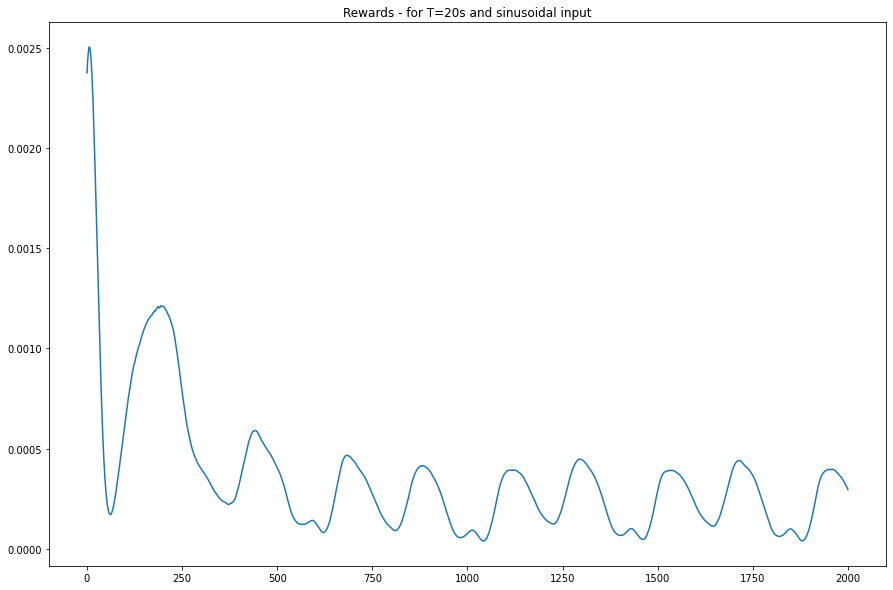

...

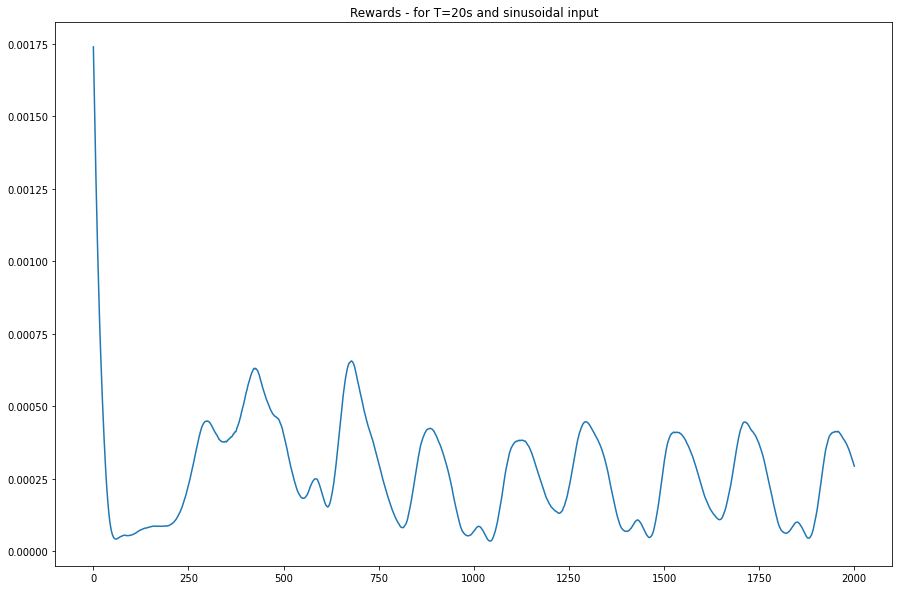

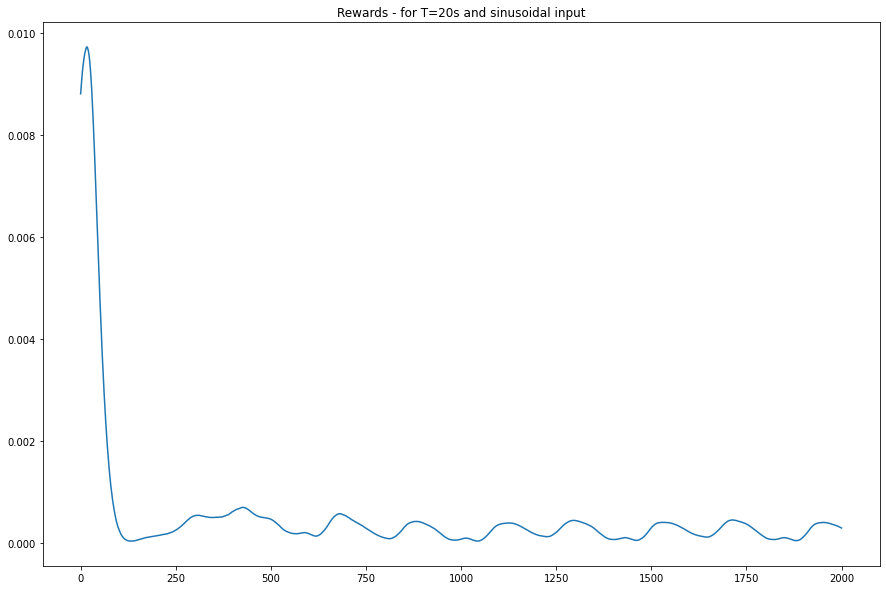

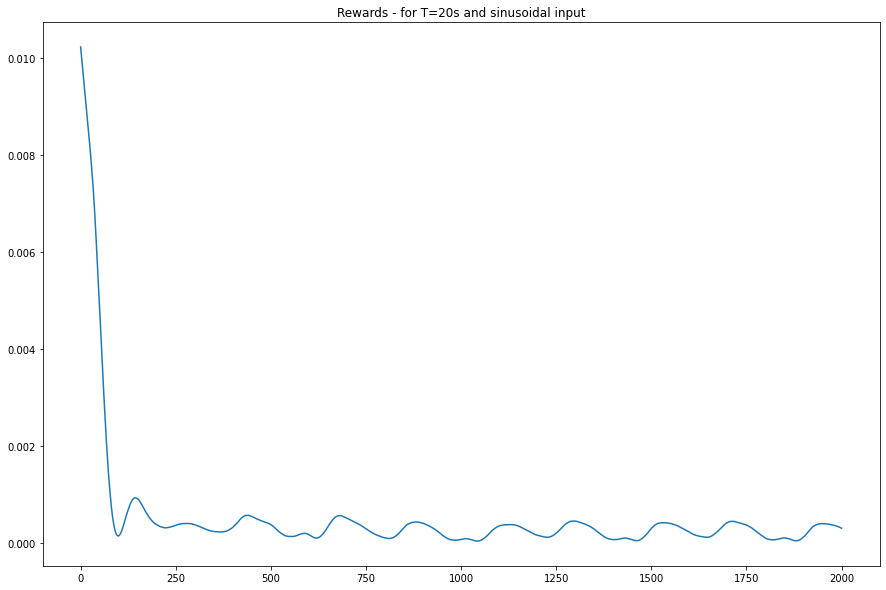

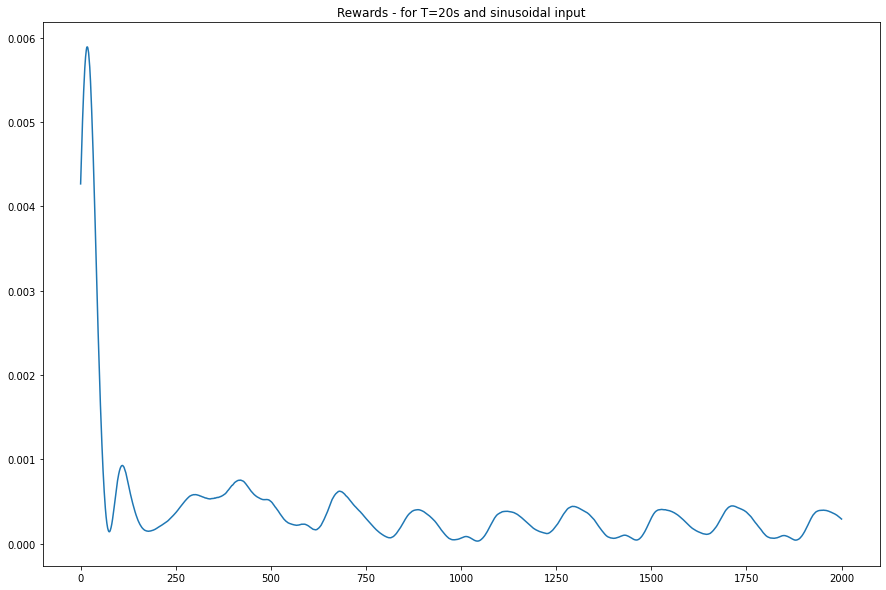

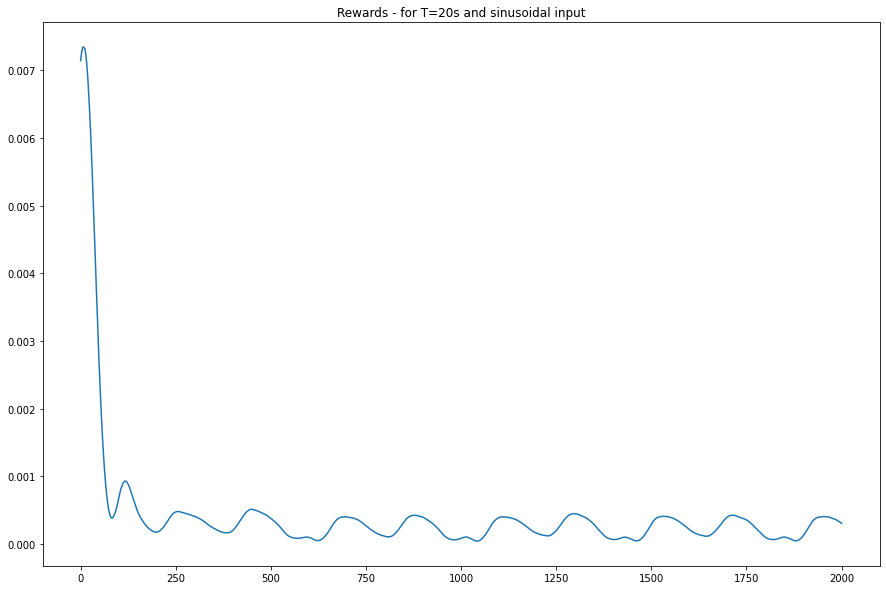

In [ ]:
total_reward = 0

for init_num in range(20): 
  plt.figure(figsize=(15,10))
  plt.title("Rewards - for T=20s and sinusoidal input")
  plt.plot(np.array(all_init_state_ep_rewards[init_num])[:,0,0]) ; 
  print("Mean Cost = ", sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])) ;
  total_reward += sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])

print("Average cost over all runs = ", total_reward/20)

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution with DDPG control - for T=20s and sinusoidal input and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

Output hidden; open in https://colab.research.google.com to view.

## sin(1.5*t) with DDPG - step

In [ ]:
model_path = './model/ddpg_rand_init_step'

test_episodes = 1
max_steps=2001
alg.load_model(model_path)
t_range = np.linspace(0,(max_steps-1)/100,max_steps)
w_sin = 0.02*0.25*np.sin(1.5*t_range)

## Square wave disturbance
# w_step = np.zeros(t_range.shape)
# w_step[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25

#w = w_step

w = w_sin

all_init_state_evols = {}
all_init_state_ep_rewards = {}

for init_num in range (20):
    print("Currently working on init num = ", init_num)
    q_loss_list=[]
    policy_loss_list=[]
    ep_rewards = [] ;
    #state = env.reset()
    state = np.concatenate((env.C@(env.reset(init_states[:,init_num][:,None])), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]        

    states_evolution = state[:,None]

    episode_reward = 0

    for step in tqdm(range(max_steps)):
        action = alg.policy_net.get_action(state, noise_scale=0.0)  # no noise for testing

        # action = action/400

        # next_state, reward, done, _ = env.step(action)

        true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
        next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
        reward = -cost  

        ep_rewards.append(cost)
        
        state = next_state

        states_evolution = np.concatenate((states_evolution, state[:,None]), axis=1)

        episode_reward += reward

    all_init_state_evols[init_num] = states_evolution 
    all_init_state_ep_rewards[init_num] = ep_rewards    
        
        # if done:
        #     break
#rewards

Currently working on init num =  0


  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.8/dist-packages/torch/nn/functional.py:1956: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
100%|██████████| 2001/2001 [00:16<00:00, 117.91it/s]


Currently working on init num =  1


100%|██████████| 2001/2001 [00:17<00:00, 117.61it/s]


Currently working on init num =  2


100%|██████████| 2001/2001 [00:16<00:00, 124.26it/s]


Currently working on init num =  3


100%|██████████| 2001/2001 [00:14<00:00, 136.20it/s]


Currently working on init num =  4


100%|██████████| 2001/2001 [00:14<00:00, 135.85it/s]


Currently working on init num =  5


100%|██████████| 2001/2001 [00:15<00:00, 132.91it/s]


Currently working on init num =  6


100%|██████████| 2001/2001 [00:14<00:00, 134.92it/s]


Currently working on init num =  7


100%|██████████| 2001/2001 [00:14<00:00, 136.74it/s]


Currently working on init num =  8


100%|██████████| 2001/2001 [00:14<00:00, 135.26it/s]


Currently working on init num =  9


100%|██████████| 2001/2001 [00:14<00:00, 138.00it/s]


Currently working on init num =  10


100%|██████████| 2001/2001 [00:14<00:00, 133.43it/s]


Currently working on init num =  11


100%|██████████| 2001/2001 [00:14<00:00, 134.79it/s]


Currently working on init num =  12


100%|██████████| 2001/2001 [00:14<00:00, 135.80it/s]


Currently working on init num =  13


100%|██████████| 2001/2001 [00:14<00:00, 134.90it/s]


Currently working on init num =  14


100%|██████████| 2001/2001 [00:14<00:00, 135.28it/s]


Currently working on init num =  15


100%|██████████| 2001/2001 [00:14<00:00, 133.93it/s]


Currently working on init num =  16


100%|██████████| 2001/2001 [00:14<00:00, 136.87it/s]


Currently working on init num =  17


100%|██████████| 2001/2001 [00:14<00:00, 136.75it/s]


Currently working on init num =  18


100%|██████████| 2001/2001 [00:14<00:00, 134.95it/s]


Currently working on init num =  19


100%|██████████| 2001/2001 [00:14<00:00, 134.97it/s]


Mean Cost =  [[0.00095613]]
Mean Cost =  [[0.00110005]]
Mean Cost =  [[0.00156689]]
Mean Cost =  [[0.00087605]]
Mean Cost =  [[0.00094345]]
Mean Cost =  [[0.00101086]]
Mean Cost =  [[0.00117794]]
Mean Cost =  [[0.00120219]]
Mean Cost =  [[0.00105103]]
Mean Cost =  [[0.00115796]]
Mean Cost =  [[0.00091384]]
Mean Cost =  [[0.00114106]]
Mean Cost =  [[0.00095095]]
Mean Cost =  [[0.00091985]]
Mean Cost =  [[0.0013111]]
Mean Cost =  [[0.00103492]]
Mean Cost =  [[0.00116849]]
Mean Cost =  [[0.00119402]]
Mean Cost =  [[0.00110799]]
Mean Cost =  [[0.00098411]]
Average cost over all runs =  [[0.00108844]]


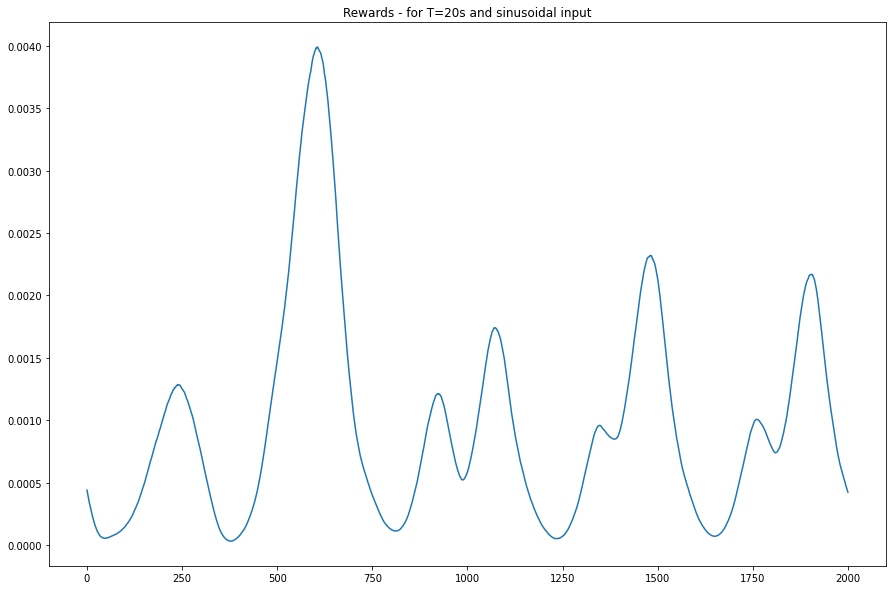

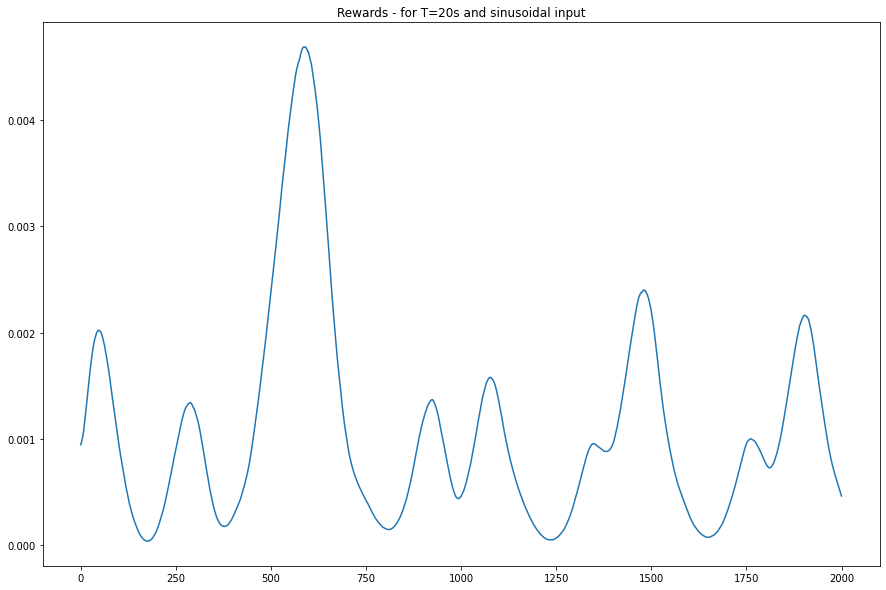

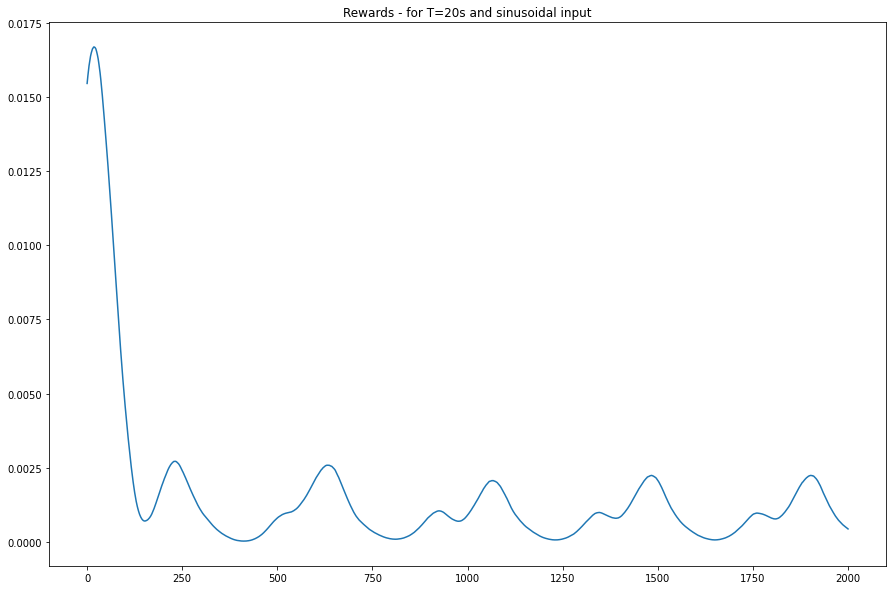

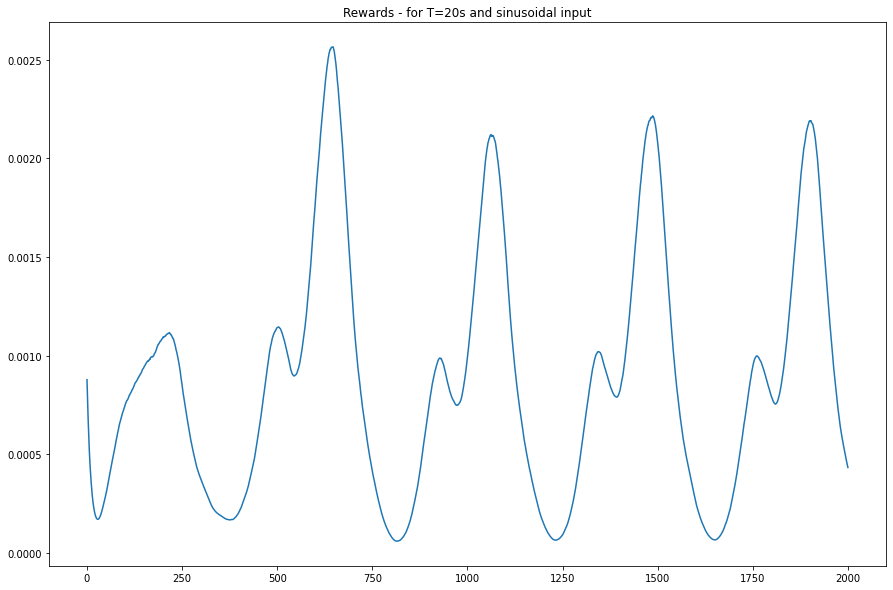

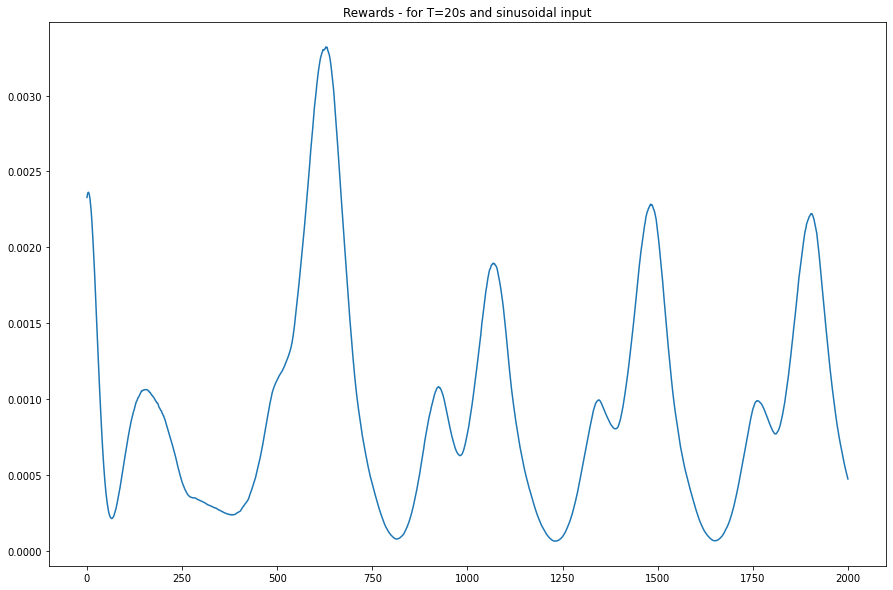

...

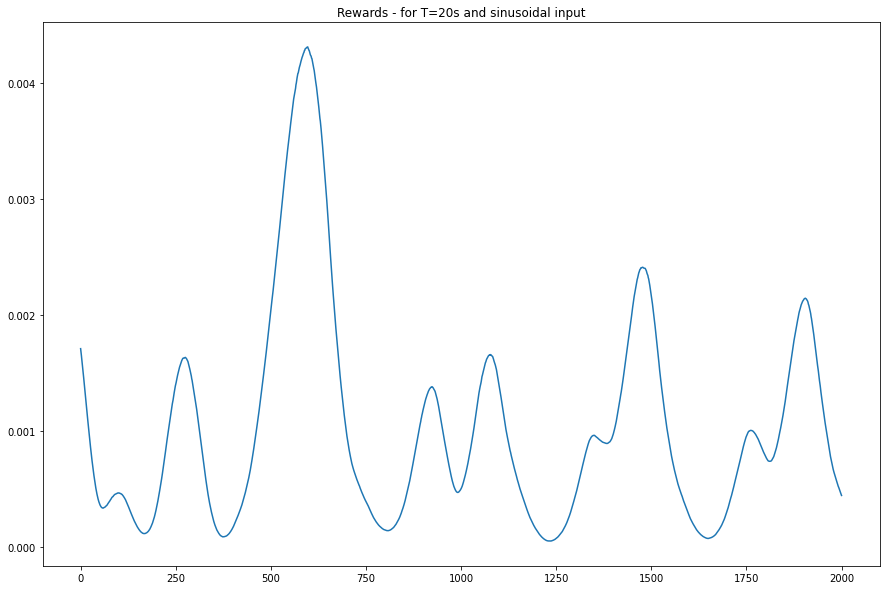

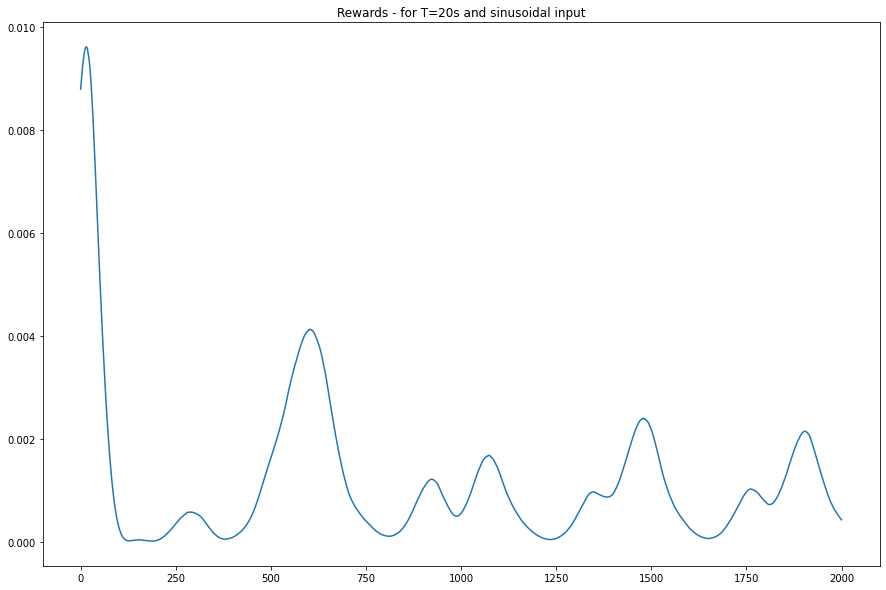

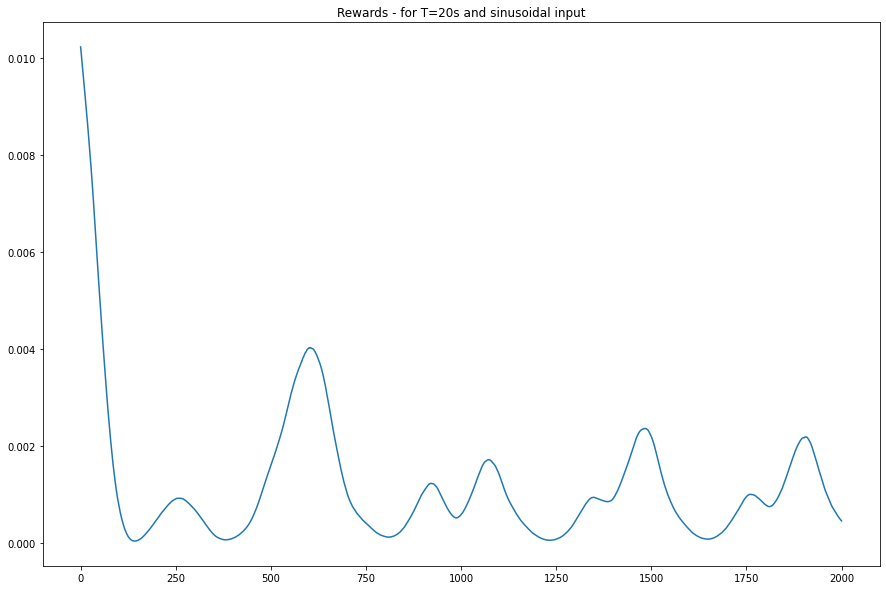

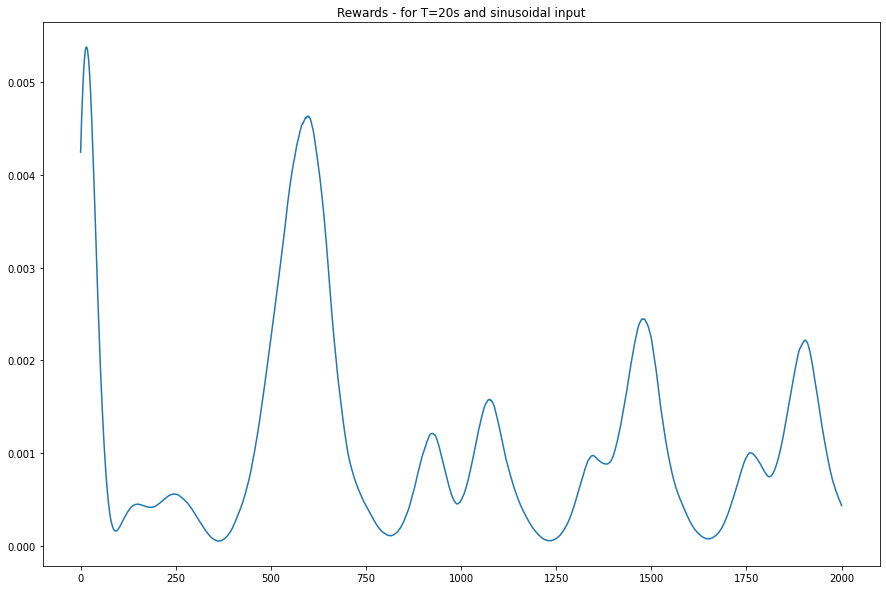

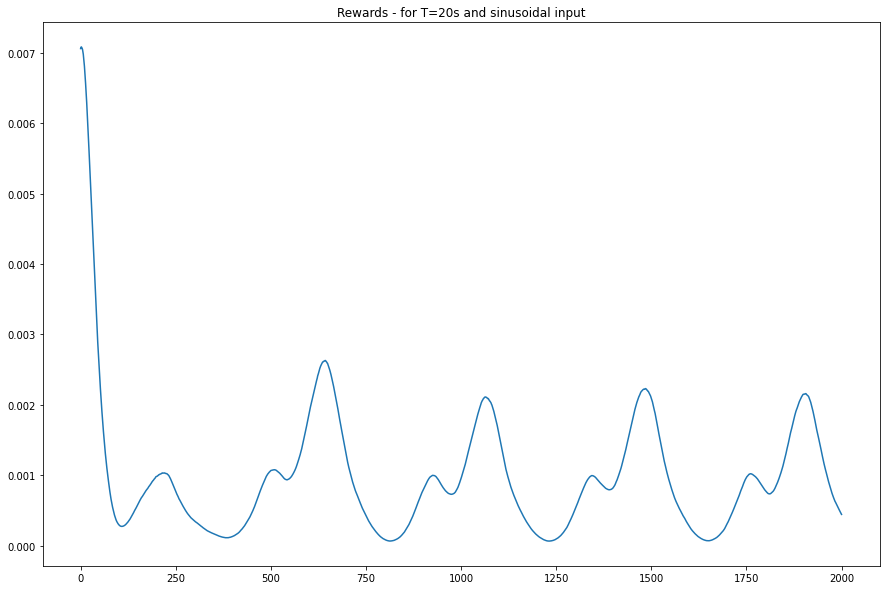

In [ ]:
total_reward = 0

for init_num in range(20): 
  plt.figure(figsize=(15,10))
  plt.title("Rewards - for T=20s and sinusoidal input")
  plt.plot(np.array(all_init_state_ep_rewards[init_num])[:,0,0]) ; 
  print("Mean Cost = ", sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])) ;
  total_reward += sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])

print("Average cost over all runs = ", total_reward/20)

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution with DDPG control - for T=20s and sinusoidal input and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

Output hidden; open in https://colab.research.google.com to view.

## sin(2*t) with DDPG

In [ ]:
model_path = './model/ddpg_rand_init_sin_2_0x'

test_episodes = 1
max_steps=2001
#alg.load_model(model_path)
t_range = np.linspace(0,(max_steps-1)/100,max_steps)
w_sin = 0.02*0.25*np.sin(2*t_range)

## Square wave disturbance
# w_step = np.zeros(t_range.shape)
# w_step[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25

#w = w_step

w = w_sin

all_init_state_evols = {}
all_init_state_ep_rewards = {}

for init_num in range (20):
    print("Currently working on init num = ", init_num)
    q_loss_list=[]
    policy_loss_list=[]
    ep_rewards = [] ;
    #state = env.reset()
    state = np.concatenate((env.C@(env.reset(init_states[:,init_num][:,None])), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]        

    states_evolution = state[:,None]

    episode_reward = 0

    for step in tqdm(range(max_steps)):
        action = alg.policy_net.get_action(state, noise_scale=0.0)  # no noise for testing

        # action = action/400

        # next_state, reward, done, _ = env.step(action)

        true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
        next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
        reward = -cost  

        ep_rewards.append(cost)
        
        state = next_state

        states_evolution = np.concatenate((states_evolution, state[:,None]), axis=1)

        episode_reward += reward

    all_init_state_evols[init_num] = states_evolution 
    all_init_state_ep_rewards[init_num] = ep_rewards    
        
        # if done:
        #     break
#rewards

Currently working on init num =  0


  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.8/dist-packages/torch/nn/functional.py:1956: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
100%|██████████| 2001/2001 [00:14<00:00, 134.82it/s]


Currently working on init num =  1


100%|██████████| 2001/2001 [00:14<00:00, 136.43it/s]


Currently working on init num =  2


100%|██████████| 2001/2001 [00:14<00:00, 137.48it/s]


Currently working on init num =  3


100%|██████████| 2001/2001 [00:14<00:00, 138.15it/s]


Currently working on init num =  4


100%|██████████| 2001/2001 [00:14<00:00, 133.87it/s]


Currently working on init num =  5


100%|██████████| 2001/2001 [00:14<00:00, 137.54it/s]


Currently working on init num =  6


100%|██████████| 2001/2001 [00:14<00:00, 139.43it/s]


Currently working on init num =  7


100%|██████████| 2001/2001 [00:14<00:00, 138.40it/s]


Currently working on init num =  8


100%|██████████| 2001/2001 [00:14<00:00, 138.76it/s]


Currently working on init num =  9


100%|██████████| 2001/2001 [00:14<00:00, 135.93it/s]


Currently working on init num =  10


100%|██████████| 2001/2001 [00:14<00:00, 136.31it/s]


Currently working on init num =  11


100%|██████████| 2001/2001 [00:14<00:00, 139.19it/s]


Currently working on init num =  12


100%|██████████| 2001/2001 [00:14<00:00, 133.88it/s]


Currently working on init num =  13


100%|██████████| 2001/2001 [00:14<00:00, 138.22it/s]


Currently working on init num =  14


100%|██████████| 2001/2001 [00:14<00:00, 138.46it/s]


Currently working on init num =  15


100%|██████████| 2001/2001 [00:14<00:00, 139.90it/s]


Currently working on init num =  16


100%|██████████| 2001/2001 [00:14<00:00, 138.06it/s]


Currently working on init num =  17


100%|██████████| 2001/2001 [00:14<00:00, 139.31it/s]


Currently working on init num =  18


100%|██████████| 2001/2001 [00:14<00:00, 138.38it/s]


Currently working on init num =  19


100%|██████████| 2001/2001 [00:14<00:00, 138.79it/s]


Mean Cost =  [[0.00018291]]
Mean Cost =  [[0.0002436]]
Mean Cost =  [[0.00096202]]
Mean Cost =  [[0.00018378]]
Mean Cost =  [[0.00026145]]
Mean Cost =  [[0.00025454]]
Mean Cost =  [[0.0004777]]
Mean Cost =  [[0.00047807]]
Mean Cost =  [[0.00039327]]
Mean Cost =  [[0.00035223]]
Mean Cost =  [[0.00018647]]
Mean Cost =  [[0.00038955]]
Mean Cost =  [[0.00020773]]
Mean Cost =  [[0.00024463]]
Mean Cost =  [[0.0004949]]
Mean Cost =  [[0.0001861]]
Mean Cost =  [[0.00042839]]
Mean Cost =  [[0.00042154]]
Mean Cost =  [[0.00033262]]
Mean Cost =  [[0.00033812]]
Average cost over all runs =  [[0.00035098]]


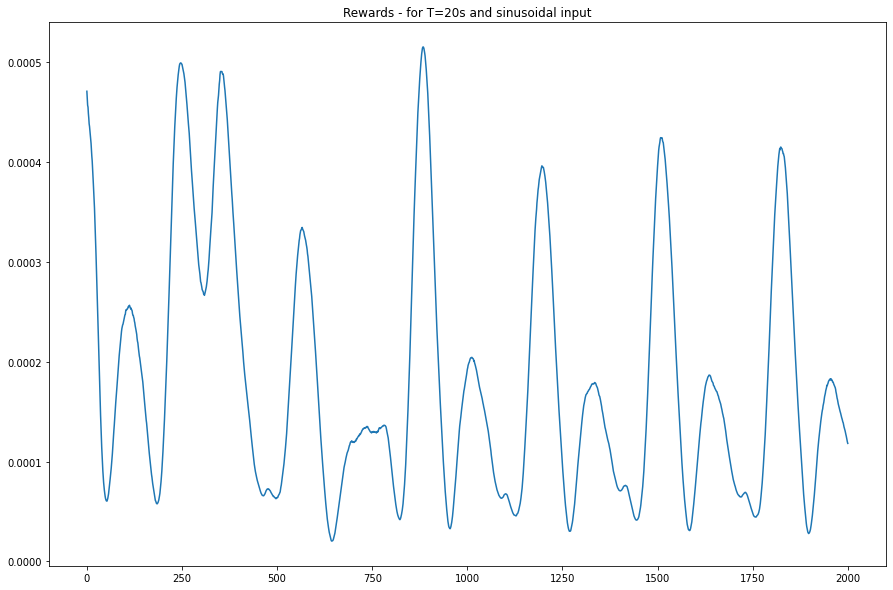

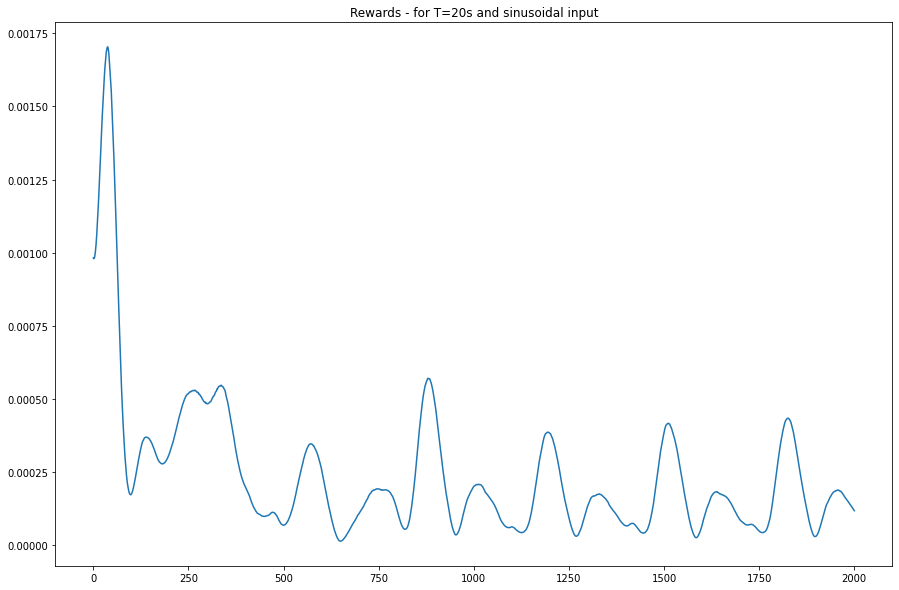

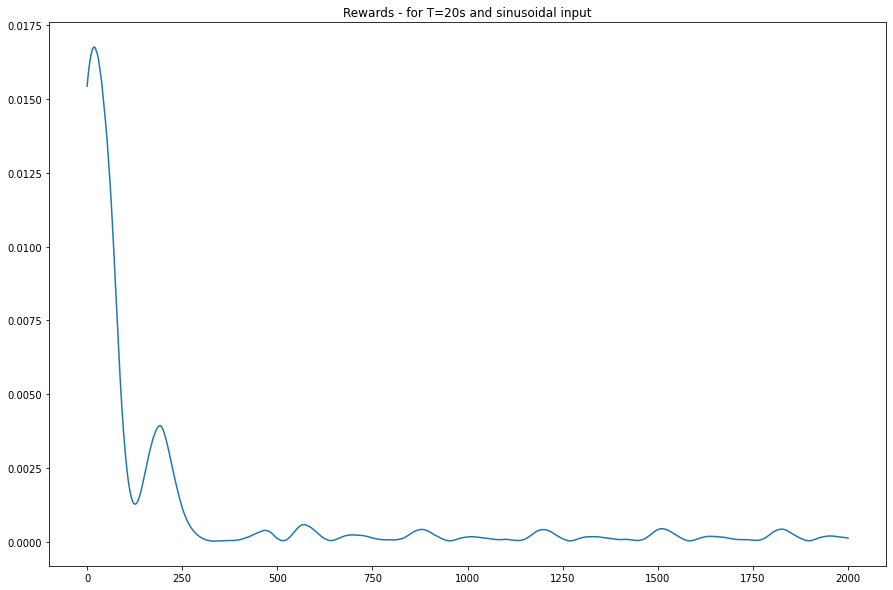

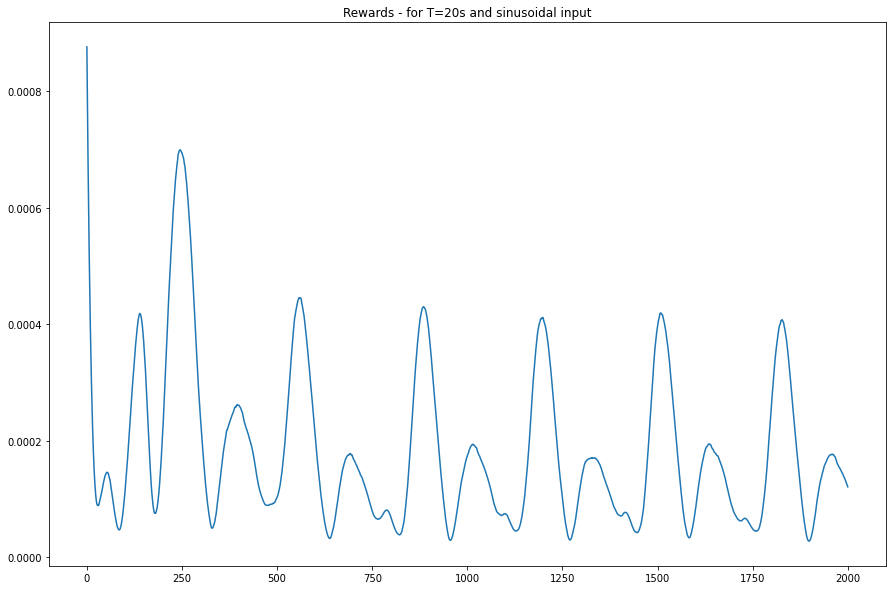

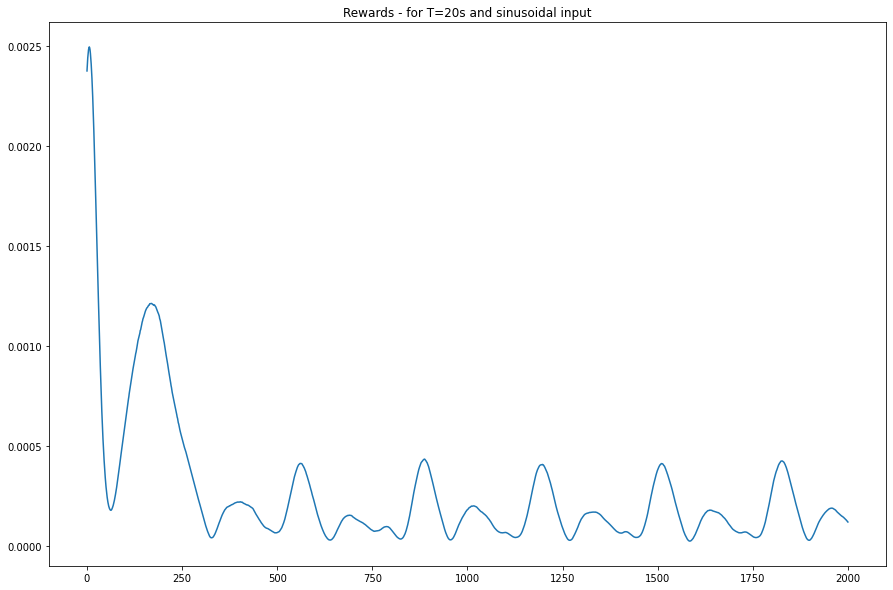

...

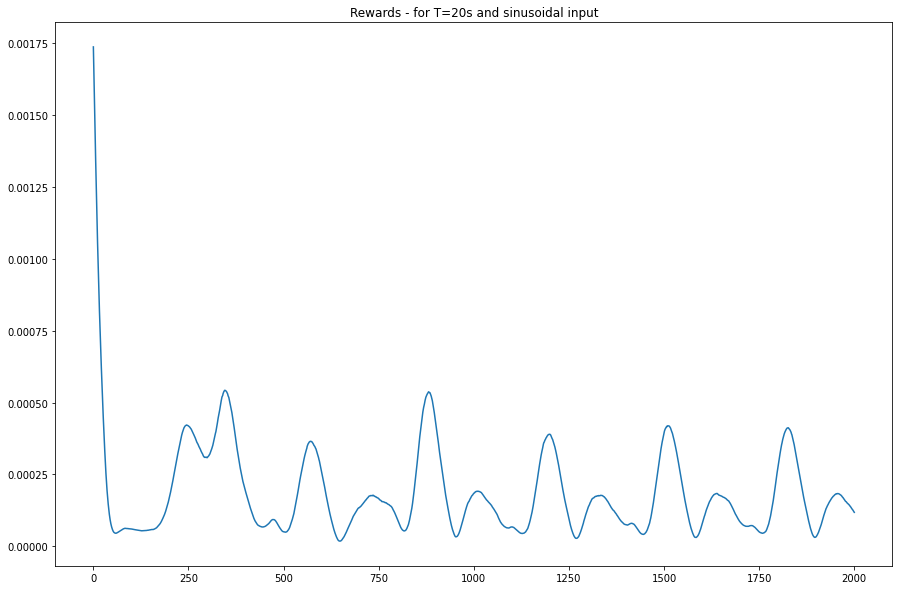

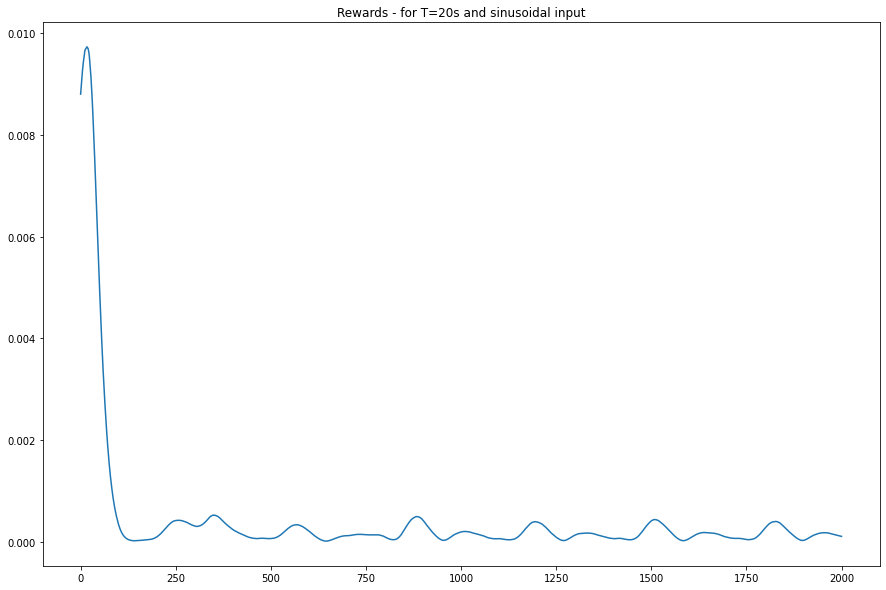

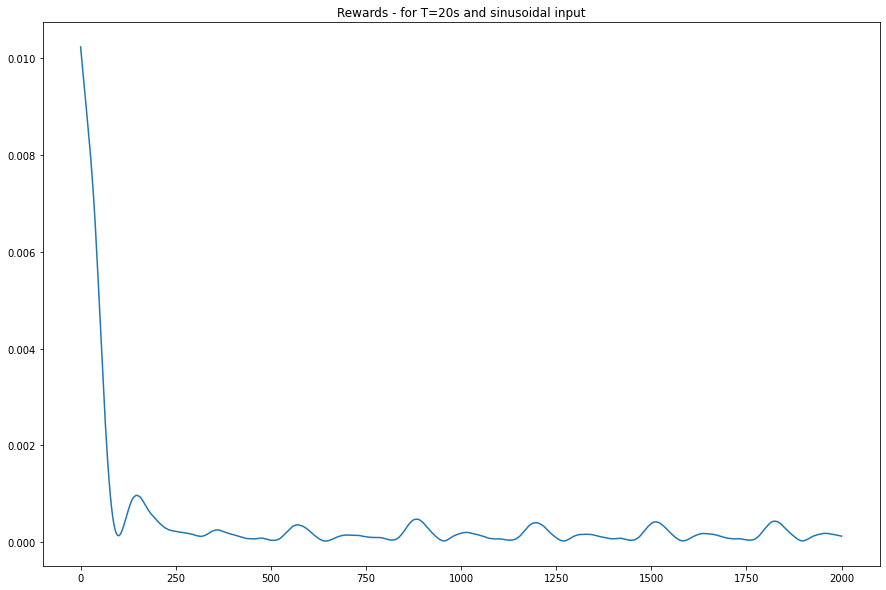

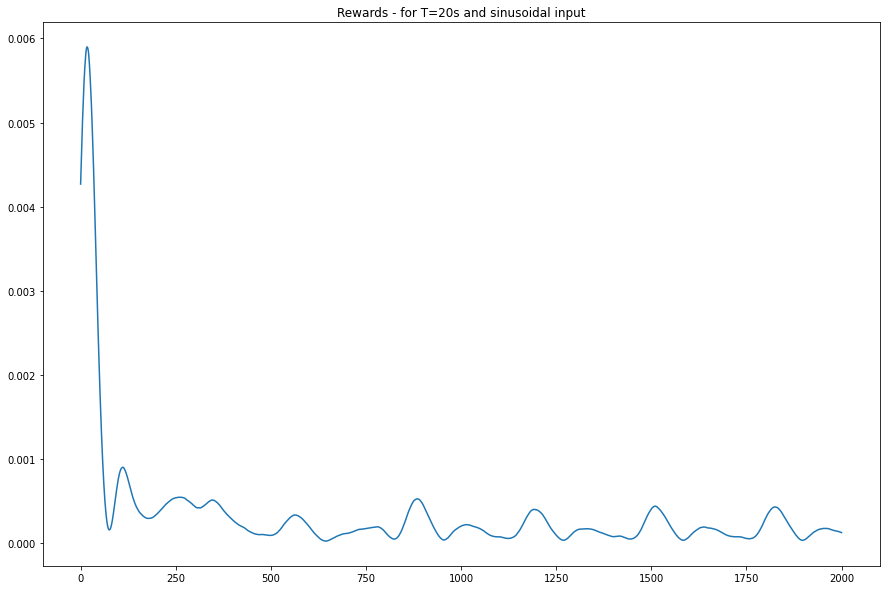

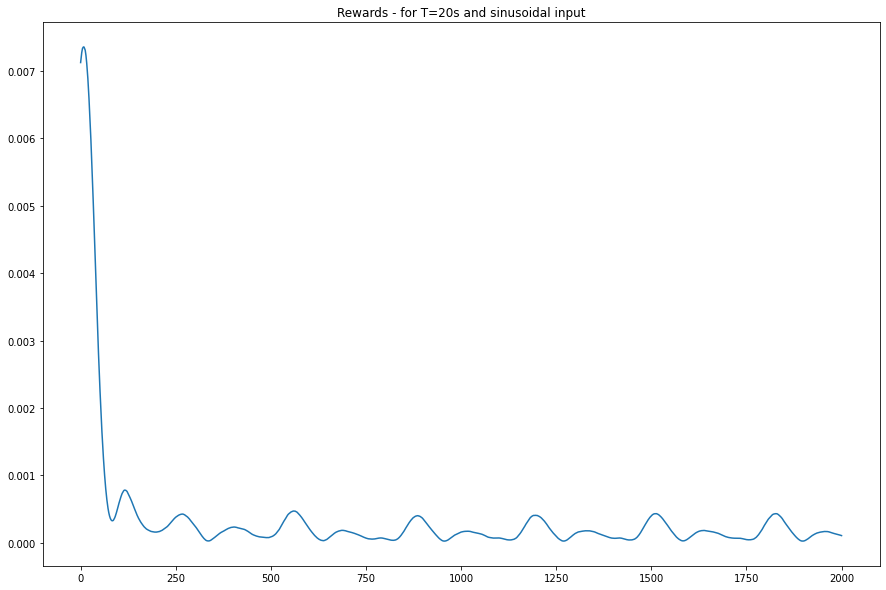

In [ ]:
total_reward = 0

for init_num in range(20): 
  plt.figure(figsize=(15,10))
  plt.title("Rewards - for T=20s and sinusoidal input")
  plt.plot(np.array(all_init_state_ep_rewards[init_num])[:,0,0]) ; 
  print("Mean Cost = ", sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])) ;
  total_reward += sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])

print("Average cost over all runs = ", total_reward/20)

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution with DDPG control - for T=20s and sinusoidal input and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

Output hidden; open in https://colab.research.google.com to view.

## sin(2*t) with DDPG - Step

In [ ]:
model_path = './model/ddpg_rand_init_step'

test_episodes = 1
max_steps=2001
alg.load_model(model_path)
t_range = np.linspace(0,(max_steps-1)/100,max_steps)
w_sin = 0.02*0.25*np.sin(2*t_range)

## Square wave disturbance
# w_step = np.zeros(t_range.shape)
# w_step[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25

#w = w_step

w = w_sin

all_init_state_evols = {}
all_init_state_ep_rewards = {}

for init_num in range (20):
    print("Currently working on init num = ", init_num)
    q_loss_list=[]
    policy_loss_list=[]
    ep_rewards = [] ;
    #state = env.reset()
    state = np.concatenate((env.C@(env.reset(init_states[:,init_num][:,None])), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]        

    states_evolution = state[:,None]

    episode_reward = 0

    for step in tqdm(range(max_steps)):
        action = alg.policy_net.get_action(state, noise_scale=0.0)  # no noise for testing

        # action = action/400

        # next_state, reward, done, _ = env.step(action)

        true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
        next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
        reward = -cost  

        ep_rewards.append(cost)
        
        state = next_state

        states_evolution = np.concatenate((states_evolution, state[:,None]), axis=1)

        episode_reward += reward

    all_init_state_evols[init_num] = states_evolution 
    all_init_state_ep_rewards[init_num] = ep_rewards    
        
        # if done:
        #     break
#rewards

Currently working on init num =  0


  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.8/dist-packages/torch/nn/functional.py:1956: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
100%|██████████| 2001/2001 [00:16<00:00, 119.18it/s]


Currently working on init num =  1


100%|██████████| 2001/2001 [00:16<00:00, 117.79it/s]


Currently working on init num =  2


100%|██████████| 2001/2001 [00:16<00:00, 118.62it/s]


Currently working on init num =  3


100%|██████████| 2001/2001 [00:14<00:00, 134.76it/s]


Currently working on init num =  4


100%|██████████| 2001/2001 [00:14<00:00, 134.84it/s]


Currently working on init num =  5


100%|██████████| 2001/2001 [00:14<00:00, 135.49it/s]


Currently working on init num =  6


100%|██████████| 2001/2001 [00:14<00:00, 135.25it/s]


Currently working on init num =  7


100%|██████████| 2001/2001 [00:14<00:00, 135.84it/s]


Currently working on init num =  8


100%|██████████| 2001/2001 [00:14<00:00, 134.82it/s]


Currently working on init num =  9


100%|██████████| 2001/2001 [00:14<00:00, 135.18it/s]


Currently working on init num =  10


100%|██████████| 2001/2001 [00:14<00:00, 133.56it/s]


Currently working on init num =  11


100%|██████████| 2001/2001 [00:14<00:00, 133.52it/s]


Currently working on init num =  12


100%|██████████| 2001/2001 [00:14<00:00, 136.53it/s]


Currently working on init num =  13


100%|██████████| 2001/2001 [00:14<00:00, 135.36it/s]


Currently working on init num =  14


100%|██████████| 2001/2001 [00:14<00:00, 137.17it/s]


Currently working on init num =  15


100%|██████████| 2001/2001 [00:14<00:00, 135.84it/s]


Currently working on init num =  16


100%|██████████| 2001/2001 [00:15<00:00, 132.99it/s]


Currently working on init num =  17


100%|██████████| 2001/2001 [00:14<00:00, 135.22it/s]


Currently working on init num =  18


100%|██████████| 2001/2001 [00:14<00:00, 137.36it/s]


Currently working on init num =  19


100%|██████████| 2001/2001 [00:14<00:00, 136.78it/s]


Mean Cost =  [[0.00070598]]
Mean Cost =  [[0.00084977]]
Mean Cost =  [[0.00138522]]
Mean Cost =  [[0.00065187]]
Mean Cost =  [[0.00069102]]
Mean Cost =  [[0.00080501]]
Mean Cost =  [[0.00099688]]
Mean Cost =  [[0.00096169]]
Mean Cost =  [[0.00089]]
Mean Cost =  [[0.0008827]]
Mean Cost =  [[0.00067799]]
Mean Cost =  [[0.00088155]]
Mean Cost =  [[0.00075581]]
Mean Cost =  [[0.00070521]]
Mean Cost =  [[0.00109396]]
Mean Cost =  [[0.00078259]]
Mean Cost =  [[0.00091017]]
Mean Cost =  [[0.00097856]]
Mean Cost =  [[0.00081941]]
Mean Cost =  [[0.00077136]]
Average cost over all runs =  [[0.00085984]]


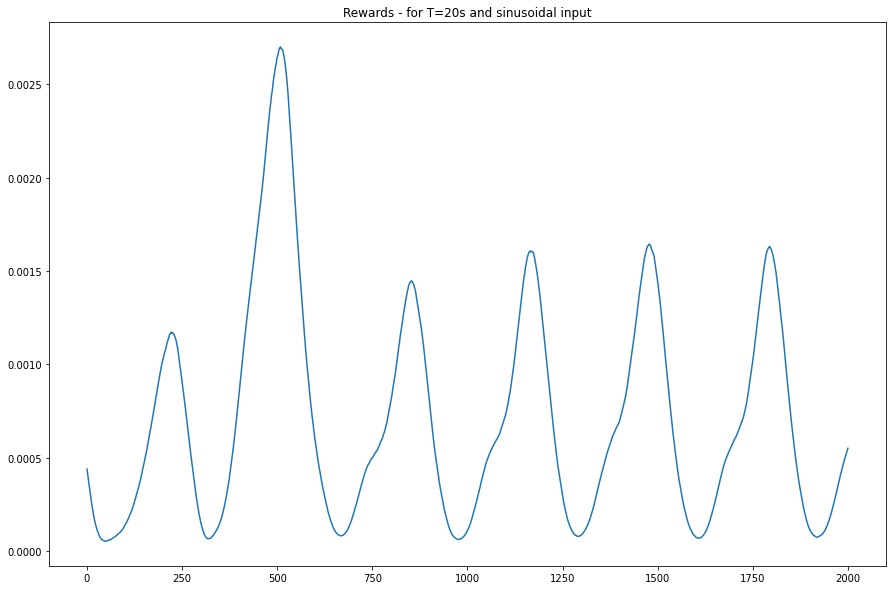

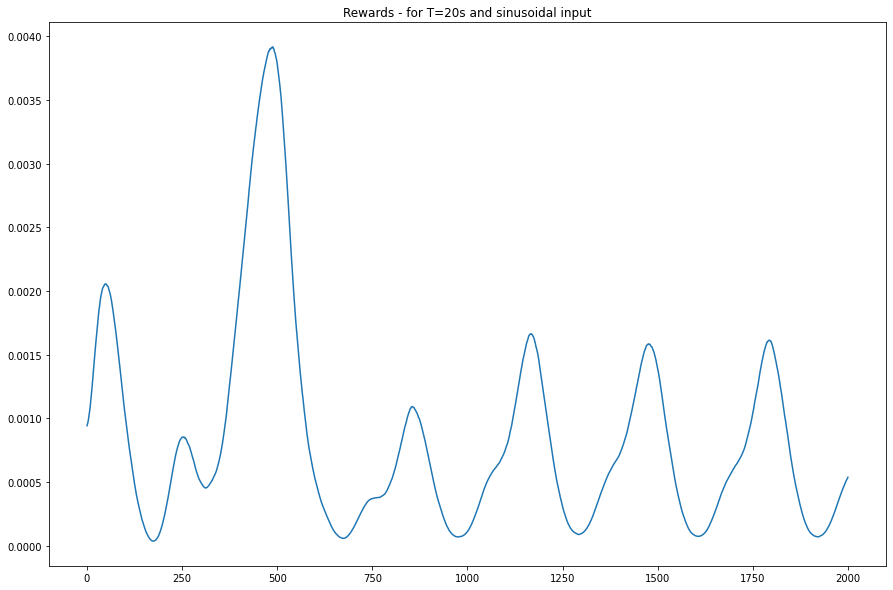

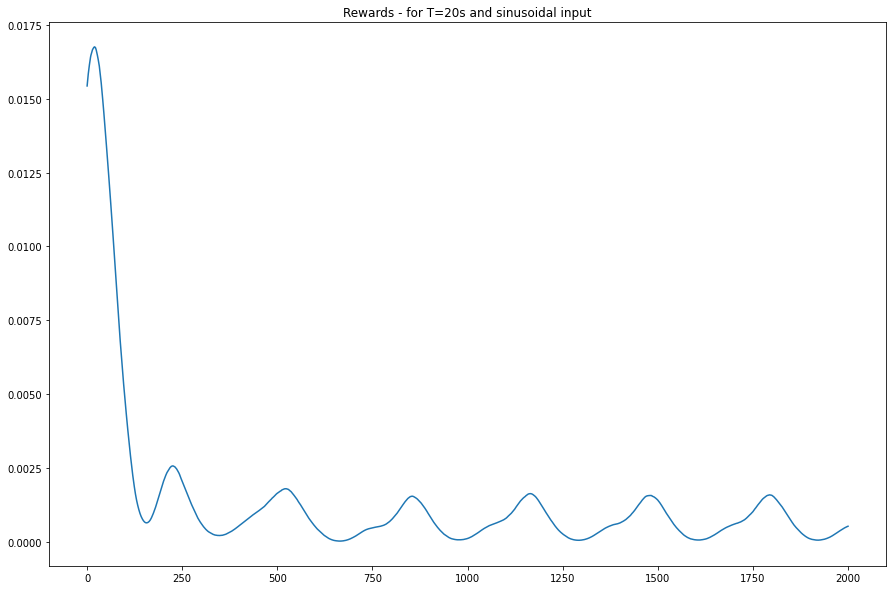

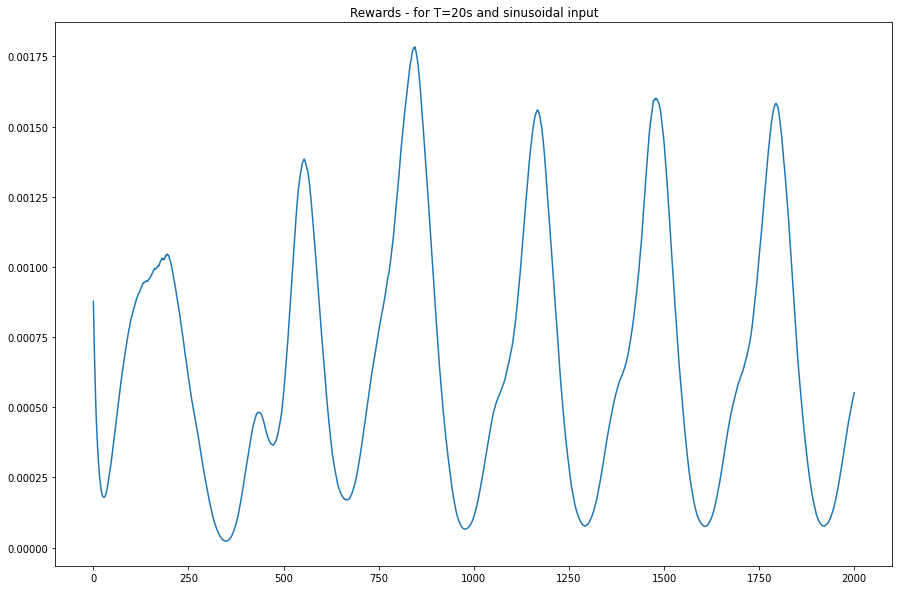

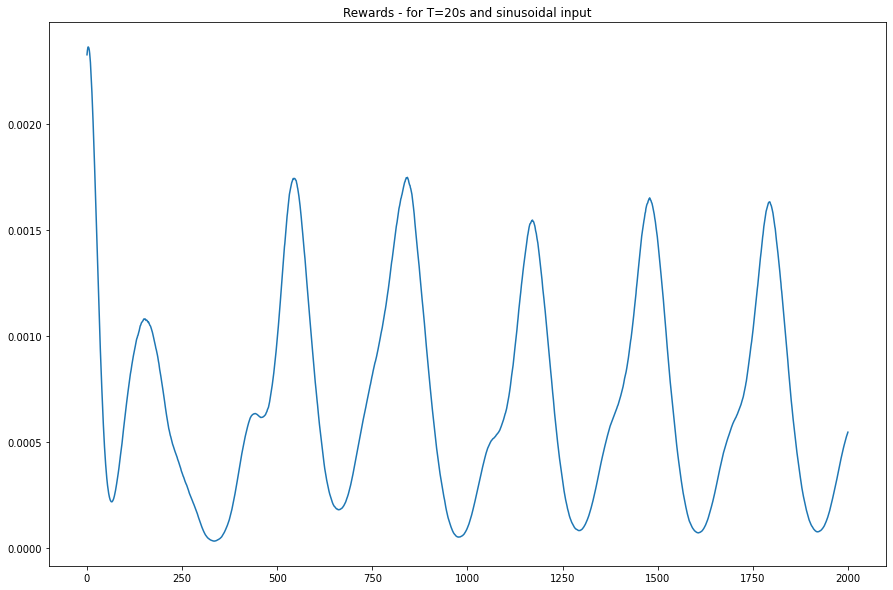

...

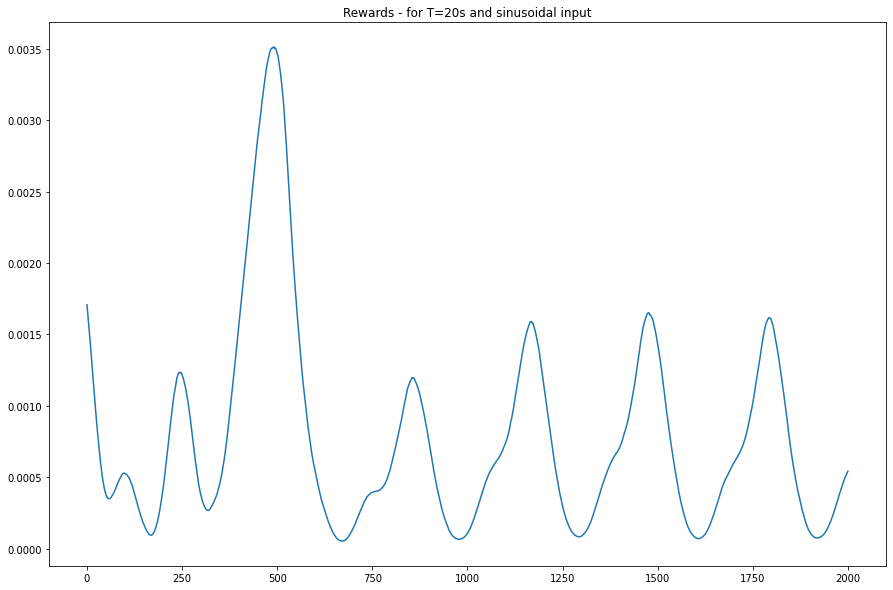

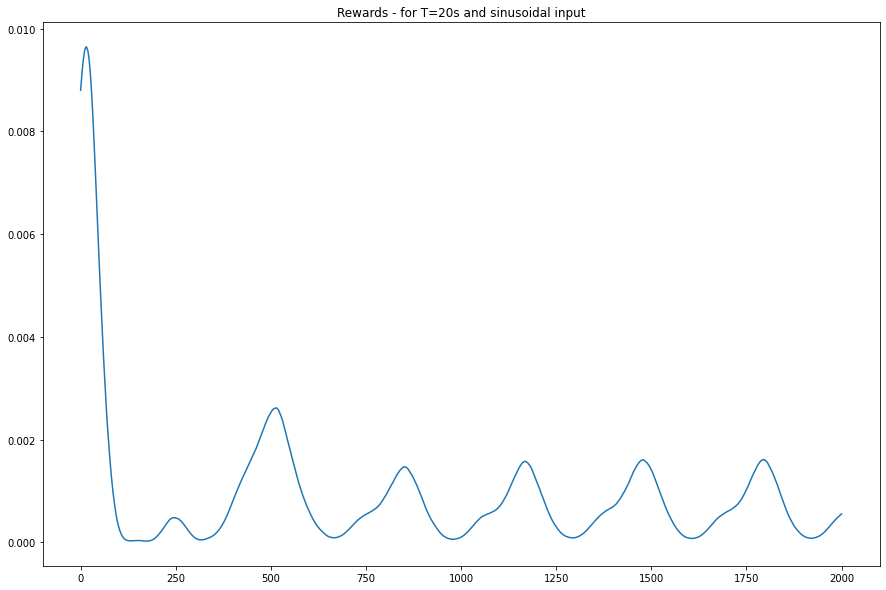

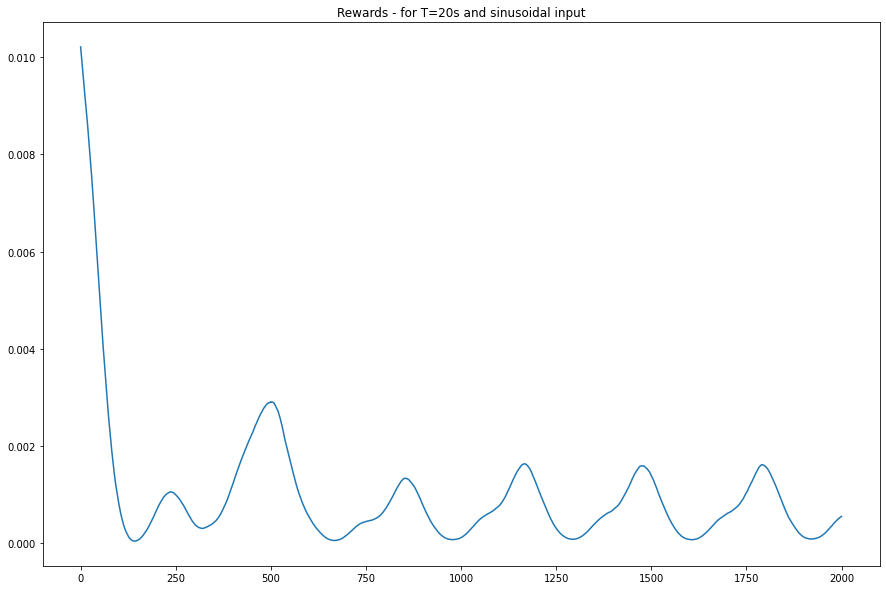

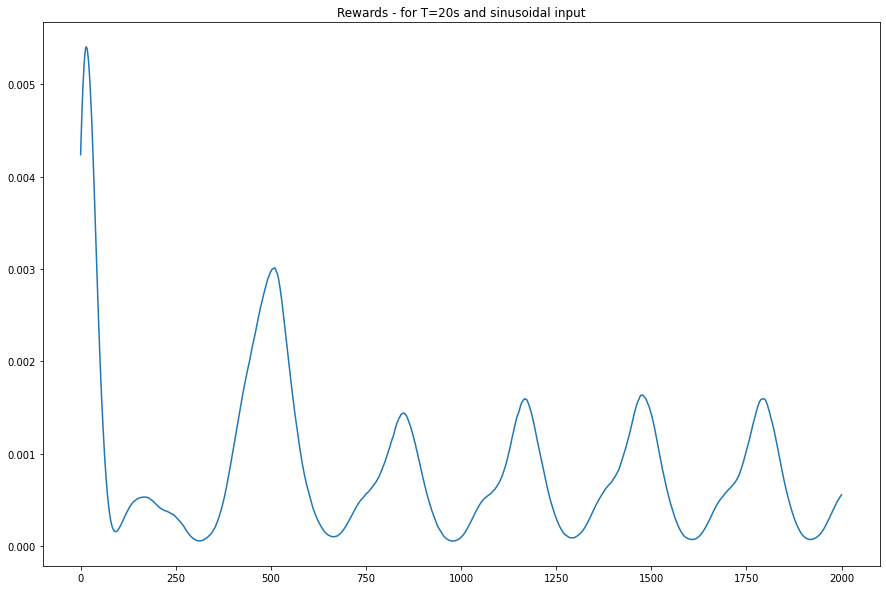

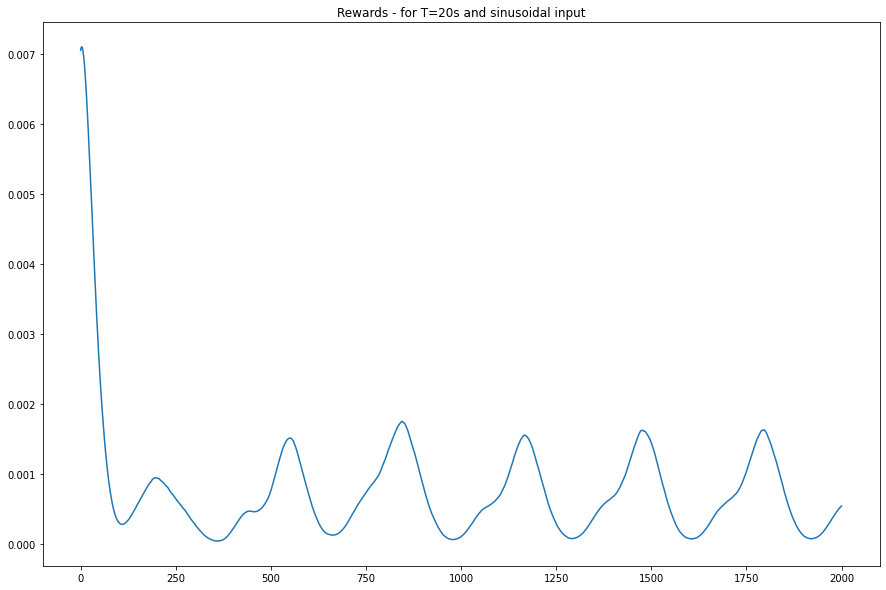

In [ ]:
total_reward = 0

for init_num in range(20): 
  plt.figure(figsize=(15,10))
  plt.title("Rewards - for T=20s and sinusoidal input")
  plt.plot(np.array(all_init_state_ep_rewards[init_num])[:,0,0]) ; 
  print("Mean Cost = ", sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])) ;
  total_reward += sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])

print("Average cost over all runs = ", total_reward/20)

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution with DDPG control - for T=20s and sinusoidal input and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

Output hidden; open in https://colab.research.google.com to view.

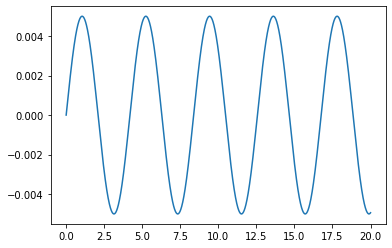

In [ ]:
env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=np.identity(10), R=np.identity(1), reset_type='random')

In [ ]:
init_states = env.reset()

for i in range(19):
  init_states = np.concatenate((init_states, env.reset()), axis=1)
print(init_states.shape)

(10, 20)


## Square wave - Length = 25

In [ ]:
## Simulate system without any external input and plot state-evolution just to see 
## if it works

t_range = np.linspace(0,20,2001) 

## CHANGE HERE
#w1 = 0.02*0.25*np.sin(t_range) ; 

## Square wave disturbance
w_step = np.zeros(t_range.shape)
w_step[100:125] = 0.02*0.25

w1 = w_step


all_init_state_evols = {}

for init_num in range(20):  
  env.reset(init_states[:,init_num][:,None])
  state_evolution = env.state ; 

  for t_step in range(t_range.shape[0]):     
  #for t_step in range(1):     
      t = t_range[t_step]
      #print("time = ", t)
      action = np.atleast_2d(np.array([0])).astype(np.float32) ; 
      #print(action)
      state, obs , cost, _, _ = env.step(action=action, meas_dist=np.atleast_2d(np.array([w1[t_step] , 0])).T, t_step=t_step)
      #total_costs += cost * gamma**(t)

      state_evolution = np.concatenate((state_evolution, state), axis=1)    
  all_init_state_evols[init_num] = state_evolution  

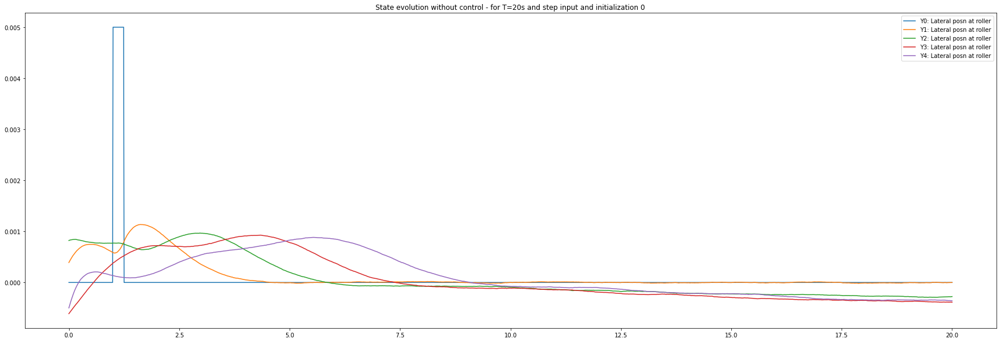

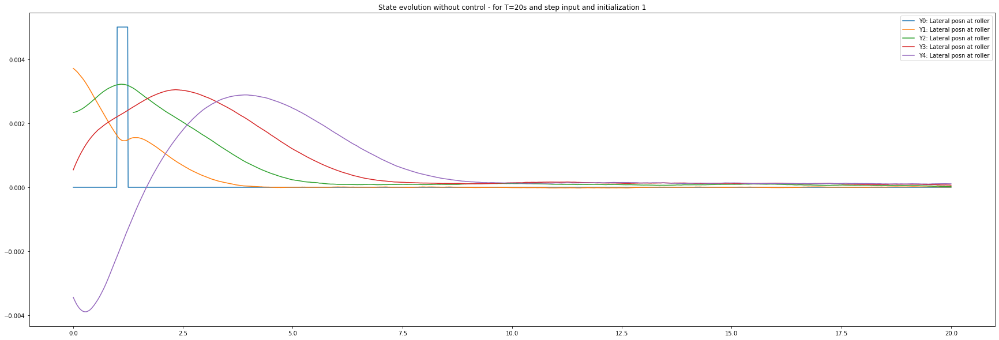

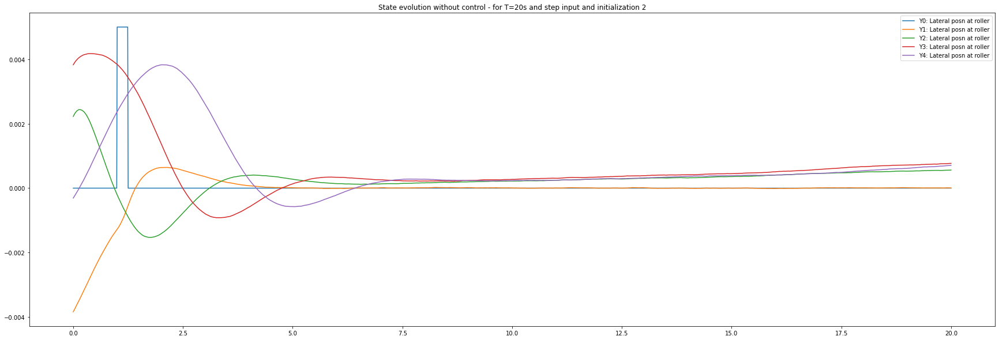

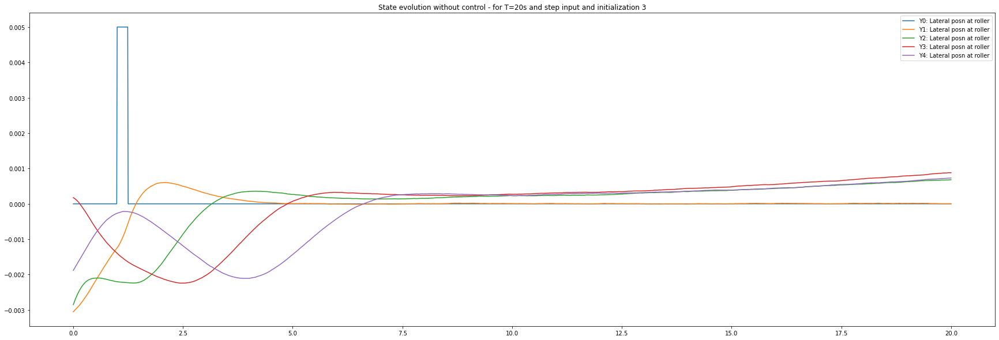

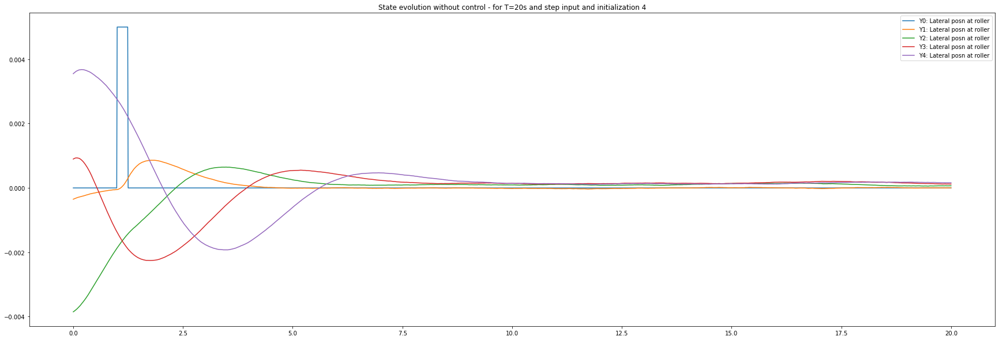

...

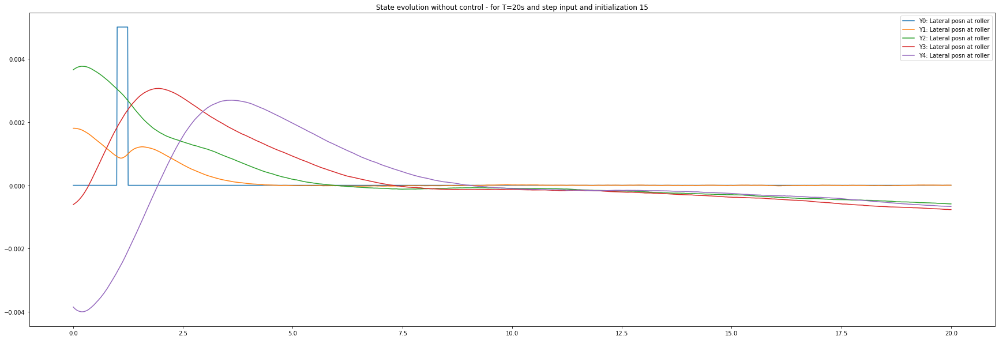

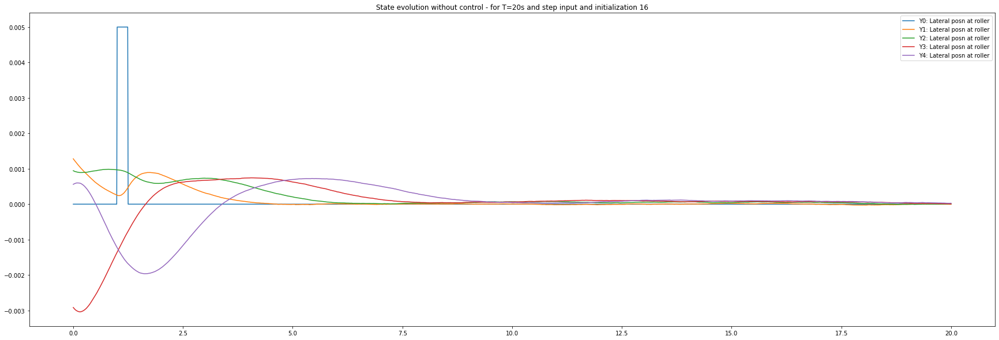

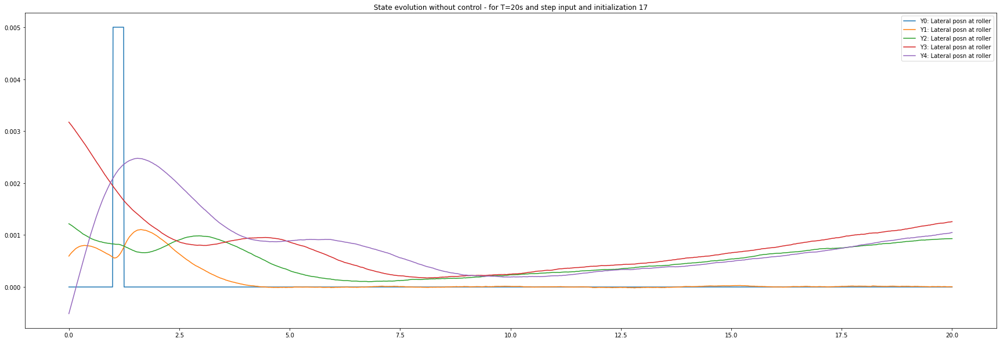

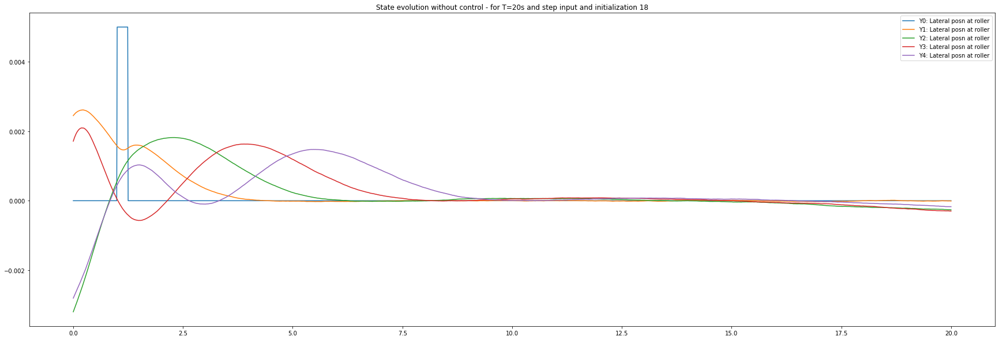

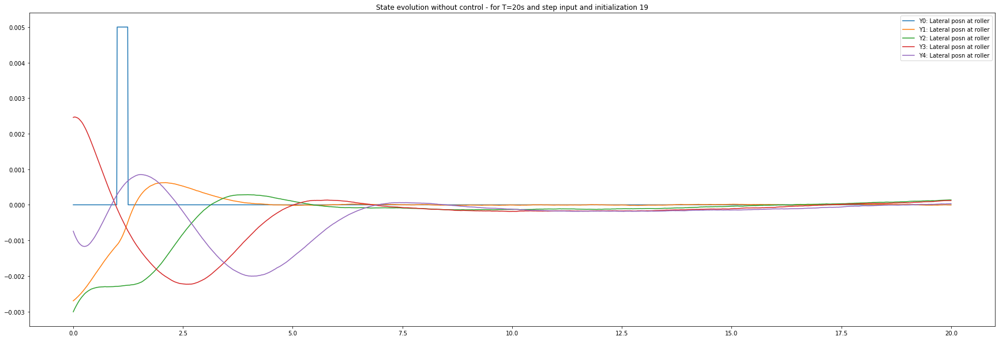

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution without control - for T=20s and step input and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w1, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

In [ ]:
  for init_num in range(20):
    plt.figure(figsize=(30,10))
    prtstr = "State evolution without control - for T=20s and step input and initialization " + str(init_num)
    plt.title(prtstr)

    plt.plot(t_range, all_init_state_evols[init_num][1,:2001], label='Y1: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][3,:2001], label='Y2: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][5,:2001], label='Y3: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][7,:2001], label='Y4: Lateral velocity at roller')

    plt.legend() ;

Output hidden; open in https://colab.research.google.com to view.

## step input - length = 50

In [ ]:
## Simulate system without any external input and plot state-evolution just to see 
## if it works

t_range = np.linspace(0,20,2001) 

## CHANGE HERE
#w1 = 0.02*0.25*np.sin(1.5*t_range) ; 

## Square wave disturbance
w_step = np.zeros(t_range.shape)
w_step[100:150] = 0.02*0.25

w1 = w_step

all_init_state_evols = {}

for init_num in range(20):  
  env.reset(init_states[:,init_num][:,None])
  state_evolution = env.state ; 

  for t_step in range(t_range.shape[0]):     
  #for t_step in range(1):     
      t = t_range[t_step]
      #print("time = ", t)
      action = np.atleast_2d(np.array([0])).astype(np.float32) ; 
      #print(action)
      state, obs , cost, _, _ = env.step(action=action, meas_dist=np.atleast_2d(np.array([w1[t_step] , 0])).T, t_step=t_step)
      #total_costs += cost * gamma**(t)

      state_evolution = np.concatenate((state_evolution, state), axis=1)    
  all_init_state_evols[init_num] = state_evolution  

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution without control - for T=20s and step input and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w1, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
  for init_num in range(20):
    plt.figure(figsize=(30,10))
    prtstr = "State evolution without control - for T=20s and step input and initialization " + str(init_num)
    plt.title(prtstr)

    plt.plot(t_range, all_init_state_evols[init_num][1,:2001], label='Y1: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][3,:2001], label='Y2: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][5,:2001], label='Y3: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][7,:2001], label='Y4: Lateral velocity at roller')

    plt.legend() ;

Output hidden; open in https://colab.research.google.com to view.

## step-input - 100

In [ ]:
## Simulate system without any external input and plot state-evolution just to see 
## if it works

t_range = np.linspace(0,20,2001) 

## CHANGE HERE
# w1 = 0.02*0.25*np.sin(2*t_range) ; 

## Square wave disturbance
w_step = np.zeros(t_range.shape)
w_step[100:200] = 0.02*0.25

w1 = w_step

all_init_state_evols = {}

for init_num in range(20):  
  env.reset(init_states[:,init_num][:,None])
  state_evolution = env.state ; 

  for t_step in range(t_range.shape[0]):     
  #for t_step in range(1):     
      t = t_range[t_step]
      #print("time = ", t)
      action = np.atleast_2d(np.array([0])).astype(np.float32) ; 
      #print(action)
      state, obs , cost, _, _ = env.step(action=action, meas_dist=np.atleast_2d(np.array([w1[t_step] , 0])).T, t_step=t_step)
      #total_costs += cost * gamma**(t)

      state_evolution = np.concatenate((state_evolution, state), axis=1)    
  all_init_state_evols[init_num] = state_evolution  

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution without control - for T=20s and step input and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w1, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
  for init_num in range(20):
    plt.figure(figsize=(30,10))
    prtstr = "State evolution without control - for T=20s and step input and initialization " + str(init_num)
    plt.title(prtstr)

    plt.plot(t_range, all_init_state_evols[init_num][1,:2001], label='Y1: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][3,:2001], label='Y2: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][5,:2001], label='Y3: Lateral velocity at roller')
    plt.plot(t_range, all_init_state_evols[init_num][7,:2001], label='Y4: Lateral velocity at roller')

    plt.legend() ;

Output hidden; open in https://colab.research.google.com to view.

## step 25 control with ELQR

In [ ]:
## Simulate system withELQR control
## if it works

Q = np.identity(10) ; 
Q[2,2] = 100 ; 
Q[4,4] = 1000

# Q[0,0] = 0 ; 
# Q[1,1] = 0 ; 
# Q[2,2] = 0 ; 
# Q[3,3] = 0 ; 
# Q[5,5] = 0 ; 
# Q[7,7] = 0 ; 
# Q[8,8] = 0 ; 
# Q[9,9] = 0 ; 

R = np.identity(1) ;


#env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1))
env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1), reset_type='random')
K,G = gen_ELQR_mats(A=A_nom, B=B_nom, F=F_nom, env=env)

#t_range = np.linspace(0,20,2001) 

t_range = np.linspace(0,20,2001) 

#w1 = 0.02*0.25*np.sin(t_range) ; 

## Square wave disturbance
w_step = np.zeros(t_range.shape)
w_step[100:125] = 0.02*0.25

w1 = w_step

all_init_state_evols = {}
all_init_state_ep_rewards = {}

for init_num in range(20): 
  env.reset(init_states[:,init_num][:,None])
  state_evolution = env.state ; 

  #actions_evol = [] ; 

  ep_rewards = [] ;

  for t_step in range(t_range.shape[0]):     
  #for t_step in range(1):   
      t = t_range[t_step]
      #print("time = ", t)

      meas_dist = np.atleast_2d(np.array([w1[t_step] , 0])).T
      ut = -(K@state + G@meas_dist)

      action = np.atleast_2d(ut).astype(np.float32) ; 

      #actions_evol.append(ut[0][0])
      ep_rewards.append((state.T@Q@state + ut.T@R@ut)[0][0])


      state, obs , cost, _, _ = env.step(action=action, meas_dist=np.atleast_2d(np.array([w1[t_step] , 0])).T, t_step=t_step)
      #total_costs += cost * gamma**(t)

      state_evolution = np.concatenate((state_evolution, state), axis=1)
  all_init_state_evols[init_num] = state_evolution 
  all_init_state_ep_rewards[init_num] = ep_rewards

Mean Cost =  1.6714684167796123e-05
Mean Cost =  0.0001257827792958325
Mean Cost =  0.0007254142793997294
Mean Cost =  3.8086058485850685e-05
Mean Cost =  5.2855503289336674e-05
Mean Cost =  0.00016503870731706703
Mean Cost =  0.00034988584035784497
Mean Cost =  0.0003959715047367595
Mean Cost =  0.0002175123990940683
Mean Cost =  0.0002927861483314835
Mean Cost =  2.909925552629115e-05
Mean Cost =  0.00025671279142281956
Mean Cost =  5.810312003565294e-05
Mean Cost =  8.221063229494729e-05
Mean Cost =  0.0003530994537286111
Mean Cost =  5.1972690299529286e-05
Mean Cost =  0.00036411523925983247
Mean Cost =  0.0002915121631228689
Mean Cost =  0.00021502909753780223
Mean Cost =  0.00023365628148057285
Average cost over all runs =  0.0002157779314592348


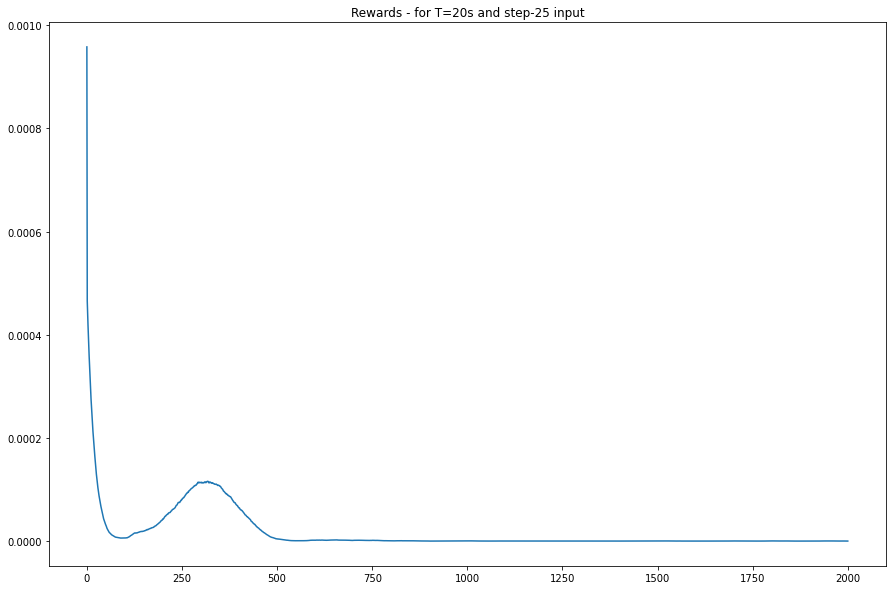

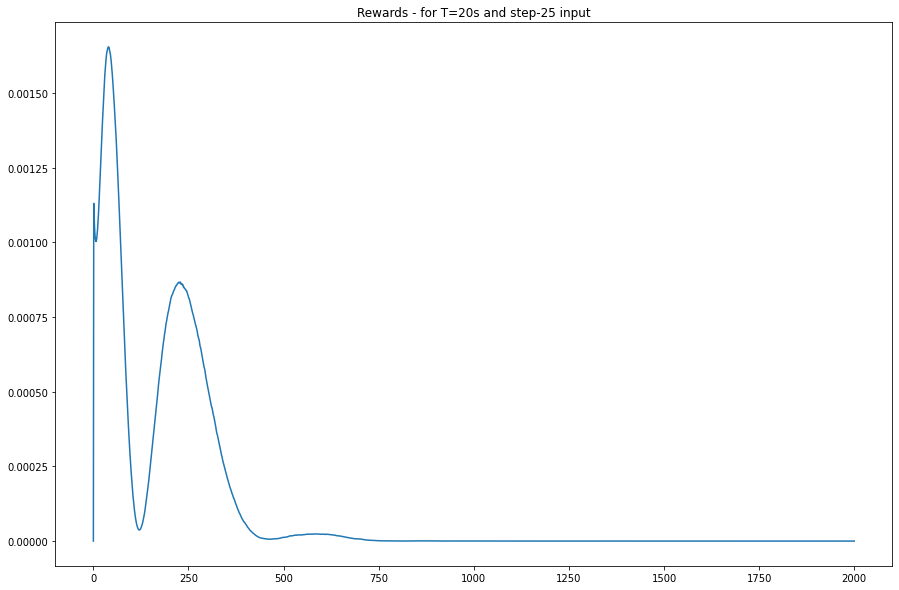

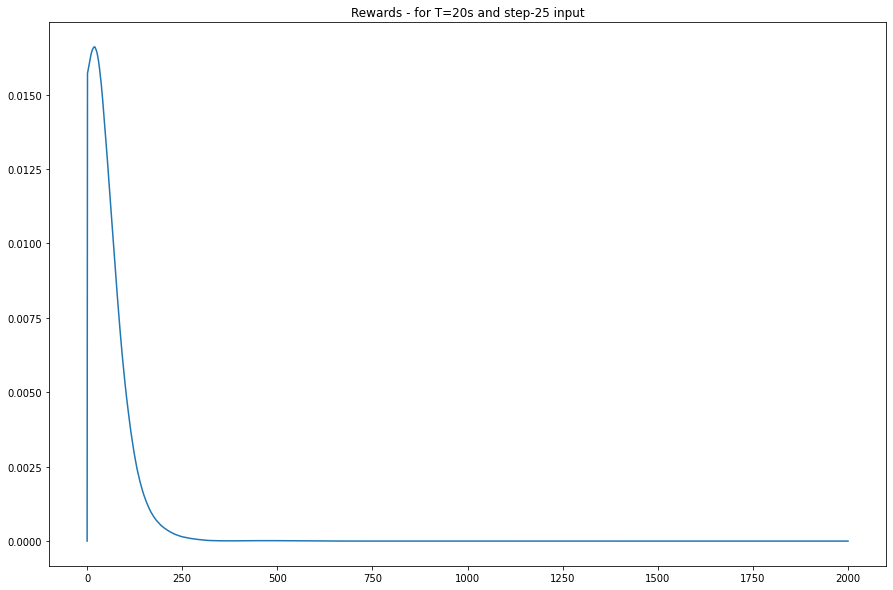

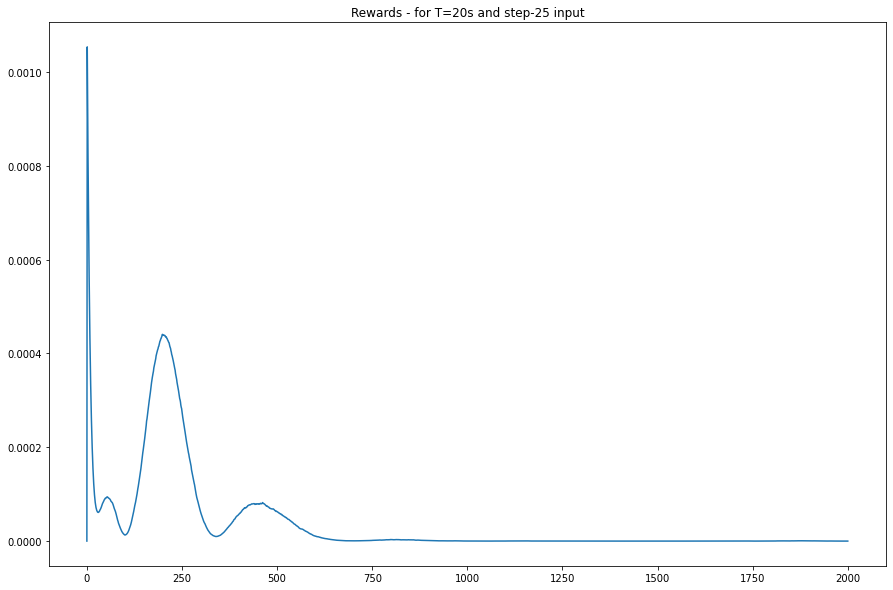

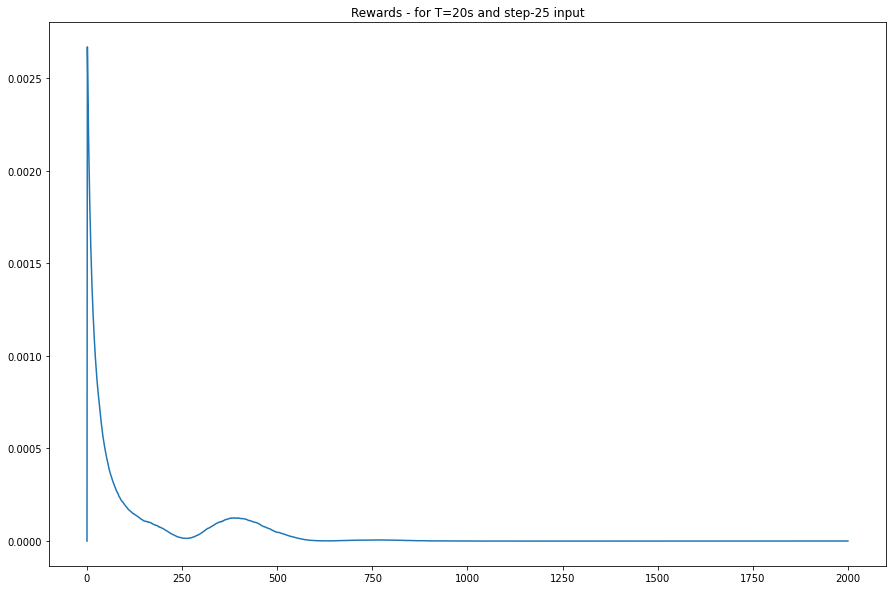

...

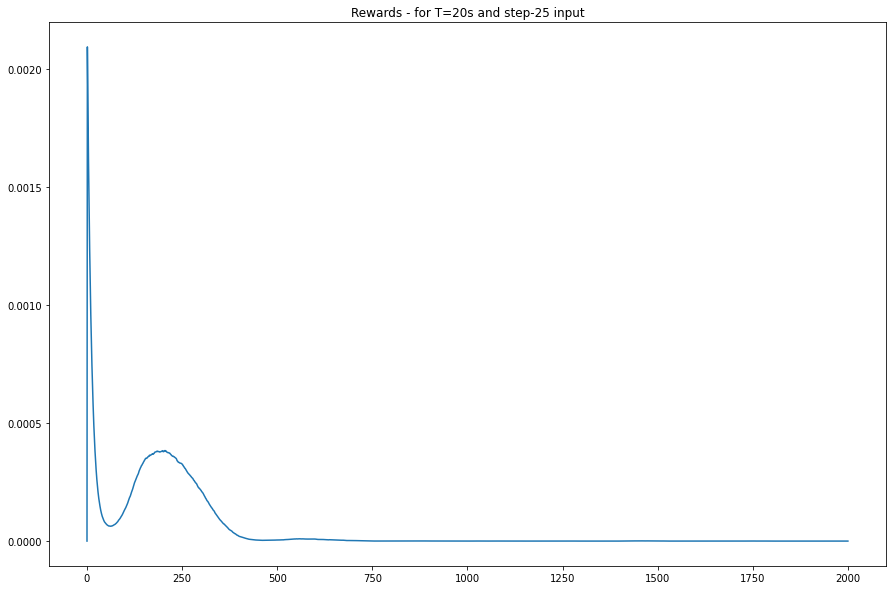

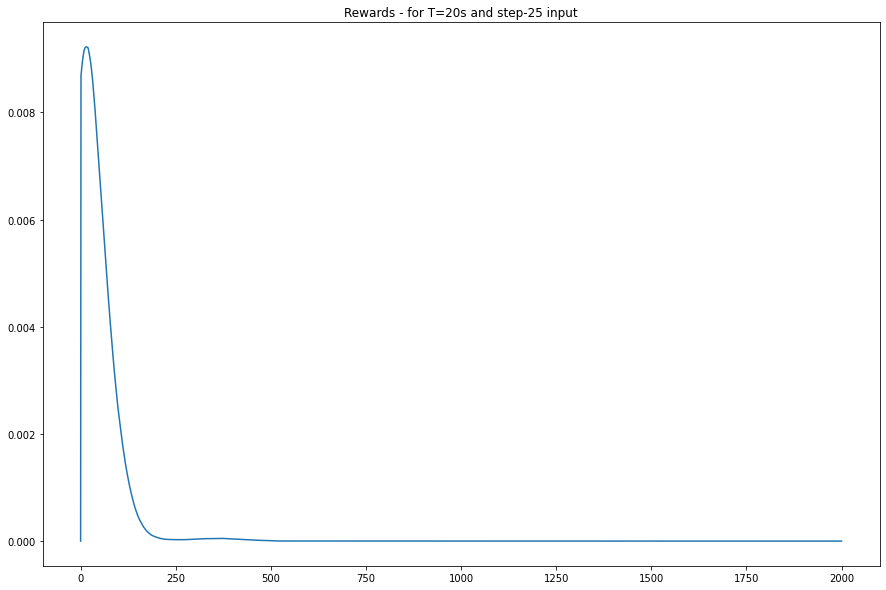

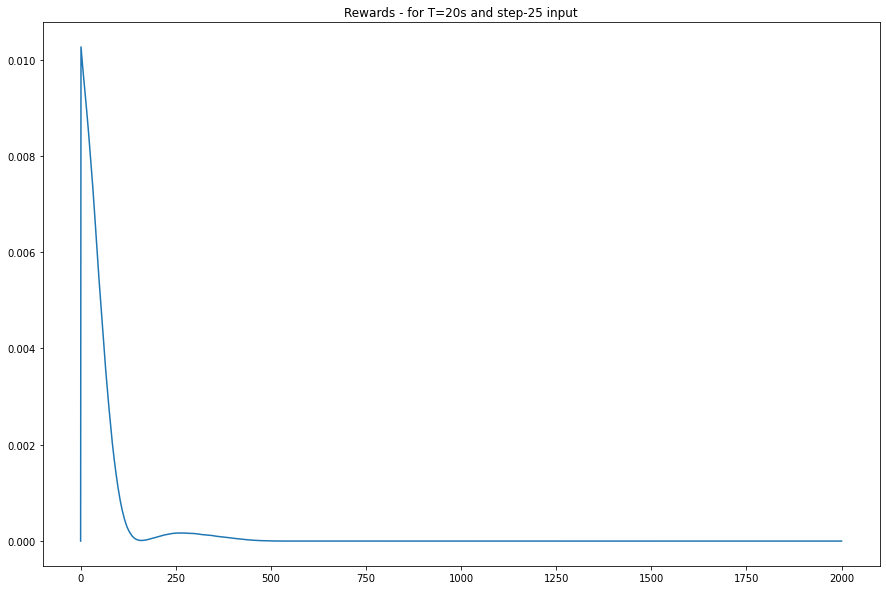

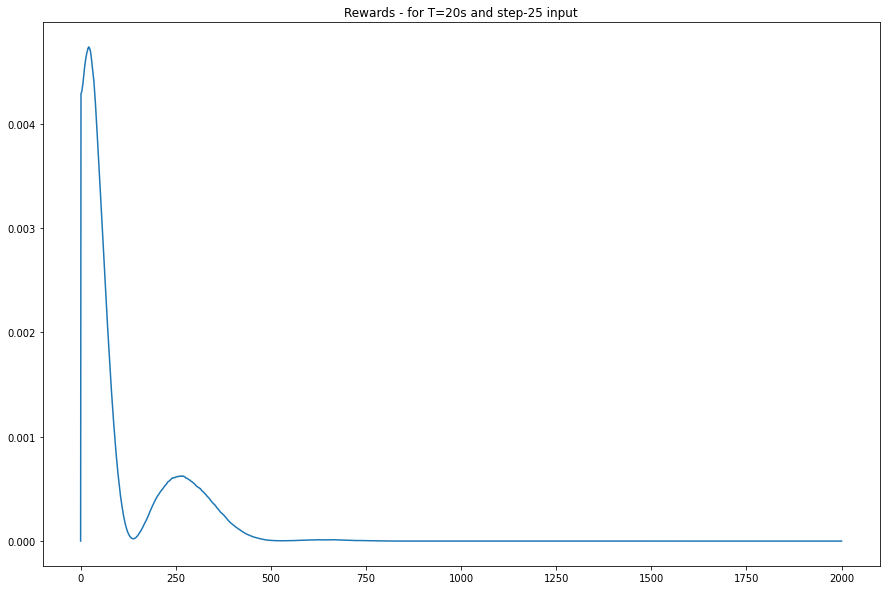

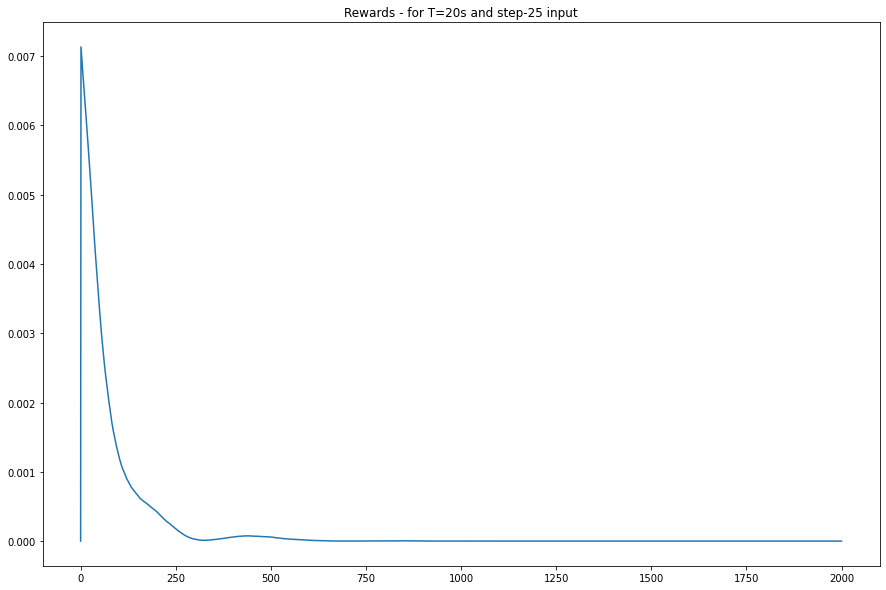

In [ ]:
total_reward = 0

for init_num in range(20): 
  plt.figure(figsize=(15,10))
  plt.title("Rewards - for T=20s and step-25 input")
  plt.plot( all_init_state_ep_rewards[init_num]) ; 
  print("Mean Cost = ", sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])) ;
  total_reward += sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])

print("Average cost over all runs = ", total_reward/20)

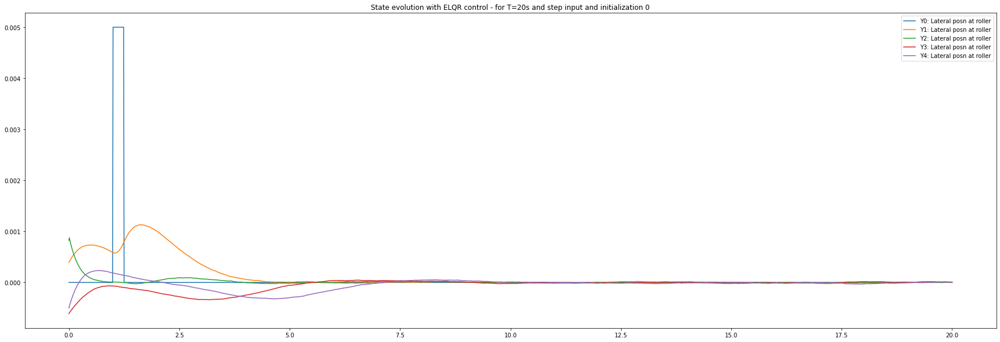

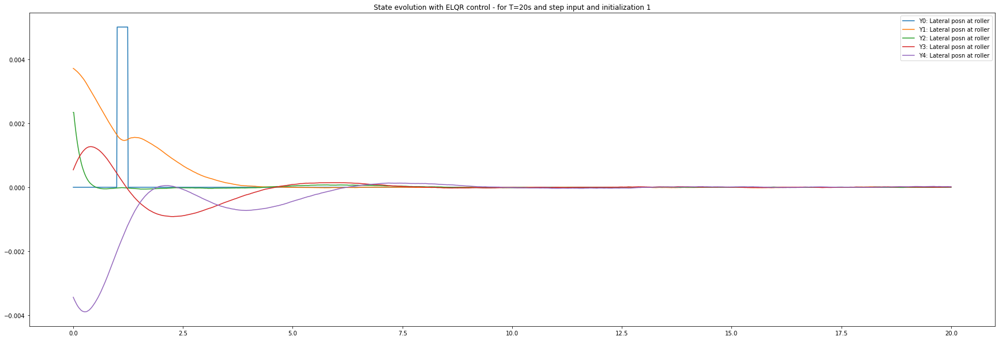

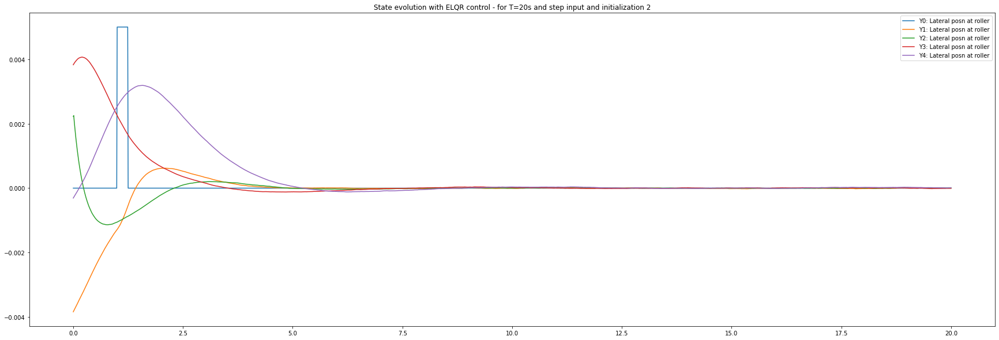

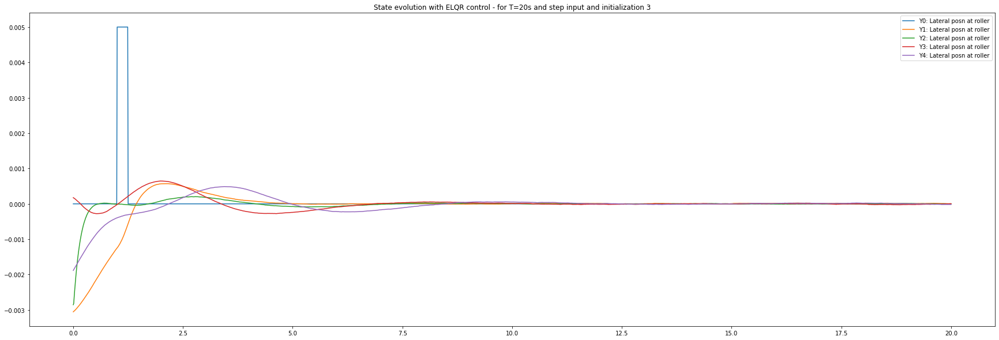

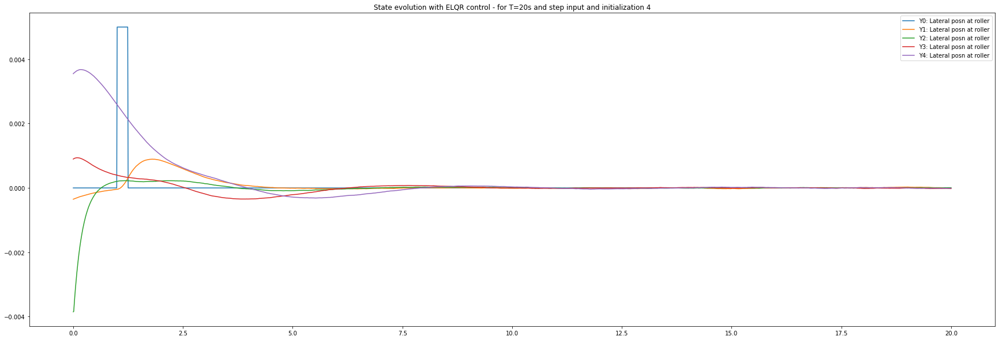

...

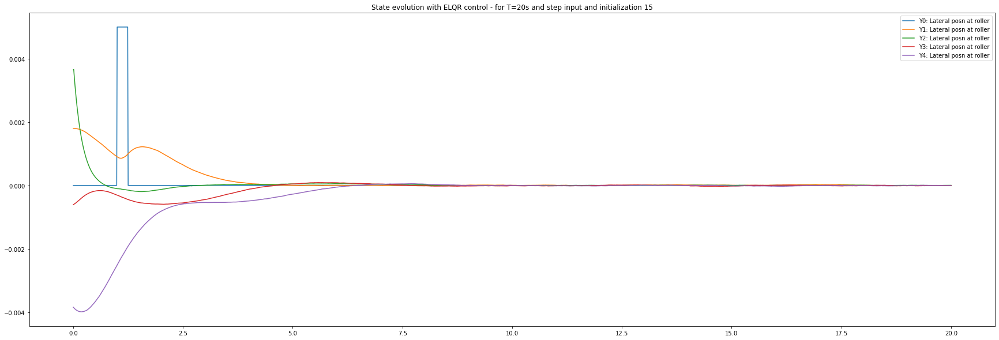

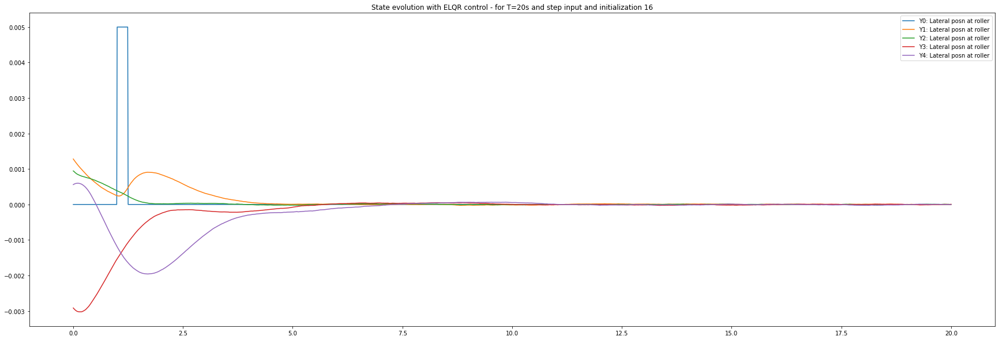

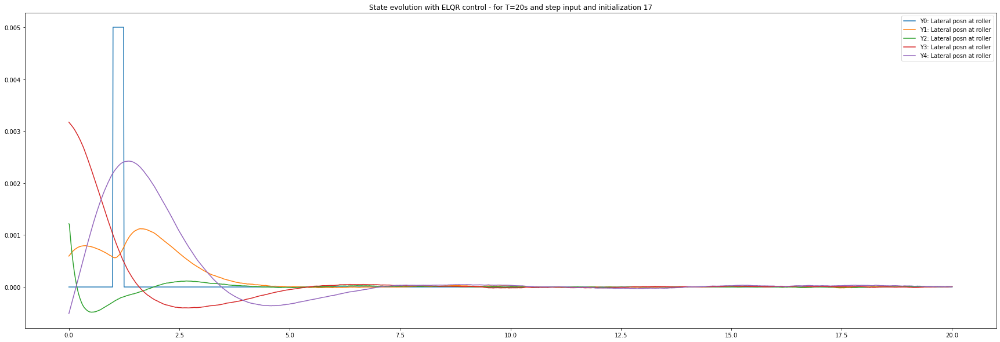

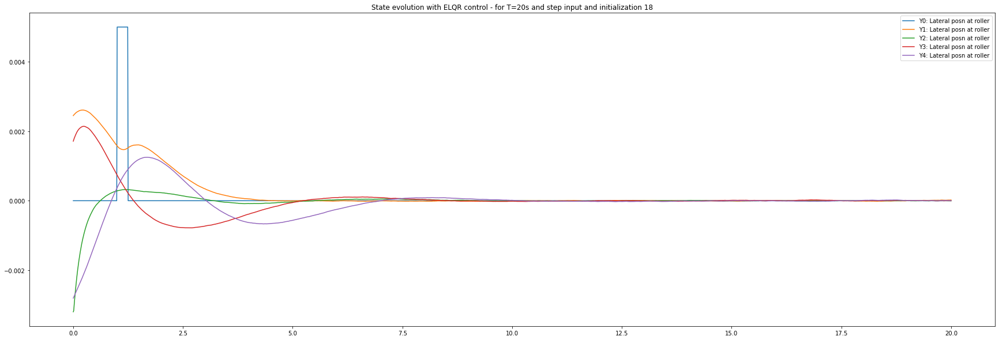

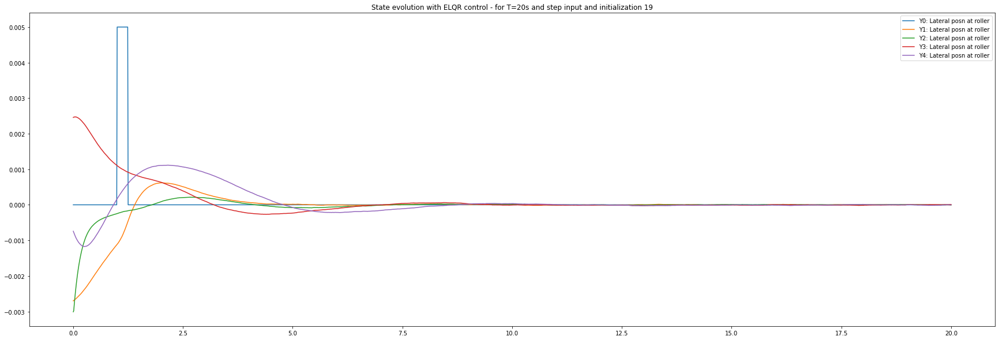

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution with ELQR control - for T=20s and step input and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w1, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

## ELQR for step - 50

In [ ]:
## Simulate system withELQR control
## if it works

Q = np.identity(10) ; 
Q[2,2] = 100 ; 
Q[4,4] = 1000

# Q[0,0] = 0 ; 
# Q[1,1] = 0 ; 
# Q[2,2] = 0 ; 
# Q[3,3] = 0 ; 
# Q[5,5] = 0 ; 
# Q[7,7] = 0 ; 
# Q[8,8] = 0 ; 
# Q[9,9] = 0 ; 

R = np.identity(1) ;


#env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1))
env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1), reset_type='random')
K,G = gen_ELQR_mats(A=A_nom, B=B_nom, F=F_nom, env=env)

#t_range = np.linspace(0,20,2001) 

t_range = np.linspace(0,20,2001) 

#w1 = 0.02*0.25*np.sin(2*t_range) ; 

## Square wave disturbance
w_step = np.zeros(t_range.shape)
w_step[100:150] = 0.02*0.25

w1 = w_step

all_init_state_evols = {}
all_init_state_ep_rewards = {}

for init_num in range(20): 
  env.reset(init_states[:,init_num][:,None])
  state_evolution = env.state ; 

  #actions_evol = [] ; 

  ep_rewards = [] ;

  for t_step in range(t_range.shape[0]):     
  #for t_step in range(1):   
      t = t_range[t_step]
      #print("time = ", t)

      meas_dist = np.atleast_2d(np.array([w1[t_step] , 0])).T
      ut = -(K@state + G@meas_dist)

      action = np.atleast_2d(ut).astype(np.float32) ; 

      #actions_evol.append(ut[0][0])
      ep_rewards.append((state.T@Q@state + ut.T@R@ut)[0][0])


      state, obs , cost, _, _ = env.step(action=action, meas_dist=np.atleast_2d(np.array([w1[t_step] , 0])).T, t_step=t_step)
      #total_costs += cost * gamma**(t)

      state_evolution = np.concatenate((state_evolution, state), axis=1)
  all_init_state_evols[init_num] = state_evolution 
  all_init_state_ep_rewards[init_num] = ep_rewards

Mean Cost =  2.8999278119193353e-05
Mean Cost =  0.00013769698102016956
Mean Cost =  0.0007323453865909419
Mean Cost =  4.958646236496122e-05
Mean Cost =  6.93119552853724e-05
Mean Cost =  0.00017465605053632347
Mean Cost =  0.00035808069296895857
Mean Cost =  0.0004073577527338141
Mean Cost =  0.00022431150608418572
Mean Cost =  0.00030821336049801534
Mean Cost =  4.1896721667166814e-05
Mean Cost =  0.0002742011334513054
Mean Cost =  6.536325241110928e-05
Mean Cost =  9.168033223398716e-05
Mean Cost =  0.00036295705724430046
Mean Cost =  6.0695653156608905e-05
Mean Cost =  0.000374493740350441
Mean Cost =  0.00030421568574912305
Mean Cost =  0.00023344287548554373
Mean Cost =  0.00024604404542046443
Average cost over all runs =  0.00022727749616859933


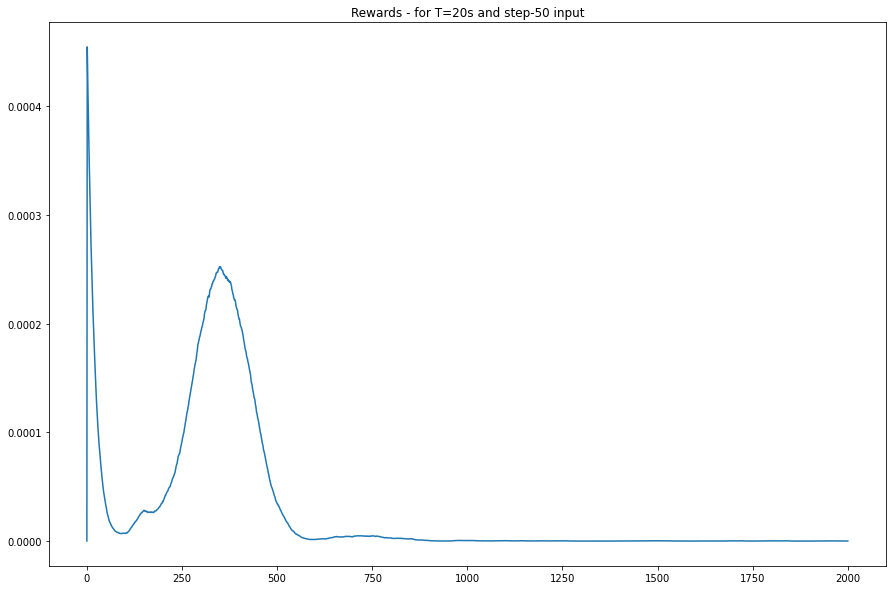

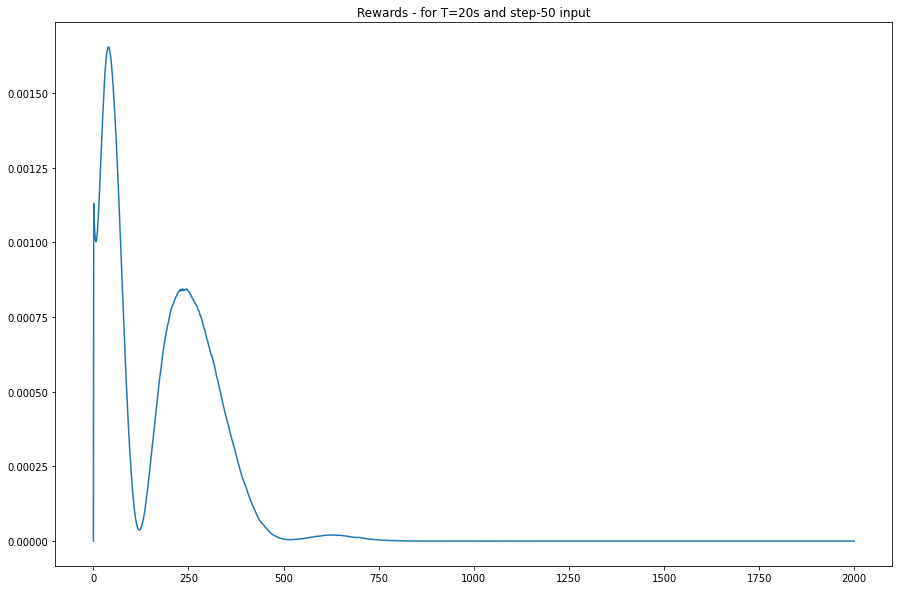

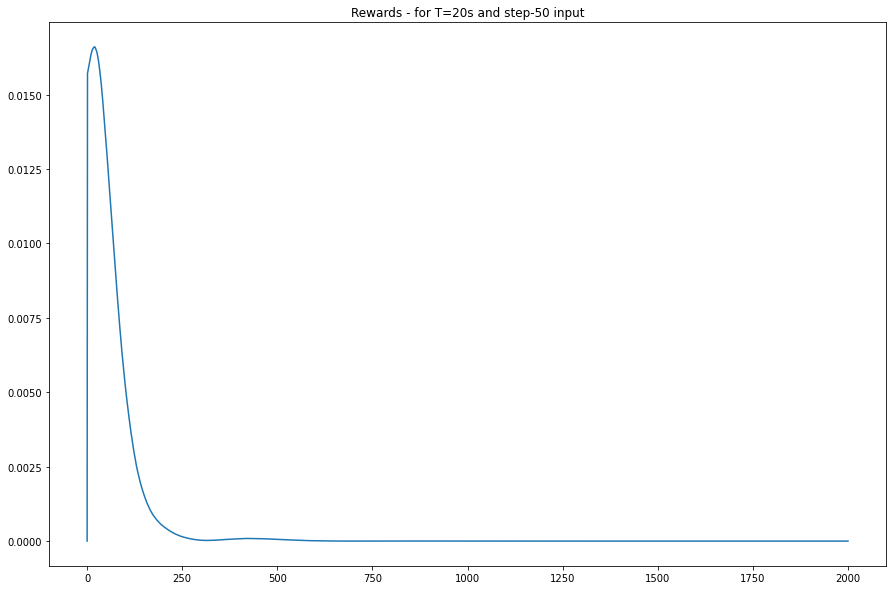

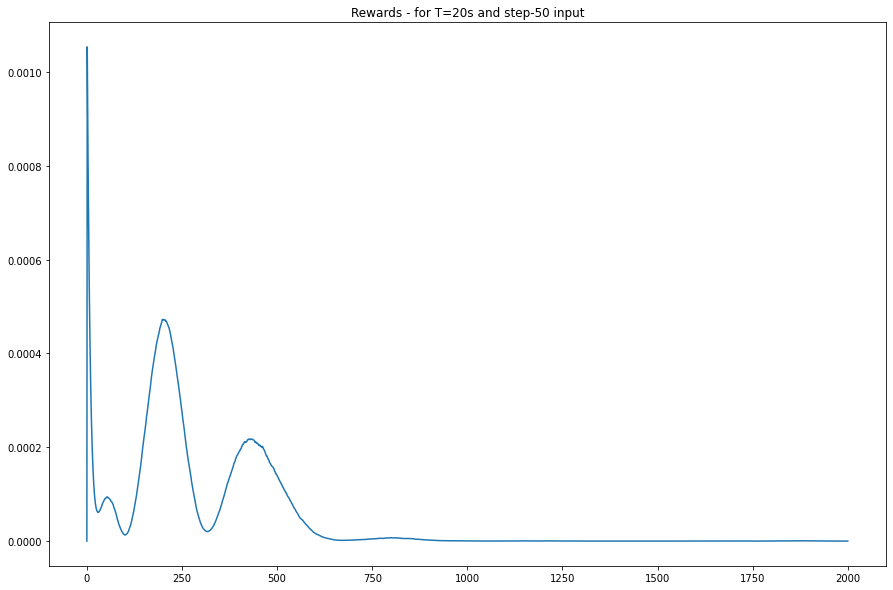

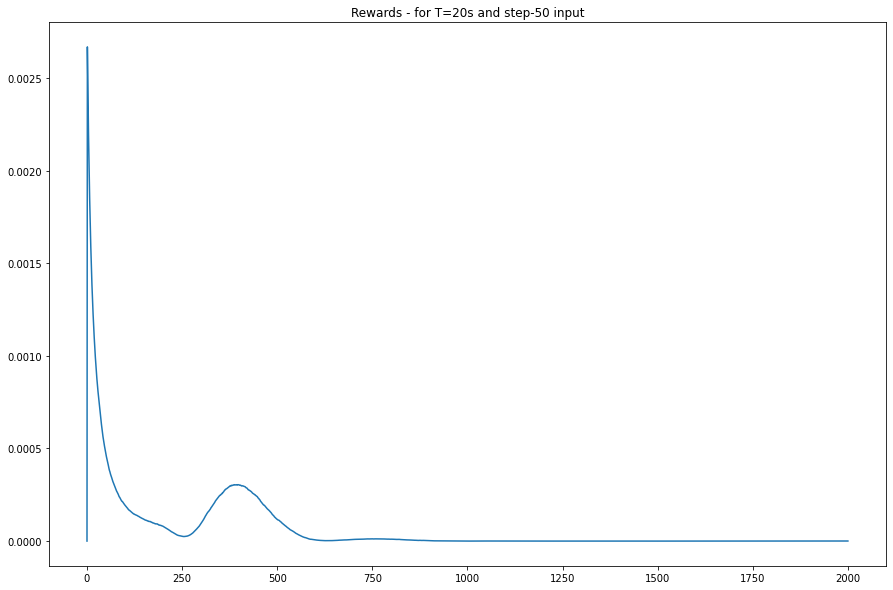

...

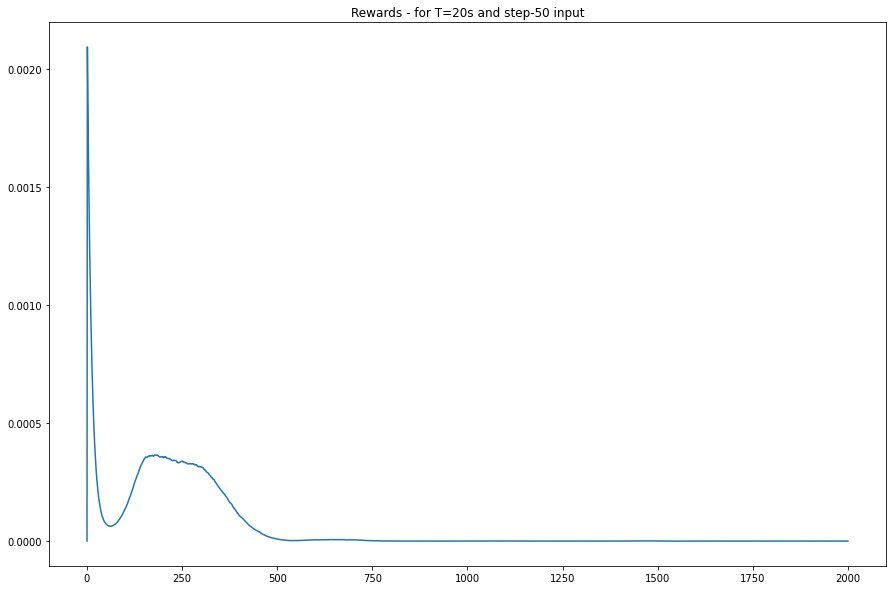

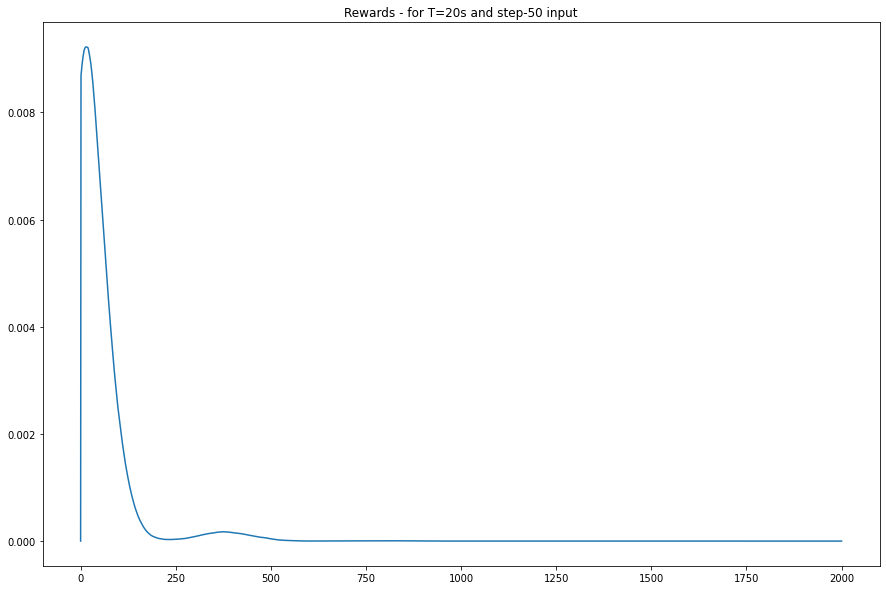

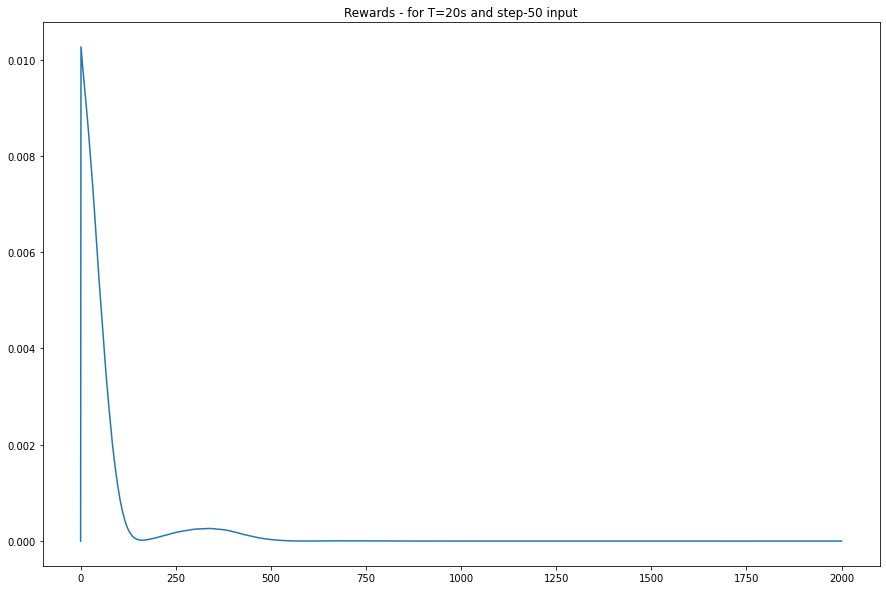

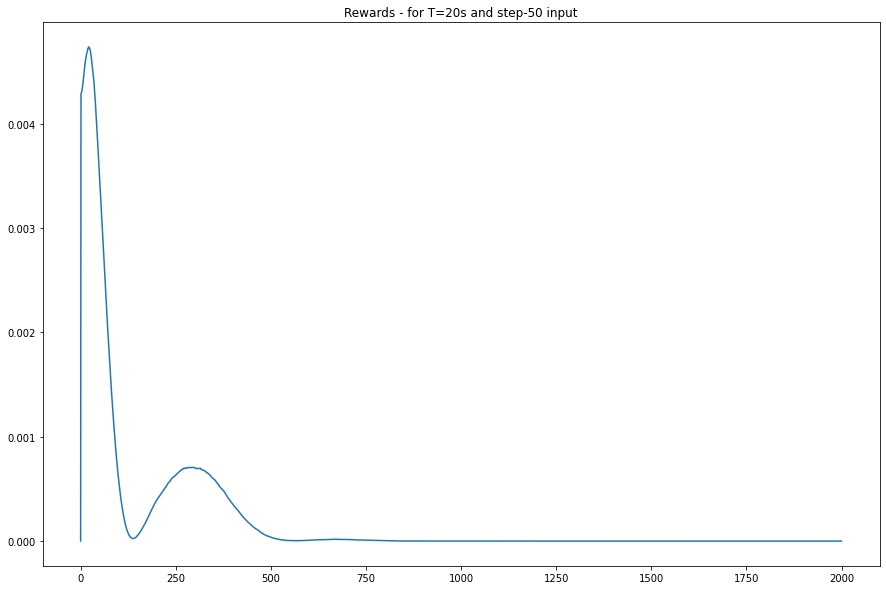

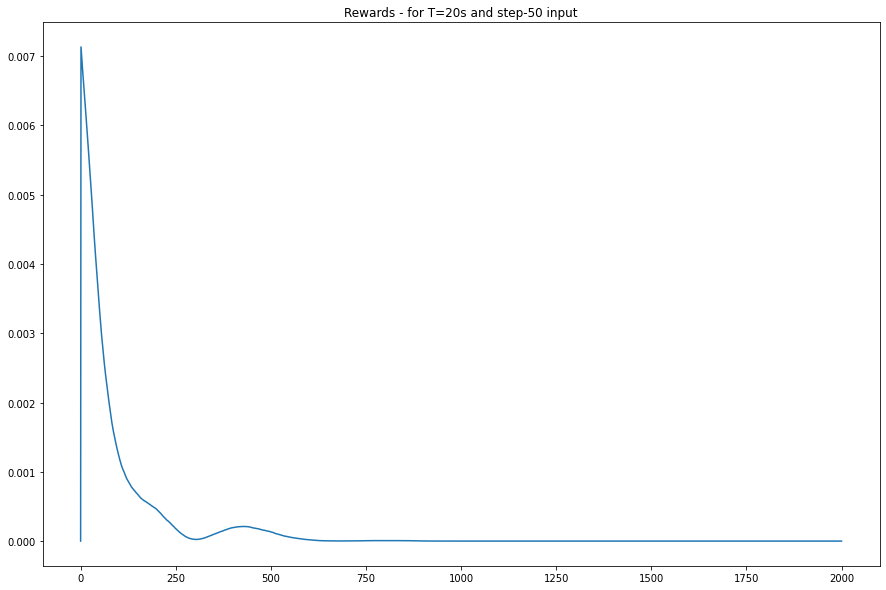

In [ ]:
total_reward = 0

for init_num in range(20): 
  plt.figure(figsize=(15,10))
  plt.title("Rewards - for T=20s and step-50 input")
  plt.plot( all_init_state_ep_rewards[init_num]) ; 
  print("Mean Cost = ", sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])) ;
  total_reward += sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])

print("Average cost over all runs = ", total_reward/20)

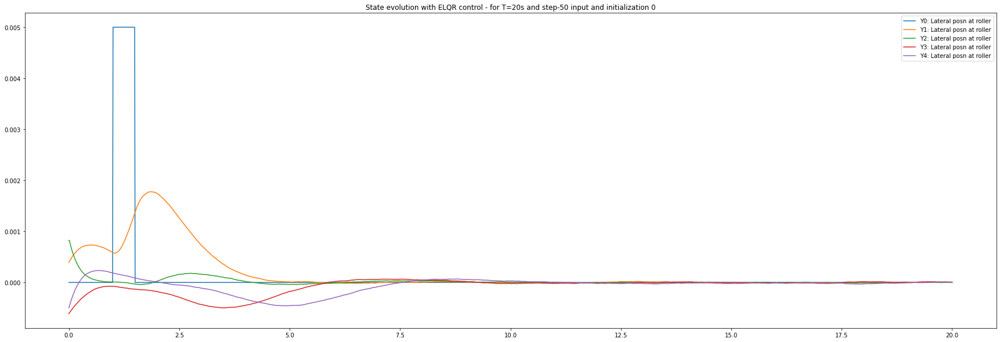

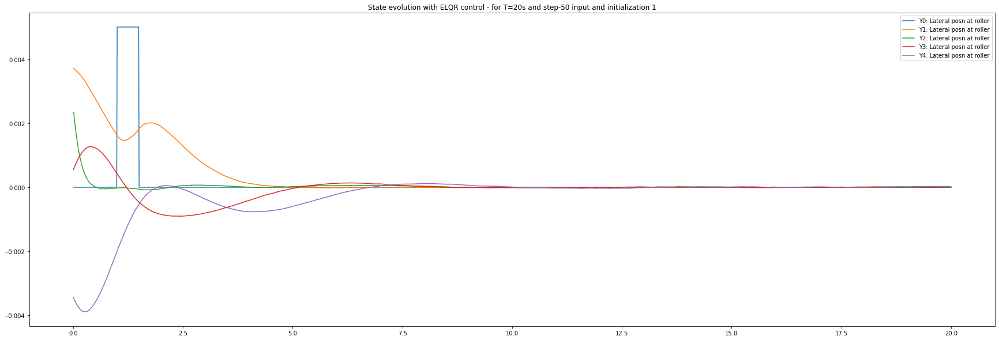

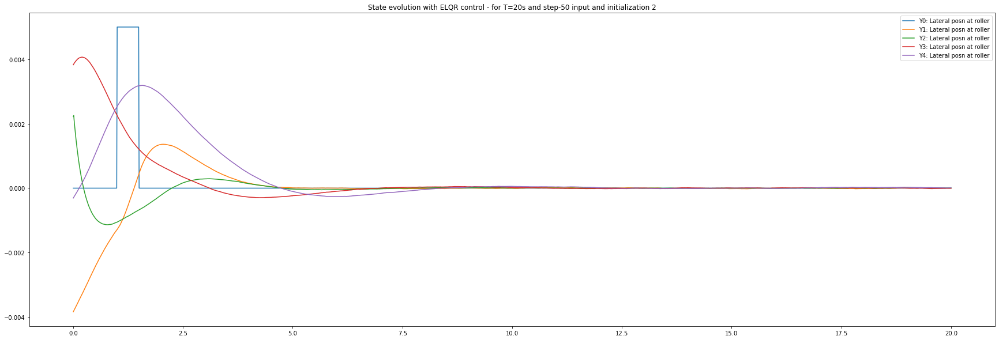

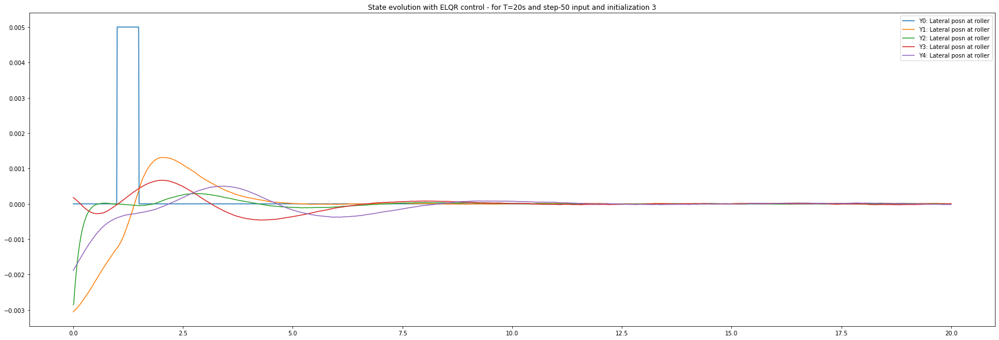

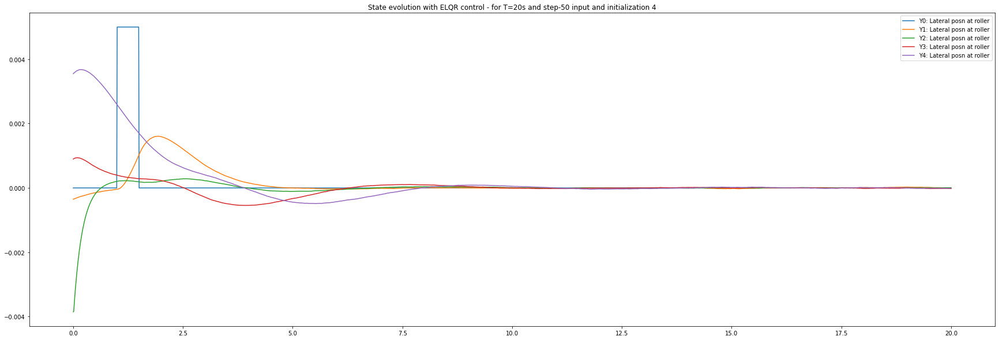

...

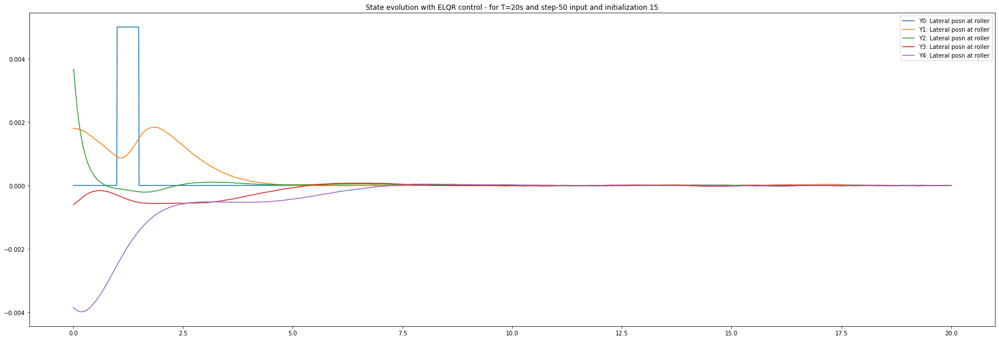

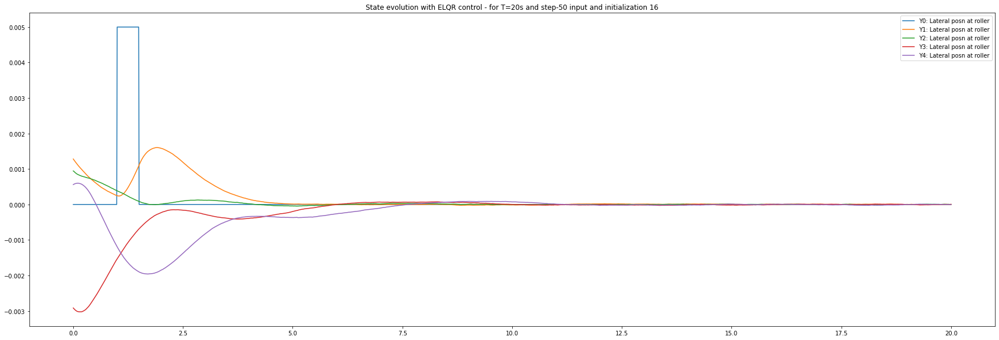

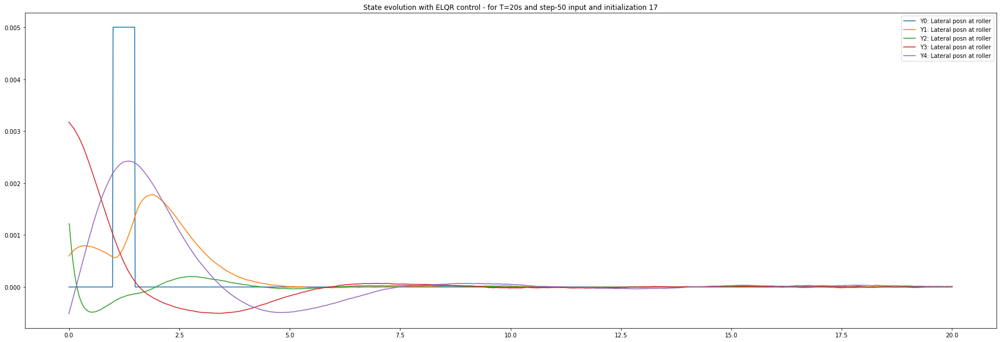

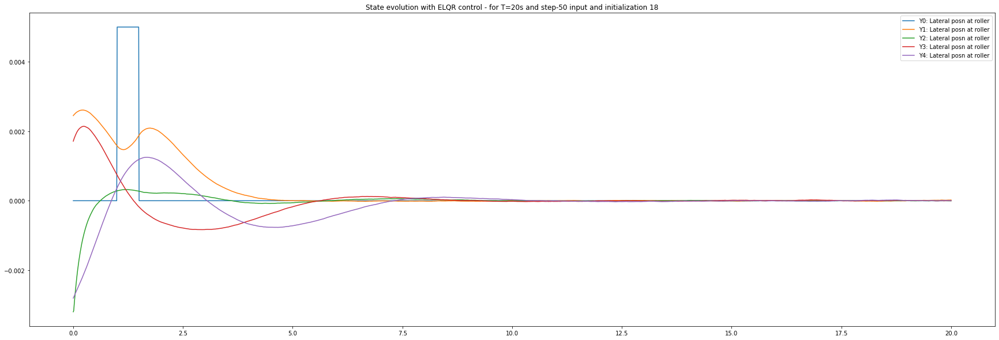

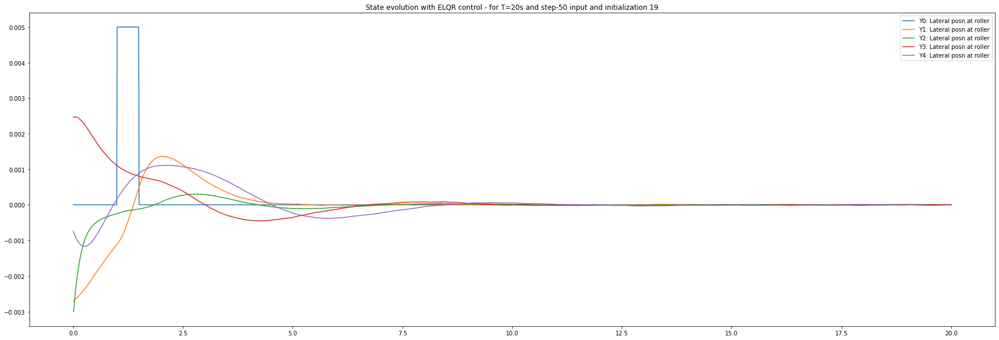

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution with ELQR control - for T=20s and step-50 input and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w1, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

## Step - 100 with ELQR control

In [ ]:
## Simulate system withELQR control
## if it works

Q = np.identity(10) ; 
Q[2,2] = 100 ; 
Q[4,4] = 1000

# Q[0,0] = 0 ; 
# Q[1,1] = 0 ; 
# Q[2,2] = 0 ; 
# Q[3,3] = 0 ; 
# Q[5,5] = 0 ; 
# Q[7,7] = 0 ; 
# Q[8,8] = 0 ; 
# Q[9,9] = 0 ; 

R = np.identity(1) ;


#env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1))
env = LQEnv_flat_rollers_full_state_info(A_mats=A_mats, B_mats=B_mats, F_mats=F_mats, C=np.identity(10), sigma_w=1e-6 , sigma_v=1e-6, Q=Q, R=np.identity(1), reset_type='random')
K,G = gen_ELQR_mats(A=A_nom, B=B_nom, F=F_nom, env=env)

#t_range = np.linspace(0,20,2001) 

t_range = np.linspace(0,20,2001) 

#w1 = 0.02*0.25*np.sin(1.5*t_range) ; 

## Square wave disturbance
w_step = np.zeros(t_range.shape)
w_step[100:200] = 0.02*0.25

w1 = w_step

all_init_state_evols = {}
all_init_state_ep_rewards = {}

for init_num in range(20): 
  env.reset(init_states[:,init_num][:,None])
  state_evolution = env.state ; 

  #actions_evol = [] ; 

  ep_rewards = [] ;

  for t_step in range(t_range.shape[0]):     
  #for t_step in range(1):   
      t = t_range[t_step]
      #print("time = ", t)

      meas_dist = np.atleast_2d(np.array([w1[t_step] , 0])).T
      ut = -(K@state + G@meas_dist)

      action = np.atleast_2d(ut).astype(np.float32) ; 

      #actions_evol.append(ut[0][0])
      ep_rewards.append((state.T@Q@state + ut.T@R@ut)[0][0])


      state, obs , cost, _, _ = env.step(action=action, meas_dist=np.atleast_2d(np.array([w1[t_step] , 0])).T, t_step=t_step)
      #total_costs += cost * gamma**(t)

      state_evolution = np.concatenate((state_evolution, state), axis=1)
  all_init_state_evols[init_num] = state_evolution 
  all_init_state_ep_rewards[init_num] = ep_rewards

Mean Cost =  7.596832812427444e-05
Mean Cost =  0.0001764266173796771
Mean Cost =  0.0007743440758104546
Mean Cost =  0.00010307720926241591
Mean Cost =  0.00012743447283145384
Mean Cost =  0.00022070815188285548
Mean Cost =  0.0004016789122753632
Mean Cost =  0.0004548235036831648
Mean Cost =  0.0002679838688721119
Mean Cost =  0.00035458420781925363
Mean Cost =  9.624730775765523e-05
Mean Cost =  0.0003299547191114509
Mean Cost =  0.00010522413628002934
Mean Cost =  0.00013901798845169432
Mean Cost =  0.0004026731986812166
Mean Cost =  9.69821213541095e-05
Mean Cost =  0.0004191097745391047
Mean Cost =  0.00035031644481369633
Mean Cost =  0.0002865766896179625
Mean Cost =  0.0002998432149837414
Average cost over all runs =  0.00027414874717658427


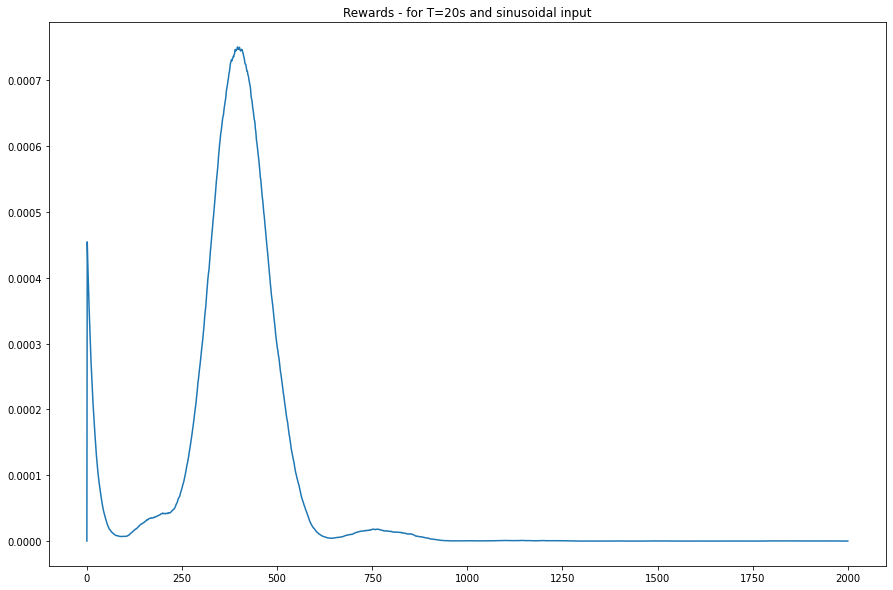

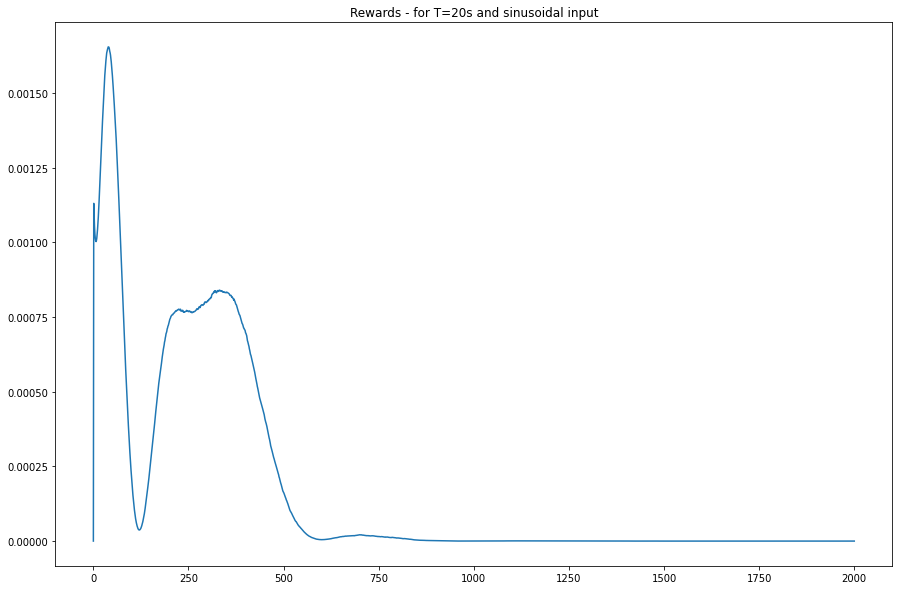

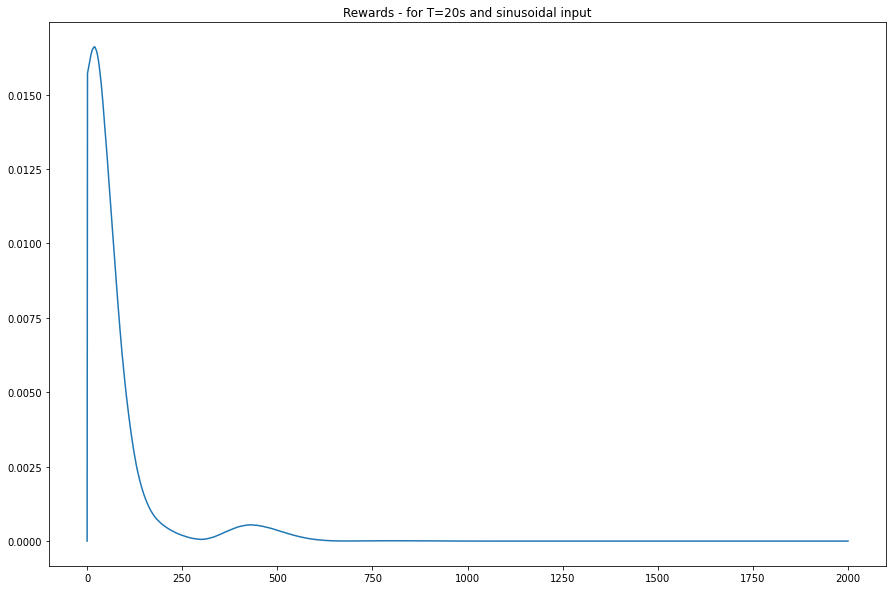

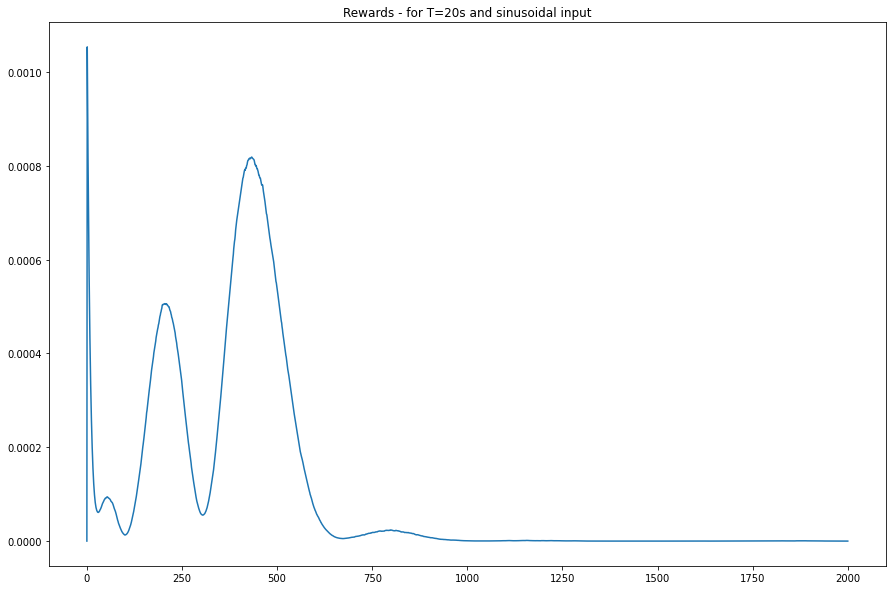

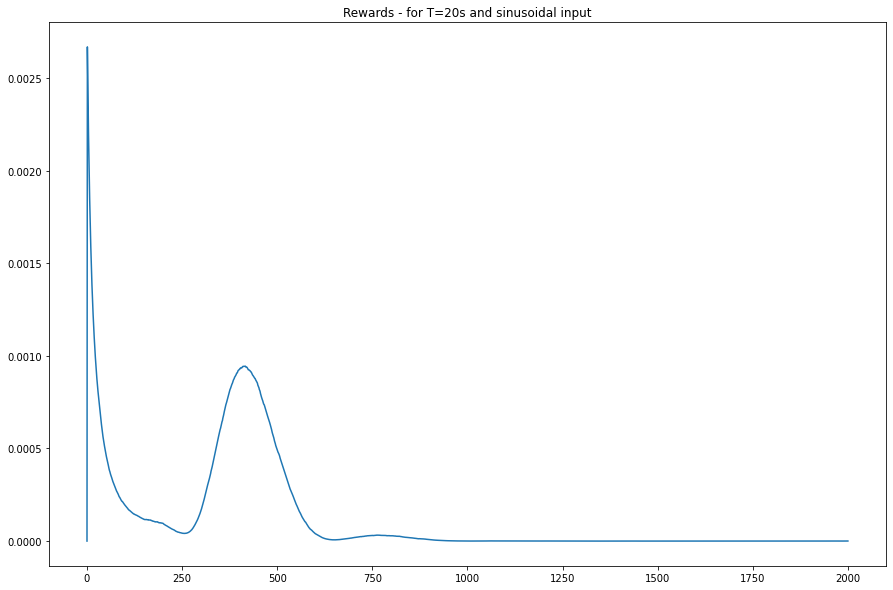

...

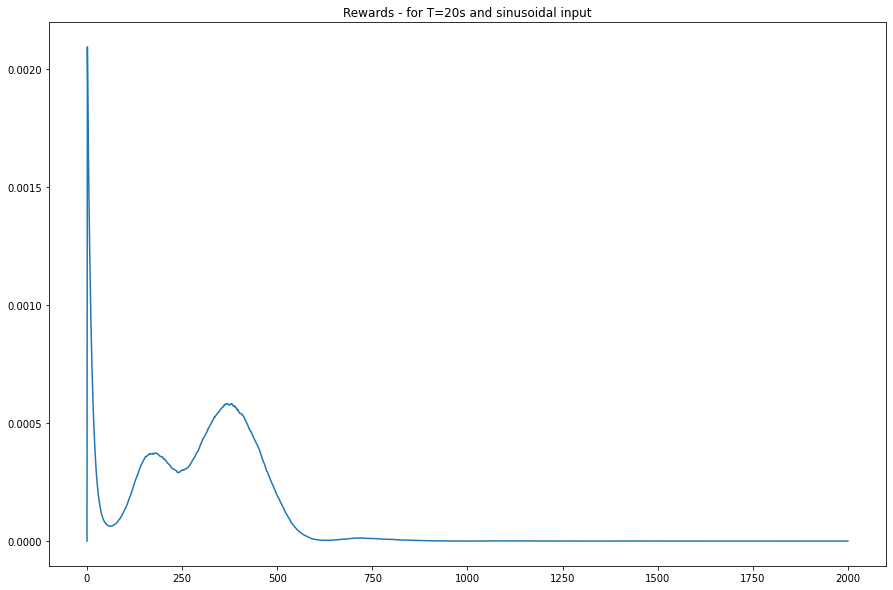

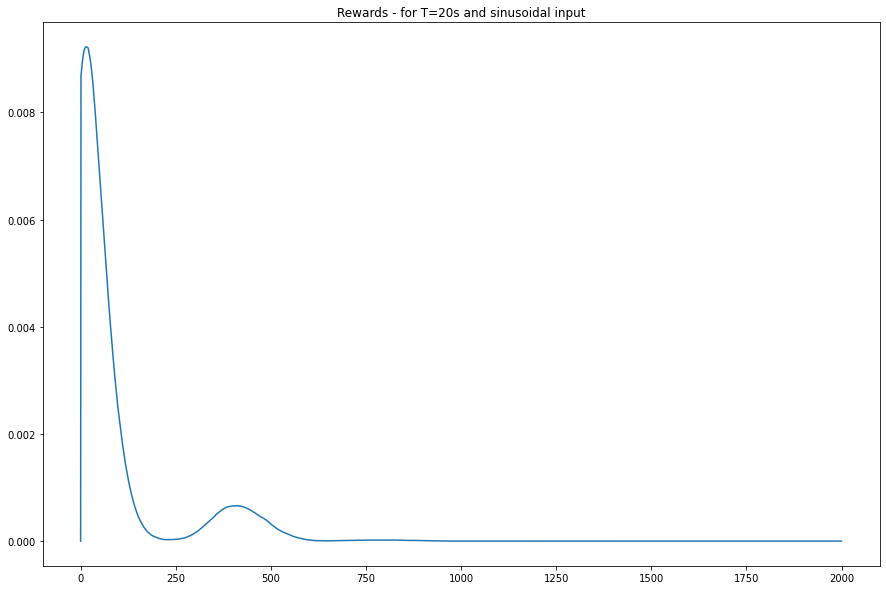

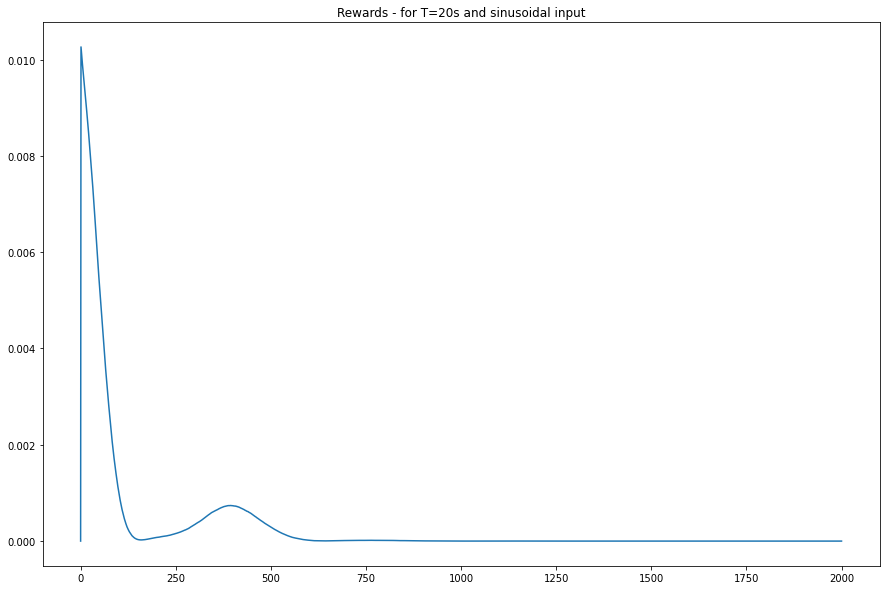

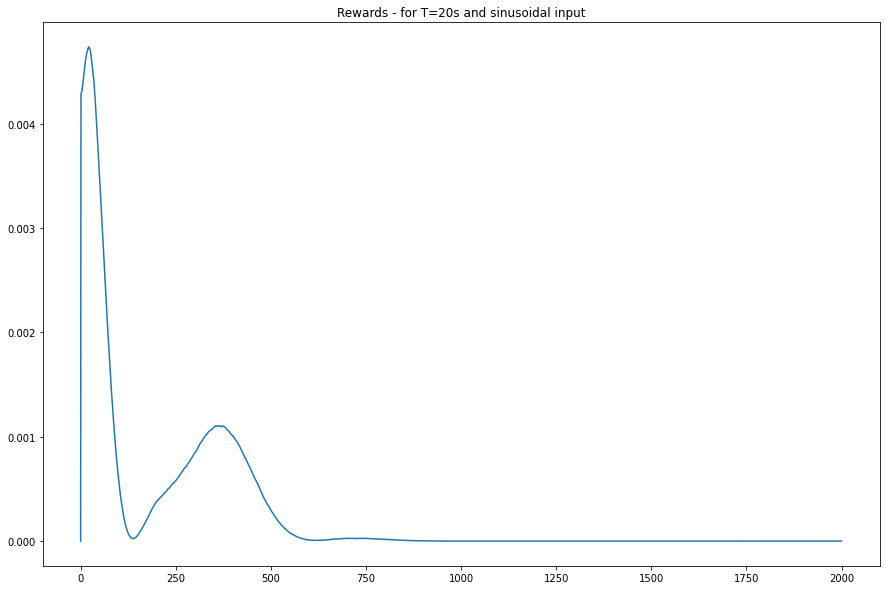

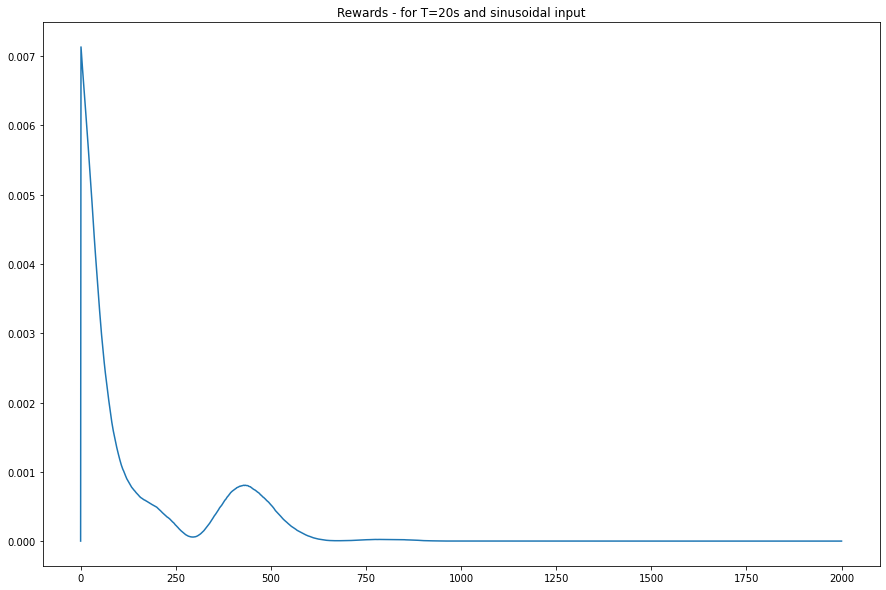

In [ ]:
total_reward = 0

for init_num in range(20): 
  plt.figure(figsize=(15,10))
  plt.title("Rewards - for T=20s and sinusoidal input")
  plt.plot( all_init_state_ep_rewards[init_num]) ; 
  print("Mean Cost = ", sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])) ;
  total_reward += sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])

print("Average cost over all runs = ", total_reward/20)

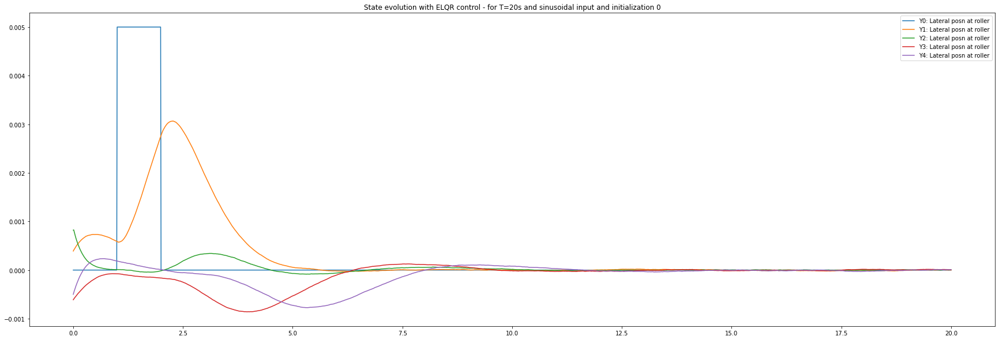

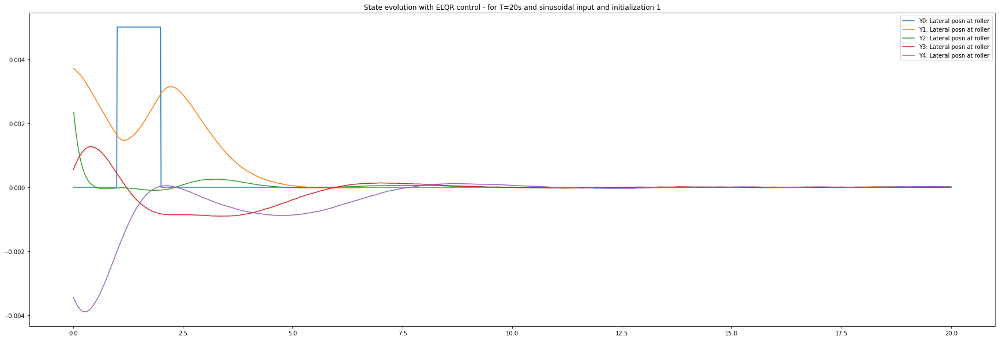

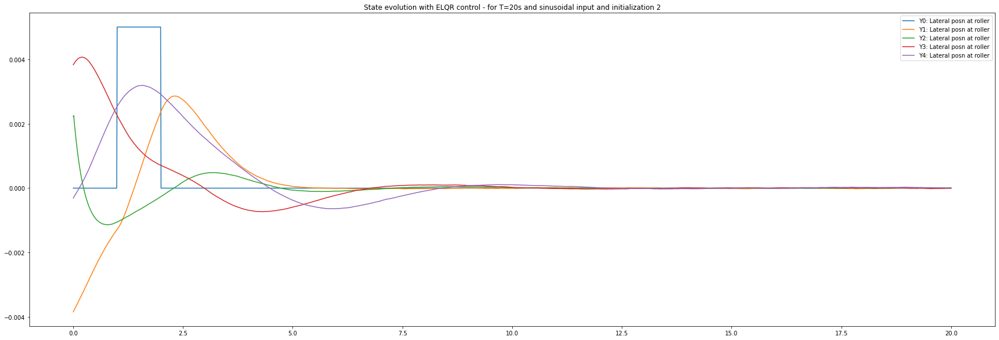

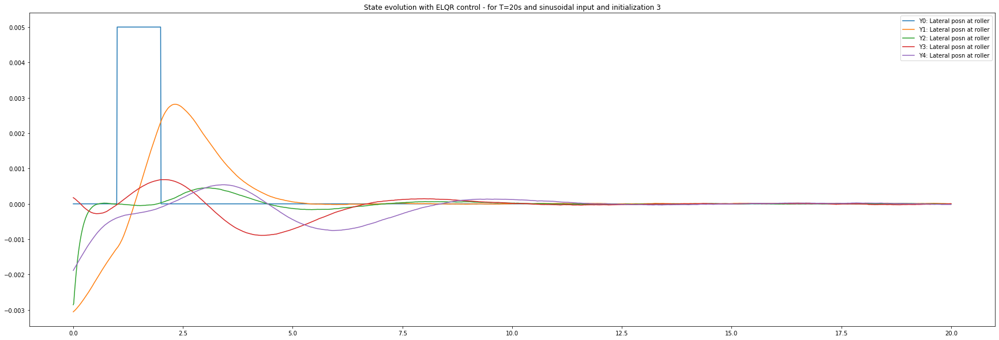

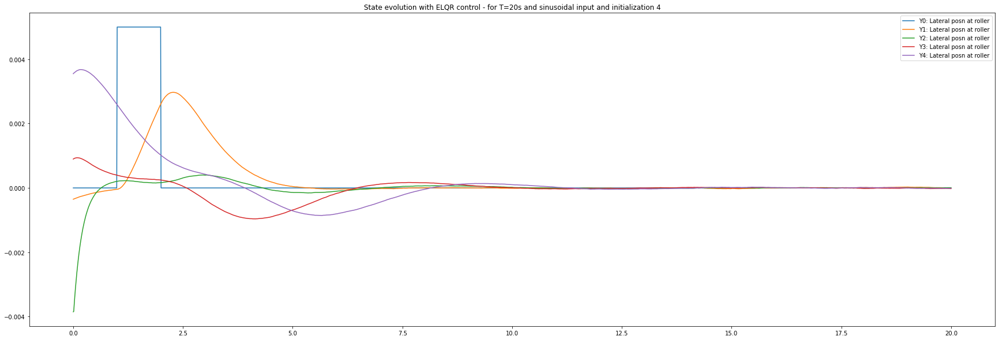

...

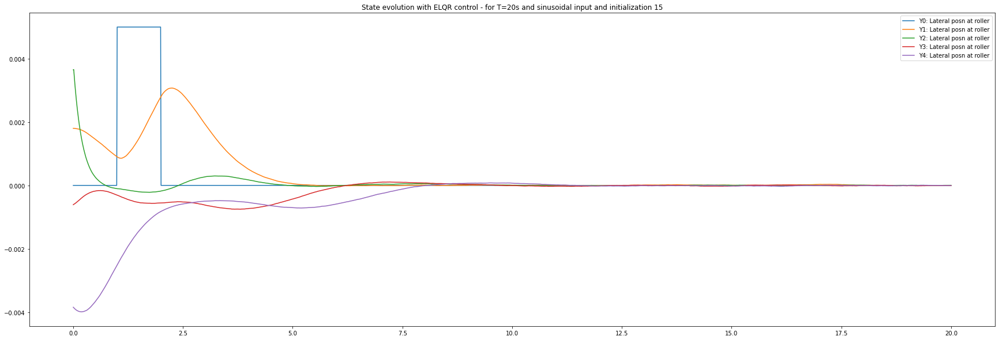

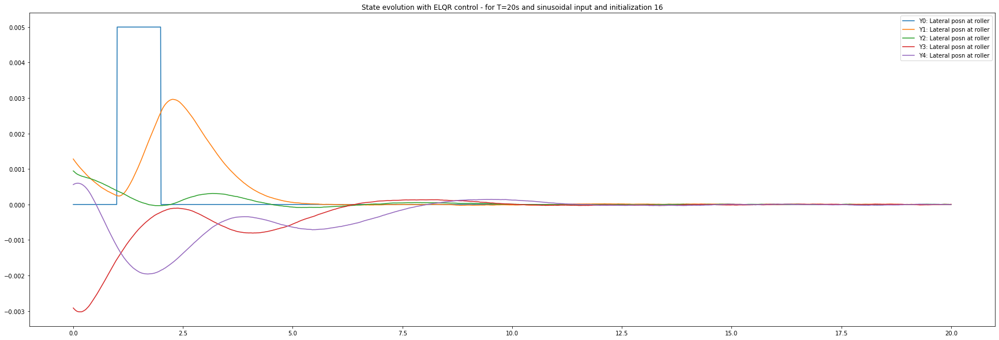

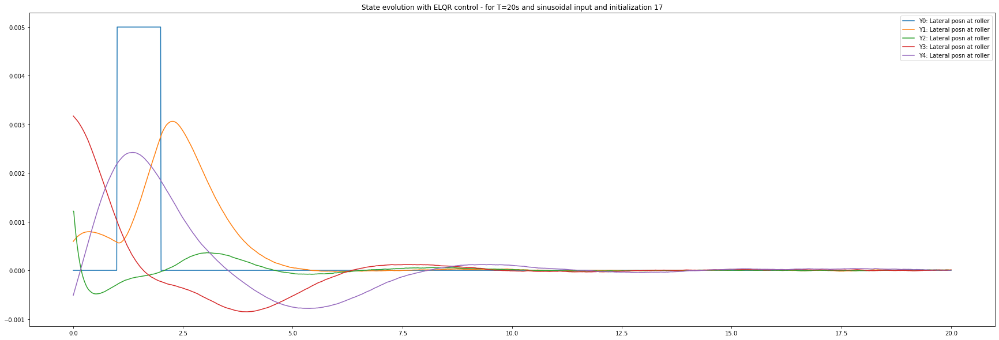

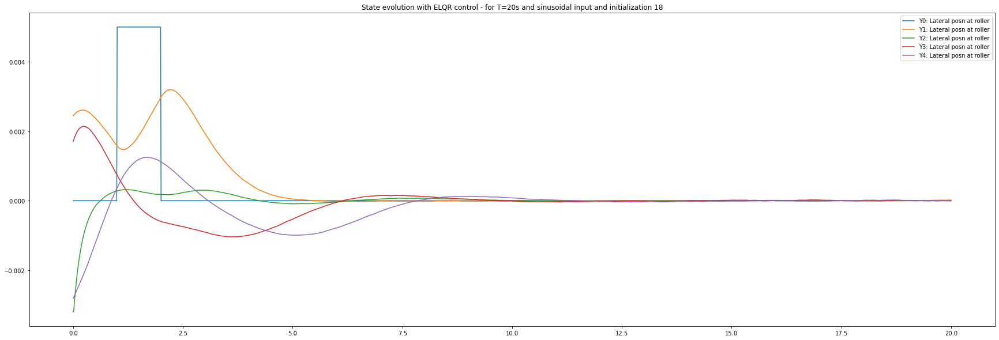

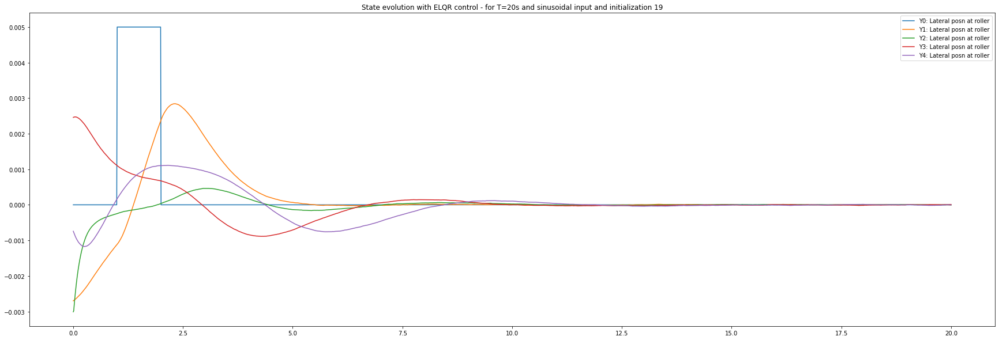

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution with ELQR control - for T=20s and sinusoidal input and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w1, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

## step-25 with DDPG - Sinusoid model

In [ ]:
model_path = './model/ddpg_rand_init_sin_2_0x'

test_episodes = 1
max_steps=2001
alg.load_model(model_path)
t_range = np.linspace(0,(max_steps-1)/100,max_steps)
#w_sin = 0.02*0.25*np.sin(t_range)

## Square wave disturbance
## Square wave disturbance
w_step = np.zeros(t_range.shape)
w_step[100:125] = 0.02*0.25

w = w_step

#w = w_sin

all_init_state_evols = {}
all_init_state_ep_rewards = {}

for init_num in range (20):
    print("Currently working on init num = ", init_num)
    q_loss_list=[]
    policy_loss_list=[]
    ep_rewards = [] ;
    #state = env.reset()
    state = np.concatenate((env.C@(env.reset(init_states[:,init_num][:,None])), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]        

    states_evolution = state[:,None]

    episode_reward = 0

    for step in tqdm(range(max_steps)):
        action = alg.policy_net.get_action(state, noise_scale=0.0)  # no noise for testing

        # action = action/400

        # next_state, reward, done, _ = env.step(action)

        true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
        next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
        reward = -cost  

        ep_rewards.append(cost)
        
        state = next_state

        states_evolution = np.concatenate((states_evolution, state[:,None]), axis=1)

        episode_reward += reward

    all_init_state_evols[init_num] = states_evolution 
    all_init_state_ep_rewards[init_num] = ep_rewards    
        
        # if done:
        #     break
#rewards

Currently working on init num =  0


  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.8/dist-packages/torch/nn/functional.py:1956: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
100%|██████████| 2001/2001 [00:17<00:00, 114.74it/s]


Currently working on init num =  1


100%|██████████| 2001/2001 [00:15<00:00, 127.93it/s]


Currently working on init num =  2


100%|██████████| 2001/2001 [00:15<00:00, 131.08it/s]


Currently working on init num =  3


100%|██████████| 2001/2001 [00:16<00:00, 122.47it/s]


Currently working on init num =  4


100%|██████████| 2001/2001 [00:15<00:00, 132.98it/s]


Currently working on init num =  5


100%|██████████| 2001/2001 [00:17<00:00, 111.29it/s]


Currently working on init num =  6


100%|██████████| 2001/2001 [00:17<00:00, 116.43it/s]


Currently working on init num =  7


100%|██████████| 2001/2001 [00:17<00:00, 117.54it/s]


Currently working on init num =  8


100%|██████████| 2001/2001 [00:21<00:00, 92.12it/s] 


Currently working on init num =  9


100%|██████████| 2001/2001 [00:17<00:00, 111.78it/s]


Currently working on init num =  10


100%|██████████| 2001/2001 [00:16<00:00, 118.96it/s]


Currently working on init num =  11


100%|██████████| 2001/2001 [00:15<00:00, 133.36it/s]


Currently working on init num =  12


100%|██████████| 2001/2001 [00:15<00:00, 131.34it/s]


Currently working on init num =  13


100%|██████████| 2001/2001 [00:14<00:00, 137.10it/s]


Currently working on init num =  14


100%|██████████| 2001/2001 [00:14<00:00, 134.20it/s]


Currently working on init num =  15


100%|██████████| 2001/2001 [00:14<00:00, 133.96it/s]


Currently working on init num =  16


100%|██████████| 2001/2001 [00:14<00:00, 136.30it/s]


Currently working on init num =  17


100%|██████████| 2001/2001 [00:14<00:00, 135.55it/s]


Currently working on init num =  18


100%|██████████| 2001/2001 [00:14<00:00, 133.88it/s]


Currently working on init num =  19


100%|██████████| 2001/2001 [00:14<00:00, 134.95it/s]


Mean Cost =  [[7.55199863e-05]]
Mean Cost =  [[0.0001124]]
Mean Cost =  [[0.0009216]]
Mean Cost =  [[9.78362076e-05]]
Mean Cost =  [[0.00015791]]
Mean Cost =  [[0.00022239]]
Mean Cost =  [[0.00046062]]
Mean Cost =  [[0.00037096]]
Mean Cost =  [[0.00035936]]
Mean Cost =  [[0.00020608]]
Mean Cost =  [[0.00011089]]
Mean Cost =  [[0.00025968]]
Mean Cost =  [[0.00013745]]
Mean Cost =  [[0.00015313]]
Mean Cost =  [[0.00039963]]
Mean Cost =  [[7.48540447e-05]]
Mean Cost =  [[0.00032751]]
Mean Cost =  [[0.00034856]]
Mean Cost =  [[0.00022143]]
Mean Cost =  [[0.00030519]]
Average cost over all runs =  [[0.00026615]]


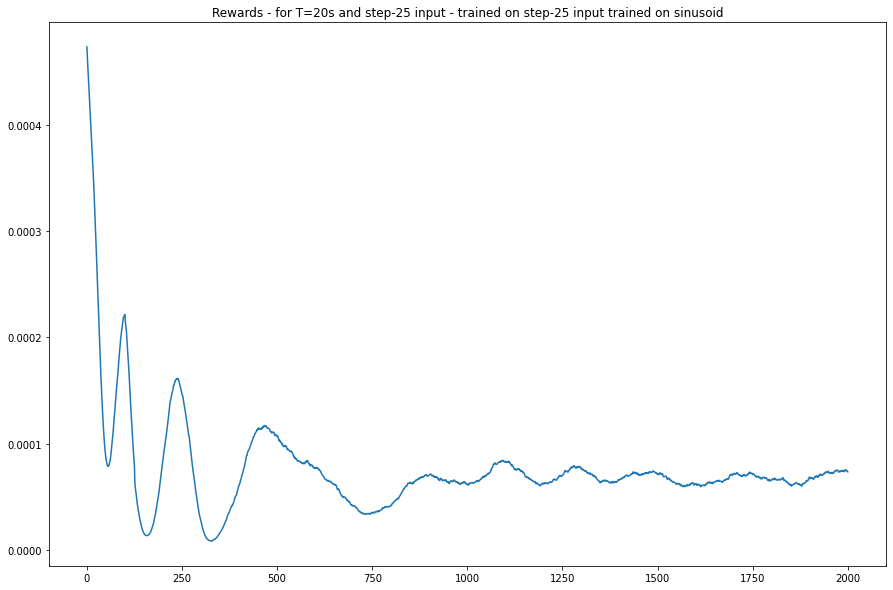

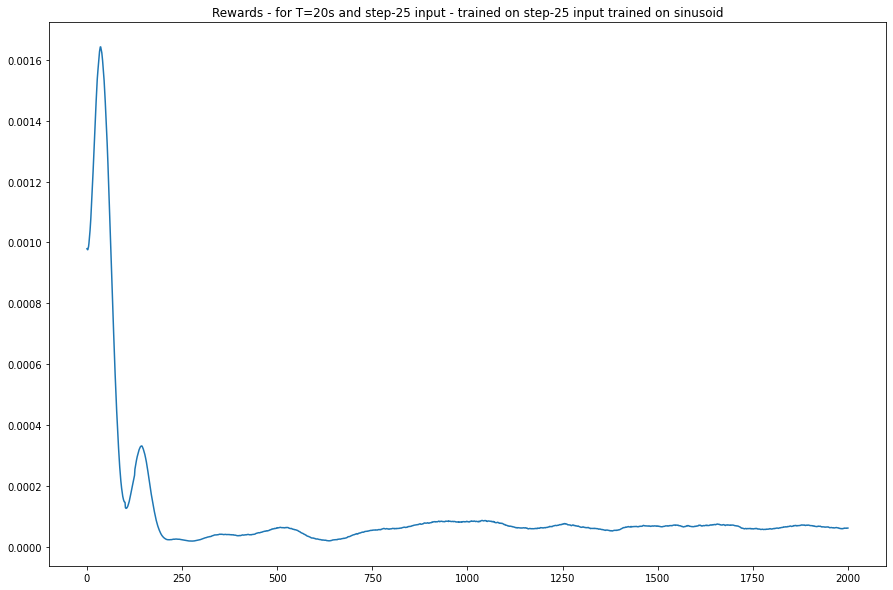

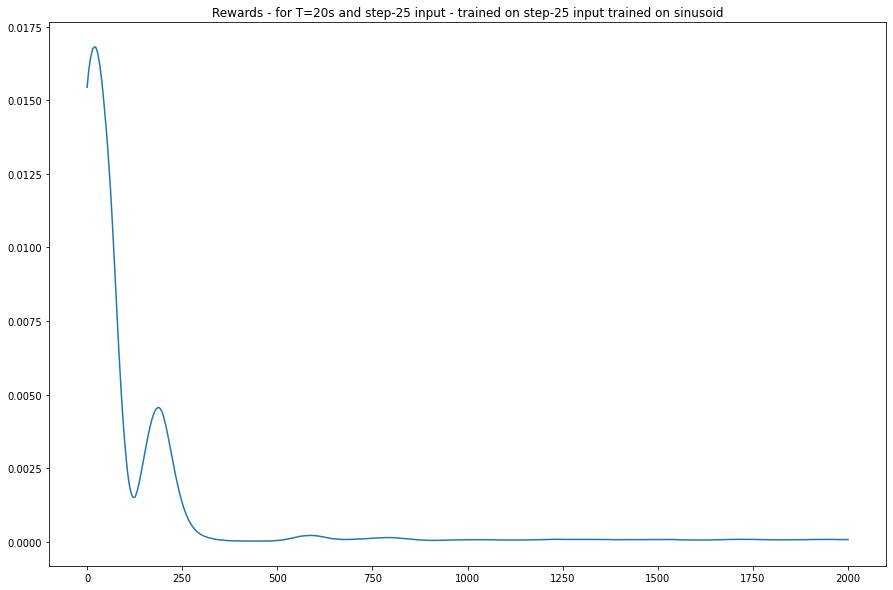

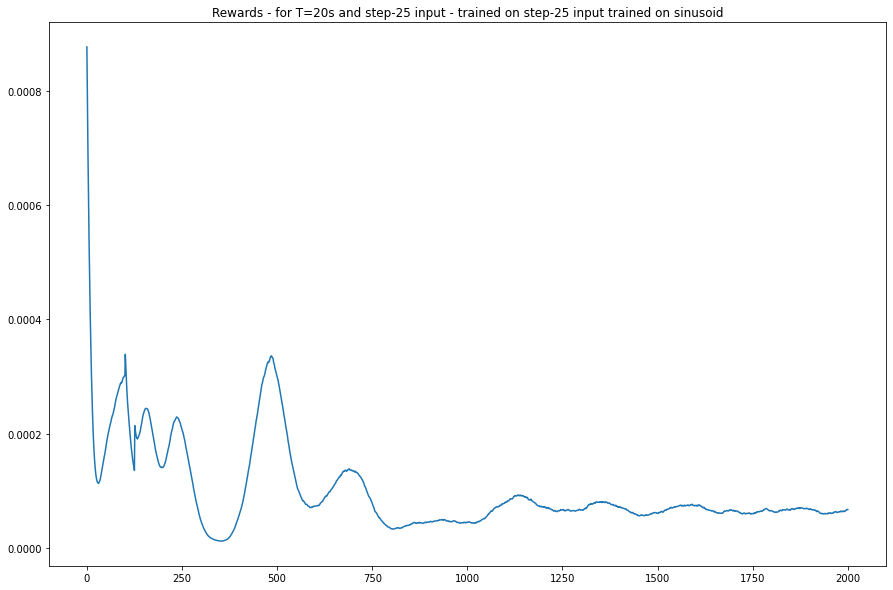

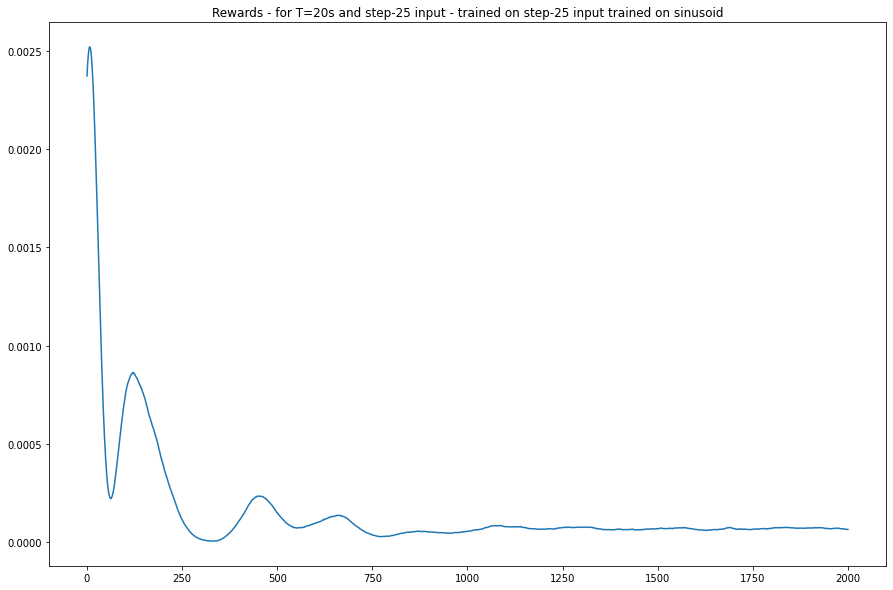

...

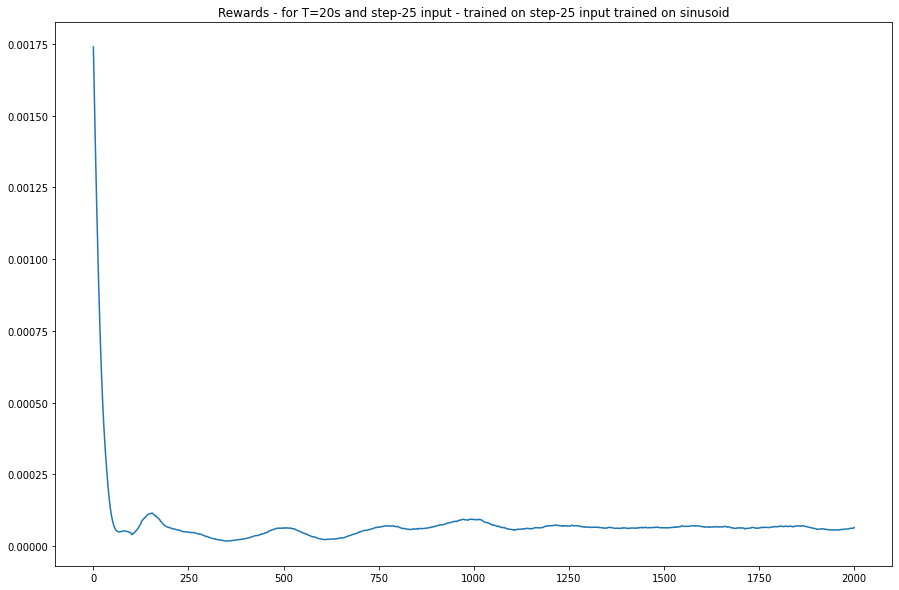

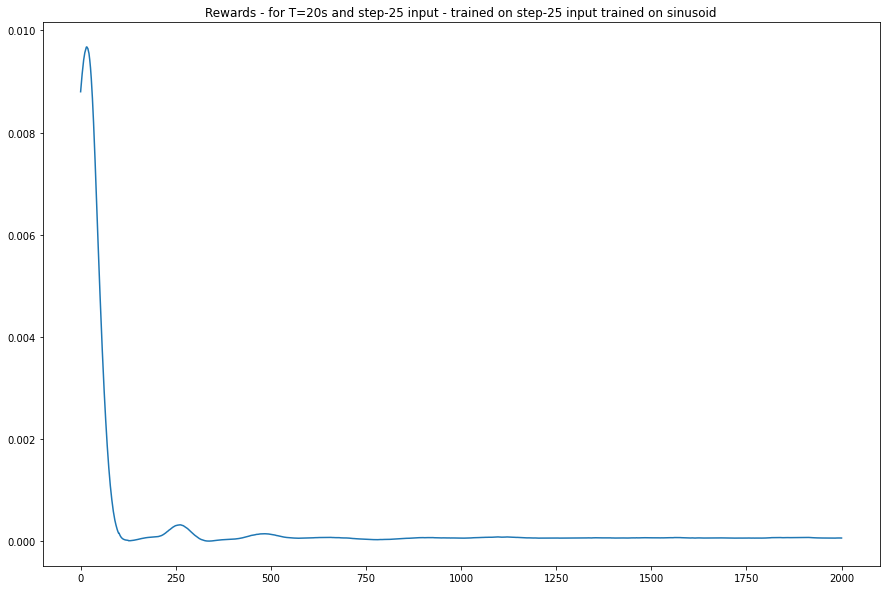

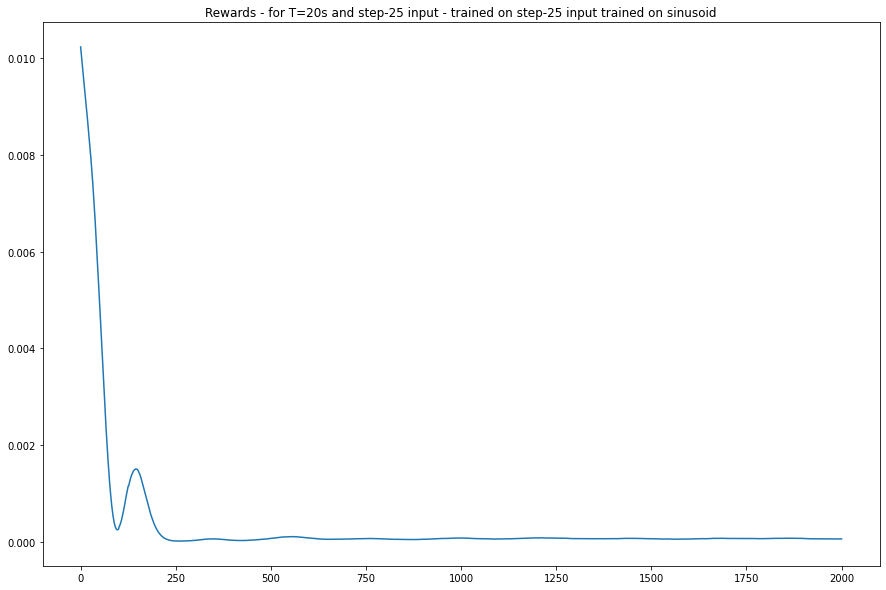

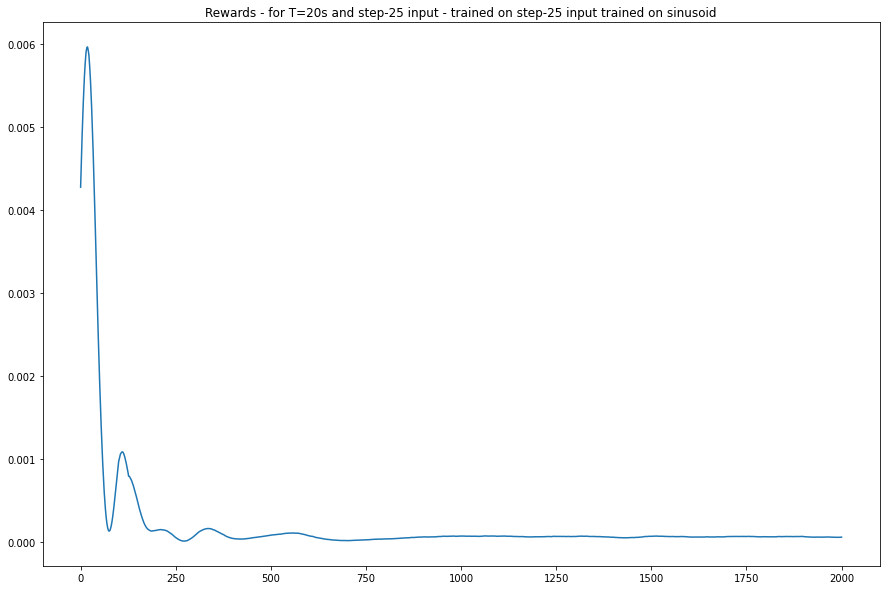

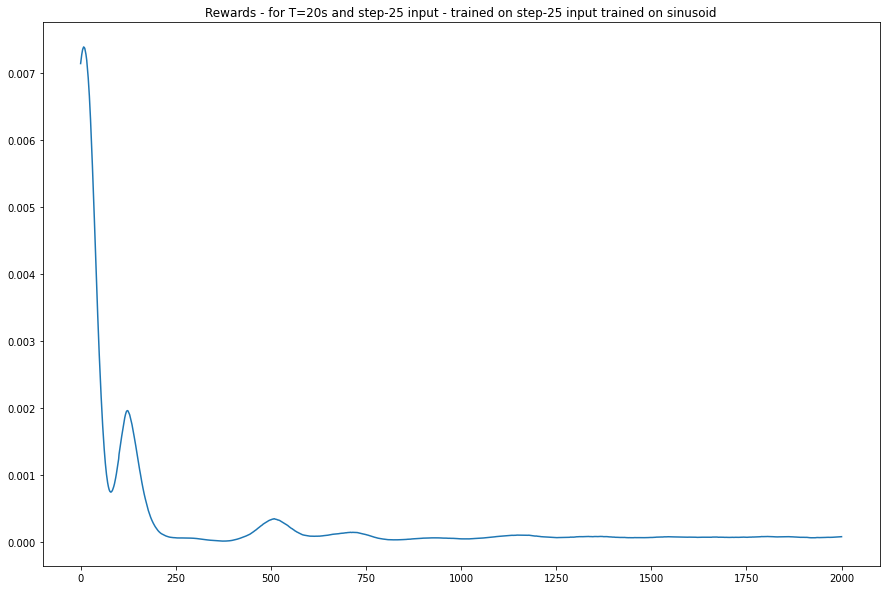

In [ ]:
total_reward = 0

for init_num in range(20): 
  plt.figure(figsize=(15,10))
  plt.title("Rewards - for T=20s and step-25 input - trained on step-25 input trained on sinusoid")
  plt.plot(np.array(all_init_state_ep_rewards[init_num])[:,0,0]) ; 
  print("Mean Cost = ", sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])) ;
  total_reward += sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])

print("Average cost over all runs = ", total_reward/20)

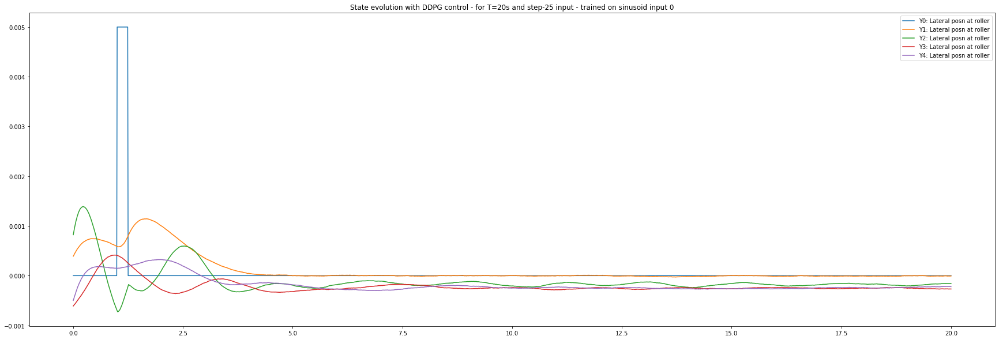

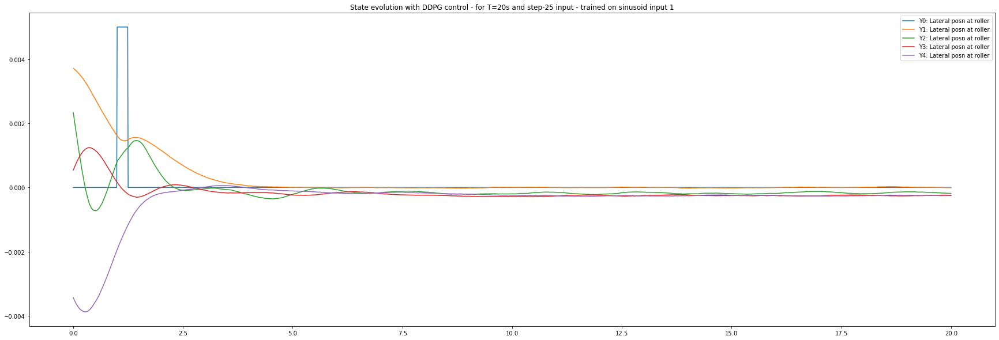

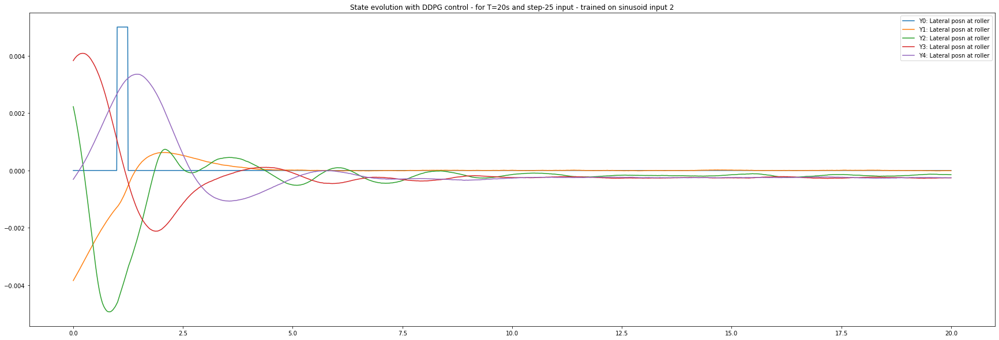

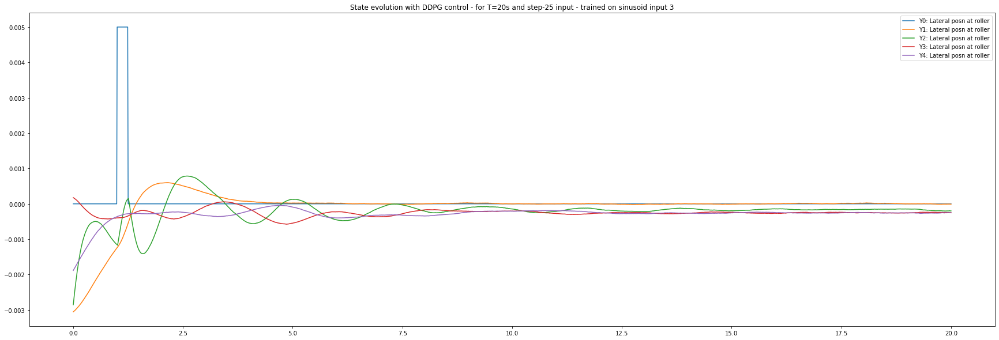

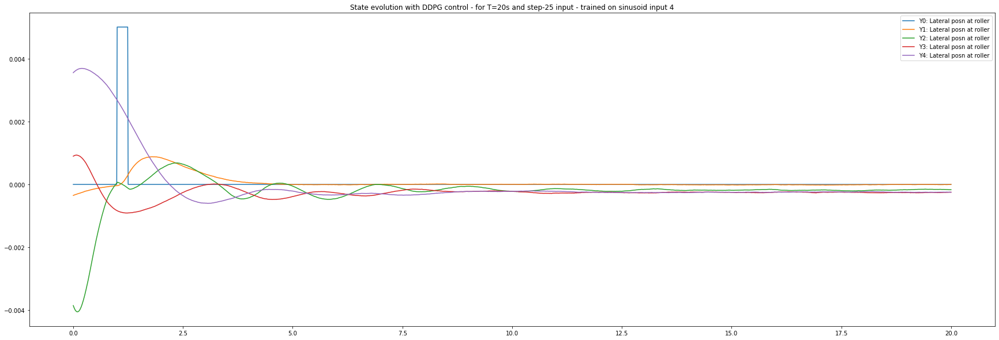

...

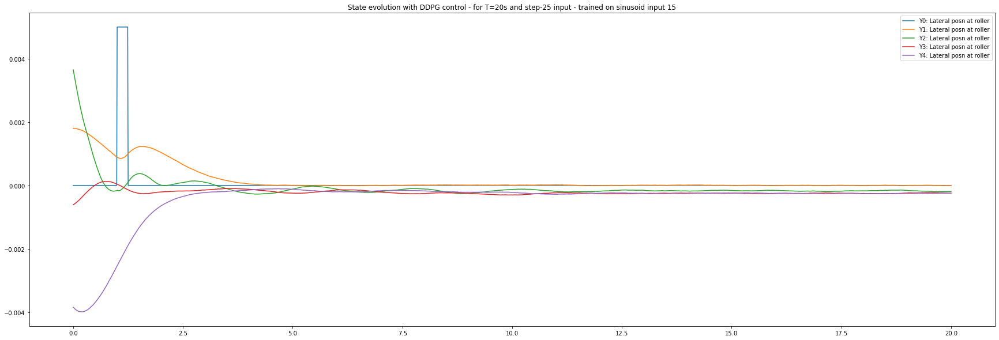

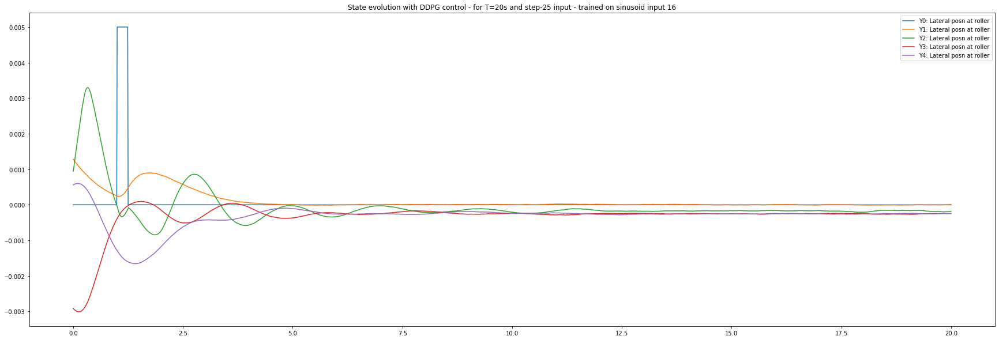

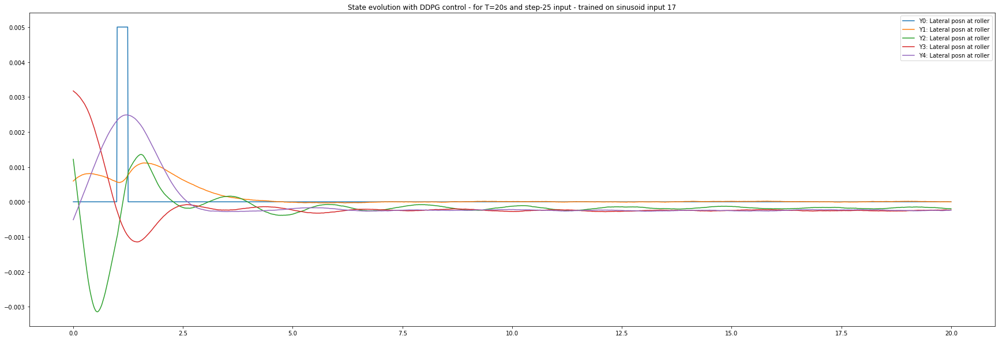

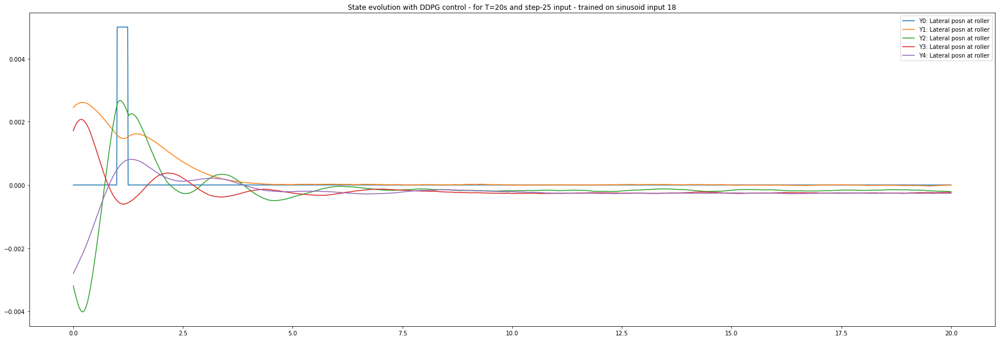

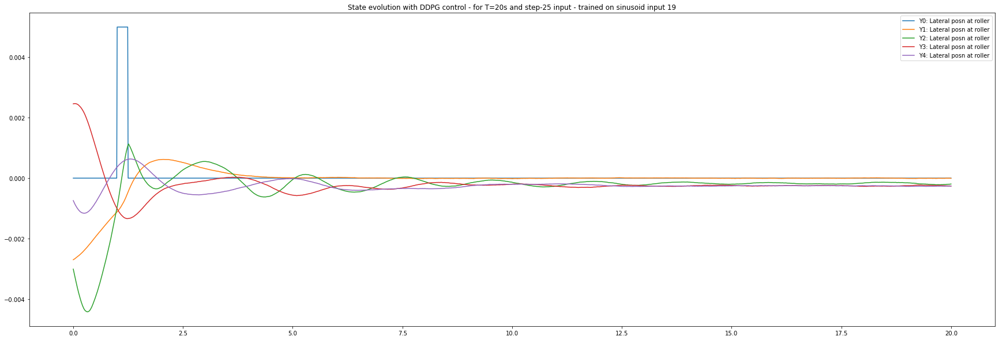

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution with DDPG control - for T=20s and step-25 input - trained on sinusoid input " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

## Step - 25 trained with square wave model

In [ ]:
model_path = './model/ddpg_rand_init_step'

test_episodes = 1
max_steps=2001
alg.load_model(model_path)
t_range = np.linspace(0,(max_steps-1)/100,max_steps)
#w_sin = 0.02*0.25*np.sin(t_range)

## Square wave disturbance
## Square wave disturbance
w_step = np.zeros(t_range.shape)
w_step[100:125] = 0.02*0.25

w = w_step

#w = w_sin

all_init_state_evols = {}
all_init_state_ep_rewards = {}

for init_num in range (20):
    print("Currently working on init num = ", init_num)
    q_loss_list=[]
    policy_loss_list=[]
    ep_rewards = [] ;
    #state = env.reset()
    state = np.concatenate((env.C@(env.reset(init_states[:,init_num][:,None])), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]        

    states_evolution = state[:,None]

    episode_reward = 0

    for step in tqdm(range(max_steps)):
        action = alg.policy_net.get_action(state, noise_scale=0.0)  # no noise for testing

        # action = action/400

        # next_state, reward, done, _ = env.step(action)

        true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
        next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
        reward = -cost  

        ep_rewards.append(cost)
        
        state = next_state

        states_evolution = np.concatenate((states_evolution, state[:,None]), axis=1)

        episode_reward += reward

    all_init_state_evols[init_num] = states_evolution 
    all_init_state_ep_rewards[init_num] = ep_rewards    
        
        # if done:
        #     break
#rewards

Currently working on init num =  0


  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.8/dist-packages/torch/nn/functional.py:1956: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
100%|██████████| 2001/2001 [00:15<00:00, 128.72it/s]


Currently working on init num =  1


100%|██████████| 2001/2001 [00:15<00:00, 128.77it/s]


Currently working on init num =  2


100%|██████████| 2001/2001 [00:15<00:00, 127.08it/s]


Currently working on init num =  3


100%|██████████| 2001/2001 [00:15<00:00, 130.63it/s]


Currently working on init num =  4


100%|██████████| 2001/2001 [00:15<00:00, 129.94it/s]


Currently working on init num =  5


100%|██████████| 2001/2001 [00:15<00:00, 131.17it/s]


Currently working on init num =  6


100%|██████████| 2001/2001 [00:15<00:00, 128.44it/s]


Currently working on init num =  7


100%|██████████| 2001/2001 [00:15<00:00, 130.90it/s]


Currently working on init num =  8


100%|██████████| 2001/2001 [00:15<00:00, 130.21it/s]


Currently working on init num =  9


100%|██████████| 2001/2001 [00:15<00:00, 130.40it/s]


Currently working on init num =  10


100%|██████████| 2001/2001 [00:15<00:00, 128.30it/s]


Currently working on init num =  11


100%|██████████| 2001/2001 [00:15<00:00, 126.09it/s]


Currently working on init num =  12


100%|██████████| 2001/2001 [00:15<00:00, 128.84it/s]


Currently working on init num =  13


100%|██████████| 2001/2001 [00:15<00:00, 127.71it/s]


Currently working on init num =  14


100%|██████████| 2001/2001 [00:15<00:00, 126.49it/s]


Currently working on init num =  15


100%|██████████| 2001/2001 [00:15<00:00, 130.36it/s]


Currently working on init num =  16


100%|██████████| 2001/2001 [00:15<00:00, 130.26it/s]


Currently working on init num =  17


100%|██████████| 2001/2001 [00:15<00:00, 128.61it/s]


Currently working on init num =  18


100%|██████████| 2001/2001 [00:15<00:00, 129.11it/s]


Currently working on init num =  19


100%|██████████| 2001/2001 [00:15<00:00, 128.16it/s]


Mean Cost =  [[0.00118512]]
Mean Cost =  [[0.00118609]]
Mean Cost =  [[0.00182222]]
Mean Cost =  [[0.00103334]]
Mean Cost =  [[0.00112921]]
Mean Cost =  [[0.00127467]]
Mean Cost =  [[0.00146427]]
Mean Cost =  [[0.00137187]]
Mean Cost =  [[0.00131308]]
Mean Cost =  [[0.00123777]]
Mean Cost =  [[0.00106107]]
Mean Cost =  [[0.00124653]]
Mean Cost =  [[0.0012266]]
Mean Cost =  [[0.00118898]]
Mean Cost =  [[0.00148348]]
Mean Cost =  [[0.0011537]]
Mean Cost =  [[0.00135988]]
Mean Cost =  [[0.00141062]]
Mean Cost =  [[0.00120572]]
Mean Cost =  [[0.00117554]]
Average cost over all runs =  [[0.00127649]]


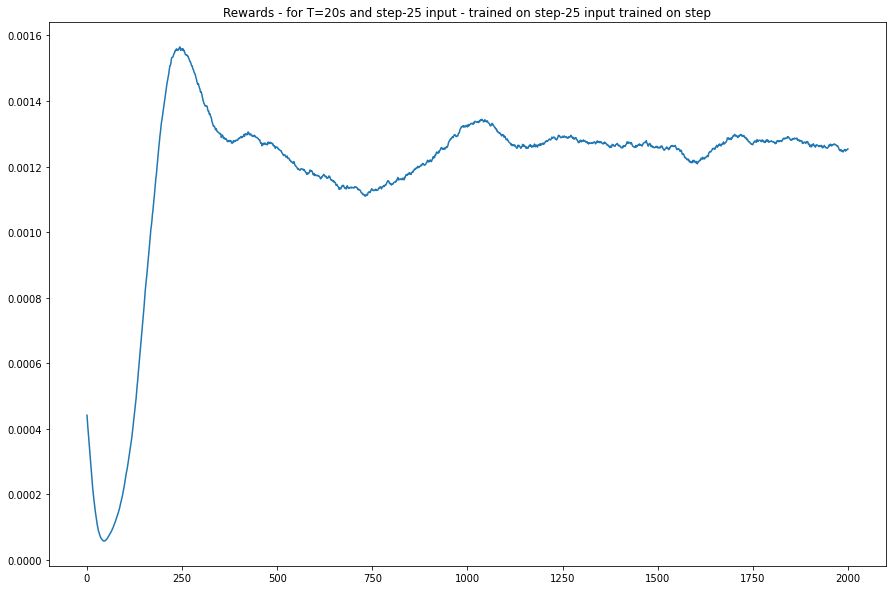

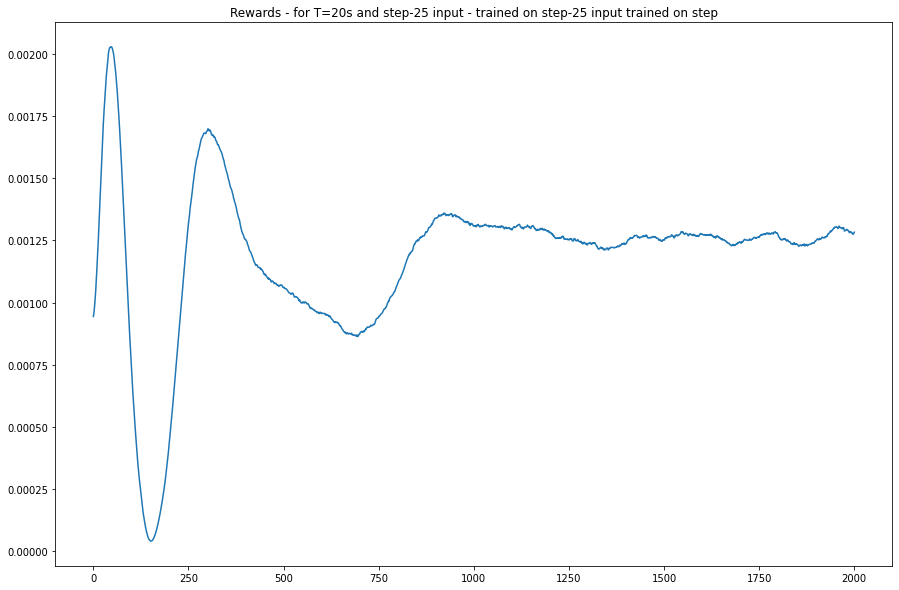

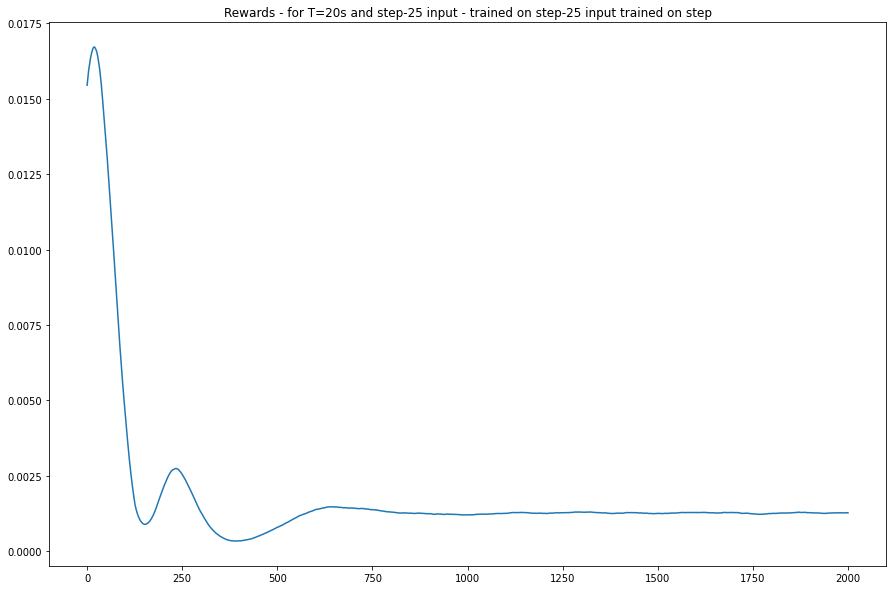

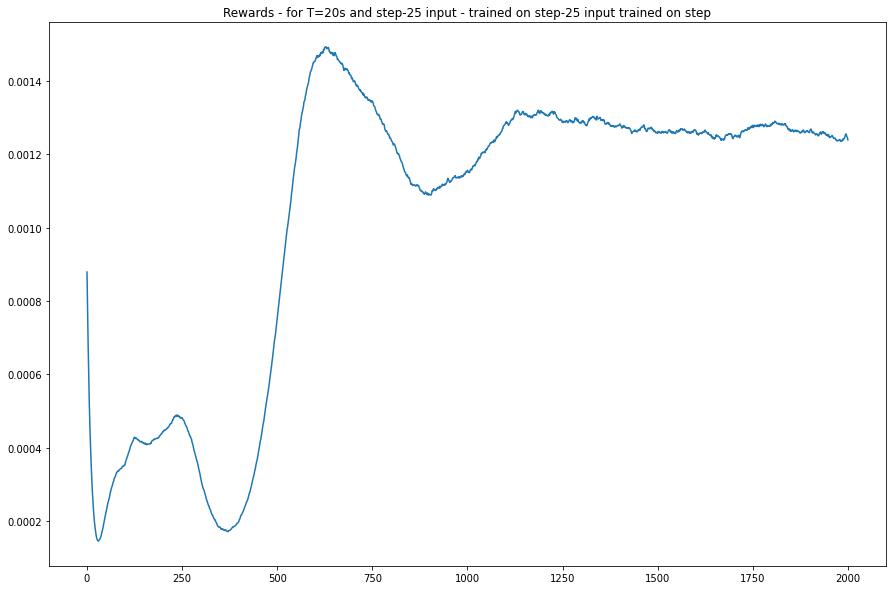

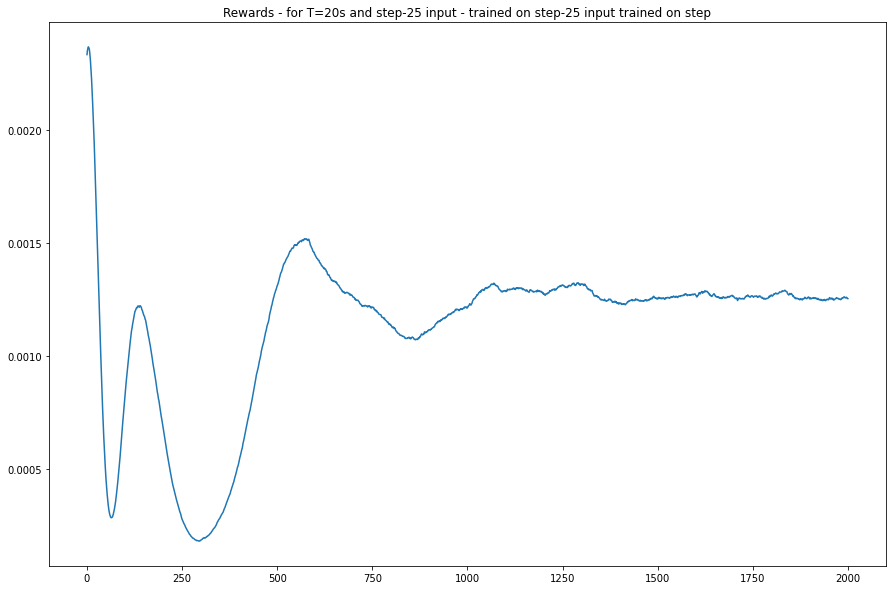

...

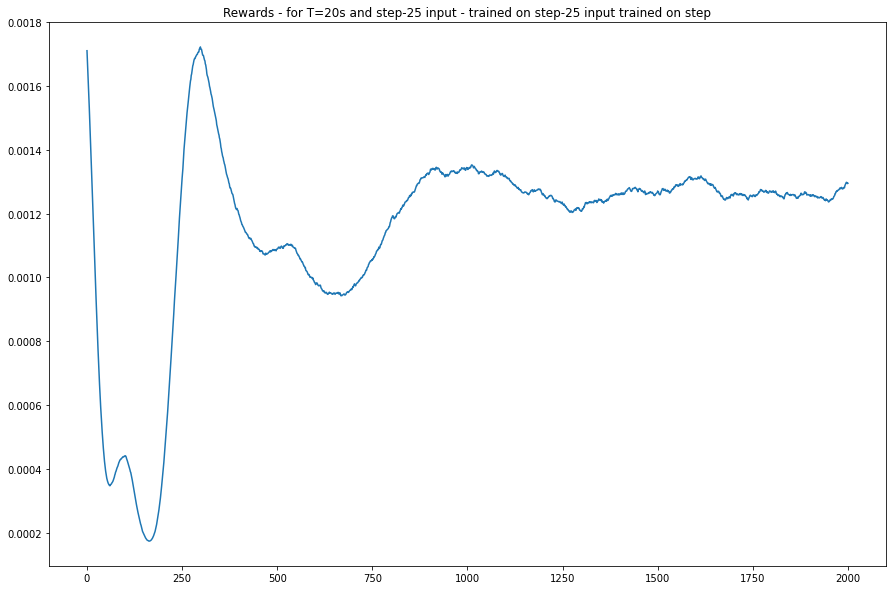

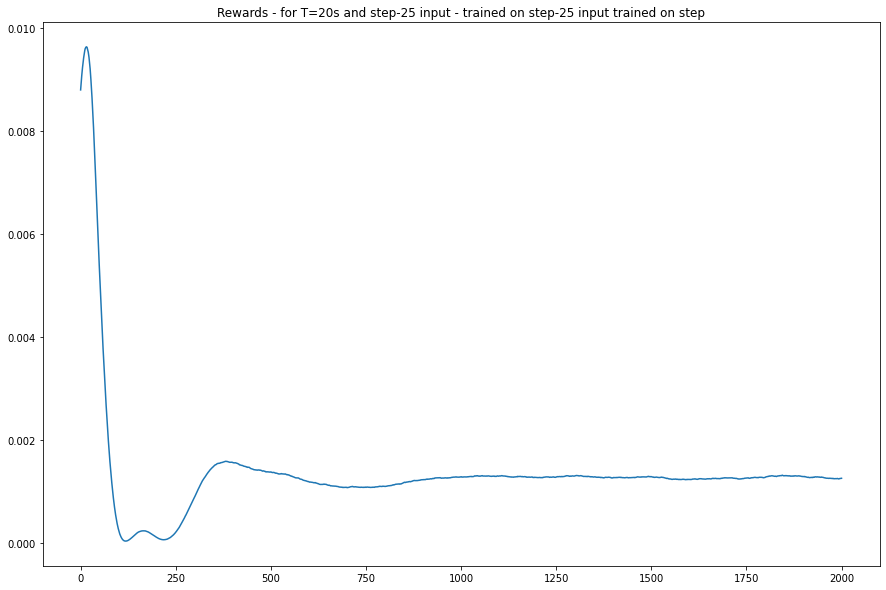

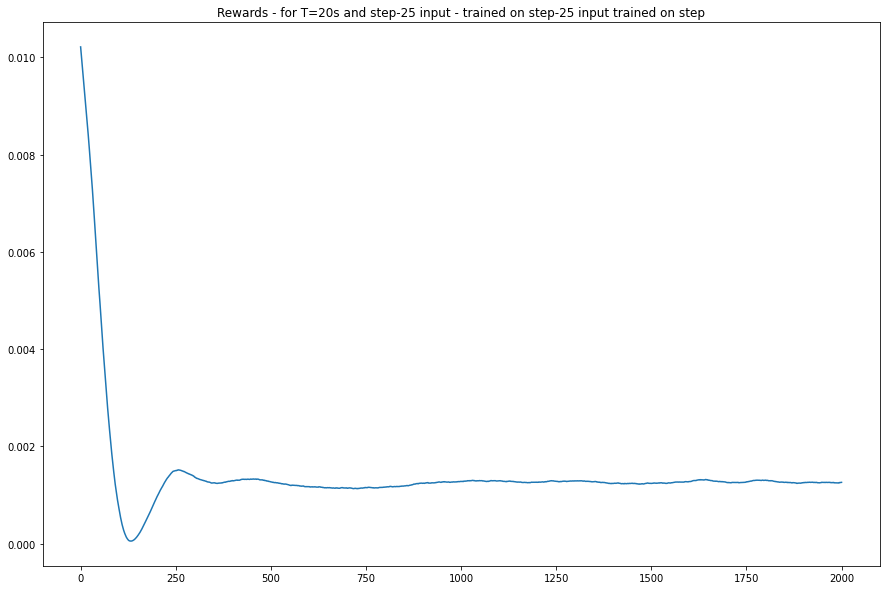

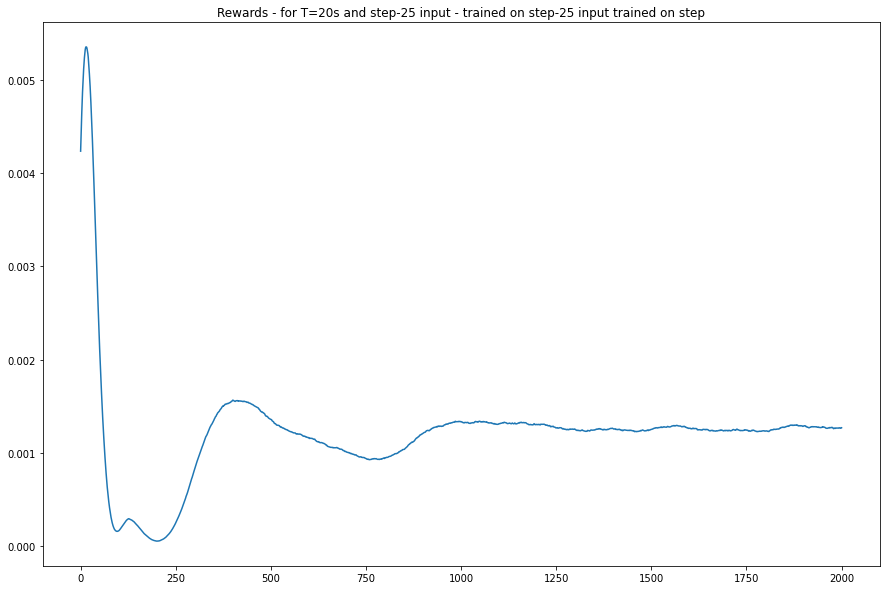

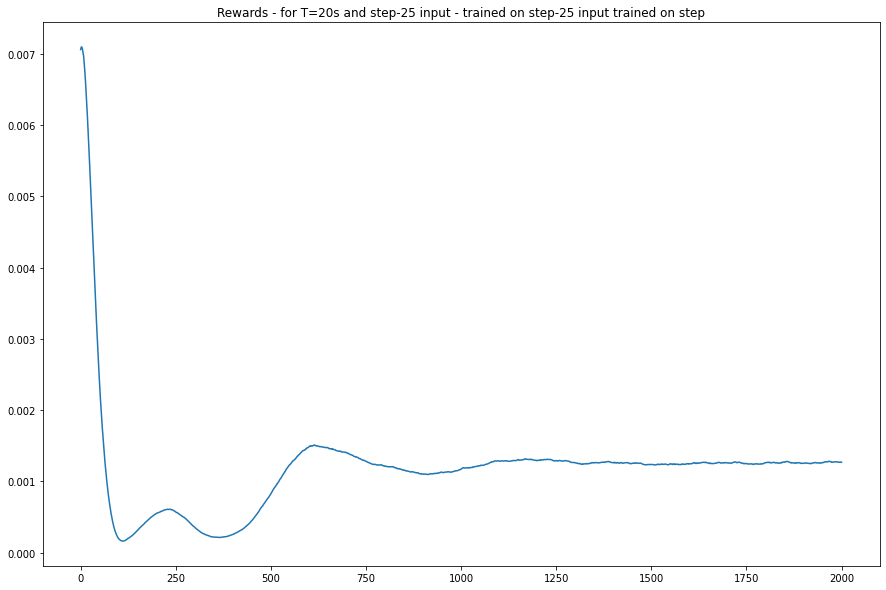

In [ ]:
total_reward = 0

for init_num in range(20): 
  plt.figure(figsize=(15,10))
  plt.title("Rewards - for T=20s and step-25 input - trained on step-25 input trained on step")
  plt.plot(np.array(all_init_state_ep_rewards[init_num])[:,0,0]) ; 
  print("Mean Cost = ", sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])) ;
  total_reward += sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])

print("Average cost over all runs = ", total_reward/20)

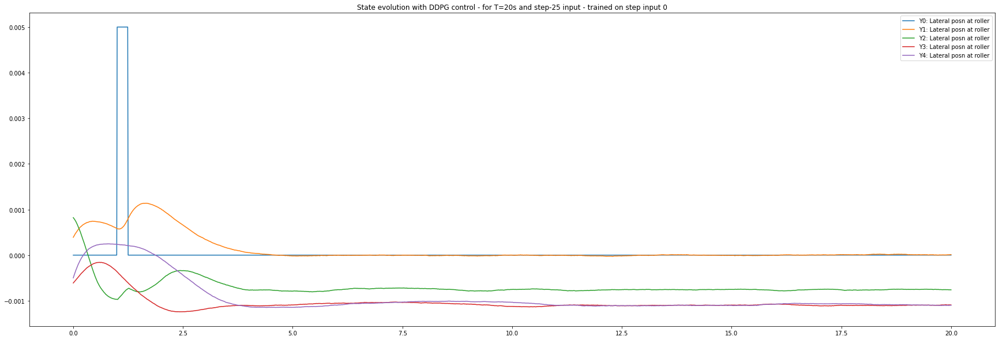

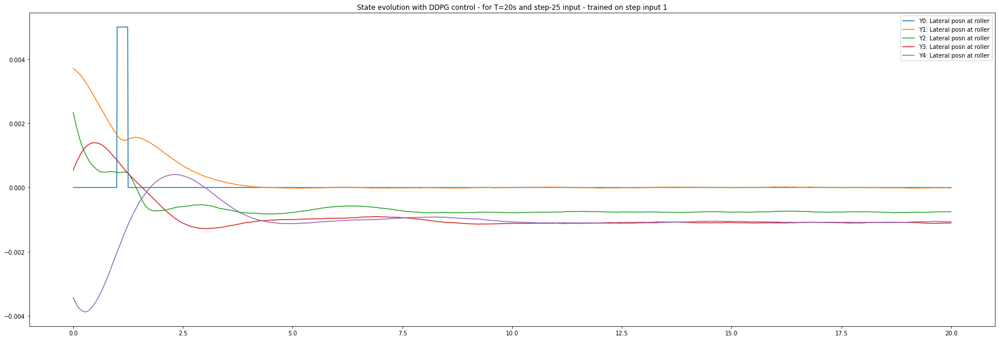

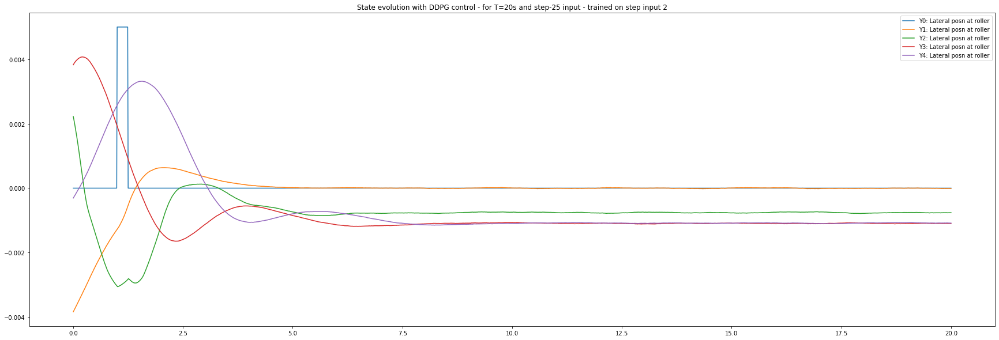

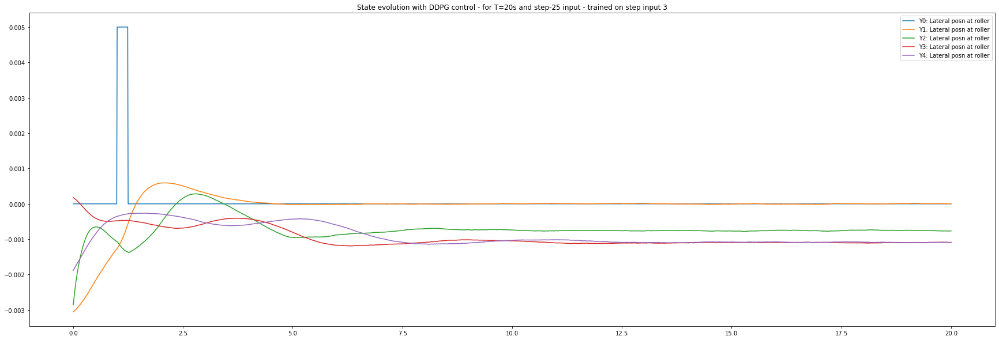

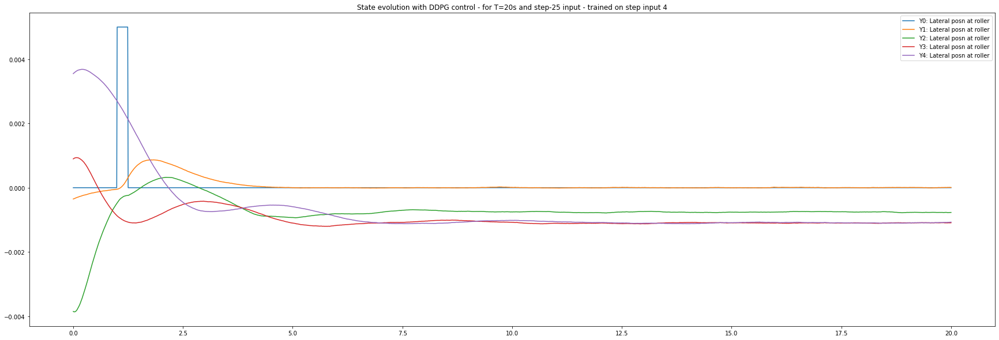

...

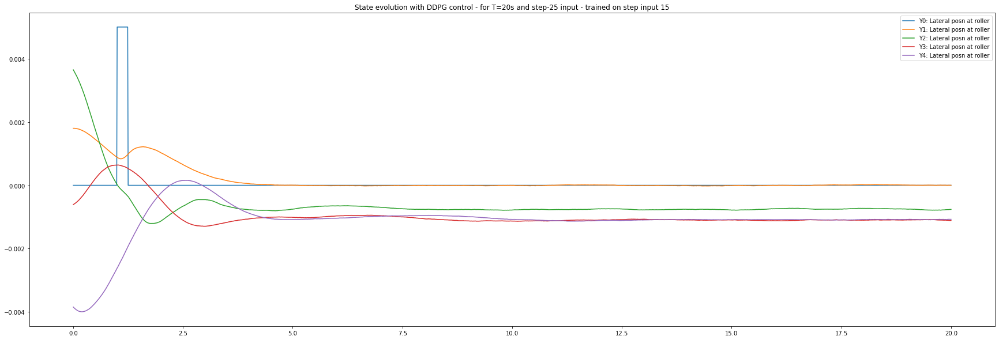

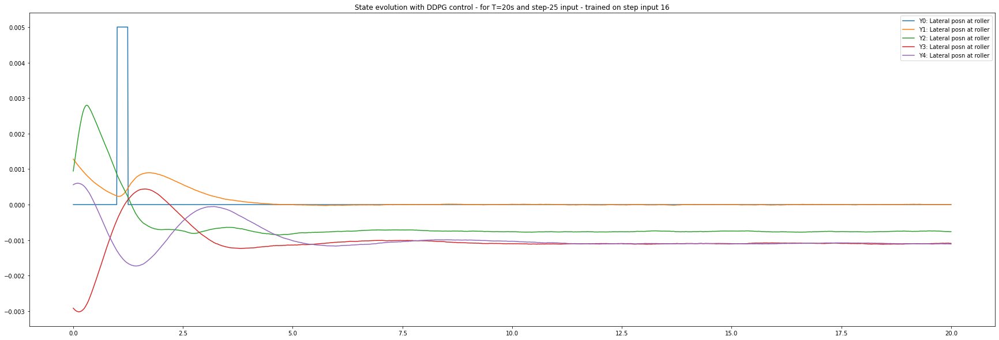

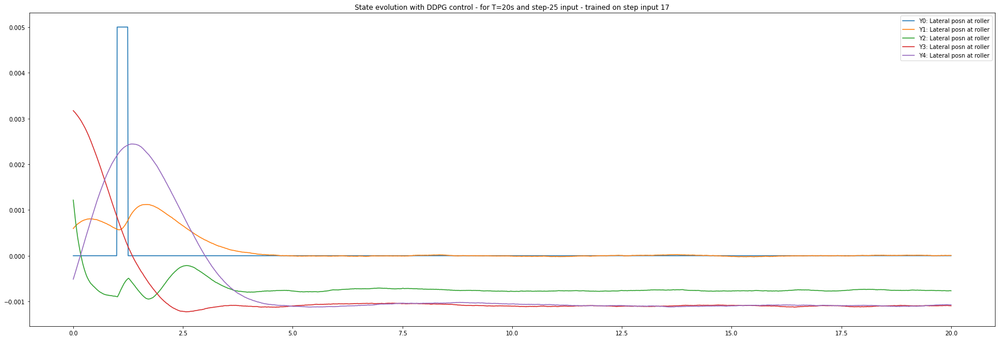

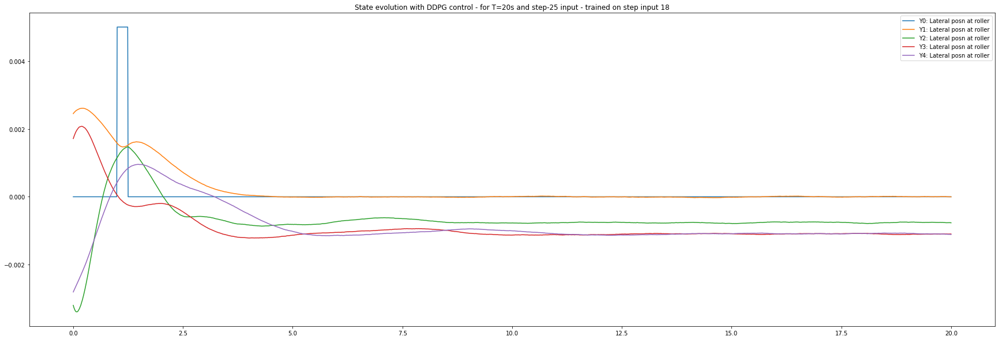

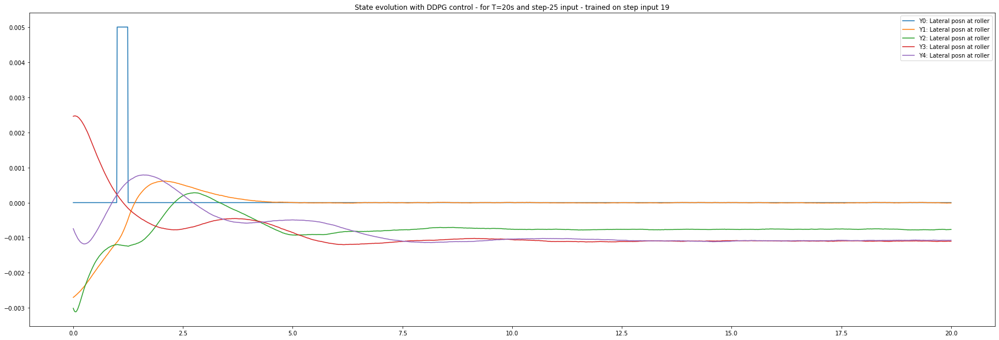

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution with DDPG control - for T=20s and step-25 input - trained on step input " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

## square-50 with DDPG - Sinusoidal model

In [ ]:
model_path = './model/ddpg_rand_init_sin_2_0x'

test_episodes = 1
max_steps=2001
alg.load_model(model_path)
t_range = np.linspace(0,(max_steps-1)/100,max_steps)
w_sin = 0.02*0.25*np.sin(1.5*t_range)

## Square wave disturbance
w_step = np.zeros(t_range.shape)
w_step[100:150] = 0.02*0.25

#w = w_step

w = w_step

all_init_state_evols = {}
all_init_state_ep_rewards = {}

for init_num in range (20):
    print("Currently working on init num = ", init_num)
    q_loss_list=[]
    policy_loss_list=[]
    ep_rewards = [] ;
    #state = env.reset()
    state = np.concatenate((env.C@(env.reset(init_states[:,init_num][:,None])), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]        

    states_evolution = state[:,None]

    episode_reward = 0

    for step in tqdm(range(max_steps)):
        action = alg.policy_net.get_action(state, noise_scale=0.0)  # no noise for testing

        # action = action/400

        # next_state, reward, done, _ = env.step(action)

        true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
        next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
        reward = -cost  

        ep_rewards.append(cost)
        
        state = next_state

        states_evolution = np.concatenate((states_evolution, state[:,None]), axis=1)

        episode_reward += reward

    all_init_state_evols[init_num] = states_evolution 
    all_init_state_ep_rewards[init_num] = ep_rewards    
        
        # if done:
        #     break
#rewards

Currently working on init num =  0


  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.8/dist-packages/torch/nn/functional.py:1956: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
100%|██████████| 2001/2001 [00:19<00:00, 103.17it/s]


Currently working on init num =  1


100%|██████████| 2001/2001 [00:16<00:00, 122.26it/s]


Currently working on init num =  2


100%|██████████| 2001/2001 [00:14<00:00, 134.85it/s]


Currently working on init num =  3


100%|██████████| 2001/2001 [00:14<00:00, 134.58it/s]


Currently working on init num =  4


100%|██████████| 2001/2001 [00:14<00:00, 136.23it/s]


Currently working on init num =  5


100%|██████████| 2001/2001 [00:14<00:00, 134.00it/s]


Currently working on init num =  6


100%|██████████| 2001/2001 [00:14<00:00, 135.13it/s]


Currently working on init num =  7


100%|██████████| 2001/2001 [00:15<00:00, 132.15it/s]


Currently working on init num =  8


100%|██████████| 2001/2001 [00:14<00:00, 134.89it/s]


Currently working on init num =  9


100%|██████████| 2001/2001 [00:14<00:00, 136.64it/s]


Currently working on init num =  10


100%|██████████| 2001/2001 [00:14<00:00, 136.48it/s]


Currently working on init num =  11


100%|██████████| 2001/2001 [00:14<00:00, 136.43it/s]


Currently working on init num =  12


100%|██████████| 2001/2001 [00:14<00:00, 134.98it/s]


Currently working on init num =  13


100%|██████████| 2001/2001 [00:14<00:00, 137.67it/s]


Currently working on init num =  14


100%|██████████| 2001/2001 [00:14<00:00, 136.85it/s]


Currently working on init num =  15


100%|██████████| 2001/2001 [00:14<00:00, 136.87it/s]


Currently working on init num =  16


100%|██████████| 2001/2001 [00:14<00:00, 135.81it/s]


Currently working on init num =  17


100%|██████████| 2001/2001 [00:14<00:00, 137.57it/s]


Currently working on init num =  18


100%|██████████| 2001/2001 [00:14<00:00, 137.59it/s]


Currently working on init num =  19


100%|██████████| 2001/2001 [00:14<00:00, 137.42it/s]


Mean Cost =  [[7.02281381e-05]]
Mean Cost =  [[0.00011298]]
Mean Cost =  [[0.00091647]]
Mean Cost =  [[0.00010145]]
Mean Cost =  [[0.0001622]]
Mean Cost =  [[0.00022094]]
Mean Cost =  [[0.00046036]]
Mean Cost =  [[0.00037176]]
Mean Cost =  [[0.0003502]]
Mean Cost =  [[0.00020548]]
Mean Cost =  [[0.00011147]]
Mean Cost =  [[0.00025795]]
Mean Cost =  [[0.0001352]]
Mean Cost =  [[0.00013857]]
Mean Cost =  [[0.00039893]]
Mean Cost =  [[7.54039943e-05]]
Mean Cost =  [[0.00032698]]
Mean Cost =  [[0.00034727]]
Mean Cost =  [[0.00021073]]
Mean Cost =  [[0.00030722]]
Average cost over all runs =  [[0.00026409]]


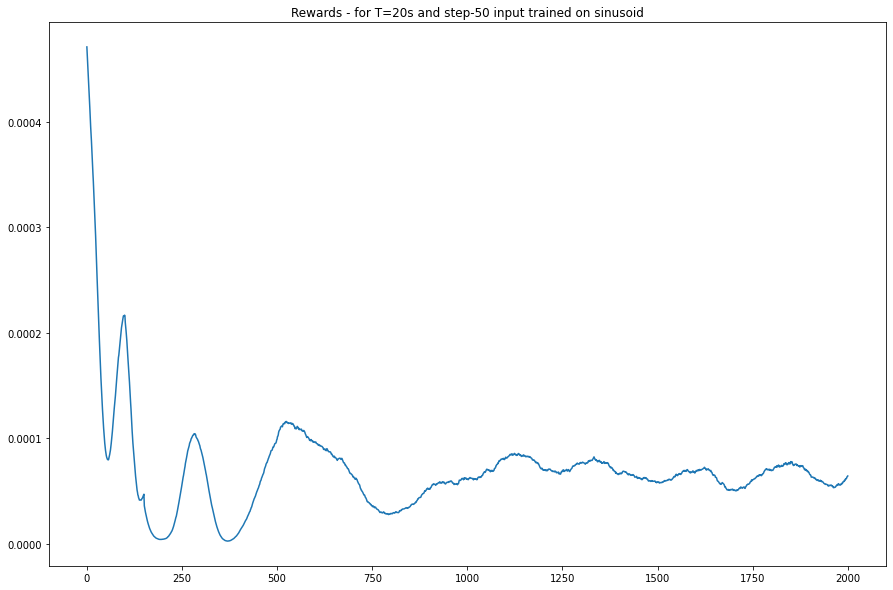

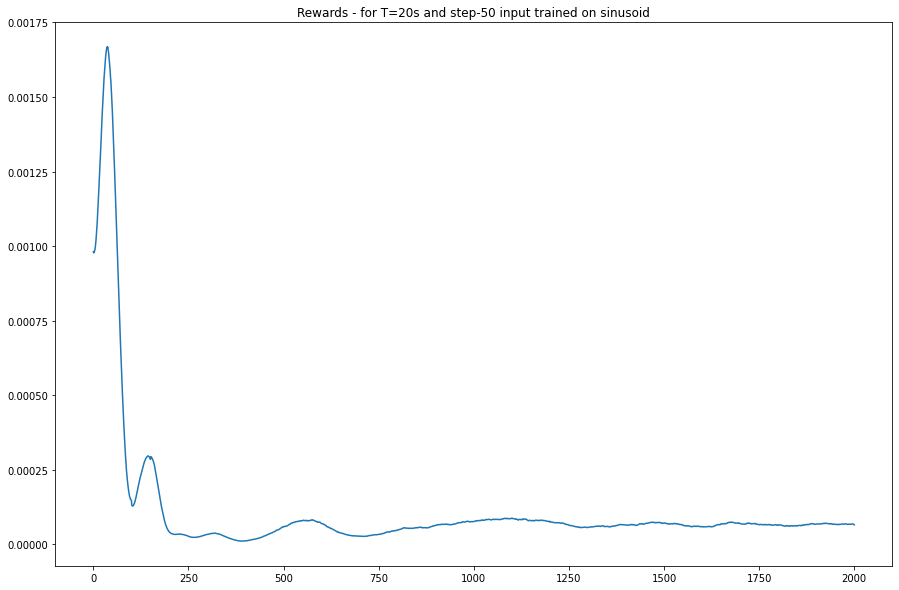

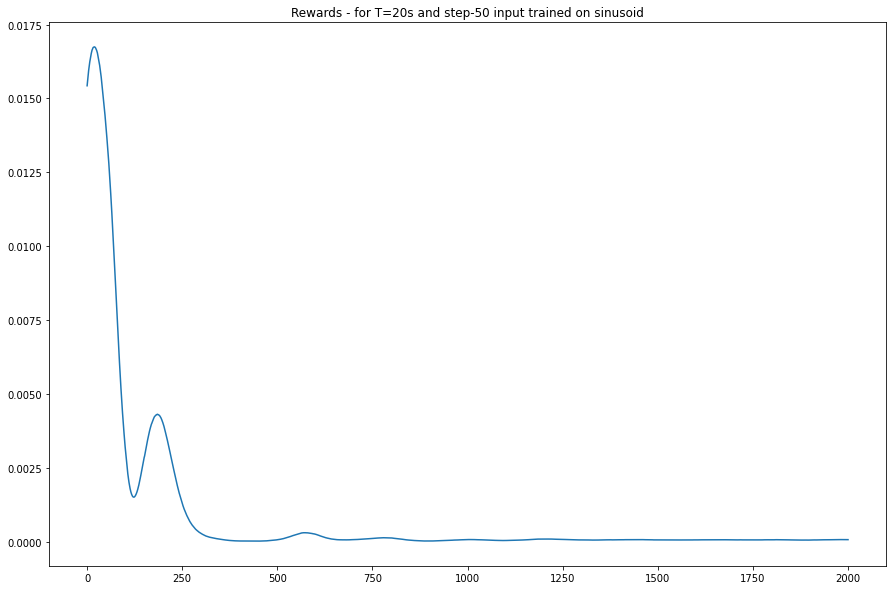

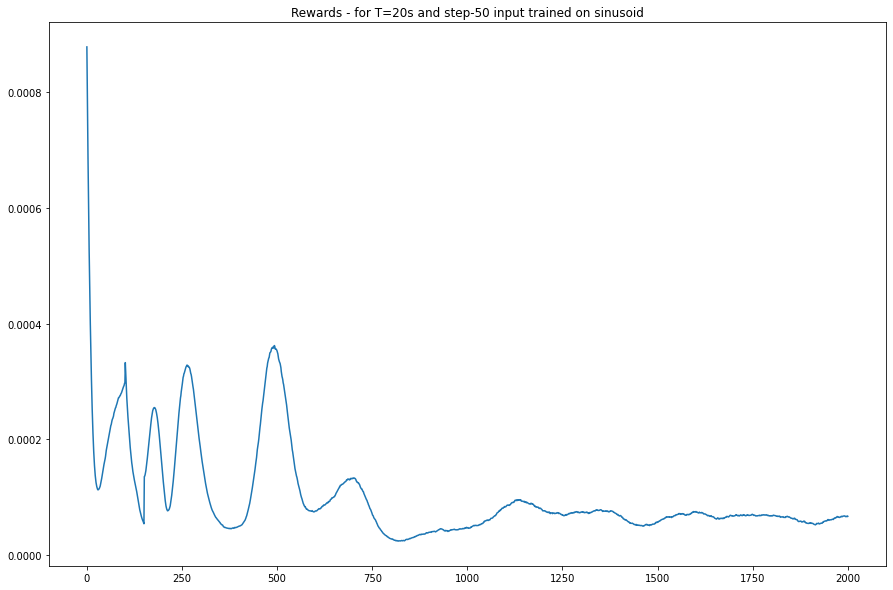

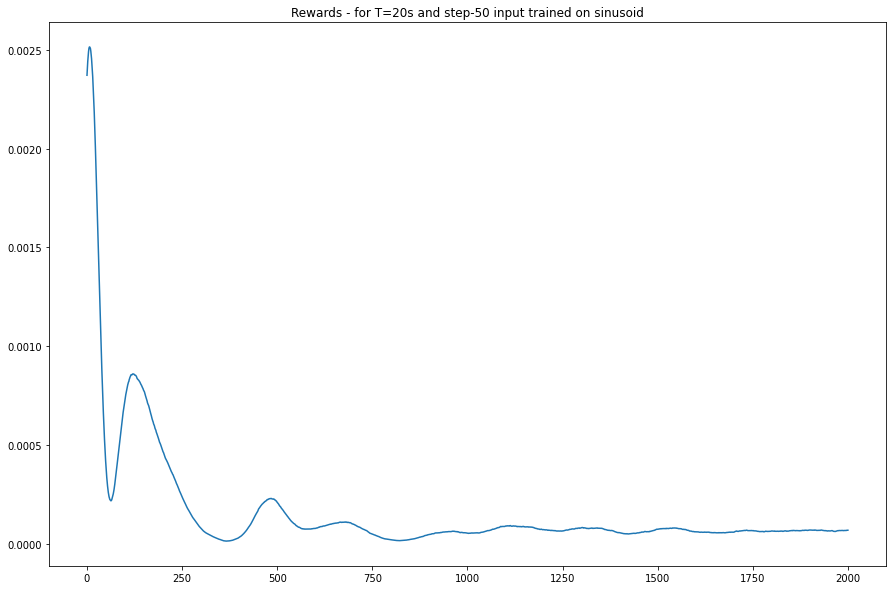

...

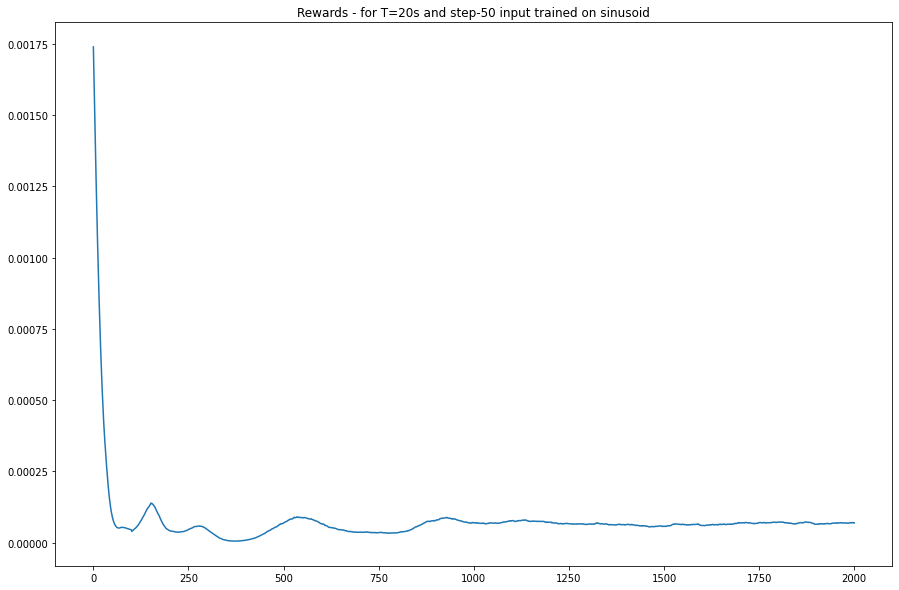

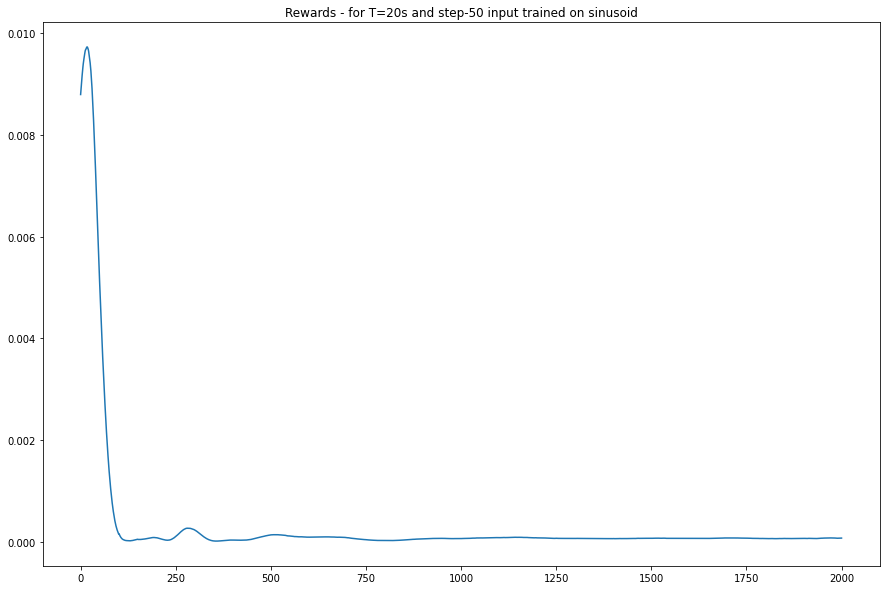

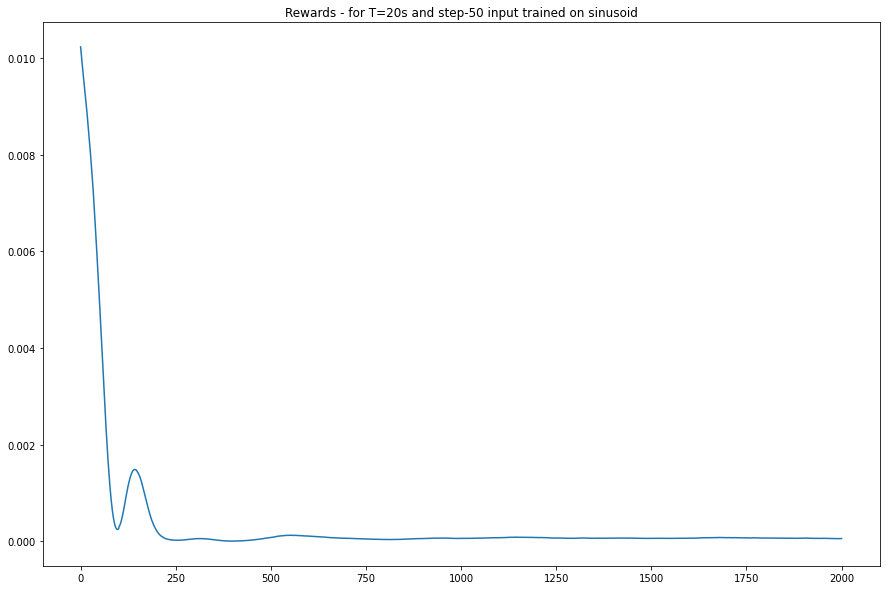

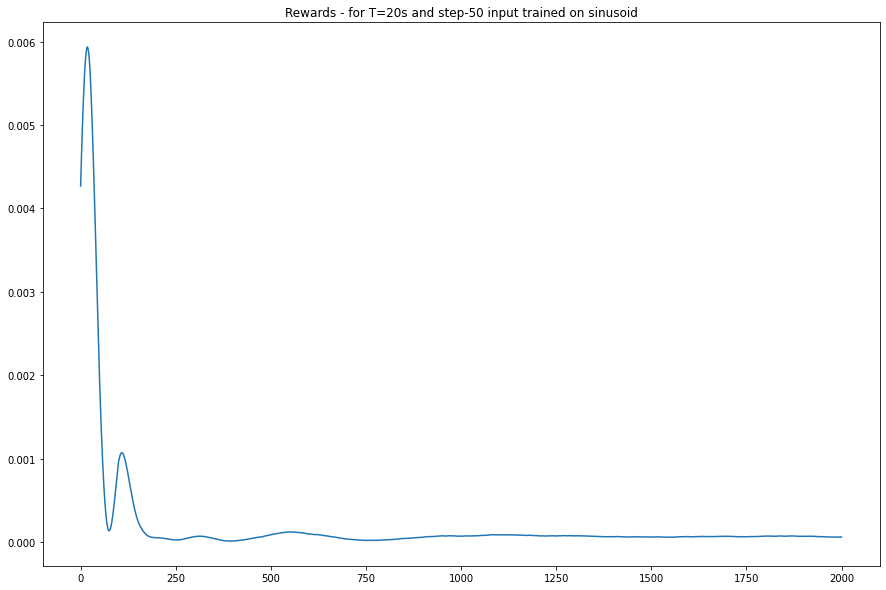

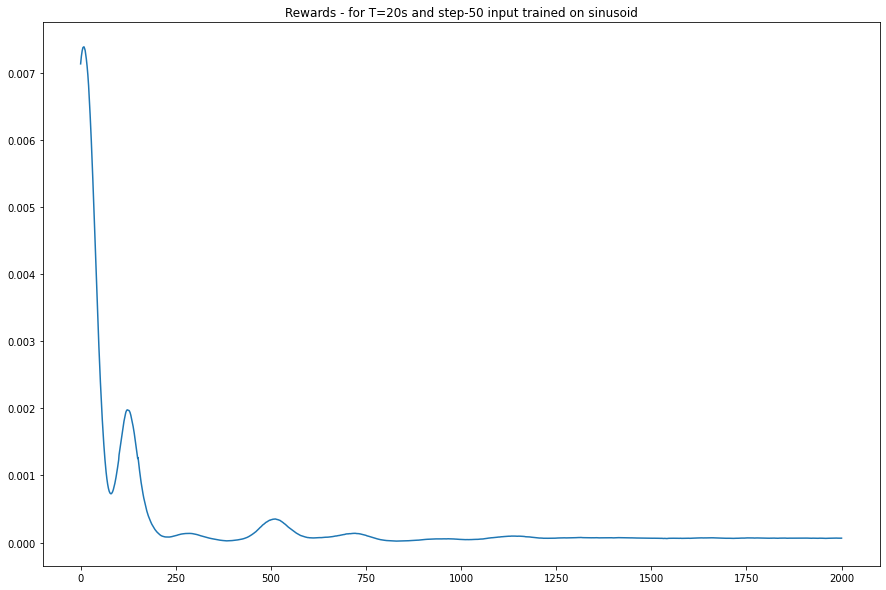

In [ ]:
total_reward = 0

for init_num in range(20): 
  plt.figure(figsize=(15,10))
  plt.title("Rewards - for T=20s and step-50 input trained on sinusoid")
  plt.plot(np.array(all_init_state_ep_rewards[init_num])[:,0,0]) ; 
  print("Mean Cost = ", sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])) ;
  total_reward += sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])

print("Average cost over all runs = ", total_reward/20)

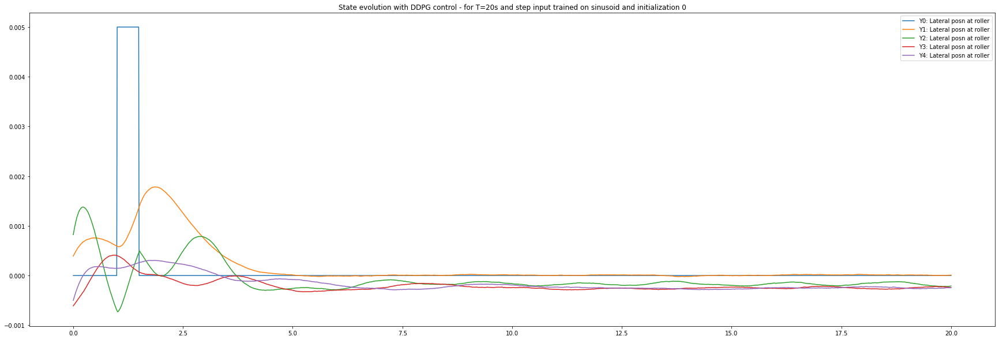

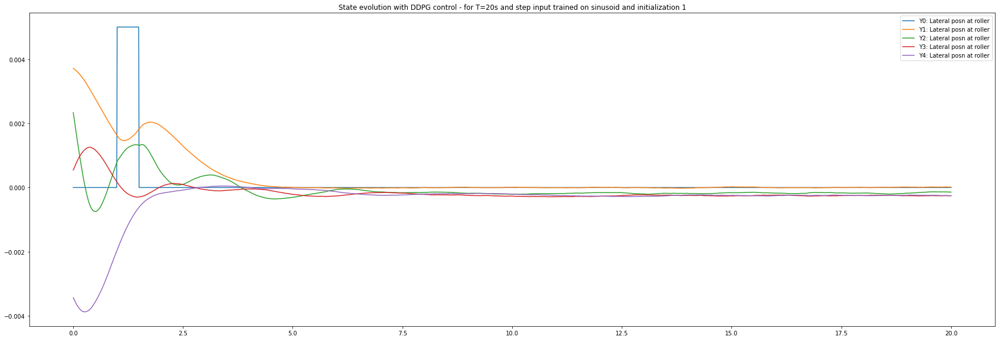

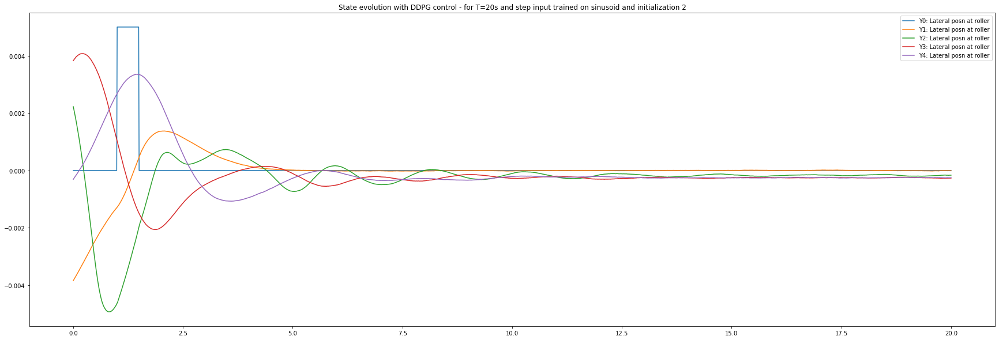

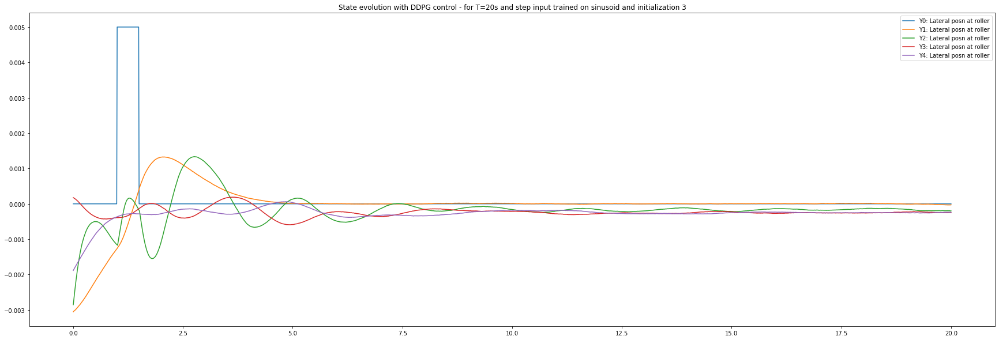

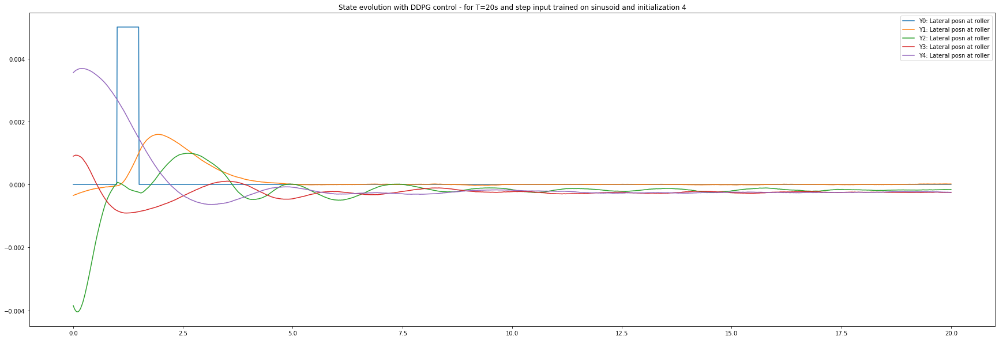

...

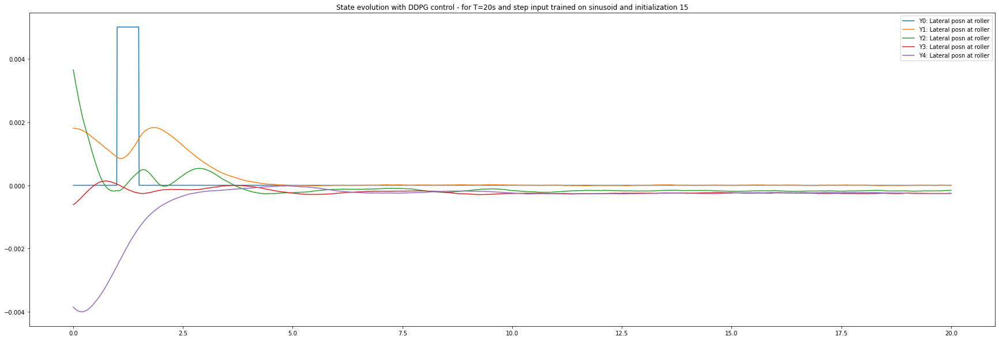

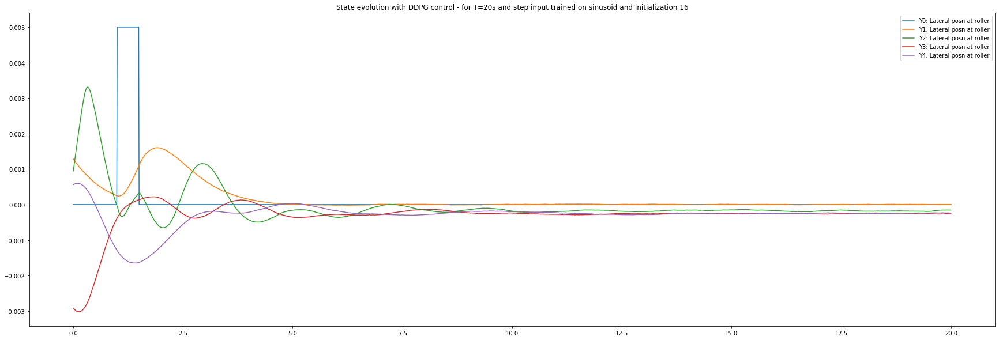

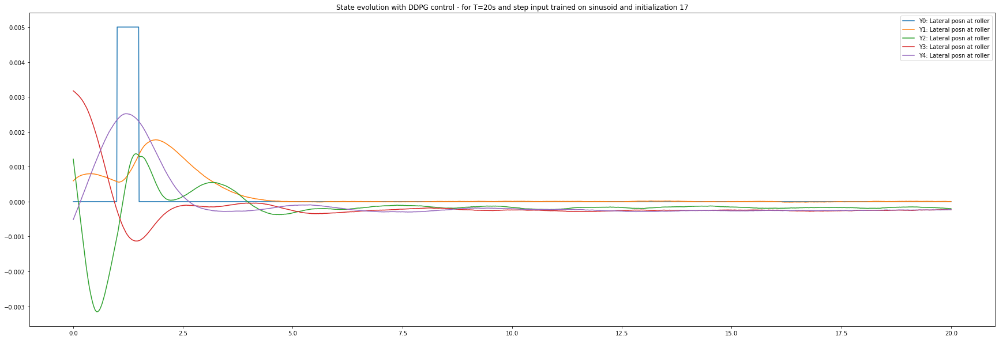

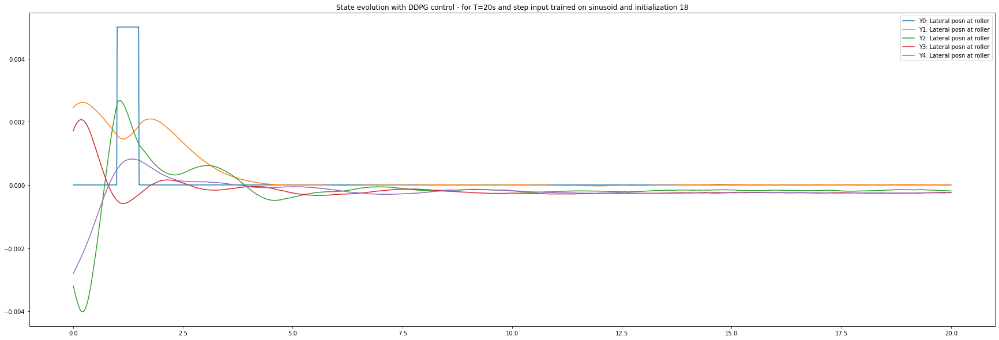

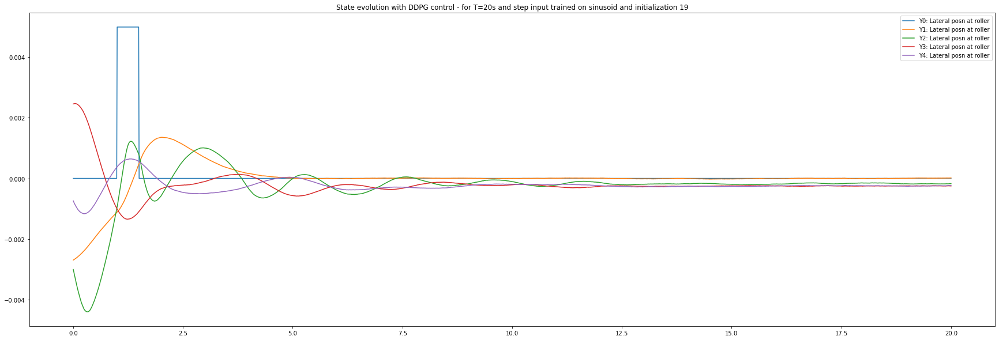

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution with DDPG control - for T=20s and step input trained on sinusoid and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

## square-50 with DDPG - Step input model

In [ ]:
model_path = './model/ddpg_rand_init_step'

test_episodes = 1
max_steps=2001
alg.load_model(model_path)
t_range = np.linspace(0,(max_steps-1)/100,max_steps)
#w_sin = 0.02*0.25*np.sin(1.5*t_range)

## Square wave disturbance
w_step = np.zeros(t_range.shape)
w_step[100:150] = 0.02*0.25

#w = w_step

w = w_step

all_init_state_evols = {}
all_init_state_ep_rewards = {}

for init_num in range (20):
    print("Currently working on init num = ", init_num)
    q_loss_list=[]
    policy_loss_list=[]
    ep_rewards = [] ;
    #state = env.reset()
    state = np.concatenate((env.C@(env.reset(init_states[:,init_num][:,None])), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]        

    states_evolution = state[:,None]

    episode_reward = 0

    for step in tqdm(range(max_steps)):
        action = alg.policy_net.get_action(state, noise_scale=0.0)  # no noise for testing

        # action = action/400

        # next_state, reward, done, _ = env.step(action)

        true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
        next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
        reward = -cost  

        ep_rewards.append(cost)
        
        state = next_state

        states_evolution = np.concatenate((states_evolution, state[:,None]), axis=1)

        episode_reward += reward

    all_init_state_evols[init_num] = states_evolution 
    all_init_state_ep_rewards[init_num] = ep_rewards    
        
        # if done:
        #     break
#rewards

Currently working on init num =  0


100%|██████████| 2001/2001 [00:11<00:00, 181.47it/s]


Currently working on init num =  1


100%|██████████| 2001/2001 [00:14<00:00, 134.98it/s]


Currently working on init num =  2


100%|██████████| 2001/2001 [00:16<00:00, 122.59it/s]


Currently working on init num =  3


100%|██████████| 2001/2001 [00:13<00:00, 149.45it/s]


Currently working on init num =  4


100%|██████████| 2001/2001 [00:11<00:00, 170.19it/s]


Currently working on init num =  5


100%|██████████| 2001/2001 [00:10<00:00, 183.73it/s]


Currently working on init num =  6


100%|██████████| 2001/2001 [00:10<00:00, 186.77it/s]


Currently working on init num =  7


100%|██████████| 2001/2001 [00:10<00:00, 186.64it/s]


Currently working on init num =  8


100%|██████████| 2001/2001 [00:11<00:00, 181.10it/s]


Currently working on init num =  9


100%|██████████| 2001/2001 [00:11<00:00, 176.33it/s]


Currently working on init num =  10


100%|██████████| 2001/2001 [00:11<00:00, 179.76it/s]


Currently working on init num =  11


100%|██████████| 2001/2001 [00:10<00:00, 185.04it/s]


Currently working on init num =  12


100%|██████████| 2001/2001 [00:10<00:00, 184.77it/s]


Currently working on init num =  13


100%|██████████| 2001/2001 [00:10<00:00, 182.44it/s]


Currently working on init num =  14


100%|██████████| 2001/2001 [00:11<00:00, 167.12it/s]


Currently working on init num =  15


100%|██████████| 2001/2001 [00:11<00:00, 178.07it/s]


Currently working on init num =  16


100%|██████████| 2001/2001 [00:11<00:00, 181.66it/s]


Currently working on init num =  17


100%|██████████| 2001/2001 [00:10<00:00, 185.58it/s]


Currently working on init num =  18


100%|██████████| 2001/2001 [00:10<00:00, 185.77it/s]


Currently working on init num =  19


100%|██████████| 2001/2001 [00:10<00:00, 182.41it/s]


Mean Cost =  [[0.00116694]]
Mean Cost =  [[0.00117624]]
Mean Cost =  [[0.00180636]]
Mean Cost =  [[0.00102288]]
Mean Cost =  [[0.00111858]]
Mean Cost =  [[0.00125028]]
Mean Cost =  [[0.00143323]]
Mean Cost =  [[0.0013575]]
Mean Cost =  [[0.00129567]]
Mean Cost =  [[0.00122772]]
Mean Cost =  [[0.00105289]]
Mean Cost =  [[0.00123997]]
Mean Cost =  [[0.00121495]]
Mean Cost =  [[0.00116144]]
Mean Cost =  [[0.00147225]]
Mean Cost =  [[0.00115779]]
Mean Cost =  [[0.0013526]]
Mean Cost =  [[0.00140113]]
Mean Cost =  [[0.00119373]]
Mean Cost =  [[0.0011607]]
Average cost over all runs =  [[0.00126314]]


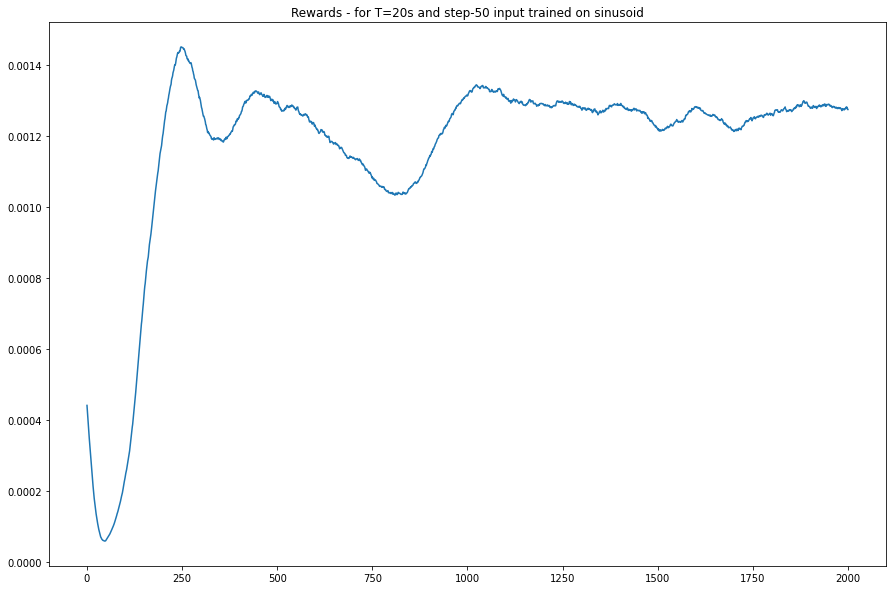

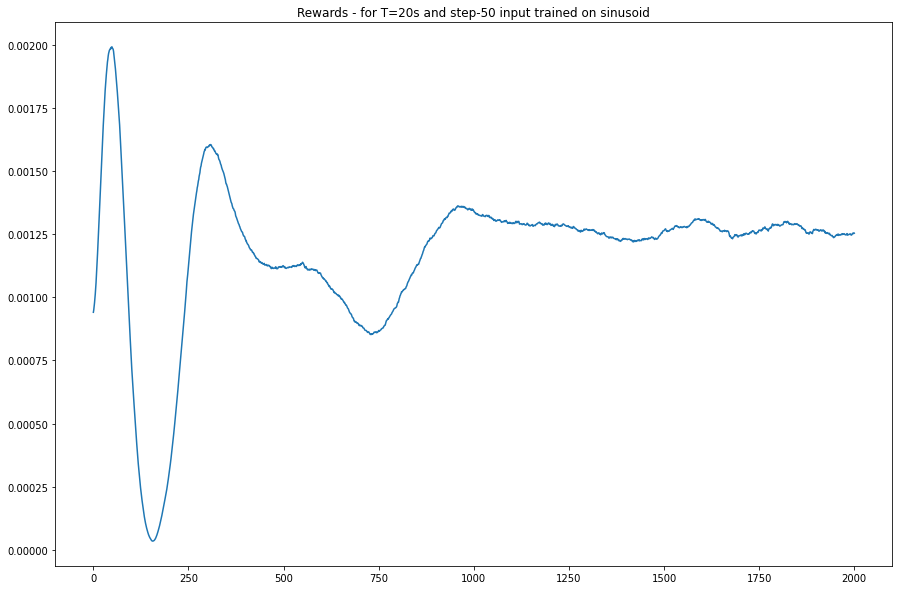

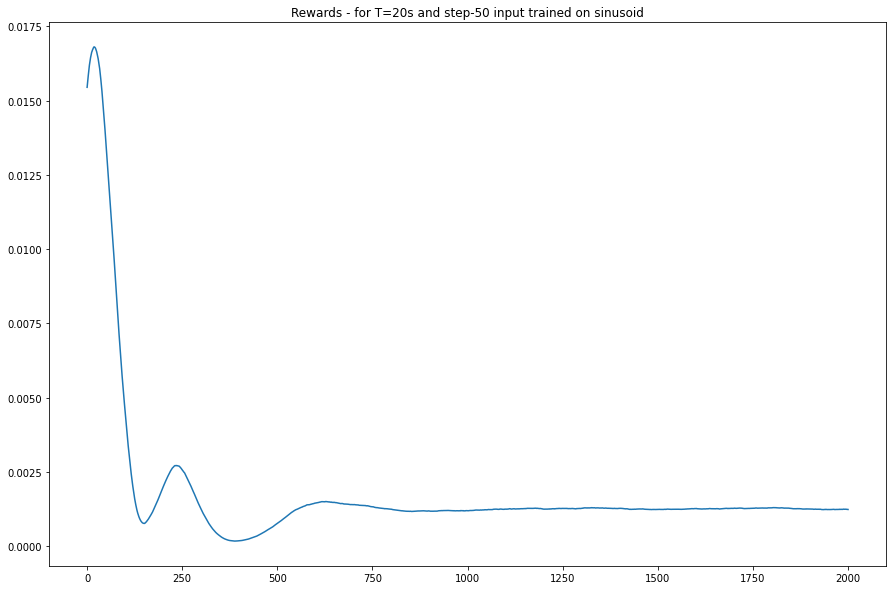

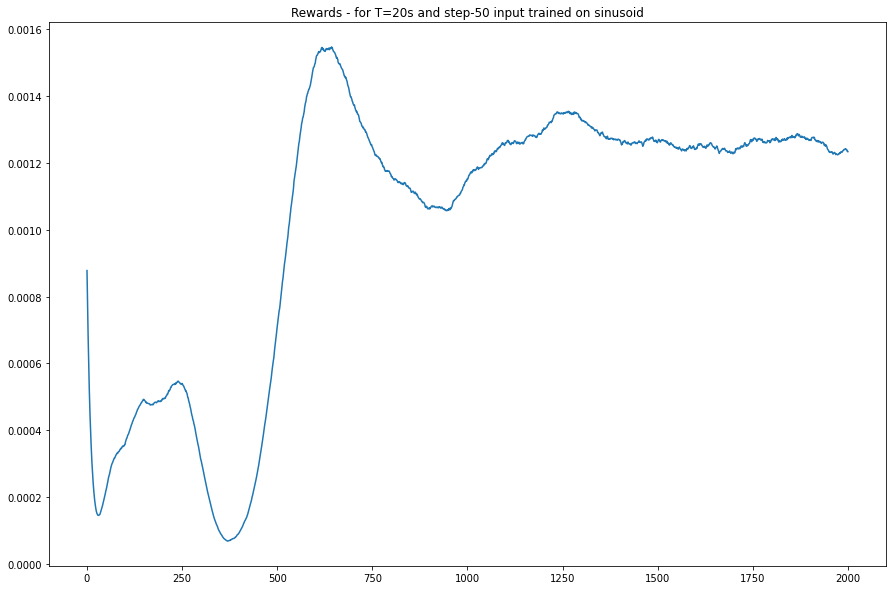

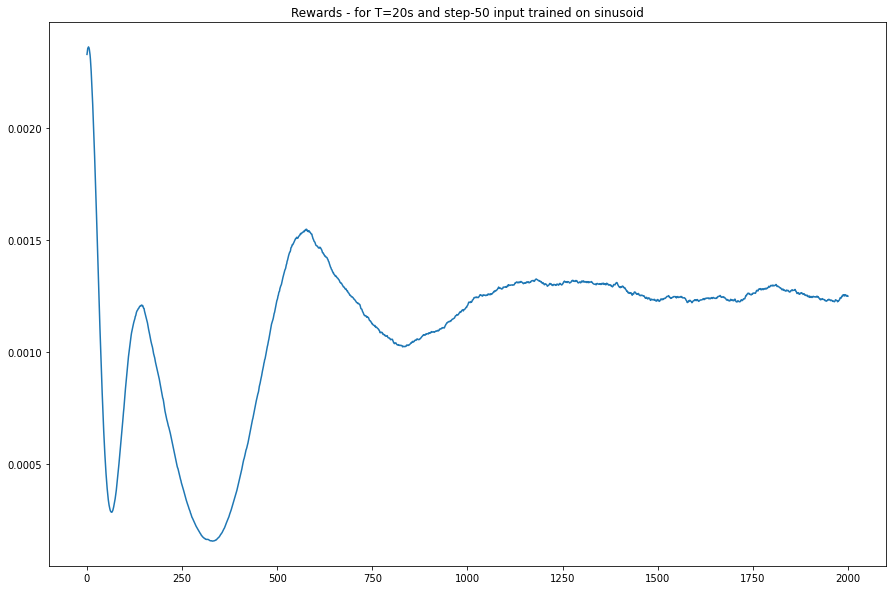

...

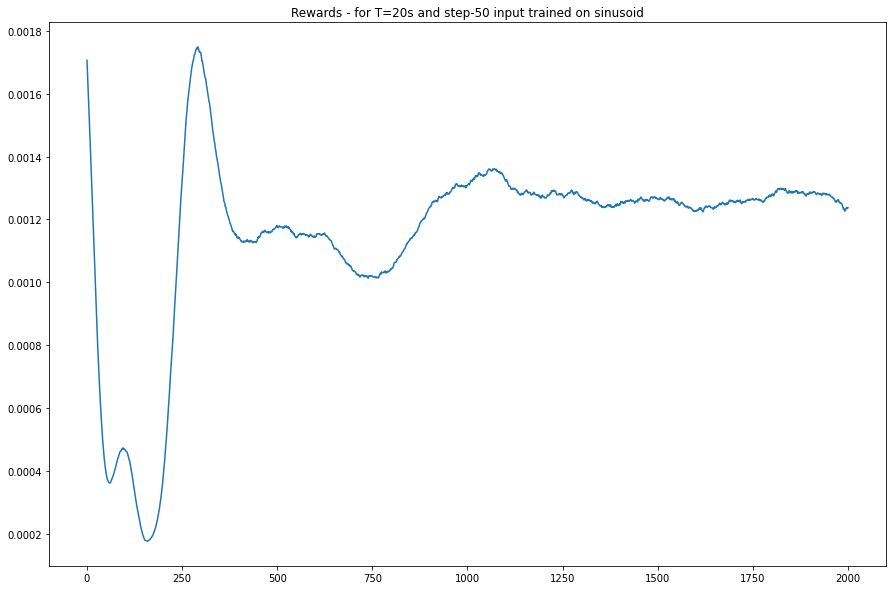

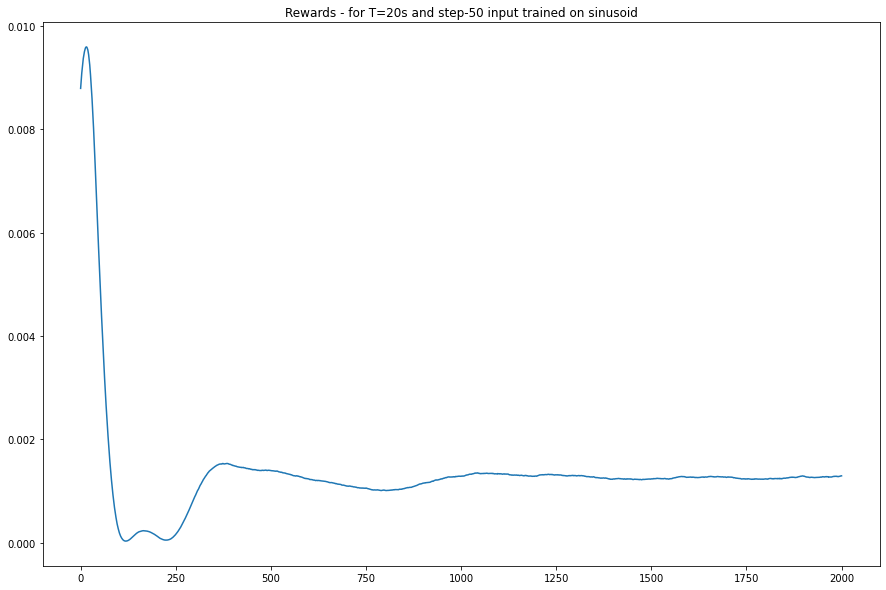

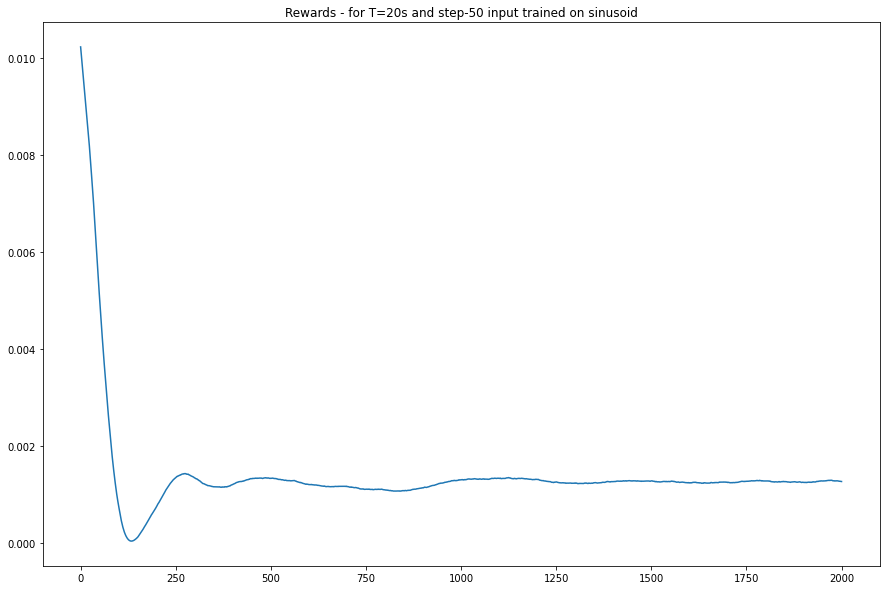

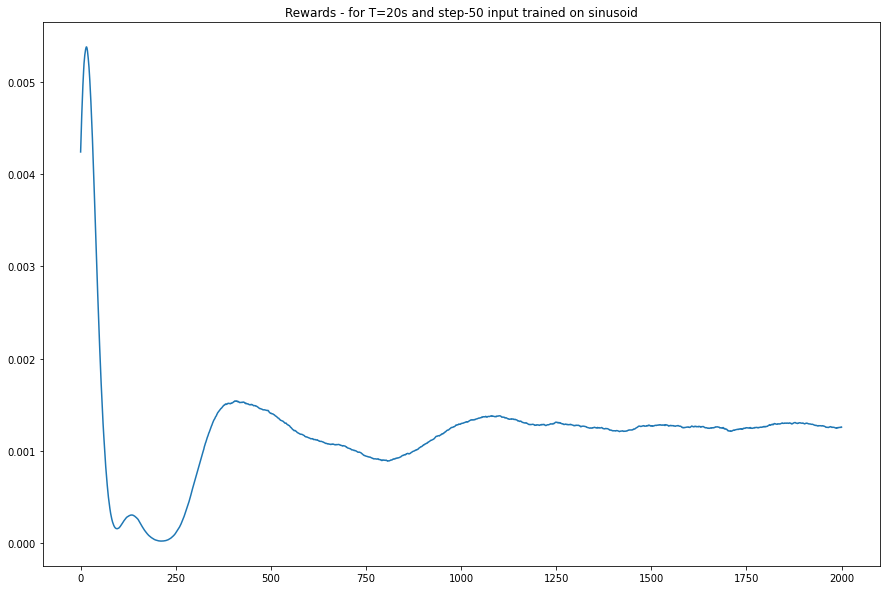

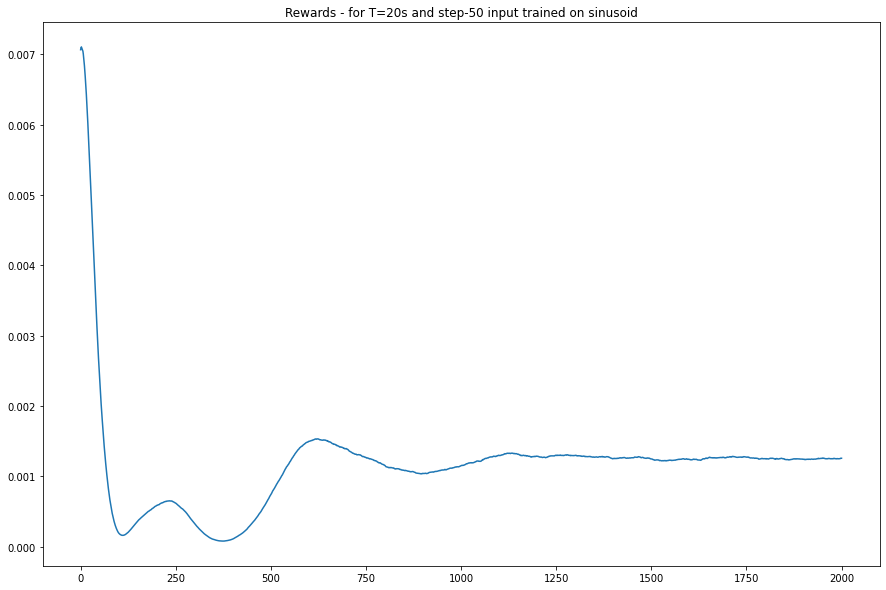

In [ ]:
total_reward = 0

for init_num in range(20): 
  plt.figure(figsize=(15,10))
  plt.title("Rewards - for T=20s and step-50 input trained on sinusoid")
  plt.plot(np.array(all_init_state_ep_rewards[init_num])[:,0,0]) ; 
  print("Mean Cost = ", sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])) ;
  total_reward += sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])

print("Average cost over all runs = ", total_reward/20)

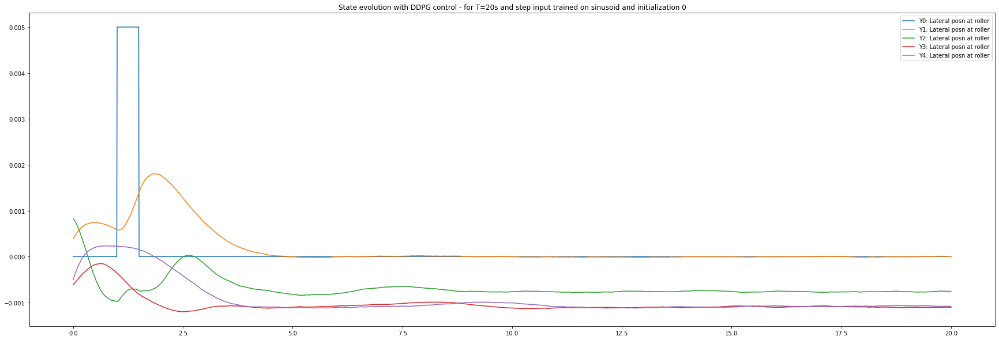

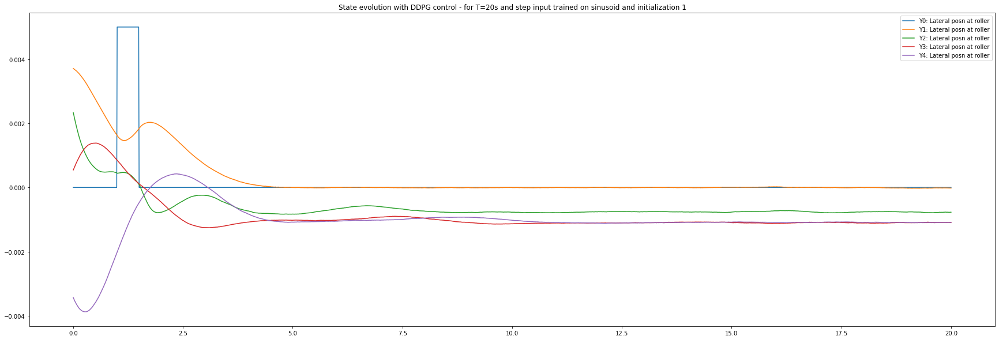

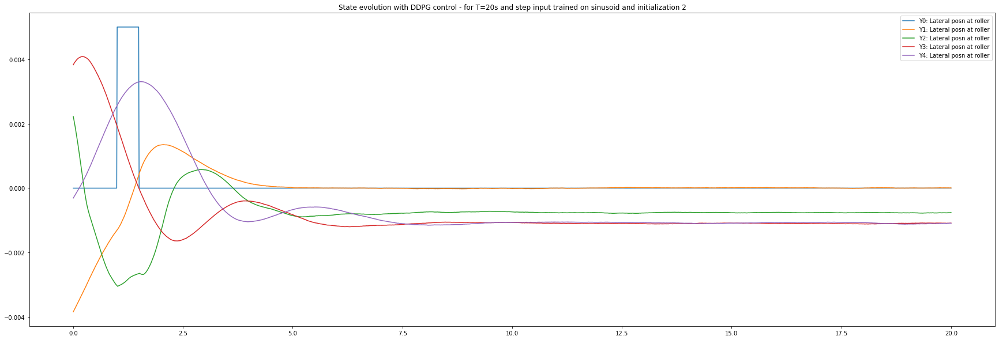

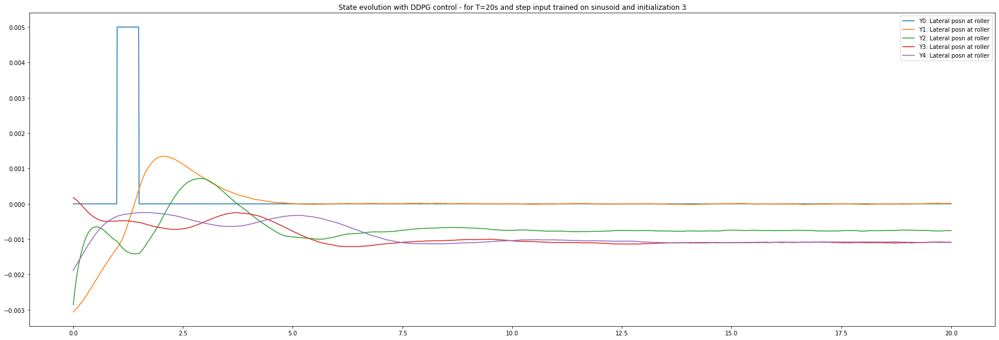

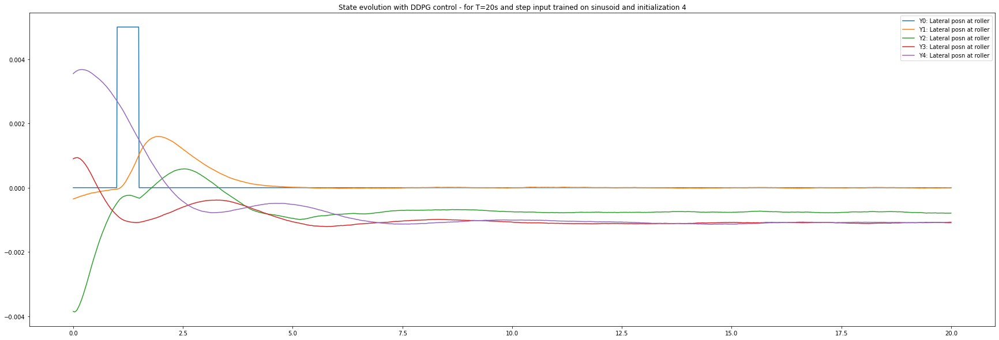

...

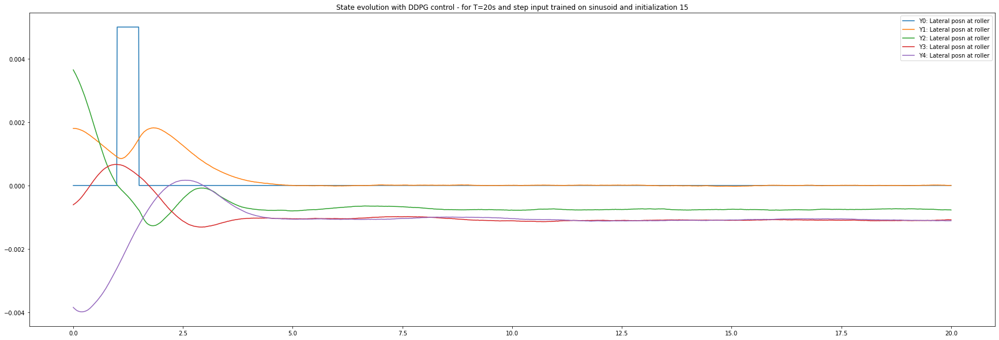

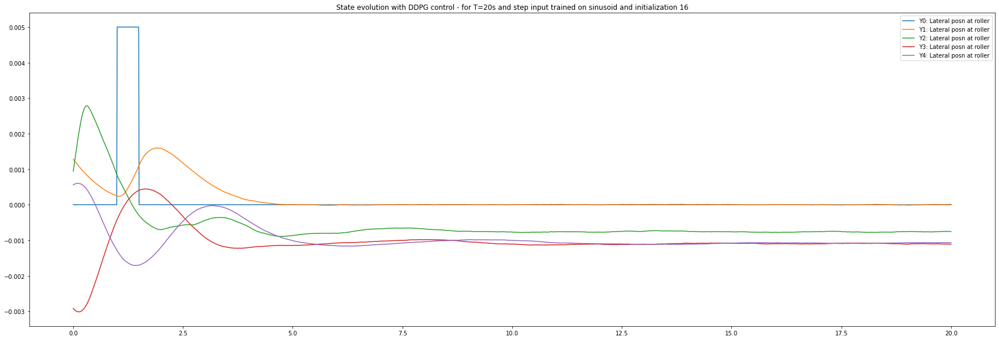

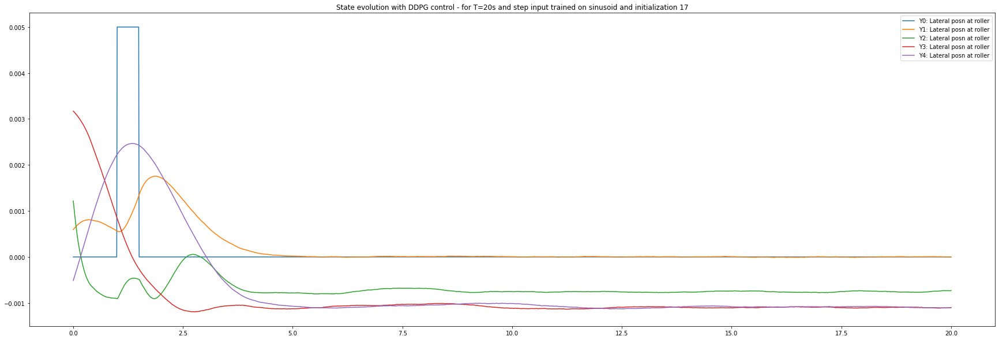

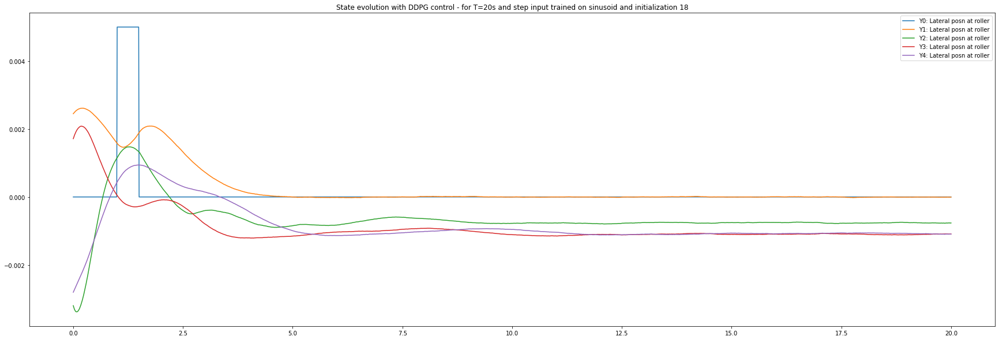

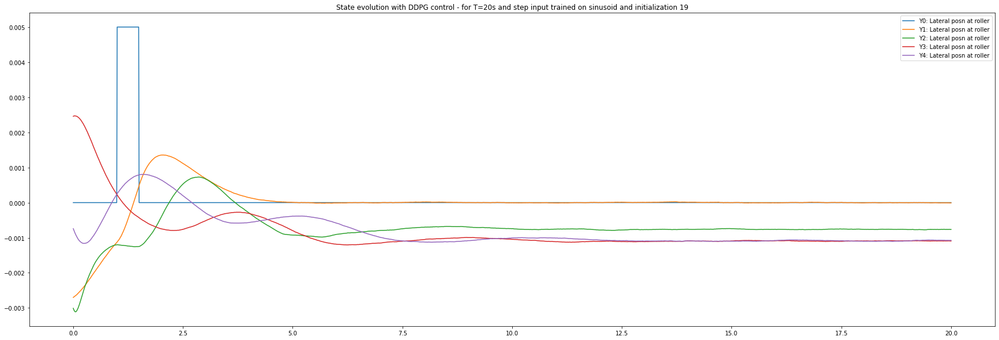

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution with DDPG control - for T=20s and step input trained on sinusoid and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

## square-100 with DDPG - Sinusoidal model

In [ ]:
model_path = './model/ddpg_rand_init_sin_2_0x'

test_episodes = 1
max_steps=2001
alg.load_model(model_path)
t_range = np.linspace(0,(max_steps-1)/100,max_steps)
w_sin = 0.02*0.25*np.sin(1.5*t_range)

## Square wave disturbance
w_step = np.zeros(t_range.shape)
w_step[100:200] = 0.02*0.25

#w = w_step

w = w_step

all_init_state_evols = {}
all_init_state_ep_rewards = {}

for init_num in range (20):
    print("Currently working on init num = ", init_num)
    q_loss_list=[]
    policy_loss_list=[]
    ep_rewards = [] ;
    #state = env.reset()
    state = np.concatenate((env.C@(env.reset(init_states[:,init_num][:,None])), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]        

    states_evolution = state[:,None]

    episode_reward = 0

    for step in tqdm(range(max_steps)):
        action = alg.policy_net.get_action(state, noise_scale=0.0)  # no noise for testing

        # action = action/400

        # next_state, reward, done, _ = env.step(action)

        true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
        next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
        reward = -cost  

        ep_rewards.append(cost)
        
        state = next_state

        states_evolution = np.concatenate((states_evolution, state[:,None]), axis=1)

        episode_reward += reward

    all_init_state_evols[init_num] = states_evolution 
    all_init_state_ep_rewards[init_num] = ep_rewards    
        
        # if done:
        #     break
#rewards

Currently working on init num =  0


  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.8/dist-packages/torch/nn/functional.py:1956: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
100%|██████████| 2001/2001 [00:11<00:00, 181.50it/s]


Currently working on init num =  1


100%|██████████| 2001/2001 [00:10<00:00, 185.36it/s]


Currently working on init num =  2


100%|██████████| 2001/2001 [00:11<00:00, 181.64it/s]


Currently working on init num =  3


100%|██████████| 2001/2001 [00:10<00:00, 184.46it/s]


Currently working on init num =  4


100%|██████████| 2001/2001 [00:10<00:00, 183.64it/s]


Currently working on init num =  5


100%|██████████| 2001/2001 [00:10<00:00, 183.42it/s]


Currently working on init num =  6


100%|██████████| 2001/2001 [00:10<00:00, 184.09it/s]


Currently working on init num =  7


100%|██████████| 2001/2001 [00:10<00:00, 185.11it/s]


Currently working on init num =  8


100%|██████████| 2001/2001 [00:10<00:00, 182.79it/s]


Currently working on init num =  9


100%|██████████| 2001/2001 [00:10<00:00, 182.14it/s]


Currently working on init num =  10


100%|██████████| 2001/2001 [00:11<00:00, 181.44it/s]


Currently working on init num =  11


100%|██████████| 2001/2001 [00:10<00:00, 182.34it/s]


Currently working on init num =  12


100%|██████████| 2001/2001 [00:10<00:00, 183.63it/s]


Currently working on init num =  13


100%|██████████| 2001/2001 [00:11<00:00, 180.94it/s]


Currently working on init num =  14


100%|██████████| 2001/2001 [00:10<00:00, 183.20it/s]


Currently working on init num =  15


100%|██████████| 2001/2001 [00:11<00:00, 176.99it/s]


Currently working on init num =  16


100%|██████████| 2001/2001 [00:10<00:00, 186.25it/s]


Currently working on init num =  17


100%|██████████| 2001/2001 [00:10<00:00, 185.08it/s]


Currently working on init num =  18


100%|██████████| 2001/2001 [00:11<00:00, 179.63it/s]


Currently working on init num =  19


100%|██████████| 2001/2001 [00:10<00:00, 184.77it/s]


Mean Cost =  [[7.85176742e-05]]
Mean Cost =  [[0.00011985]]
Mean Cost =  [[0.00091804]]
Mean Cost =  [[0.00010263]]
Mean Cost =  [[0.00017367]]
Mean Cost =  [[0.00023005]]
Mean Cost =  [[0.00046589]]
Mean Cost =  [[0.00038352]]
Mean Cost =  [[0.00035564]]
Mean Cost =  [[0.00021245]]
Mean Cost =  [[0.00011304]]
Mean Cost =  [[0.00027501]]
Mean Cost =  [[0.00014023]]
Mean Cost =  [[0.00014031]]
Mean Cost =  [[0.00040956]]
Mean Cost =  [[8.19969029e-05]]
Mean Cost =  [[0.00033112]]
Mean Cost =  [[0.00035488]]
Mean Cost =  [[0.0002164]]
Mean Cost =  [[0.000319]]
Average cost over all runs =  [[0.00027109]]


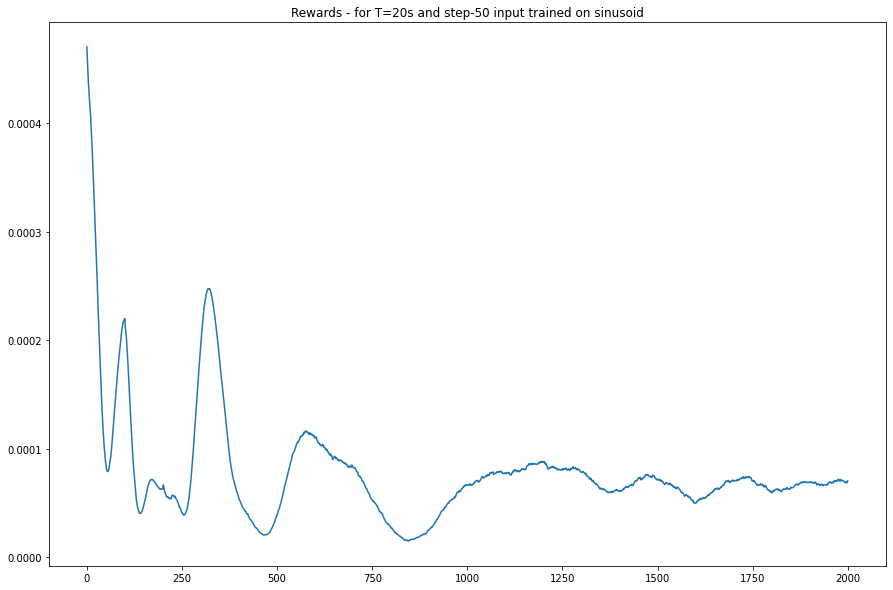

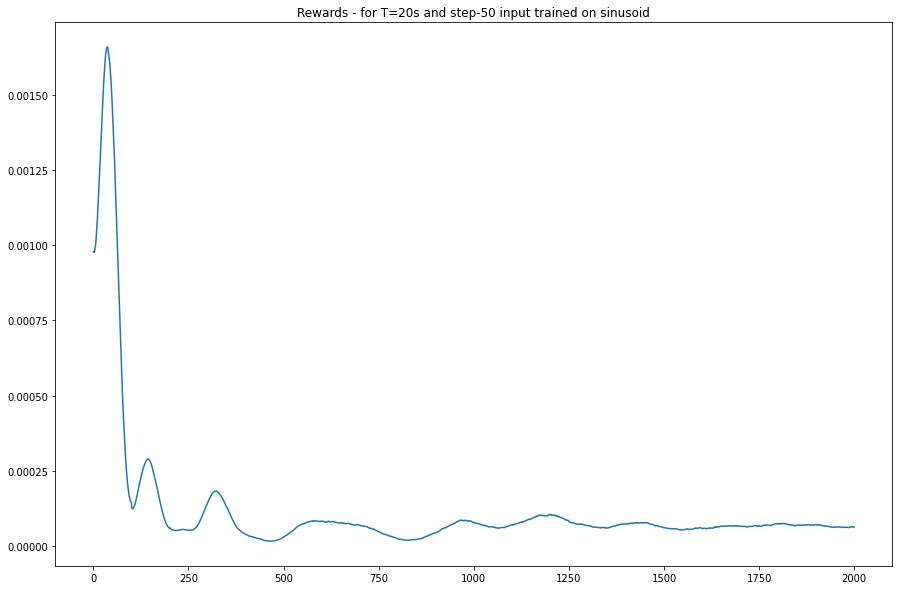

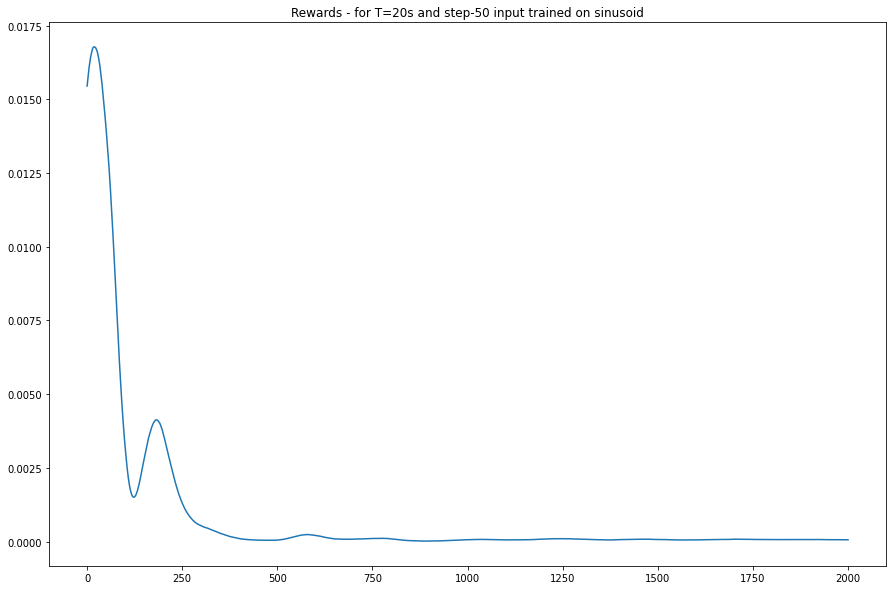

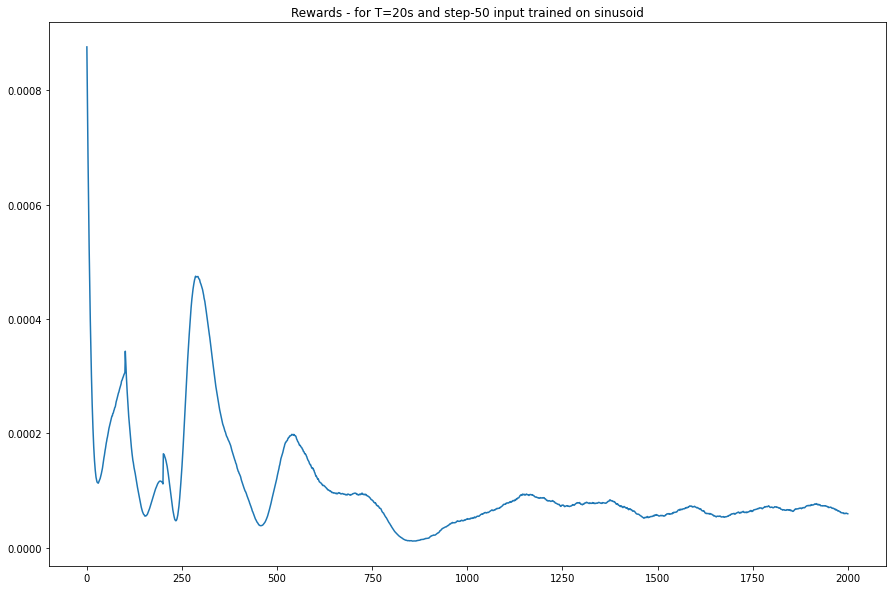

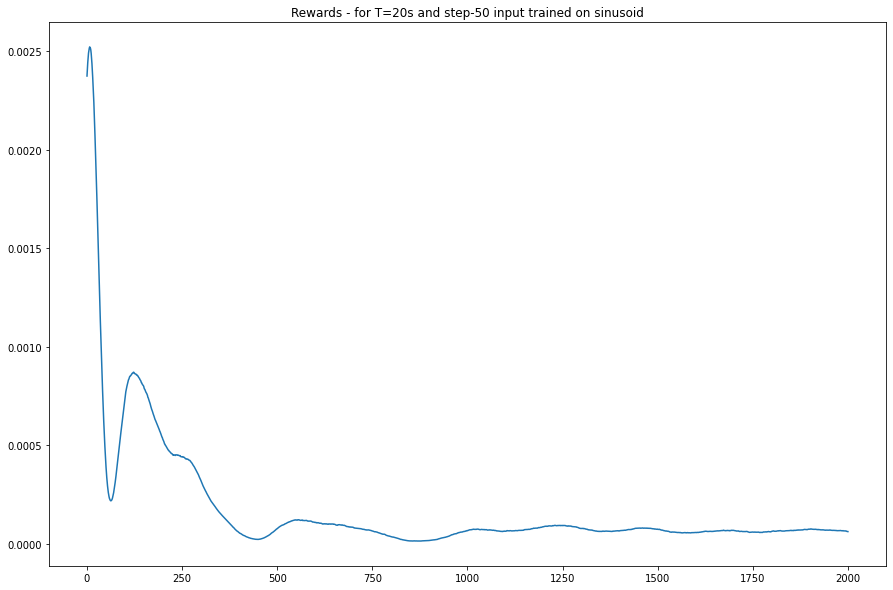

...

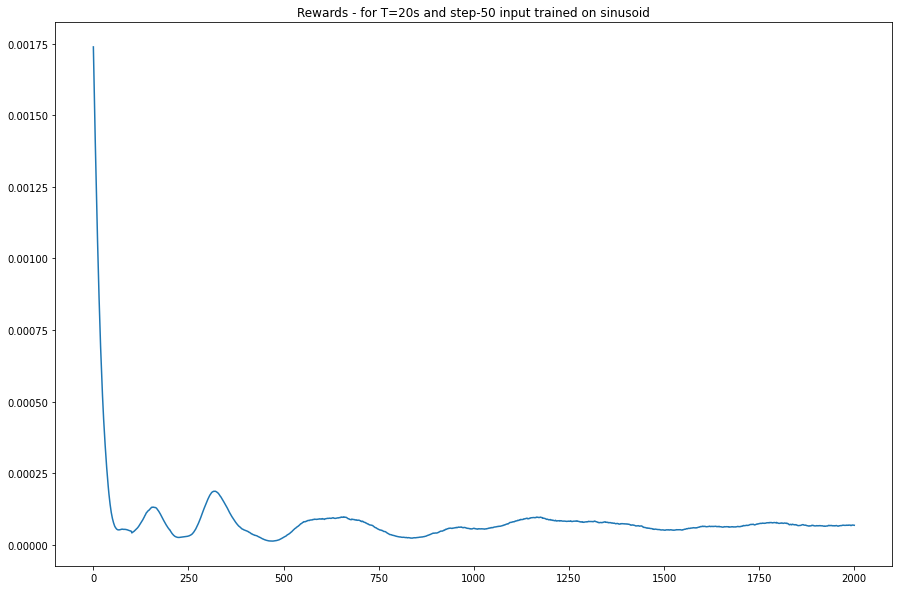

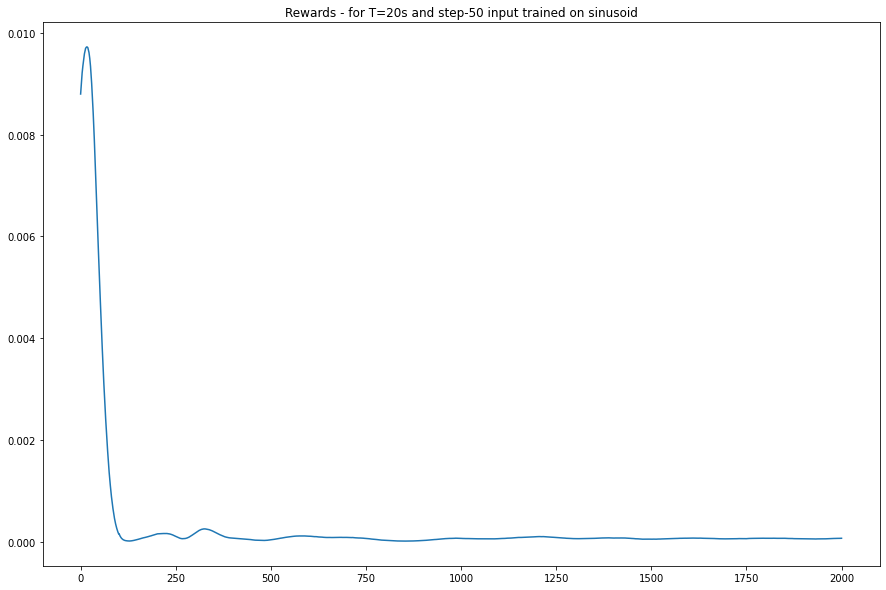

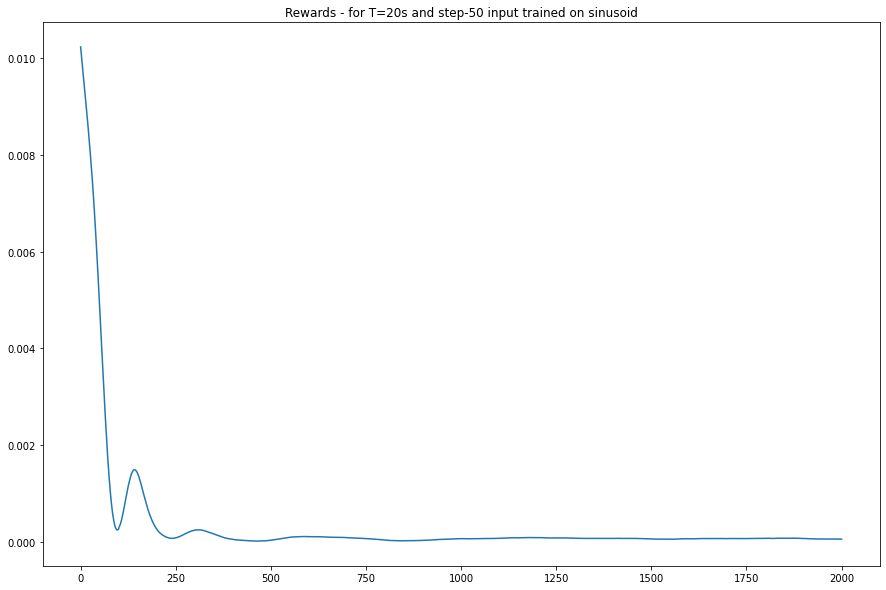

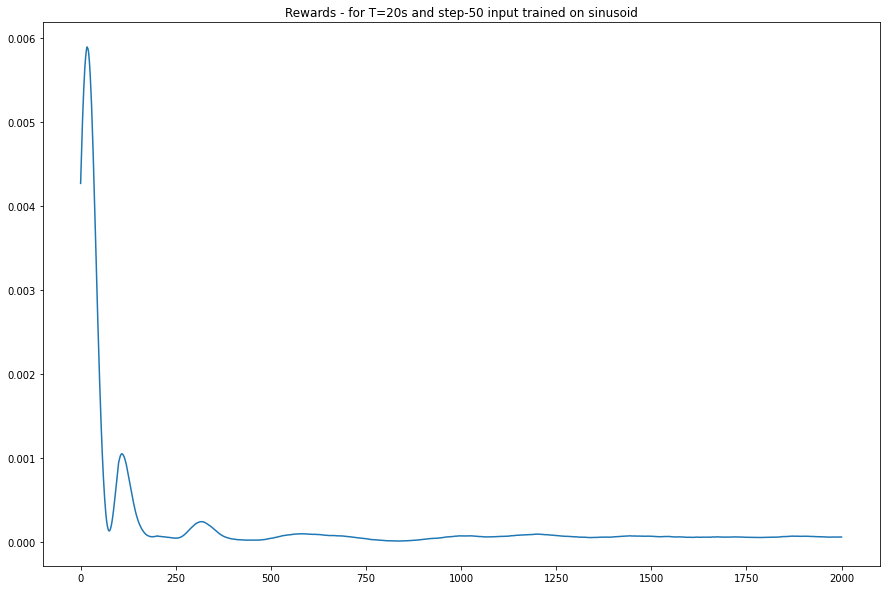

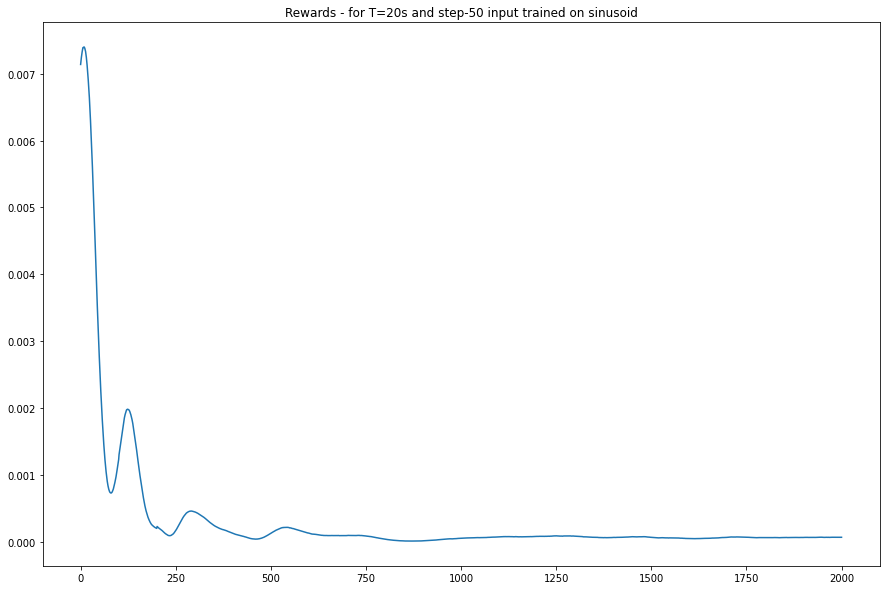

In [ ]:
total_reward = 0

for init_num in range(20): 
  plt.figure(figsize=(15,10))
  plt.title("Rewards - for T=20s and step-50 input trained on sinusoid")
  plt.plot(np.array(all_init_state_ep_rewards[init_num])[:,0,0]) ; 
  print("Mean Cost = ", sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])) ;
  total_reward += sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])

print("Average cost over all runs = ", total_reward/20)

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution with DDPG control - for T=20s and step input trained on sinusoid and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

Output hidden; open in https://colab.research.google.com to view.

## square-100 with DDPG - Step input model

In [ ]:
model_path = './model/ddpg_rand_init_step'

test_episodes = 1
max_steps=2001
alg.load_model(model_path)
t_range = np.linspace(0,(max_steps-1)/100,max_steps)
#w_sin = 0.02*0.25*np.sin(1.5*t_range)

## Square wave disturbance
w_step = np.zeros(t_range.shape)
w_step[100:200] = 0.02*0.25

#w = w_step

w = w_step

all_init_state_evols = {}
all_init_state_ep_rewards = {}

for init_num in range (20):
    print("Currently working on init num = ", init_num)
    q_loss_list=[]
    policy_loss_list=[]
    ep_rewards = [] ;
    #state = env.reset()
    state = np.concatenate((env.C@(env.reset(init_states[:,init_num][:,None])), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]        

    states_evolution = state[:,None]

    episode_reward = 0

    for step in tqdm(range(max_steps)):
        action = alg.policy_net.get_action(state, noise_scale=0.0)  # no noise for testing

        # action = action/400

        # next_state, reward, done, _ = env.step(action)

        true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
        next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
        reward = -cost  

        ep_rewards.append(cost)
        
        state = next_state

        states_evolution = np.concatenate((states_evolution, state[:,None]), axis=1)

        episode_reward += reward

    all_init_state_evols[init_num] = states_evolution 
    all_init_state_ep_rewards[init_num] = ep_rewards    
        
        # if done:
        #     break
#rewards

Currently working on init num =  0


  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.8/dist-packages/torch/nn/functional.py:1956: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
100%|██████████| 2001/2001 [00:10<00:00, 182.47it/s]


Currently working on init num =  1


100%|██████████| 2001/2001 [00:10<00:00, 183.26it/s]


Currently working on init num =  2


100%|██████████| 2001/2001 [00:11<00:00, 181.11it/s]


Currently working on init num =  3


100%|██████████| 2001/2001 [00:10<00:00, 182.67it/s]


Currently working on init num =  4


100%|██████████| 2001/2001 [00:11<00:00, 177.55it/s]


Currently working on init num =  5


100%|██████████| 2001/2001 [00:10<00:00, 182.72it/s]


Currently working on init num =  6


100%|██████████| 2001/2001 [00:10<00:00, 184.80it/s]


Currently working on init num =  7


100%|██████████| 2001/2001 [00:11<00:00, 180.19it/s]


Currently working on init num =  8


100%|██████████| 2001/2001 [00:11<00:00, 178.45it/s]


Currently working on init num =  9


100%|██████████| 2001/2001 [00:11<00:00, 180.83it/s]


Currently working on init num =  10


100%|██████████| 2001/2001 [00:10<00:00, 184.52it/s]


Currently working on init num =  11


100%|██████████| 2001/2001 [00:10<00:00, 184.00it/s]


Currently working on init num =  12


100%|██████████| 2001/2001 [00:11<00:00, 181.88it/s]


Currently working on init num =  13


100%|██████████| 2001/2001 [00:10<00:00, 182.11it/s]


Currently working on init num =  14


100%|██████████| 2001/2001 [00:10<00:00, 182.09it/s]


Currently working on init num =  15


100%|██████████| 2001/2001 [00:11<00:00, 179.21it/s]


Currently working on init num =  16


100%|██████████| 2001/2001 [00:11<00:00, 181.29it/s]


Currently working on init num =  17


100%|██████████| 2001/2001 [00:11<00:00, 180.20it/s]


Currently working on init num =  18


100%|██████████| 2001/2001 [00:10<00:00, 182.94it/s]


Currently working on init num =  19


100%|██████████| 2001/2001 [00:10<00:00, 186.06it/s]


Mean Cost =  [[0.0011356]]
Mean Cost =  [[0.00116385]]
Mean Cost =  [[0.00180186]]
Mean Cost =  [[0.00099995]]
Mean Cost =  [[0.00108442]]
Mean Cost =  [[0.00118026]]
Mean Cost =  [[0.00136652]]
Mean Cost =  [[0.00130645]]
Mean Cost =  [[0.00126631]]
Mean Cost =  [[0.00120358]]
Mean Cost =  [[0.00102252]]
Mean Cost =  [[0.00120083]]
Mean Cost =  [[0.00117609]]
Mean Cost =  [[0.00109638]]
Mean Cost =  [[0.00145123]]
Mean Cost =  [[0.00114005]]
Mean Cost =  [[0.00130829]]
Mean Cost =  [[0.00135056]]
Mean Cost =  [[0.00115239]]
Mean Cost =  [[0.00113958]]
Average cost over all runs =  [[0.00122734]]


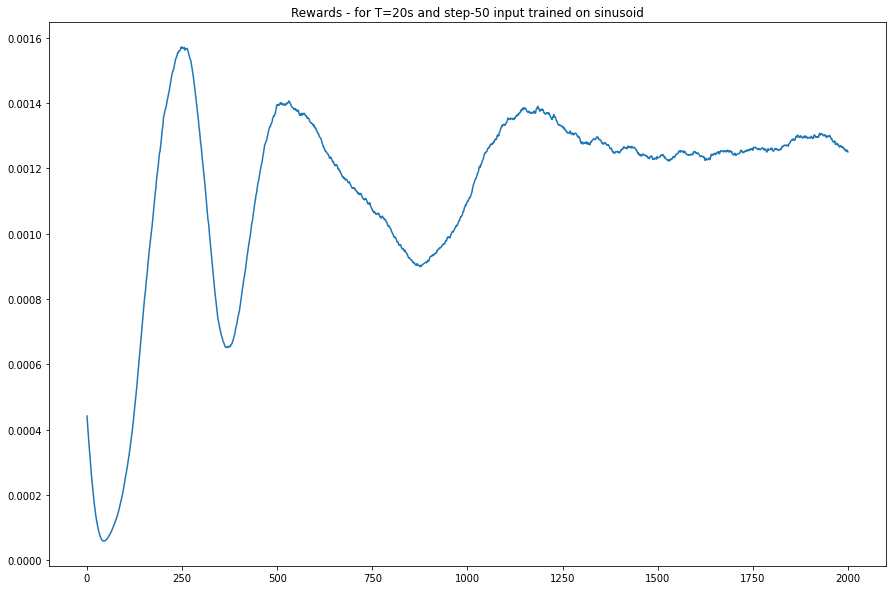

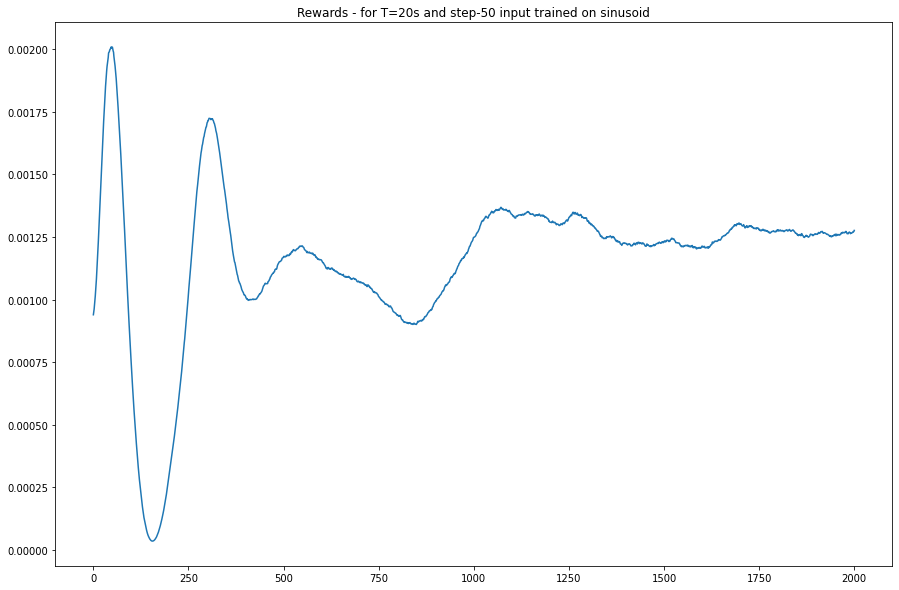

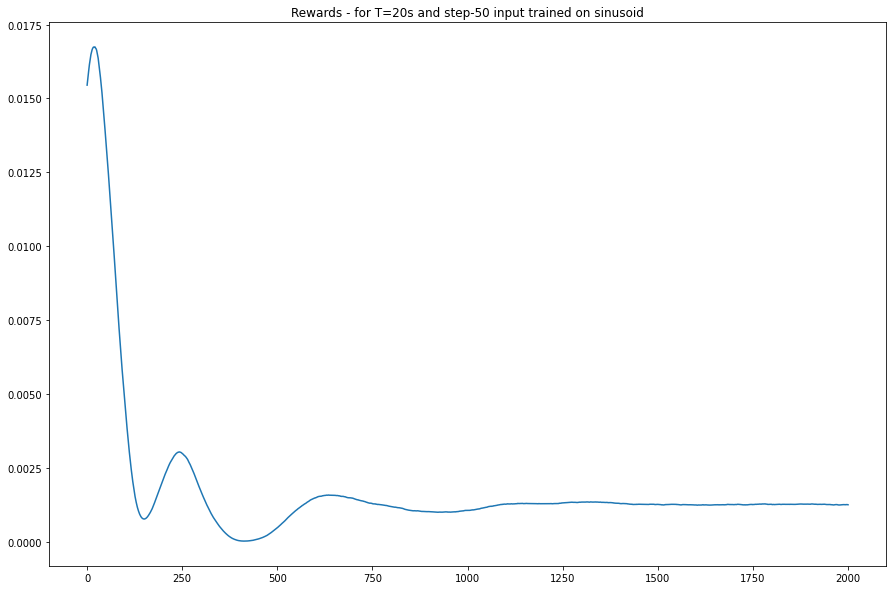

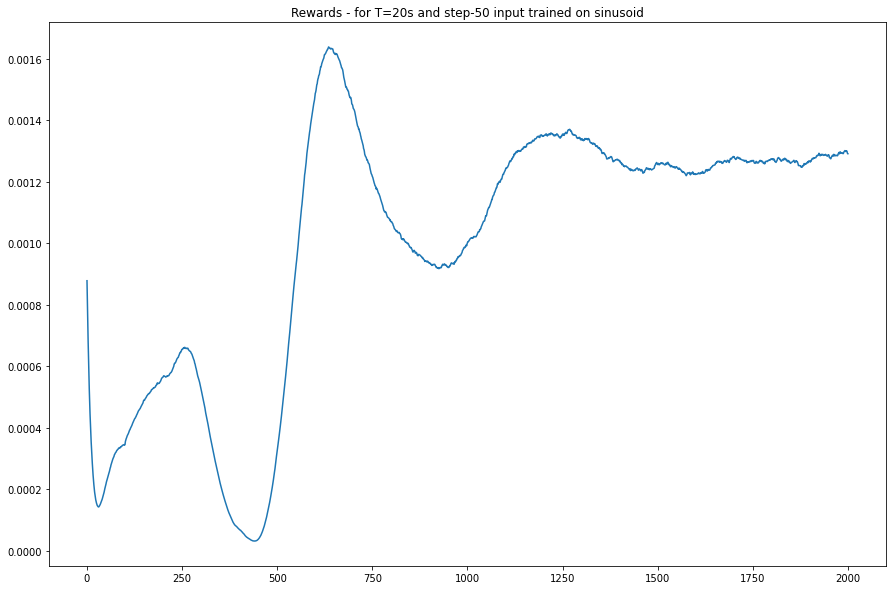

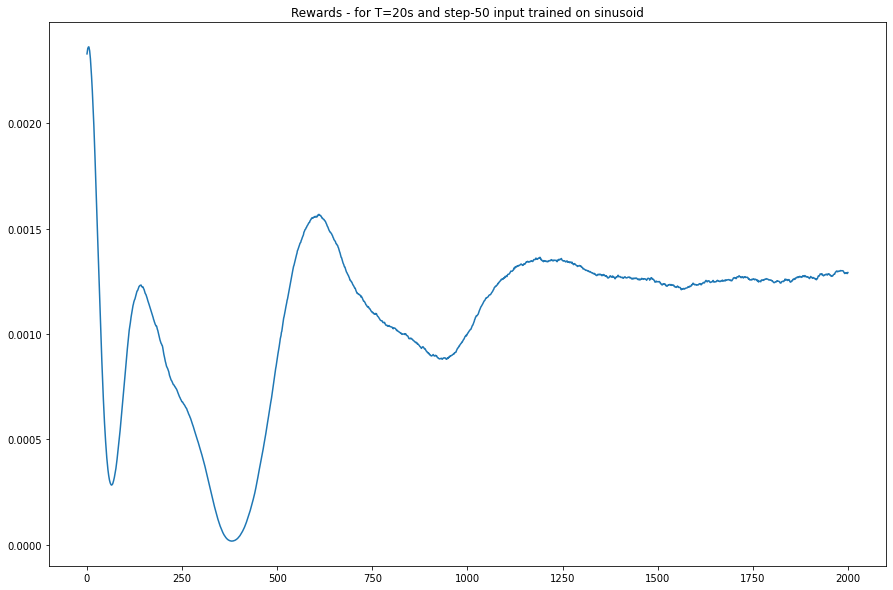

...

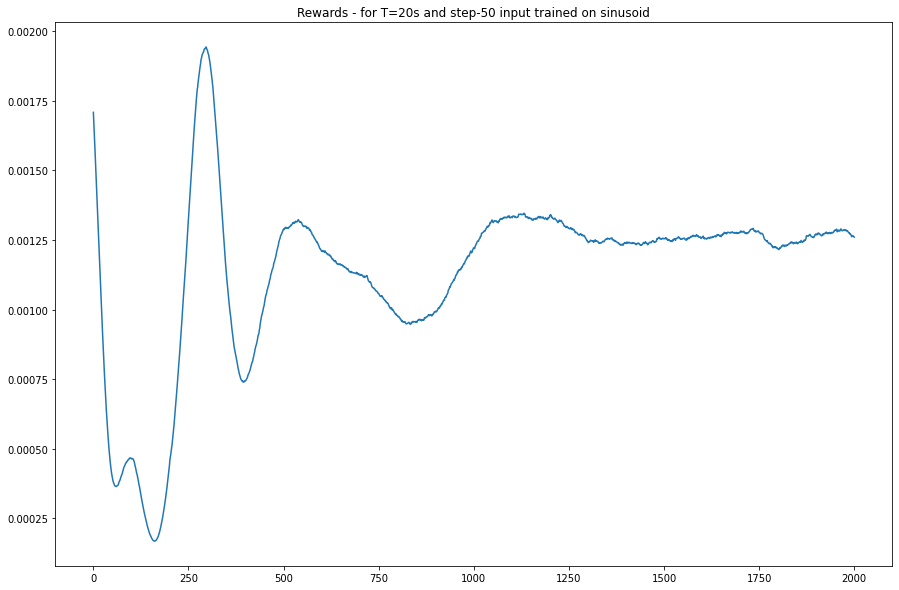

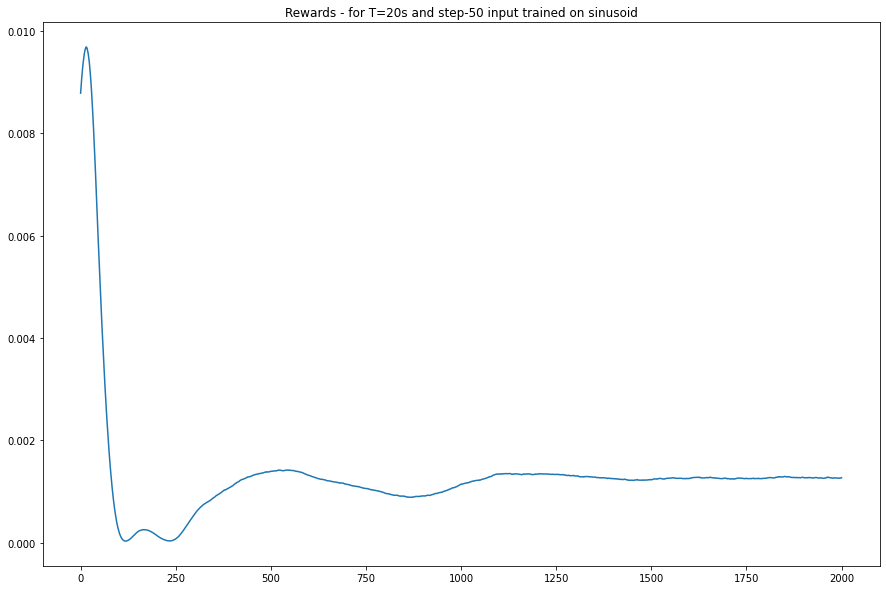

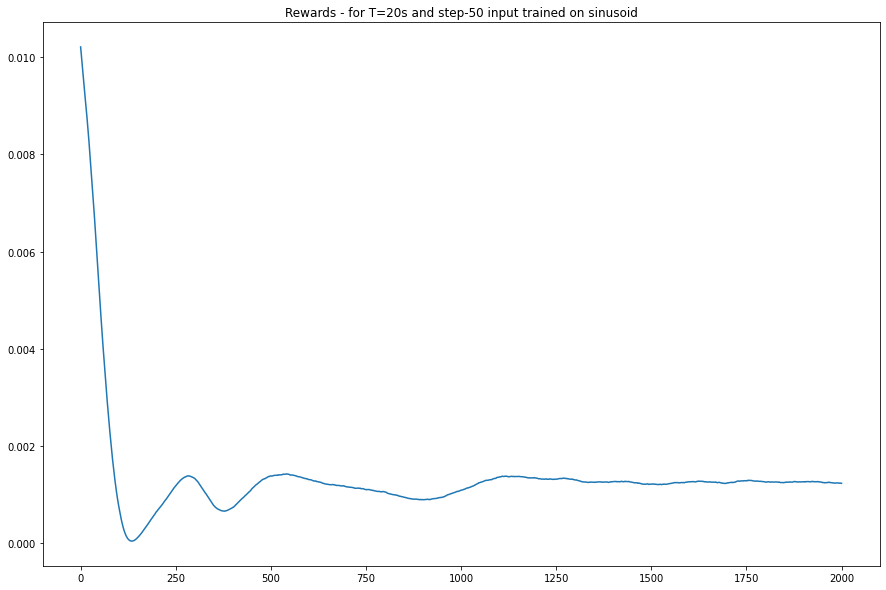

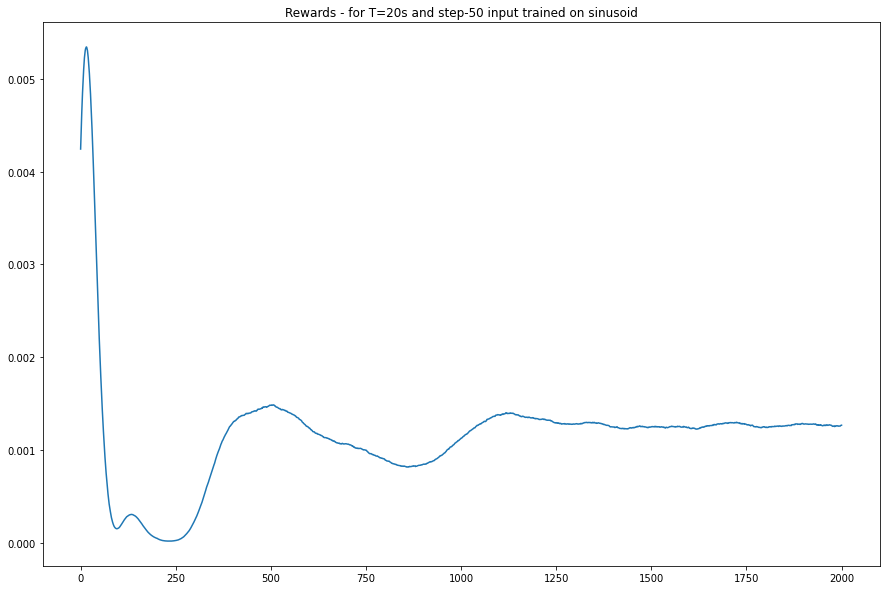

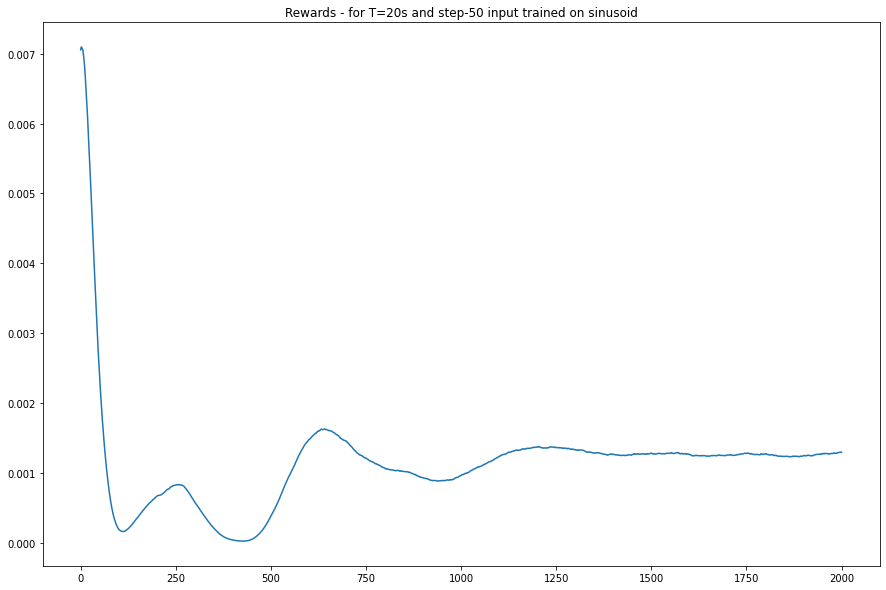

In [ ]:
total_reward = 0

for init_num in range(20): 
  plt.figure(figsize=(15,10))
  plt.title("Rewards - for T=20s and step-50 input trained on sinusoid")
  plt.plot(np.array(all_init_state_ep_rewards[init_num])[:,0,0]) ; 
  print("Mean Cost = ", sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])) ;
  total_reward += sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])

print("Average cost over all runs = ", total_reward/20)

In [ ]:
for init_num in range(20):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution with DDPG control - for T=20s and step input trained on sinusoid and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 

## jhffeihekfse

## jsefhSLf

In [61]:
max_steps = 101

t_range = np.linspace(0,(max_steps-1)/100,max_steps) 

## Define 2 kinds of external distrubances to train on 
## Sine wave disturbance
w_sin = 0.02*0.25*np.sin(1.5*t_range) 

# ## Square wave disturbance
w_step = np.zeros(t_range.shape)
w_step[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25

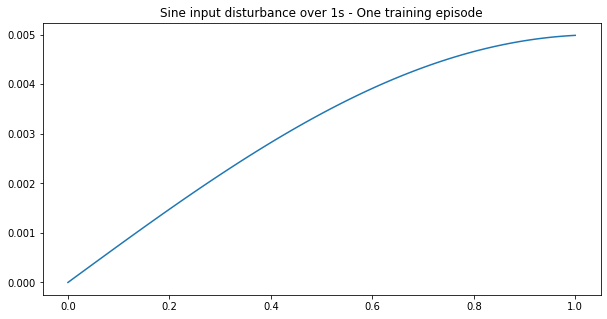

In [69]:
plt.figure(figsize=(10,5))
plt.plot(t_range, w_sin) 
plt.title("Sine input disturbance over 1s - One training episode") ; 

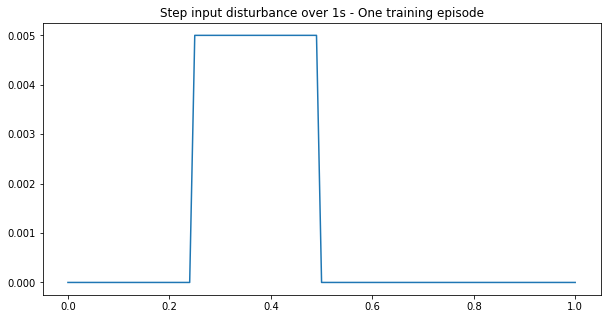

In [71]:
plt.figure(figsize=(10,5))
plt.plot(t_range, w_step) 
plt.title("Step input disturbance over 1s - One training episode") ; 

## Square-wave input of a given width

In [ ]:
model_path = './model/ddpg_rand_init_sin_2_0x'

test_episodes = 1
max_steps=2001
#alg.load_model(model_path)
t_range = np.linspace(0,(max_steps-1)/100,max_steps)
#w_sin = 0.02*0.25*np.sin(t_range)

## Square wave disturbance
w_step = np.zeros(t_range.shape)
#w_step[t_range.shape[0]//4:(t_range.shape[0]//2)] = 0.02*0.25
w_step[100:150] = 0.02*0.25

w = w_step

#w = w_sin

all_init_state_evols = {}
all_init_state_ep_rewards = {}

for init_num in range (1):
    print("Currently working on init num = ", init_num)
    q_loss_list=[]
    policy_loss_list=[]
    ep_rewards = [] ;
    #state = env.reset()
    state = np.concatenate((env.C@(env.reset(init_states[:,init_num][:,None])), np.atleast_2d(np.array([1e-6, 0])).T))[:,0]        

    states_evolution = state[:,None]

    episode_reward = 0

    for step in tqdm(range(max_steps)):
        action = alg.policy_net.get_action(state, noise_scale=0.0)  # no noise for testing

        # action = action/400

        # next_state, reward, done, _ = env.step(action)

        true_state, obs, cost, done, info = env.step(np.atleast_2d(action).astype(np.float32), meas_dist=np.atleast_2d(np.array([w[step] , 0])).T, t_step=step)
        next_state = np.concatenate((obs,np.atleast_2d(np.array([w[step] , 0])).T), 0)[:,0]
        reward = -cost  

        ep_rewards.append(cost)
        
        state = next_state

        states_evolution = np.concatenate((states_evolution, state[:,None]), axis=1)

        episode_reward += reward

    all_init_state_evols[init_num] = states_evolution 
    all_init_state_ep_rewards[init_num] = ep_rewards    
        
        # if done:
        #     break
#rewards

Currently working on init num =  0


  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.8/dist-packages/torch/nn/functional.py:1956: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
100%|██████████| 2001/2001 [00:23<00:00, 85.91it/s]


Mean Cost =  [[0.00013659]]
Average cost over all runs =  [[6.82935741e-06]]


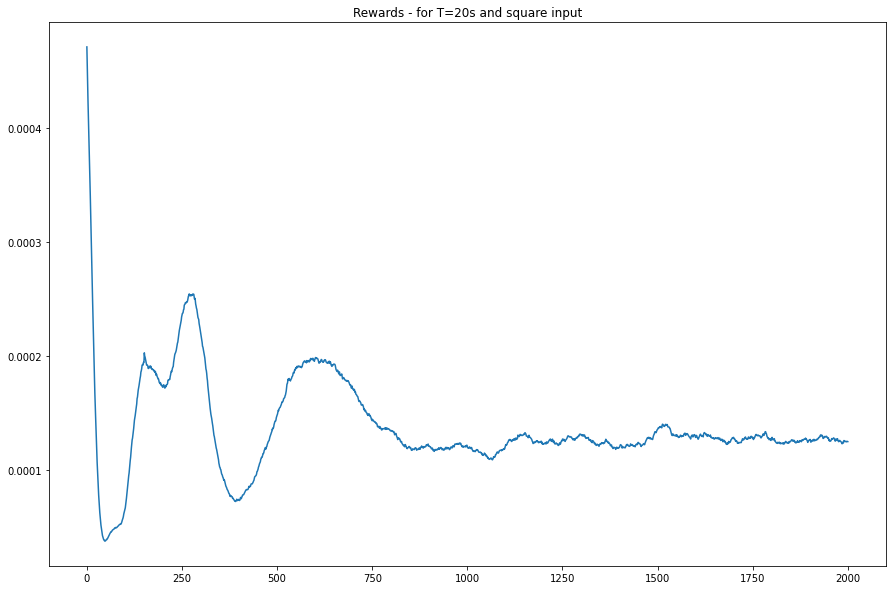

In [ ]:
total_reward = 0

for init_num in range(1): 
  plt.figure(figsize=(15,10))
  plt.title("Rewards - for T=20s and square input")
  plt.plot(np.array(all_init_state_ep_rewards[init_num])[:,0,0]) ; 
  print("Mean Cost = ", sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])) ;
  total_reward += sum(all_init_state_ep_rewards[init_num])/len(all_init_state_ep_rewards[init_num])

print("Average cost over all runs = ", total_reward/20)

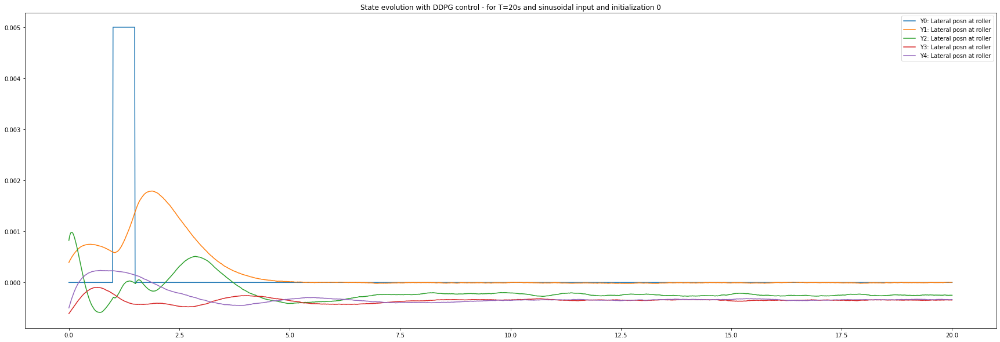

In [ ]:
for init_num in range(1):
  plt.figure(figsize=(30,10))
  prtstr = "State evolution with DDPG control - for T=20s and sinusoidal input and initialization " + str(init_num)
  plt.title(prtstr)

  plt.plot(t_range, w, label='Y0: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][0,:2001], label='Y1: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][2,:2001], label='Y2: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][4,:2001], label='Y3: Lateral posn at roller')
  plt.plot(t_range, all_init_state_evols[init_num][6,:2001], label='Y4: Lateral posn at roller')

  plt.legend() ; 